In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from glob import glob
import os
import matplotlib
import seaborn as sns
sns.set_style('whitegrid')


matplotlib.rcParams['mathtext.fontset'] = 'cm'
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif"
})

savedir = "./fig"
if not os.path.exists(savedir):
    os.makedirs(savedir)

## Explanations

``ACQUISITION FUNCTION : SSL MODEL`` -- each curve represents the accuracy curve of the choices made by ``ACQUISITION FUNCTION`` using the underlying ``SSL MODEL``. 


In [9]:
acq_color = {'random':'r', 'vopt':'cyan', 'voptfull':'cyan',  'mcvopt':'k', 'sopt':'lime', 'soptfull':'lime',
             'dirichletvar':'blue',
             'dirichletvarprop' : 'purple', 
             'dirichletvarpropk++':'gold',
             'unc':'green',
             'land_lund':'magenta',
             'land':'magenta'
            }

display_name_map = {'unc': 'Unc. (SM)', 
                    'dirichletvar': 'Dir. Var.',
                    'dirichletvarprop': 'Dir. Var. (Prop)',
                    'dirichletvarpropk++': 'Dir. Var. (Prop++)',
                   'vopt': 'VOpt', 'mcvopt':'MCVOpt', 'random':'Random', 'sopt':r'$\Sigma$-Opt', 
                    'soptfull':r'$\Sigma$-Opt (Full)', 'voptfull':'VOpt (Full)',
                    'land_lund': r'LAND',
                    'land': r'LAND',
                    }

marker = {'unc': '*', 'vopt': 'v', 'mcvopt':'>', 'random':'.','voptfull': 'v', 'sopt':'s', 'soptfull':'s',
          'dirichletvar': 'o',
         'dirichletvarprop': '^',
         'land_lund': 'p',
         'land' : 'p'}
    
def plot_acc(dataset="blobs", modelname="dirichlet1000", resultsdir="results", 
                      savedir=None, ymin=80, bbox_to_anchor=(1.15,-0.16), acq_to_show=None,
                     plot_qualifier='', xmax=None, ncol=3, metric=None,
                    include_land=False):
    
    nc = np.load(f"{resultsdir}/{dataset}_results_2_100/init_labeled.npy").size
    
    if acq_to_show is None:
        acq_to_show = [ f"random : dirichlet1000", 
                   "unc : dirichlet1000",
                   'dirichletvar : dirichlet1000',
                    'dirichletvarprop : dirichlet1000',
                   "vopt : dirichlet1000", "sopt : dirichlet1000",
                  ]

    print(f"Num classes = {nc}")
    fnames = glob(f"{resultsdir}/{dataset}_overall_100/*_stats.csv")
    fname = sorted([fname for fname in fnames if fname.split("/")[-1][:len(modelname)+1] == modelname + "_"])[0]
    print(fname)
    df = pd.read_csv(fname)
    fig, ax = plt.subplots(figsize=(8,5))
    to_plot_cols = [col for col in df.columns if col.split(" : ")[-1] == 'avg']
    to_plot_cols = sorted([col for col in to_plot_cols if " : ".join(col.split(" : ")[:2]) in acq_to_show])
    print(to_plot_cols)
    
    rename = {col : [s.strip().capitalize() for s in col.split(" :")[:3]] for col in to_plot_cols}
    for col,val in rename.items():
        rename[col] = val[0]
    print(to_plot_cols)
    df = df[to_plot_cols].rename(columns=rename)
    df = df.shift(periods=nc)
    colormap = {col_name:acq_color[col_name.split(", ")[-1].lower().strip()] for col_name in df.columns }
    markermap = {col_name:marker[col_name.split(", ")[-1].lower().strip()] for col_name in df.columns}
    
    title = f"Accuracy in {modelname.upper()}"
    if savedir is not None:
        title = None
    
    for col in df:
        column = df[col]
        ax.plot(column.index, column.values, linewidth=2.0, color=colormap[col], alpha=0.9)
        values = column.iloc[::2]
        x = values.index
        ax.scatter(values.index, values.values, marker=markermap[col], color=colormap[col],
                   alpha=0.9, label=col, s=50)
    
    ## Plot the LAND results
    if include_land:
        if metric == "hsi":
            LAND_data = np.load(f"data/{dataset}_LAND.npz")
            LAND_dom = np.arange(10, 110, 10)
        else:
            LAND_data = np.load(f"fromMATLAB/{dataset}_2/LAND_metrics.npz")
            LAND_dom = np.concatenate((np.arange(3,6), np.arange(10, 105, 5)))

        land_name = 'land_lund'
        ax.plot(LAND_dom, 100*np.squeeze(LAND_data['oa_land']), linewidth=2.0, linestyle='-', color=acq_color[land_name], 
                alpha=0.9)
        ax.scatter(LAND_dom, 100*np.squeeze(LAND_data['oa_land']), marker=marker[land_name], 
                   color=acq_color[land_name], alpha=0.9, label=land_name, s=50)

    
    if xmax is None:
        ax.set_xlim(0, 100)
    else:
        ax.set_xlim(0, xmax)
    
    
    handles, labels = ax.get_legend_handles_labels()
    handles, labels = np.array(handles), np.array(labels)
    labels = np.array([display_name_map[l.lower()] for l in labels])
    ordering = np.argsort([l for l in labels])
    lgd = ax.legend(handles[ordering], labels[ordering], bbox_to_anchor=bbox_to_anchor, ncol=ncol,
                   fontsize=14)
    ax.set_xlabel(r"Size of Labeled Set", fontsize=14)
    ax.set_ylabel(r"Accuracy (\%)", fontsize=14)
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)
    if savedir is None:
        plt.suptitle(dataset.upper())
    else:
        if not os.path.exists(savedir):
            os.makedirs(savedir)
        plt.savefig(f"{savedir}/{dataset}_{modelname}_accplot{plot_qualifier}.png", 
                    bbox_extra_artists=(lgd,), bbox_inches='tight', dpi=200)
    plt.show()

    


In [7]:
import graphlearning as gl

def plot_cluster_exploration(dataset="mnist", problem="mod3", resultsdir="results", savedir=None,
                            xmax=100, plot_qualifier='', cols_to_plot=None, include_land=False,
                            cols_to_plot_kde=None, ncol=2,
                            bbox_to_anchor=(1.01, -0.16)):
    if cols_to_plot is None:
        cols_to_plot = [f"random_dirichlet1000", 
                   "unc_dirichlet1000",
                   'dirichletvar_dirichlet1000',
                    'dirichletvarprop_dirichlet1000',
                   "vopt_beta0100", "sopt_dirichlet1000"]
    
    if dataset == 'cifar' or dataset == "cifarsmall":
        X, clusters = gl.datasets.load(dataset, metric='aet')
    elif dataset in ["pavia", "salinas", "paviasub", "salinassub"]:
        X, clusters = gl.datasets.load(dataset, metric='hsi')
    elif dataset == 'isolet':
        X, clusters = gl.datasets.load(dataset, metric='raw')
    else:
        X, clusters = gl.datasets.load(dataset, metric='vae')
        
    print(np.unique(clusters))
    
    if problem == 'evenodd':
        nc = 2 
    elif problem == 'mod3':
        nc = 3
    elif problem == 'mod5':
        nc = 5
    elif problem == "hsi":
        nc = np.unique(clusters).size
    

    choice_cutoff = xmax+10

    if problem is None:
        choices_fnames = glob(os.path.join(resultsdir, f"{dataset}_results_*_100", "choices_*.npy"))
    else:
        choices_fnames = glob(os.path.join(resultsdir, f"{dataset}-{problem}_results_*_100", "choices_*.npy"))
    
    
    print(len(choices_fnames))

    fracs_clusters = {}

    num_clusters = np.unique(clusters).size

    for fname in choices_fnames:
        acq_func = fname.split("choices_")[-1].split(".")[0]
        seed = fname.split("_results_")[-1].split("_")[0]

        if acq_func not in fracs_clusters:
            fracs_clusters[acq_func] = {}

        choices = np.load(fname)
        fracs = np.array([])
        for i in range(nc, choice_cutoff + 1):
            choices_i_clusters = clusters[choices[:i]]
            fracs = np.append(fracs, np.unique(choices_i_clusters).size/num_clusters)

        fracs_clusters[acq_func][seed] = fracs
    
    
    
    if include_land:
        fracs_clusters['land_lund'] = {}
        cols_to_plot += ['land_lund']
        land_choices = np.load(f"fromMATLAB/{dataset}-{problem}_2/choices_LAND_LAND.npy")[0] - 1
        land_choices = land_choices[nc:]
        for seed in fracs_clusters[list(fracs_clusters.keys())[0]]:
            init = np.load(f"{resultsdir}/{dataset}-{problem}_results_{seed}_100/init_labeled.npy")
            choices = np.concatenate((init, land_choices))
            fracs = np.array([])
            for i in range(nc, choice_cutoff + 1):
                choices_i_clusters = clusters[choices[:i]]
                fracs = np.append(fracs, np.unique(choices_i_clusters).size/num_clusters)
            fracs_clusters['land_lund'][seed] = fracs
        
    
    avgs = {acq_func : 0.0 for acq_func in fracs_clusters}
    for acq_func, seed_dicts in fracs_clusters.items():
        vals = np.array([row for s, row in seed_dicts.items()])
        avgs[acq_func] = np.average(vals, axis=0)
        
    df = pd.DataFrame(avgs)

    
    cols_to_plot = sorted([col for col in cols_to_plot if col in df.columns])
    # rename = {col: ", ".join([s.capitalize() for s in col.split("_")]) for col in cols_to_plot}
    rename = {col: col.split("_")[0].capitalize() for col in cols_to_plot}
    df = df[cols_to_plot].rename(columns=rename)
    
    colormap = {col_name:acq_color[col_name.split("_")[-1].lower()] for col_name in df.columns }
    markermap = {col_name:marker[col_name.split(", ")[-1].lower().strip()] for col_name in df.columns}

    fig, ax = plt.subplots(figsize=(8,5))
    ax.set_xlabel(r"Active Learning Iteration", fontsize=14)
    ax.set_ylabel(r"Fraction of Clusters Sampled", fontsize=14)
    ax.set_xlim(0, xmax)
    title_str = dataset.upper()
    if problem is not None:
        title_str += "-" + problem
    
    title = f"Clustering Fractions"
    if savedir is not None:
        title = None
    
    for col in df:
        column = df[col]
        ax.plot(column.index, column.values, linewidth=2.0, color=colormap[col], alpha=0.9)
        values = column.iloc[::2]
        x = values.index
        ax.scatter(values.index, values.values, marker=markermap[col], color=colormap[col],
                   alpha=0.9, label=col, s=50)
    
    
    
    ax.set_xlim(0, xmax)
    if dataset in ['emnist-mod5', 'emnistvcd']:
        ax.set_xlim(0,150)
    
    handles, labels = ax.get_legend_handles_labels()
    handles, labels = np.array(handles), np.array(labels)
    labels = np.array([display_name_map[l.lower()] for l in labels])
                 
    
    ordering = np.argsort([l for l in labels])
    lgd = ax.legend(handles[ordering], labels[ordering], bbox_to_anchor=bbox_to_anchor,ncol=ncol,
                   fontsize=14)
    
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)
    if savedir is None:
        plt.suptitle(dataset.upper())
    else:
        if not os.path.exists(savedir):
            os.makedirs(savedir)
        plt.savefig(f"{savedir}/{dataset}_clusterplot{plot_qualifier}.png", 
                    bbox_extra_artists=(lgd,), bbox_inches='tight', dpi=200)
    plt.show()

## Illustration of Beta Variance

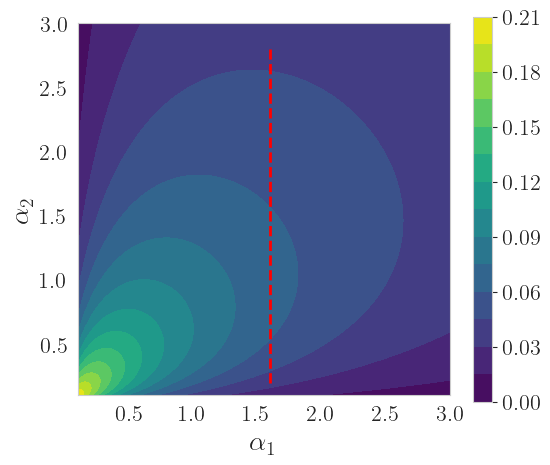

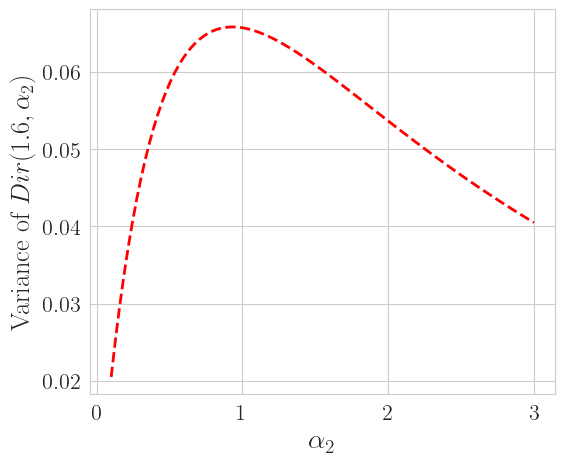

In [4]:
alphas, betas = np.linspace(0.1, 3, 101), np.linspace(0.1, 3, 101)
aa, bb = np.meshgrid(alphas, betas)
vv = (aa * bb)/((aa + bb)**2. * (aa + bb + 1.0))

fig, ax = plt.subplots(figsize=(6,5))
h = ax.contourf(alphas, betas, vv, levels=16, cmap='viridis')
plt.axis('scaled')
cbar = plt.colorbar(h)
ticklabs = cbar.ax.tick_params(labelsize=16)
ax.set_xlabel(r"$\alpha_1$", fontsize=20)
ax.set_ylabel(r"$\alpha_2$", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)
ax.set_xticks([0.5, 1.0, 1.5, 2.0, 2.5, 3.0])
ax.plot([1.6, 1.6], [0.2, 2.8], "--", c='r', linewidth=2.0)
# ax.annotate(text=r"$\alpha$ const, vary $\beta$", xy=(1.7,2.7), fontsize=17, c='r')
plt.savefig(os.path.join(savedir,"var_line.png"), bbox_inches='tight', dpi=200)
plt.show()

alpha = 1.6
betas = np.linspace(0.1,3.0, 101)

def v(b):
    return (alpha*b)/((alpha + b)**2. * (alpha + b + 1.0))

fig, ax = plt.subplots(figsize=(6,5))
ax.plot(betas, v(betas), "--", linewidth=2.0, c='r')
ax.set_xlabel(r"$\alpha_2$", fontsize=20)
ax.set_ylabel(r"Variance of $Dir(1.6, \alpha_2)$", fontsize=19)
ax.tick_params(axis='both', which='major', labelsize=16)
plt.savefig(os.path.join(savedir, "vary_beta_plot.png"), bbox_inches='tight', dpi=200)
plt.show()

Num classes = 2
results/blobs_overall_100/dirichlet1000_stats.csv
['dirichletvar : dirichlet1000 : avg', 'dirichletvarprop : dirichlet1000 : avg', 'mcvopt : dirichlet1000 : avg', 'random : dirichlet1000 : avg', 'unc : laplace : avg']
['dirichletvar : dirichlet1000 : avg', 'dirichletvarprop : dirichlet1000 : avg', 'mcvopt : dirichlet1000 : avg', 'random : dirichlet1000 : avg', 'unc : laplace : avg']


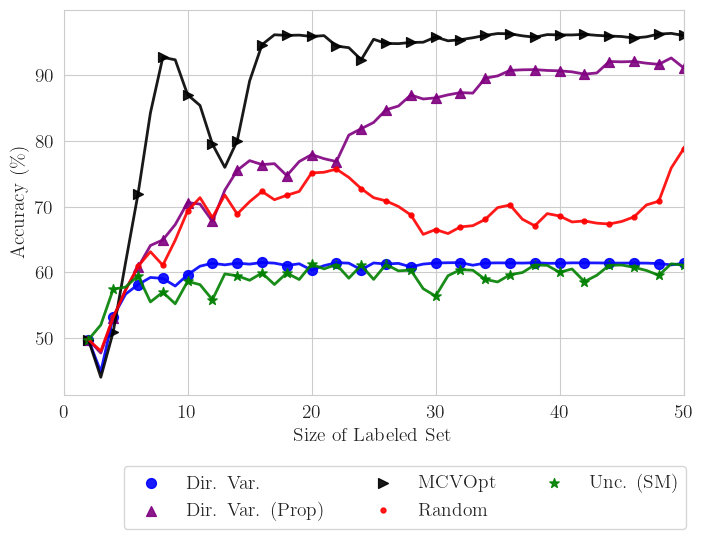

In [10]:
bbox_x = 1.2
bbox_x = 1.02 
plot_qualifier = '' 
resultsdir = "results"

acc_modelname = "dirichlet1000"

acq_to_show = [ f"random : dirichlet1000", "dirichletvar : dirichlet1000", 
               'dirichletvarprop : dirichlet1000', 
               "soptfull : dirichlet1000", 
               "voptfull : dirichlet1000",
              "mcvopt : dirichlet1000",
               "unc : laplace"]

plot_acc(dataset="blobs", modelname=acc_modelname, resultsdir=resultsdir, metric='hsi',include_land=False,
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16),
                acq_to_show=acq_to_show, plot_qualifier=plot_qualifier, xmax=50)

Num classes = 6
results/salinassub_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']


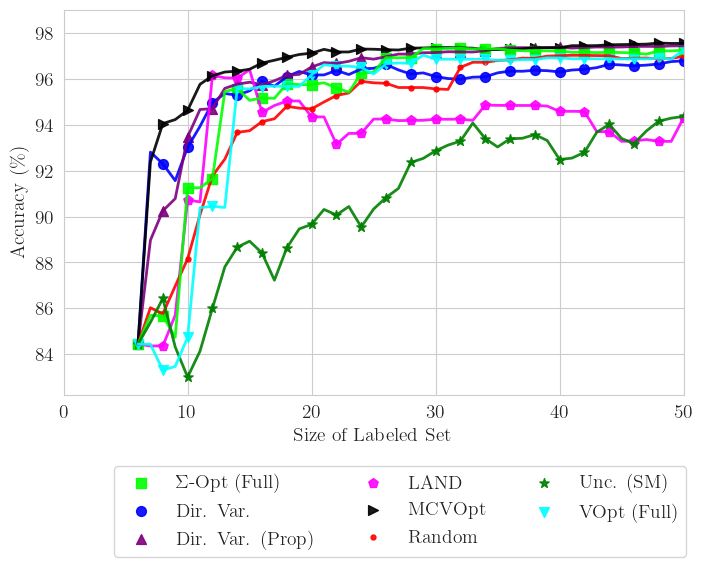

Num classes = 6
results/paviasub_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']


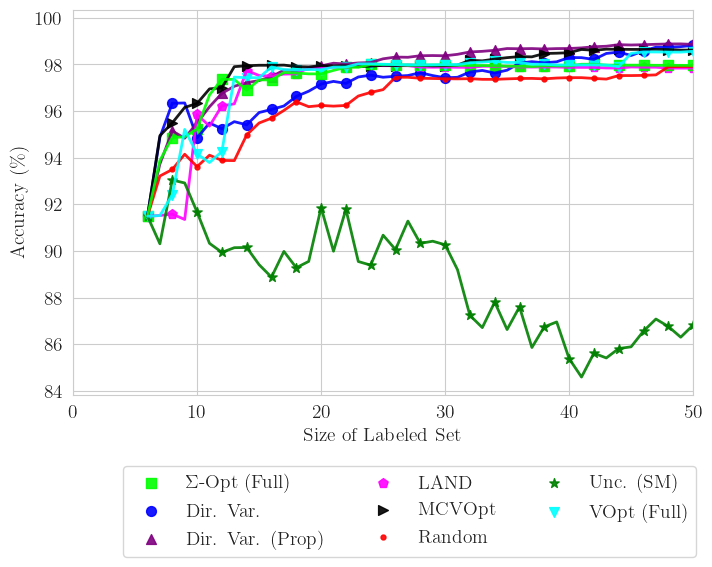

In [26]:
bbox_x = 1.2
bbox_x = 1.02 
plot_qualifier = '' 
resultsdir = "results"

acc_modelname = "dirichlet1000"

acq_to_show = [ f"random : dirichlet1000", "dirichletvar : dirichlet1000", 
               'dirichletvarprop : dirichlet1000', 
               "soptfull : dirichlet1000", 
               "voptfull : dirichlet1000",
              "mcvopt : dirichlet1000",
               "unc : laplace"]

plot_acc(dataset="salinassub", modelname=acc_modelname, resultsdir=resultsdir, metric='hsi',include_land=False,
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16),
                acq_to_show=acq_to_show+['land : land'], plot_qualifier=plot_qualifier, xmax=50)
plot_acc(dataset="paviasub", modelname=acc_modelname, resultsdir=resultsdir, metric='hsi',include_land=False,
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16),
                acq_to_show=acq_to_show+['land : land'], plot_qualifier=plot_qualifier, xmax=50)


Num classes = 3
results/mnistsmall-mod3_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']


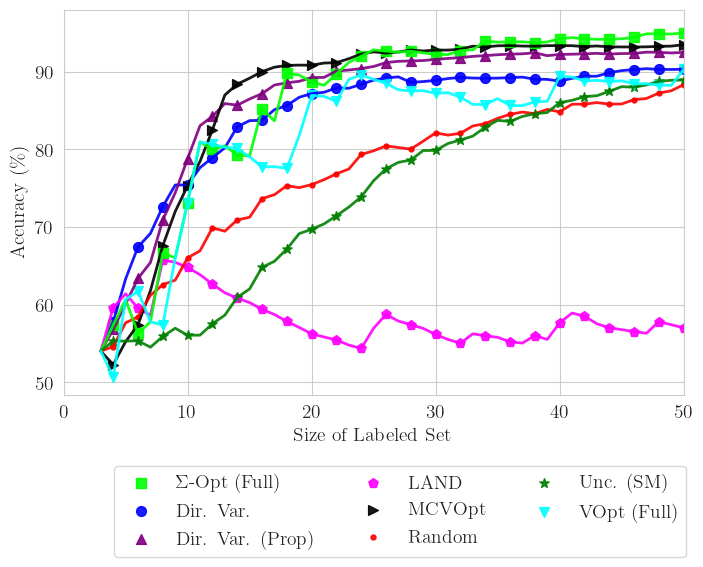

[0 1 2 3 4 5 6 7 8 9]
260


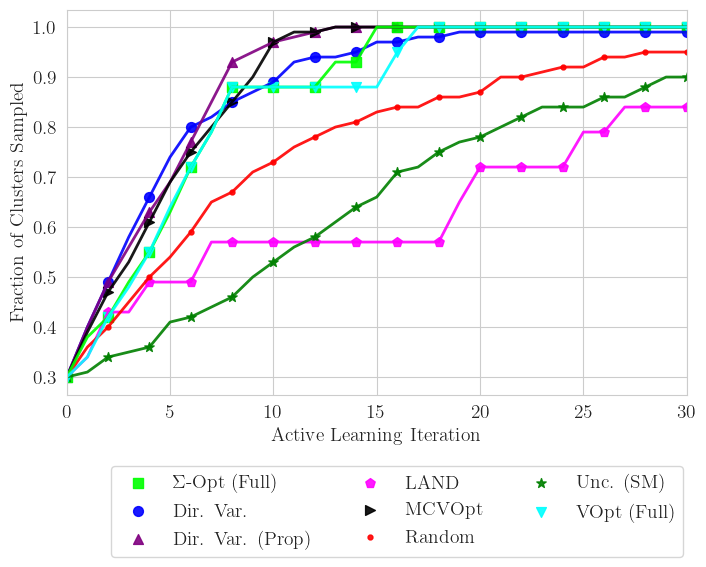

In [27]:
plot_acc(dataset="mnistsmall-mod3", modelname=acc_modelname, resultsdir=resultsdir, include_land=False,
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16),
                acq_to_show=acq_to_show + ['land : land'], plot_qualifier=plot_qualifier, xmax=50)
plot_cluster_exploration(dataset="mnistsmall", resultsdir="results", savedir=savedir, problem="mod3", 
                xmax=30, plot_qualifier=plot_qualifier, cols_to_plot=["_".join(thing.split(" : ")) for thing in acq_to_show],
                ncol=3,bbox_to_anchor=(1.01, -0.16), include_land=True)

Num classes = 3
results/fashionmnistsmall-mod3_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'land : land : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'soptfull : beta1000 : avg', 'unc : laplace : avg', 'voptfull : beta1000 : avg']


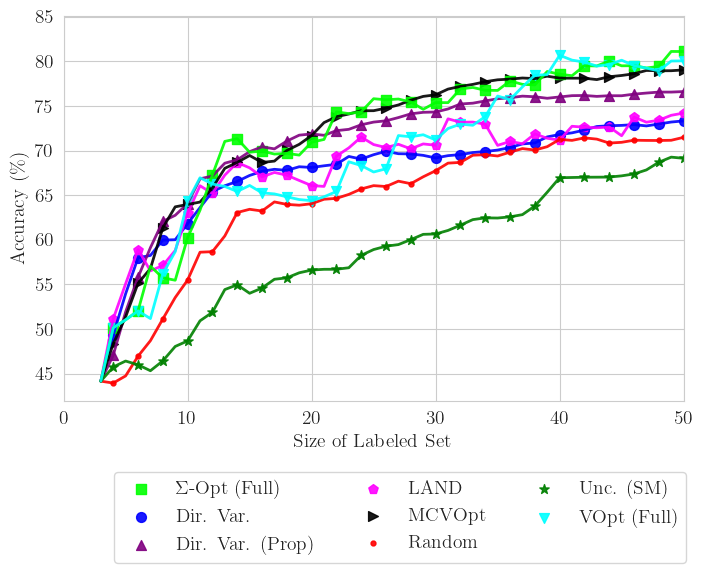

[0 1 2 3 4 5 6 7 8 9]
260


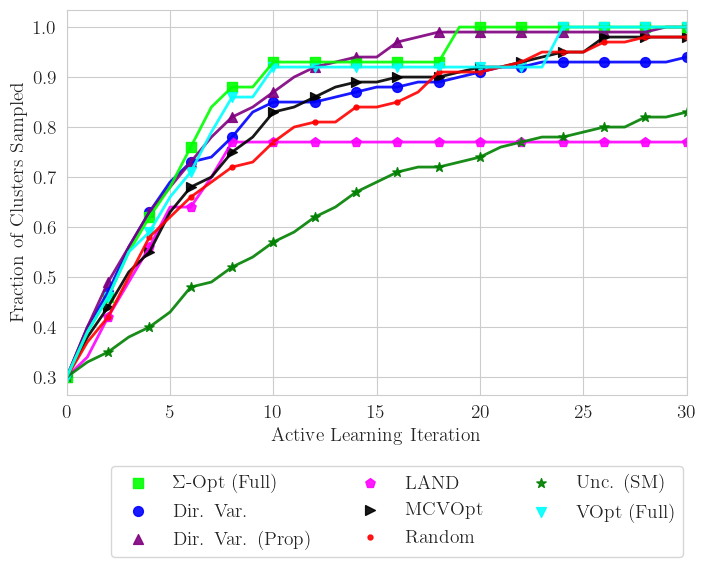

In [28]:
plot_acc(dataset="fashionmnistsmall-mod3", modelname=acc_modelname, resultsdir=resultsdir, include_land=False,
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16),
                acq_to_show=acq_to_show + ['land : land'], plot_qualifier=plot_qualifier, xmax=50)
plot_cluster_exploration(dataset="fashionmnistsmall", resultsdir="results", savedir=savedir, problem="mod3", 
                xmax=30, plot_qualifier=plot_qualifier, cols_to_plot=["_".join(thing.split(" : ")) for thing in acq_to_show],
                ncol=3,bbox_to_anchor=(1.01, -0.16), include_land=True)

## Larger Datasets

In [32]:
acq_to_show = [ f"random : beta0100", 
            "betavar : dirichleteps1000", 'betavarprop : dirichleteps1000', 
                   "vopt : beta1000", "sopt : beta1000", 
#                "soptfull : beta1000", 
#                "voptfull : beta1000",
                "mcvopt : beta1000",
               "unc : laplace", 
#                "mcvopt : rwll"
                  ]


Num classes = 3
results/mnist-mod3_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'sopt : beta1000 : avg', 'unc : laplace : avg', 'vopt : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'sopt : beta1000 : avg', 'unc : laplace : avg', 'vopt : beta1000 : avg']


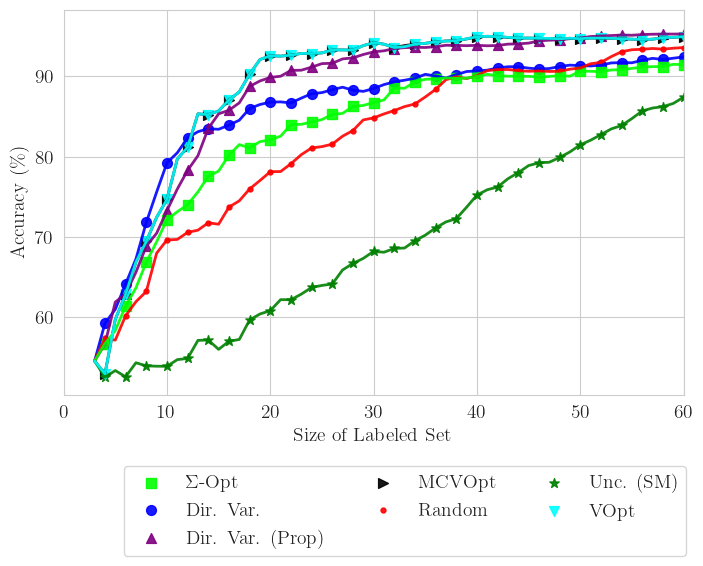

[0 1 2 3 4 5 6 7 8 9]
170


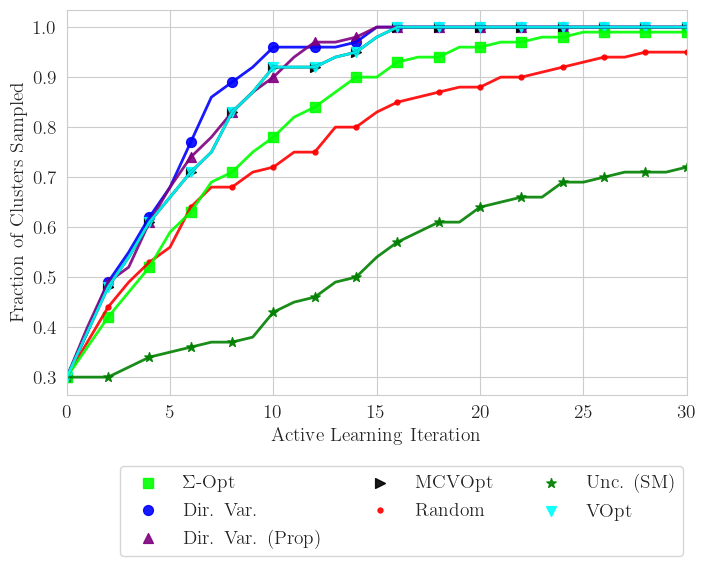

In [33]:
plot_acc(dataset="mnist-mod3", modelname=acc_modelname, resultsdir=resultsdir, 
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16), xmax=60,
                acq_to_show=acq_to_show, plot_qualifier=plot_qualifier)
plot_cluster_exploration(dataset="mnist", resultsdir="results", savedir=savedir, problem="mod3",
                            xmax=30, plot_qualifier=plot_qualifier, cols_to_plot=["_".join(thing.split(" : ")) for thing in acq_to_show],
                            ncol=3,bbox_to_anchor=(1.01, -0.16))

Num classes = 3
results/fashionmnist-mod3_overall_100/beta1000_stats.csv
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'sopt : beta1000 : avg', 'unc : laplace : avg', 'vopt : beta1000 : avg']
['betavar : betaeps1000 : avg', 'betavarprop : betaeps1000 : avg', 'mcvopt : beta1000 : avg', 'random : beta0100 : avg', 'sopt : beta1000 : avg', 'unc : laplace : avg', 'vopt : beta1000 : avg']


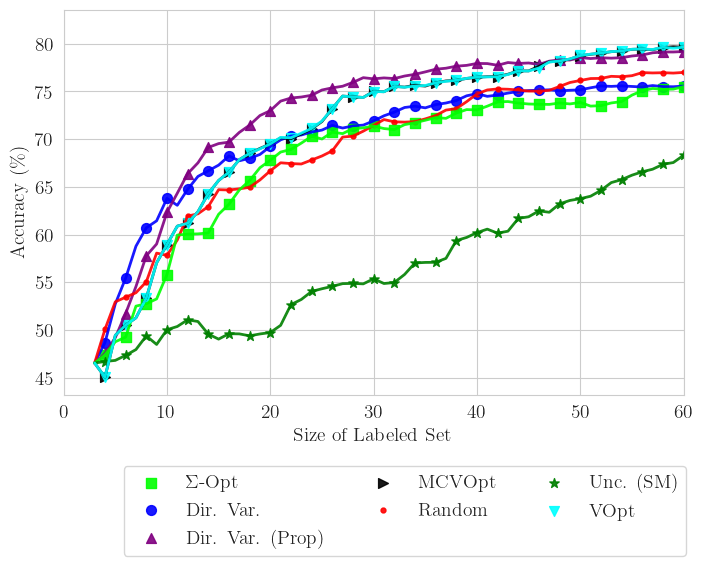

[0 1 2 3 4 5 6 7 8 9]
170


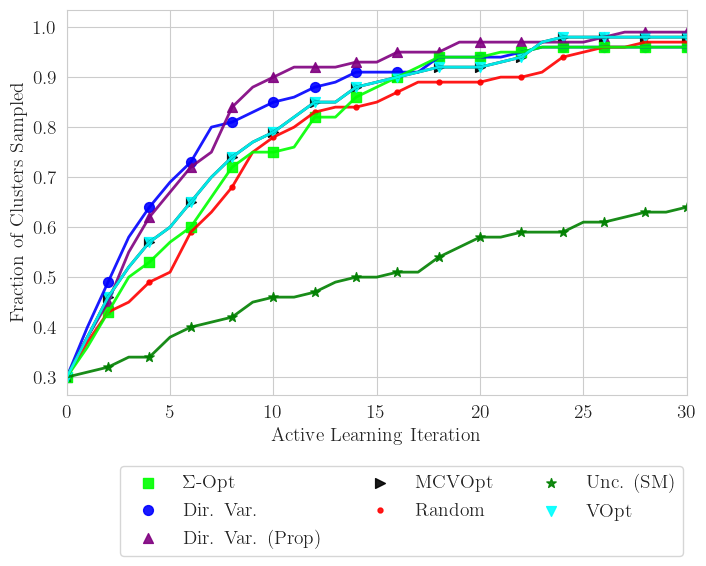

In [34]:
plot_acc(dataset="fashionmnist-mod3", modelname=acc_modelname, resultsdir=resultsdir, 
                  savedir=savedir, ymin=50, bbox_to_anchor=(bbox_x,-0.16), xmax=60,
                acq_to_show=acq_to_show, plot_qualifier=plot_qualifier)
plot_cluster_exploration(dataset="fashionmnist", resultsdir="results", savedir=savedir, problem="mod3",
                            xmax=30, plot_qualifier=plot_qualifier, cols_to_plot=["_".join(thing.split(" : ")) for thing in acq_to_show],
                            ncol=3,bbox_to_anchor=(1.01, -0.16))

## Examples of Propagations

In [35]:
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.datasets import make_moons

In [272]:
X, labels = make_moons(5000, noise=0.13, shuffle=False)

In [273]:
X[labels == 1] -= np.array([[0, 0.3]])

In [274]:
Xminmin = np.min(X, axis=0)
X -= Xminmin

In [275]:
Xmaxmax = np.max(X, axis=0)
X[:,0] = X[:,0] / Xmaxmax[0]
X[:,1] = X[:,1] / Xmaxmax[1]

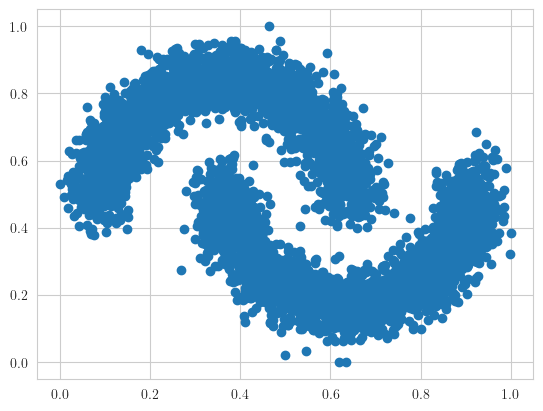

In [285]:
plt.scatter(X[:,0], X[:,1])
plt.show()

In [286]:
n = 100

In [287]:
from scipy.stats import gaussian_kde

In [293]:
xmax, xmin, ymax, ymin = 1.01, -0.01, 1.01, -0.01

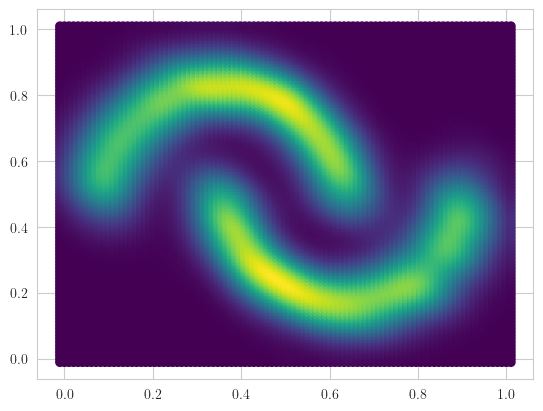

In [294]:
kde = gaussian_kde(X.T, bw_method=0.19)
xx, yy = np.linspace(xmin,xmax,n+1), np.linspace(xmin,xmax,n+1)
XX, YY = np.meshgrid(xx, yy)
positions = np.vstack([XX.T.ravel(), YY.T.ravel()])
rho = np.reshape(kde(positions).T, XX.shape)


plt.scatter(XX.T, YY.T, c=rho.ravel(),cmap='viridis')
plt.show()

In [295]:
rho.min()

1.8404979686882392e-28

0.6428 0.5918 2.972081400497039 3.8604565885310573 1.8404979686882392e-28


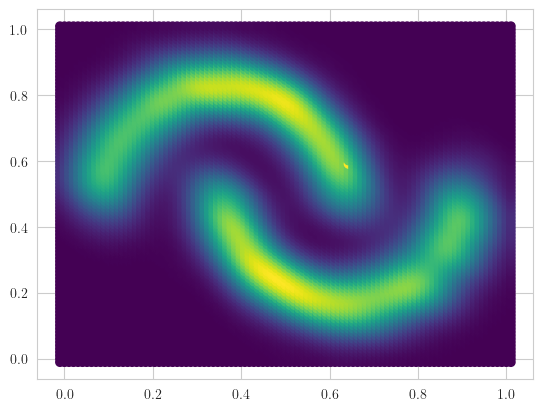

In [296]:
i_source, j_source = 64, 59
print(xx[i_source], yy[j_source], rho[i_source, j_source], rho.max(), rho.min())
rho += 1e-4

rho_ = rho.copy()
rho_[i_source, j_source] = rho_.max()
plt.scatter(positions.T[:,0], positions.T[:,1], c=rho_.ravel(), cmap='viridis')
plt.show()

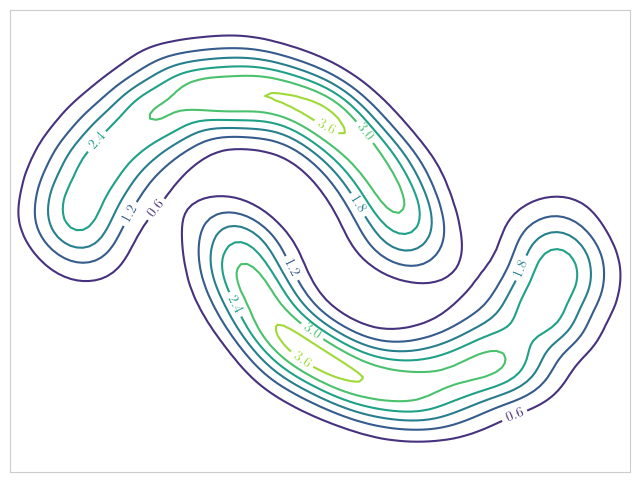

In [298]:
fig, ax = plt.subplots(figsize=(8,6))
CS = ax.contour(XX, YY, rho.T, levels=6, cmap='viridis')
ax.clabel(CS, inline=1, fontsize=10)
ax.xaxis.grid(False)
ax.yaxis.grid(False)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlim(xmin-0.01, xmax+0.01)
ax.set_ylim(ymin-0.01, ymax+0.01)
plt.savefig(os.path.join(savedir, "twomoons_kde.png"), bbox_inches='tight', dpi=200)
plt.show()



In [299]:
import scipy.sparse as sparse

In [300]:
def get_inds(i,j):
    return (i + j*(n+1),       # center
            i + (j+1)*(n+1),   # up
            i + (j-1)*(n+1),   # down
            i + 1 + j*(n+1),   # right
            i - 1 + j*(n+1))   # left 

tau = 0.00075
laplace = False
dd = xx[1] - xx[0]
assert (yy[1] - yy[0]) == dd

A = np.zeros(((n+1)**2, (n+1)**2))
for i in range(n+1):
    for j in range(n+1):
        c, u, d, r, l = get_inds(i,j)
        A[c, c] += -4.*rho[i,j]  - tau
        if i == 0:
            A[c, r] += 2.*rho[i,j]
            if j == 0:  # bottom left corner
                A[c, u] += 2.*rho[i,j]
            elif j == n: # top left corner
                A[c, d] += 2.*rho[i,j]
            else:        # left side
                rho_y = (rho[i, j+1] - rho[i,j-1])/2.     # divide by 2 to accomodate centered diff
                A[c, u] += rho[i,j] + rho_y
                A[c, d] += rho[i,j] - rho_y
                
        elif i == n:
            A[c, l] += 2.*rho[i,j]
            if j == 0:   # bottom right corner
                A[c, u] += 2.*rho[i,j]
            elif j == n:   # top right corner
                A[c, d] += 2.*rho[i,j]
            else:         # right side
                rho_y = (rho[i, j+1] - rho[i,j-1])/2.     # divide by 2 to accomodate centered diff
                A[c, u] += rho[i,j] + rho_y
                A[c, d] += rho[i,j] - rho_y
                
        else:
            rho_x = (rho[i+1,j] - rho[i-1,j])/2.     # divide by 2 to accomodate centered diff
            A[c, l] += rho[i,j] - rho_x
            A[c, r] += rho[i,j] + rho_x
            
            if j == 0:   # bottom side
                A[c, u] += 2.*rho[i,j]
                
            elif j == n:   # top side 
                A[c, d] += 2.*rho[i,j]
            else:          # middle
                rho_y = (rho[i, j+1] - rho[i,j-1])/2.
                A[c, u] += rho[i,j] + rho_y
                A[c, d] += rho[i,j] - rho_y
        

    
if laplace:
    # zero out the source point's row and set diagonal element to 1 since will have this be the source point
    c, _, _, _, _ = get_inds(i_source, j_source)
    A[c,:] = 0.0
    A[c,c] = dd**2.


    # RHS is just indicator on source point.
    b = np.zeros(A.shape[0])
    b[c] = dd**2.
else:
    gamma = 0.00008
    b = np.zeros(A.shape[0])
    c, u, d, r, l = get_inds(i_source, j_source)
    b[c] = 1.0
    b[np.array([u, d, r, l])] = np.exp(-dd**2./gamma)
    b[np.array([u+1, u-1, d+1, d-1])] =  np.exp(-np.sqrt(2)*dd**2./gamma)
    print(b[b > 0])
    print(b[c])
    b[b > 0] *= dd**2.

[0.15894696 0.27239556 0.15894696 0.27239556 1.         0.27239556
 0.15894696 0.27239556 0.15894696]
1.0


In [301]:
A = sparse.csr_matrix(A)
u = sparse.linalg.spsolve(A, b)
u *= np.sign(np.min(u))
u -= u.min()
u /= u.max()
U = u.reshape(rho.shape)

In [302]:
u.min(), u.max()

(0.0, 1.0)

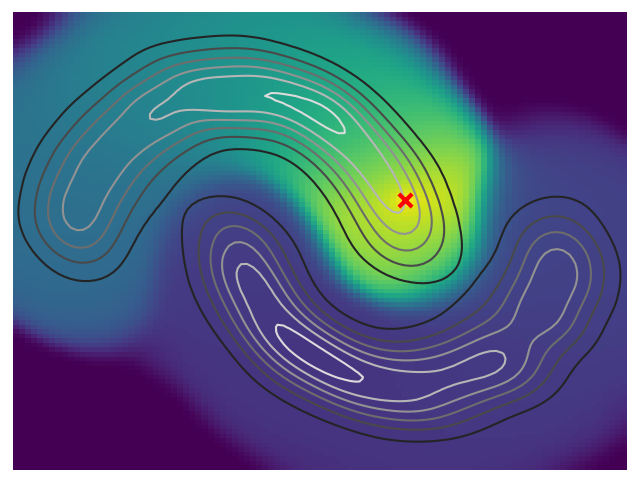

In [303]:
fig, ax = plt.subplots(figsize=(8,6))
ax.pcolormesh(XX, YY, U, cmap='viridis')
# CS = ax.contour(XX, YY, rho.T, levels=8, cmap='Blues')
# plt.scatter(X[:,0], X[:,1], marker='.', c='cyan', s=20, alpha=0.1)
# ax.clabel(CS, inline=1, fontsize=10)
CS = ax.contour(XX, YY, rho.T, levels=6, cmap='binary_r')
plt.scatter(xx[i_source], yy[j_source], marker='x', c='r', s=90, linewidth=3, zorder=10)
# ax.set_title("Poisson PDE")
# plt.axis("square")
ax.axis('off')
ax.set_xlim(xmin-0.01, xmax+0.01)
ax.set_ylim(ymin-0.01, ymax+0.01)
plt.savefig(os.path.join(savedir, "twomoons_cntm_poisson_prop.png"), bbox_inches='tight', dpi=200)
plt.show()


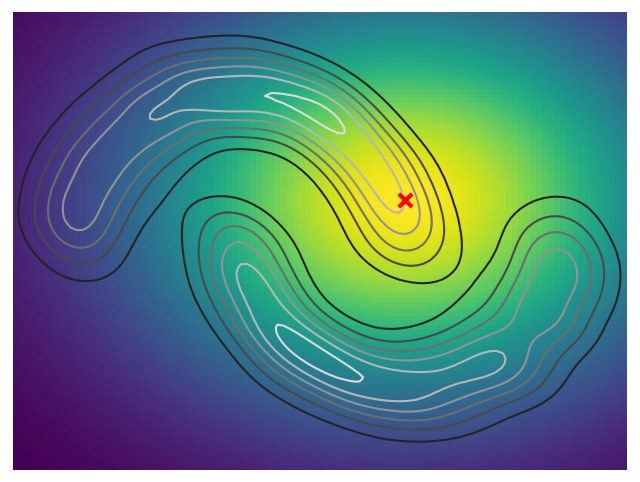

In [304]:
K = rbf_kernel(positions.T, np.array([[xx[i_source], yy[j_source]]]), gamma=5.0)
fig, ax = plt.subplots(figsize=(8,6))
ax.pcolormesh(XX, YY, K.reshape(XX.shape).T, cmap='viridis')
# CS = ax.contour(XX, YY, K.reshape(XX.shape).T, levels=[0.05,0.2,0.5,0.7,0.85], cmap='Blues')
# ax.clabel(CS, inline=1, fontsize=10)
CS = ax.contour(XX, YY, rho.T, levels=6, cmap='binary_r')
plt.scatter(xx[i_source], yy[j_source], marker='x', c='r', s=90, linewidth=3, zorder=10)
# ax.clabel(CS, inline=1, fontsize=10)
# ax.set_title("RBF")
ax.axis('off')
# plt.axis('square')
ax.set_xlim(xmin-0.01, xmax+0.01)
ax.set_ylim(ymin-0.01, ymax+0.01)
plt.savefig(os.path.join(savedir,"twomoons_rbf_prop.png"), bbox_inches='tight', dpi=200)
plt.show()

## Graph based

In [305]:
from sklearn.metrics import pairwise_distances
from utils import *

In [306]:
# downsample
subset_inds = np.random.choice(np.arange(X.shape[0]), 1600, replace=False)
X_ = X[subset_inds]

In [307]:
W = gl.weightmatrix.knn(X_, k=20)
G = gl.graph(W)

In [308]:
x_source = np.array([xx[i_source], yy[j_source]])
idx = np.argmin(pairwise_distances(X_, x_source[np.newaxis,:]))

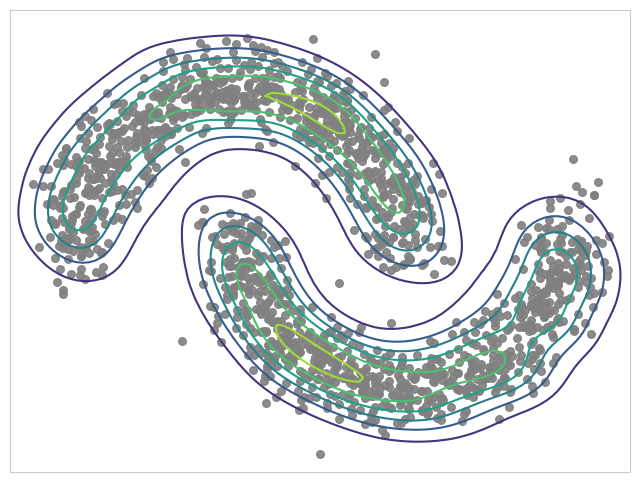

In [309]:
fig, ax = plt.subplots(figsize=(8,6))
ax.scatter(X_[:,0], X_[:,1], c='gray', s=30, alpha=0.9)
# ax.scatter(xx[i_source], yy[j_source], marker='x', c='k', s=40)
CS = ax.contour(XX, YY, rho.T, levels=6, cmap='viridis')
# ax.scatter(X_[idx,0], X_[idx,1], marker='x', c='r', s=90, linewidth=3)
ax.xaxis.grid(False)
ax.yaxis.grid(False)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlim(xmin-0.01, xmax+0.01)
ax.set_ylim(ymin-0.01, ymax+0.01)
plt.savefig(os.path.join(savedir, "twomoons_gb_sample.png"),bbox_inches='tight', dpi=200)
plt.show()

In [310]:
beta = beta_learning(G, tau=0.0005)
g = beta.poisson_prop(np.array([idx]))
g -= g.min()
g /= g.max()

In [311]:
g.min(), g.max()

(0.0, 1.0)

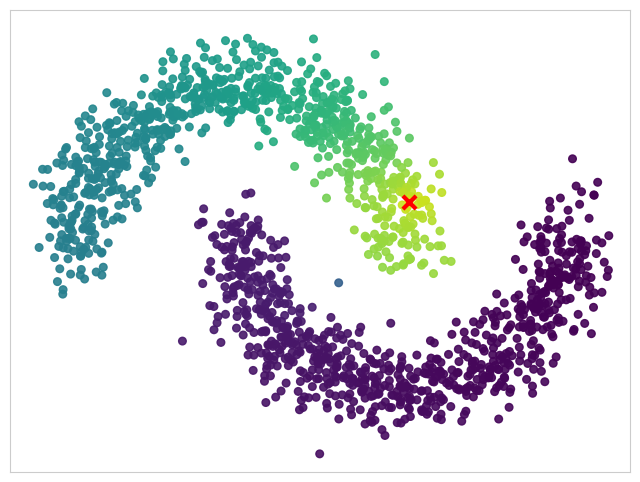

In [312]:
fig, ax = plt.subplots(figsize=(8,6))
p = ax.scatter(X_[:,0], X_[:,1], c=g, s=30, cmap='viridis', alpha=0.9)
ax.scatter(X_[idx,0], X_[idx,1], marker='x', c='r', s=90, linewidth=3)
# plt.colorbar(p)
# ax.set_title("Poisson Graph-based Propagation")
ax.xaxis.grid(False)
ax.yaxis.grid(False)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlim(xmin-0.01, xmax+0.01)
ax.set_ylim(ymin-0.01, ymax+0.01)
plt.savefig(os.path.join(savedir, "twomoons_gb_poisson_prop.png"), bbox_inches='tight', dpi=200)
plt.show()

# Compare Dirichlet Learning to Other GBSSL models

In [5]:
from utils import beta_learning
from collections import defaultdict
import graphlearning as gl

In [643]:
dataset = "fashionmnist"
X, digits = gl.datasets.load(dataset, metric="vae")
labels = digits % 3
G = gl.graph.load(f"data/{dataset}_20")

In [644]:
models = [beta_learning(G, tau=0.1), beta_learning(G, tau=0.0), gl.ssl.laplace(G), 
          gl.ssl.laplace(G, reweighting='poisson'), gl.ssl.poisson(G), gl.ssl.multiclass_mbo(G)]
choices_fnames = glob(f"results/{dataset}-mod3_results_*_100/choices_betavarprop_betaeps1000.npy")

In [645]:
print(len(choices_fnames))

10


In [646]:
results = defaultdict(list)
for model in models:
    print(f"model = {model.name}")
    model_acc = []
    for it, fname in enumerate(choices_fnames[:5]):
        print(f"\t{it}")
        inds = np.load(fname)
        accs = []
        for n in [3,10,20, 50, 100]:
            u = model.fit(inds[:n], labels[inds[:n]])
            accs.append(gl.ssl.ssl_accuracy(model.predict(), labels, n))
        model_acc.append(accs)
    model_acc = np.array(model_acc)
    results[model.name] = np.average(model_acc, axis=0)
            

model = Beta Learning, tau = 0.1
	0
	1
	2
	3
	4
model = Beta Learning, tau = 0.0
	0
	1
	2
	3
	4
model = Laplace Learning
	0
	1
	2
	3
	4
model = Laplace Learning: poisson reweighted
	0
	1
	2
	3
	4
model = Poisson Learning
	0
	1
	2
	3
	4
model = Multiclass MBO
	0
	1
	2
	3
	4


,"Beta Learning, tau = 0.1","Beta Learning, tau = 0.0",Laplace Learning,Reweighted Laplace Learning,Poisson Learning,Multiclass MBO
3,49.199537,42.205809,32.525965,48.684944,49.836136,33.593725
10,62.350622,50.584369,32.119160,59.821975,64.092299,33.005001
20,74.001429,65.194913,40.667334,73.177765,70.239211,39.585024
50,79.614868,72.238742,49.883059,80.319657,76.748821,35.430736
100,81.782546,76.618598,70.698140,82.879542,81.002861,45.457225


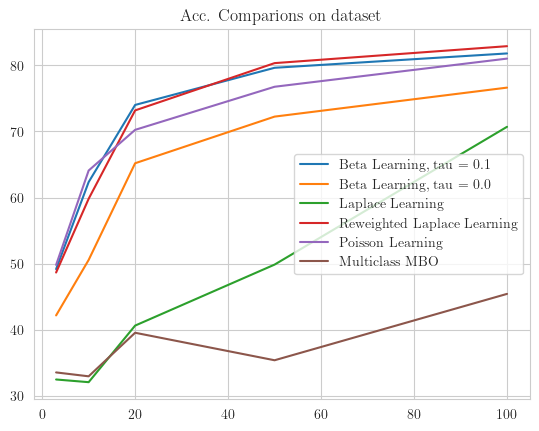

In [647]:
df_ = pd.DataFrame(results)
df_.rename(columns={'Laplace Learning: poisson reweighted': "Reweighted Laplace Learning"}, inplace=True)
df_.rename(index={0:3, 1:10, 2:20, 3:50, 4:100}, inplace=True)
display(df_.head())
df_.plot(title="Acc. Comparions on {dataset}")
plt.show()

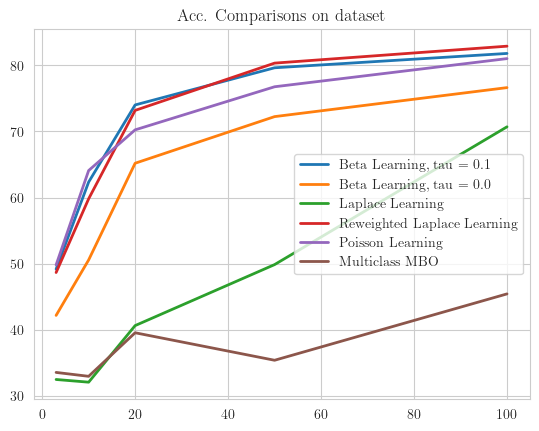

In [648]:
df_.plot(title="Acc. Comparisons on {dataset}", linewidth=2.0)
plt.show()

# Timing

In [140]:
import numpy as np
import matplotlib.pyplot as plt
import graphlearning as gl
from collections import defaultdict

In [141]:
from acquisitions import voptfull, soptfull, betavar, betavarprop
from test_al_beta import get_active_learner
from utils import beta_learning
from graphlearning.active_learning import uncertainty_sampling as unc
from sklearn.metrics.pairwise import rbf_kernel
from graphlearning.active_learning import model_change_vopt as mc_vopt

In [142]:
from time import time, perf_counter
from sklearn.datasets import make_blobs

In [53]:
class ALArgument(object):
    def __init__(self):
        self.gamma = None
        return
args = ALArgument()
args.gamma = 0.001

In [55]:
from tqdm import tqdm

In [60]:
RESULTS = {}

In [61]:
num_runs = 10
normalization = 'combinatorial'

for N in [1000, 5000, 10000, 20000]:
    print(N)
    X, clusters = make_blobs([int(N*0.4), int(N*0.1), int(N*0.1), int(N*0.2), int(N*0.2)], n_features=30)
    denseC = rbf_kernel(X, X, gamma=0.1)
    y = clusters % 2

    W = gl.weightmatrix.knn(X, k=20)
    G = gl.graph(W)
    
    train_ind = gl.trainsets.generate(y, 1)
    nc = np.unique(y).size
    
    results = defaultdict(dict)
    
    for acq_func_name, acq_f in tqdm(zip(['betavar','voptfull', 'betavarprop', 'unc', 'mcvopt'], 
                         [betavar, voptfull, betavarprop, unc, mc_vopt])):
        print(acq_func_name)
        if acq_func_name == 'voptfull':
            af_name = 'vopt'
        else:
            af_name = acq_func_name
        tic = perf_counter()
        al = get_active_learner(af_name, G, y, train_ind, normalization, args)
        toc = perf_counter()
        if acq_func_name in ['voptfull', 'soptfull']:
            print(f"Time to calculate C = {toc -tic}")

        if acq_func_name == 'voptfull':
            al.fullC = denseC.copy()
        acq = acq_f()
        if acq_func_name == 'betavarprop':
            acq.K = 10

        model = beta_learning(G, tau=0.01)
        u = model.fit(al.current_labeled_set, al.current_labels)
        
        
        print("\tstarting timing runs")
        time_runs = np.array([])
        for r in range(num_runs):
            tic = perf_counter()
            vals = acq.compute_values(al, u)
            toc = perf_counter()
            time_runs = np.append(time_runs, toc-tic)
        results[acq_func_name] = {'time':time_runs.mean(), 'std':time_runs.std()}
    
    RESULTS[str(N)] = results

500


2it [00:00, 15.89it/s]

betavar
	starting timing runs
voptfull
gamma = 0.001
vopt, 100
Time to calculate C = 0.10255400300957263
	starting timing runs
betavarprop
	starting timing runs
unc
	starting timing runs
mcvopt
gamma = 0.001


5it [00:00, 19.33it/s]


mcvopt, 100
	starting timing runs
1000



0it [00:00, ?it/s]

betavar
	starting timing runs
voptfull
gamma = 0.001
vopt, 100
Time to calculate C = 0.18162354407832026



2it [00:00,  8.19it/s]

	starting timing runs
betavarprop
	starting timing runs
unc
	starting timing runs
mcvopt
gamma = 0.001


5it [00:00, 10.37it/s]

mcvopt, 100
	starting timing runs
5000



0it [00:00, ?it/s]

betavar
	starting timing runs
voptfull
gamma = 0.001
vopt, 100
Time to calculate C = 0.7427083901129663
	starting timing runs



2it [00:02,  1.09s/it]

betavarprop
	starting timing runs
unc
	starting timing runs
mcvopt
gamma = 0.001


5it [00:03,  1.57it/s]

mcvopt, 100
	starting timing runs
10000



0it [00:00, ?it/s]

betavar
	starting timing runs
voptfull
gamma = 0.001
vopt, 100
Time to calculate C = 2.0080687950830907
	starting timing runs


3it [00:08,  2.58s/it]

betavarprop
	starting timing runs
unc
	starting timing runs
mcvopt
gamma = 0.001
mcvopt, 100
	starting timing runs


5it [00:11,  2.25s/it]


20000



0it [00:00, ?it/s]

betavar
	starting timing runs



1it [00:00,  4.87it/s]

voptfull
gamma = 0.001
vopt, 100
Time to calculate C = 6.182203141972423
	starting timing runs



2it [00:33, 19.80s/it]

betavarprop



3it [00:33, 10.86s/it]

	starting timing runs
unc



4it [00:34,  6.65s/it]

	starting timing runs
mcvopt
gamma = 0.001
mcvopt, 100
	starting timing runs


5it [00:41,  8.24s/it]


In [63]:
for N, res in RESULTS.items():
    print(f"N = {N}")
    for af_name, times in res.items():
        print(f"\taf = {af_name}, time = {times['time']:.6f}, std = {times['std']:.6f}")

N = 500
	af = betavar, time = 0.000034, std = 0.000004
	af = voptfull, time = 0.000594, std = 0.000126
	af = betavarprop, time = 0.000255, std = 0.000021
	af = unc, time = 0.000025, std = 0.000004
	af = mcvopt, time = 0.001280, std = 0.000018
N = 1000
	af = betavar, time = 0.000045, std = 0.000003
	af = voptfull, time = 0.003652, std = 0.000060
	af = betavarprop, time = 0.000280, std = 0.000019
	af = unc, time = 0.000037, std = 0.000004
	af = mcvopt, time = 0.002490, std = 0.000022
N = 5000
	af = betavar, time = 0.000158, std = 0.000003
	af = voptfull, time = 0.133145, std = 0.000993
	af = betavarprop, time = 0.000511, std = 0.000020
	af = unc, time = 0.000139, std = 0.000008
	af = mcvopt, time = 0.011989, std = 0.000577
N = 10000
	af = betavar, time = 0.000305, std = 0.000012
	af = voptfull, time = 0.631544, std = 0.024718
	af = betavarprop, time = 0.000808, std = 0.000033
	af = unc, time = 0.000332, std = 0.000118
	af = mcvopt, time = 0.027020, std = 0.000511
N = 20000
	af = betavar,

In [143]:
import pandas as pd

In [149]:
df = pd.DataFrame({'betavar':[0.000034, 0.000045, 0.000158, 0.000305, 0.000663],
                  'voptfull':[0.000594, 0.003652, 0.133145, 0.631544, 2.643358],
                  'betavarprop':[0.000255, 0.000280, 0.000511, 0.000808, 0.001478],
                  'unc': [0.000025, 0.000037, 0.000139, 0.000332, 0.000564],
                  'mcvopt': [0.001280, 0.002490, 0.011989, 0.027020, 0.056409]})
df.index = [500, 1000, 5000, 10000, 20000]
display(df.head())



,betavar,voptfull,betavarprop,unc,mcvopt
500,0.000034,0.000594,0.000255,0.000025,0.001280
1000,0.000045,0.003652,0.000280,0.000037,0.002490
5000,0.000158,0.133145,0.000511,0.000139,0.011989
10000,0.000305,0.631544,0.000808,0.000332,0.027020
20000,0.000663,2.643358,0.001478,0.000564,0.056409


In [70]:
time_results = {n : {af_name: v['time'] for af_name, v in res.items()} for n, res in RESULTS.items()}
std_results = {n : {af_name: v['std'] for af_name, v in res.items()} for n, res in RESULTS.items()}

In [107]:
df = pd.DataFrame(time_results).transpose()
df.index = df.index.astype(int)
df.head()

,betavar,voptfull,betavarprop,unc,mcvopt
500,0.000034,0.000594,0.000255,0.000025,0.001280
1000,0.000045,0.003652,0.000280,0.000037,0.002490
5000,0.000158,0.133145,0.000511,0.000139,0.011989
10000,0.000305,0.631544,0.000808,0.000332,0.027020
20000,0.000663,2.643358,0.001478,0.000564,0.056409


In [150]:
df = df[['betavar', 'betavarprop', 'voptfull', 'mcvopt', 'unc']]
df.rename(columns={'betavar':r'Dir.\,Var.\,', 'betavarprop':r'Dir.\,Var.\,(Prop)',
                  'unc':r'Unc.\,Sam.', 'voptfull':'VOpt', 'mcvopt':'MCVOpt'}, inplace=True)

df.to_csv(os.path.join(savedir, "timing.csv"))

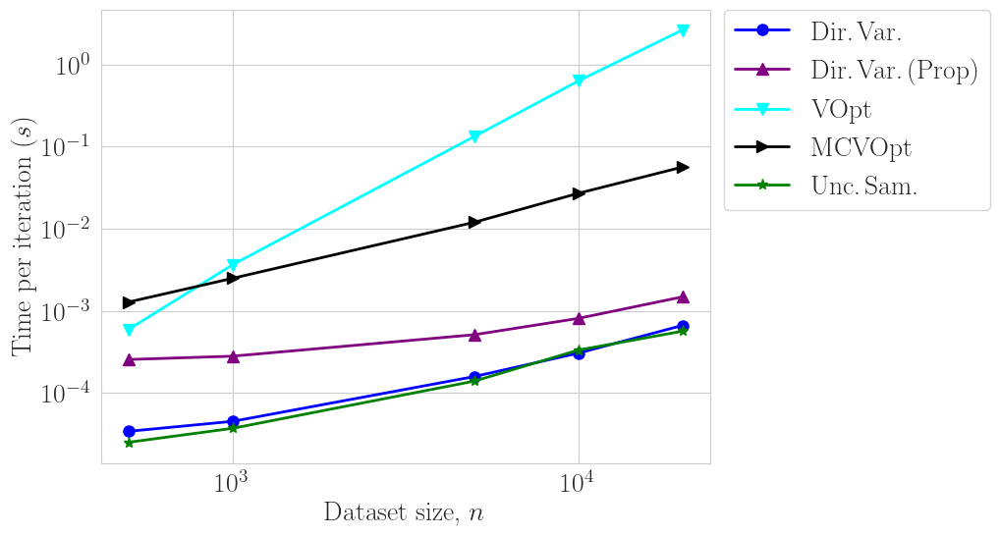

In [151]:
fig, ax = plt.subplots(figsize=(8,6))
df.plot(loglog=True, ax=ax, style=['o-', '^-', 'v-', '>-', '*-'], fontsize=20, 
        color=['b', 'purple', 'cyan', 'k', 'g'], linewidth=2, markersize=8)
# ax.set_title(r'Timing', fontsize=20)
ax.legend(fontsize=20, bbox_to_anchor=(1.,1.03))
ax.set_xlabel(r"Dataset size, $n$", fontsize=20)
ax.set_ylabel(r"Time per iteration $(s)$", fontsize=20)
plt.savefig(os.path.join(savedir, 'timing.png'), bbox_inches='tight', dpi=200)
plt.show()

## Uncertainty Demo

In [2]:
if not os.path.exists(os.path.join(savedir, "unc_demo_new")):
    os.makedirs(os.path.join(savedir, "unc_demo_new"))

In [7]:
from scipy.stats import norm
from scipy.integrate import quad

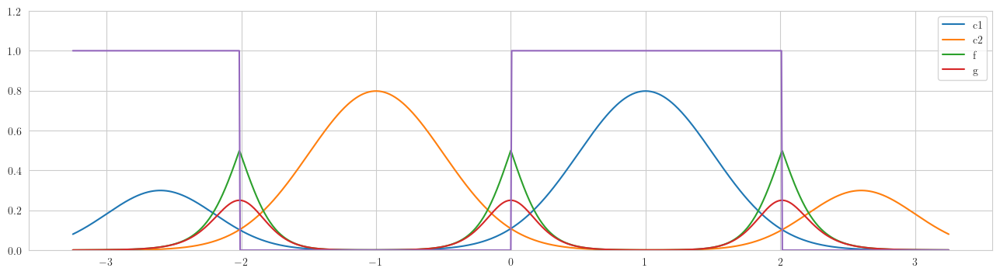

In [9]:
dist = 2.0
sig = 0.1
eps = 0.0
dom = np.linspace(-3.25, 3.25, 1001)

p1 = norm.pdf(dom, loc=-1.3*dist, scale=0.3+sig)
p2 = norm.pdf(dom, loc=-.5*dist, scale=0.4+sig)
p3 = norm.pdf(dom, loc=.5*dist, scale=0.4+sig)
p4 = norm.pdf(dom, loc=1.3*dist, scale=0.3+sig)

c1 =  0.3*p1+p3+eps
c2 =  p2+0.3*p4+eps
y_lab = 1*(c1 > c2)


f = np.minimum(c1, c2)/(c1 + c2) # min{ eta(x), 1 - eta(x)} == Bayes risk
g = c1*c2/((c1 + c2)**2.)        # eta(x)(1 - eta(x))

fig, ax = plt.subplots(figsize=(16,4))
plt.plot(dom, c1, label='c1')
plt.plot(dom, c2, label='c2')
plt.plot(dom, f, label='f')
plt.plot(dom, g, label='g')
plt.plot(dom, y_lab)
# plt.plot(dom, p3, label='p3')
# plt.plot(dom, p4, label='p4')
plt.legend()
plt.ylim(0, 1.2)
plt.show()

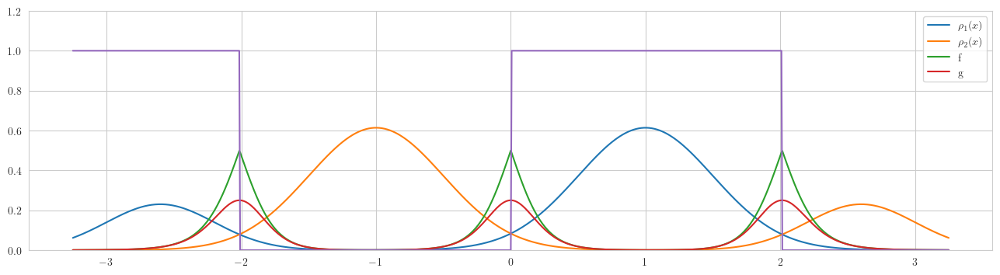

In [21]:
dist = 2.0
sig = 0.1
eps = 0.0
dom = np.linspace(-3.25, 3.25, 1001)

p1 = norm(loc=-1.3*dist, scale=0.3+sig)
p2 = norm(loc=-.5*dist, scale=0.4+sig)
p3 = norm(loc=.5*dist, scale=0.4+sig)
p4 = norm(loc=1.3*dist, scale=0.3+sig)

rho1 = lambda x: 0.3*p1.pdf(x) + p3.pdf(x) + eps
rho2 = lambda x: 0.3*p4.pdf(x) + p2.pdf(x) + eps
rho1Z = quad(rho1, -6, 6)[0]
rho2Z = quad(rho2, -6, 6)[0]
rho1 = lambda x: (0.3*p1.pdf(x) + p3.pdf(x) + eps) / rho1Z
rho2 = lambda x: (0.3*p4.pdf(x) + p2.pdf(x) + eps) / rho2Z

rho = lambda x: 0.5*(rho1(x) + rho2(x))

eta = lambda x: 0.5*rho1(x)/rho(x)

y_lab = 1*(rho1(dom) > rho2(dom))



f = np.minimum(eta(dom),1. - eta(dom)) # min{ eta(x), 1 - eta(x)} == Bayes risk
g = eta(dom)*(1. - eta(dom))        # eta(x)(1 - eta(x))

fig, ax = plt.subplots(figsize=(16,4))
plt.plot(dom, rho1(dom), label=r'$\rho_1(x)$')
plt.plot(dom, rho2(dom), label=r'$\rho_2(x)$')
plt.plot(dom, f, label='f')
plt.plot(dom, g, label='g')
plt.plot(dom, y_lab)
# plt.plot(dom, p3, label='p3')
# plt.plot(dom, p4, label='p4')
plt.legend()
plt.ylim(0, 1.2)
plt.show()

In [25]:
c1 = rho1(dom)
c2 = rho2(dom)

In [26]:
from sklearn.svm import SVC

[[-0.975]
 [ 0.975]] [0 1]


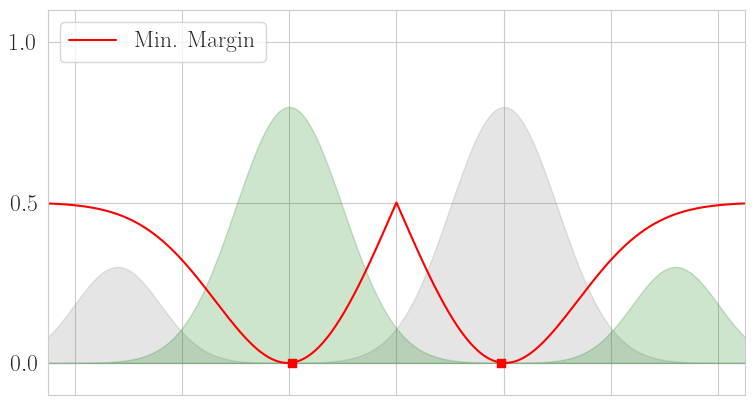

[[-0.975]
 [ 0.   ]
 [ 0.975]] [0 2 1]


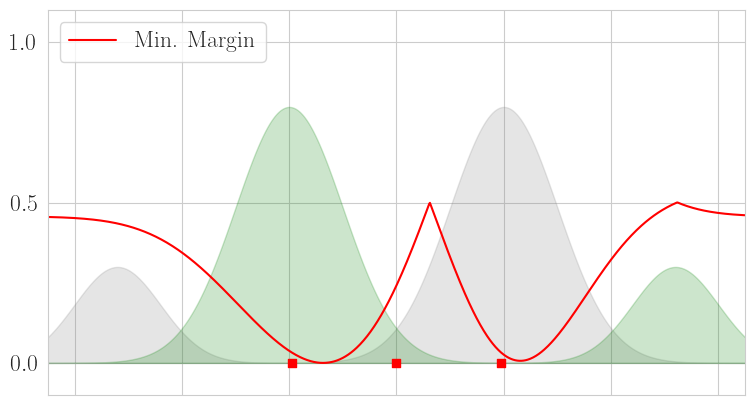

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 0.975 ]] [0 2 3 1]


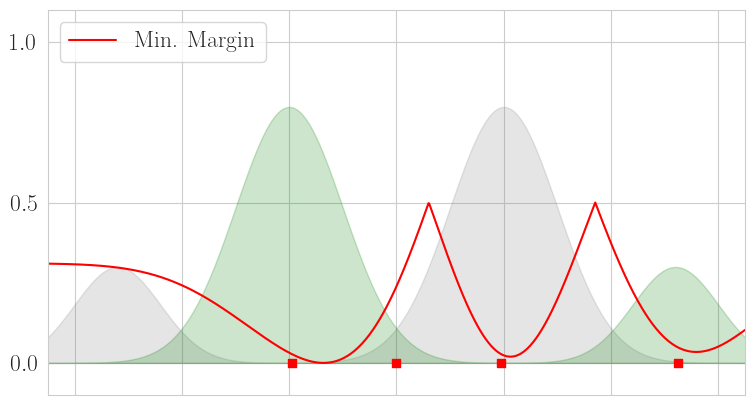

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 0.975 ]
 [ 1.8525]] [0 2 3 1 4]


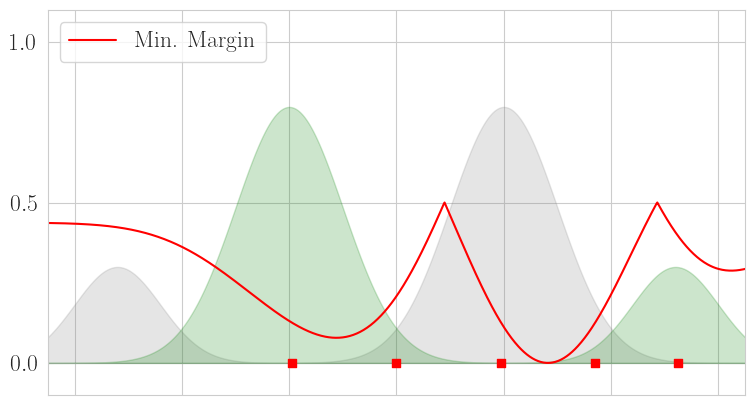

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [ 0.975 ]
 [ 1.8525]] [0 2 3 5 1 4]


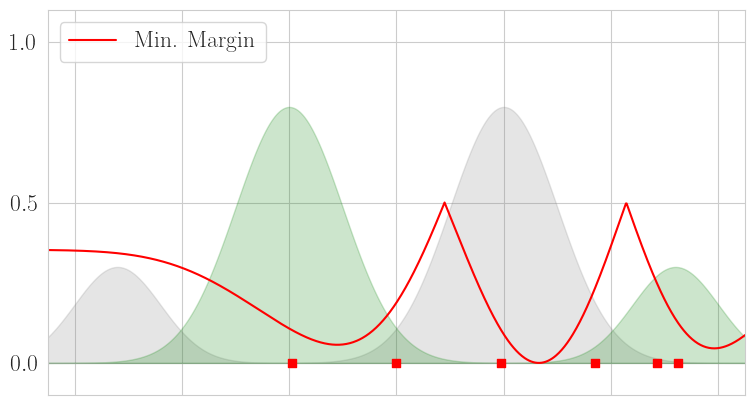

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [ 0.975 ]
 [ 1.8525]
 [ 0.4485]] [0 2 3 5 1 4 6]


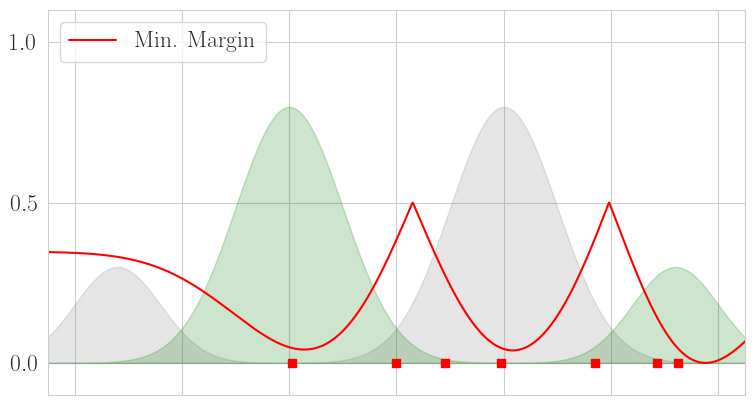

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [ 0.975 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]] [0 2 3 5 1 4 6 7]


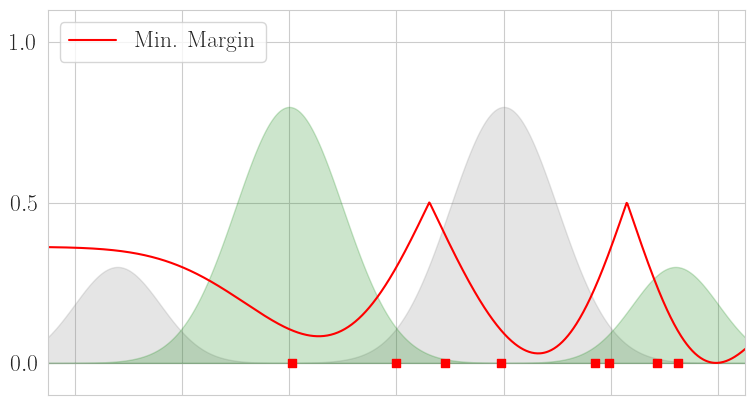

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]] [0 2 3 5 4 6 7 8]


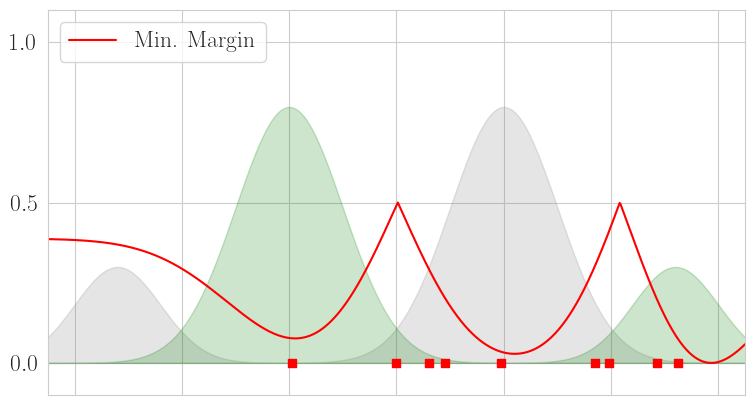

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]] [0 2 3 5 4 6 7 8 9]


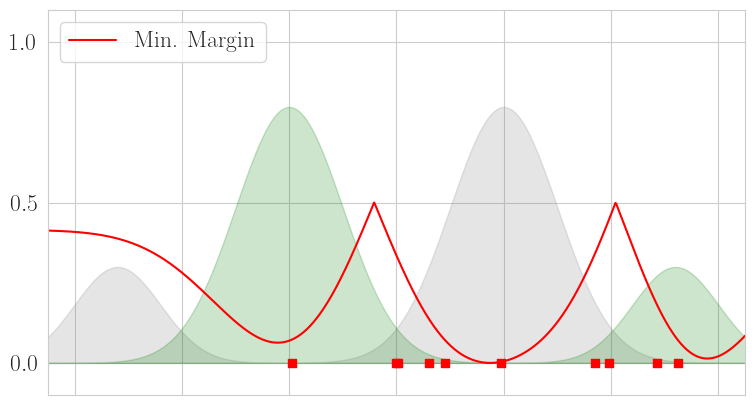

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]] [ 0  2  3  5 10  4  6  7  8  9]


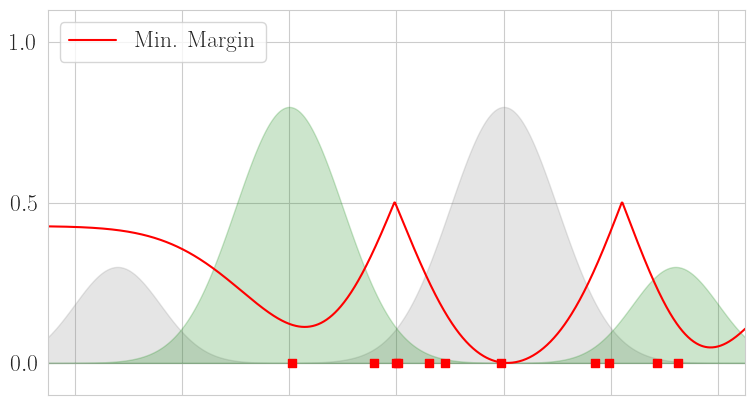

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]] [ 0  2  3  5 10 11  4  6  7  8  9]


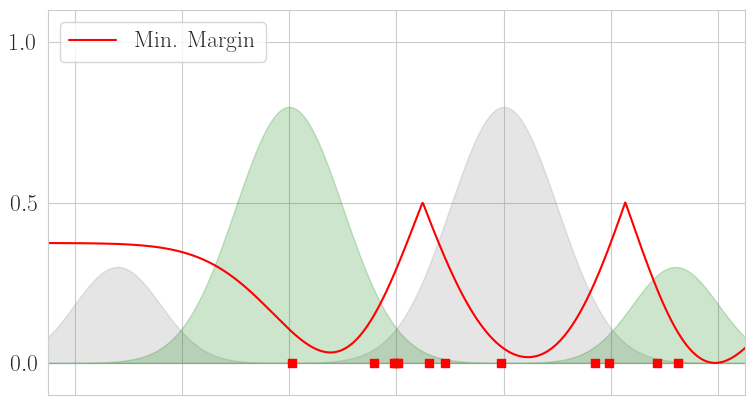

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]] [ 0  2  3  5 10 11 12  4  6  7  8  9]


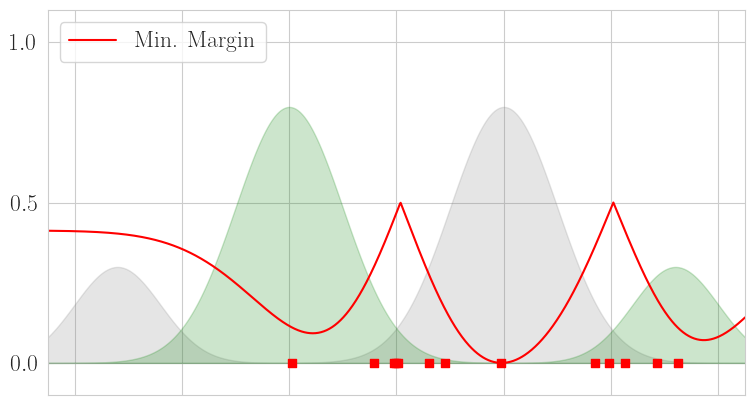

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]] [ 0  2  3  5 10 11 12 13  4  6  7  8  9]


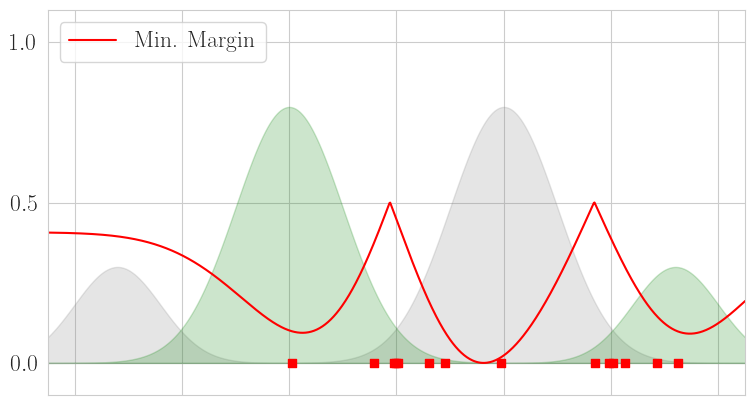

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]] [ 0  2  3  5 10 11 12 13  4  6  7  8  9 14]


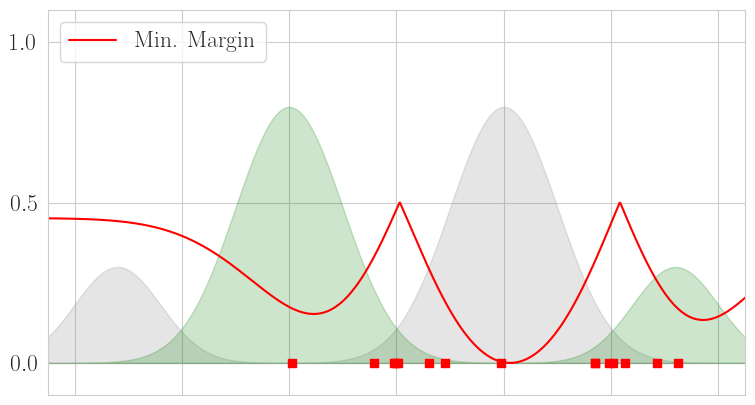

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]] [ 0  2  3  5 10 11 12 13  4  6  7  8  9 14 15]


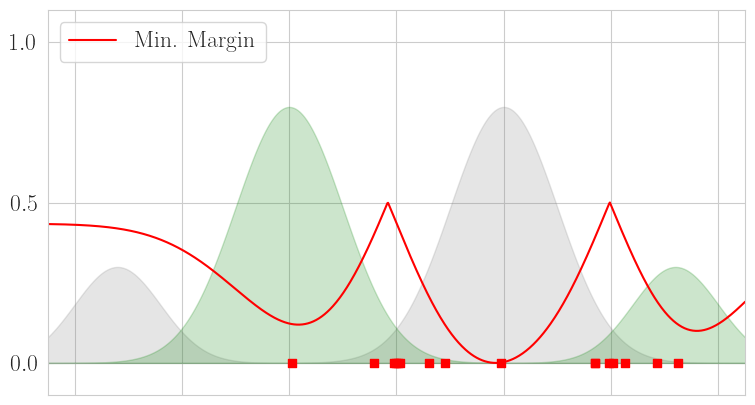

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]] [ 0  2  3  5 10 11 12 13  4  6  7  8  9 14 15 16]


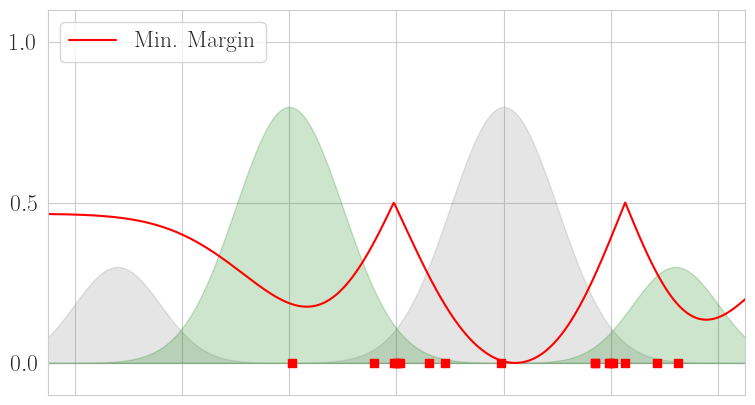

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]] [ 0  2  3  5 10 11 12 13 17  4  6  7  8  9 14 15 16]


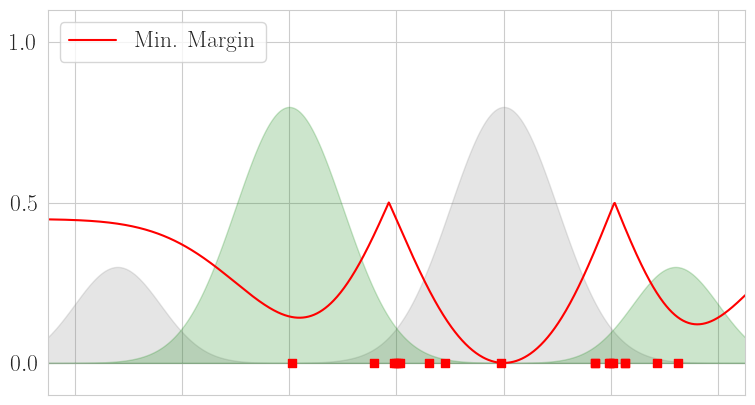

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]] [ 0  2  3  5 10 11 12 13 17 18  4  6  7  8  9 14 15 16]


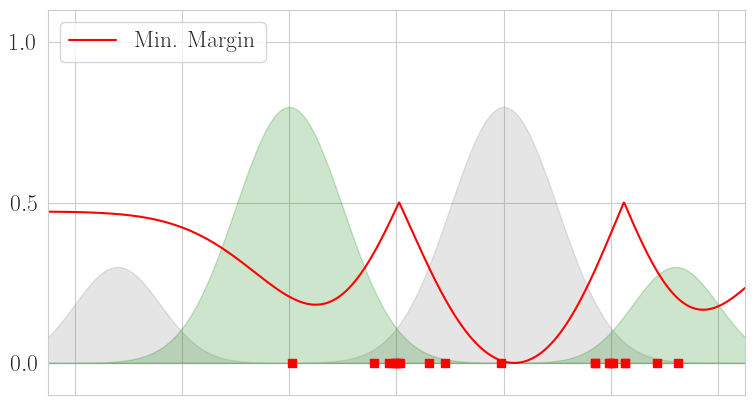

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]] [ 0  2  3  5 10 11 12 13 17 18  4  6  7  8  9 14 15 16 19]


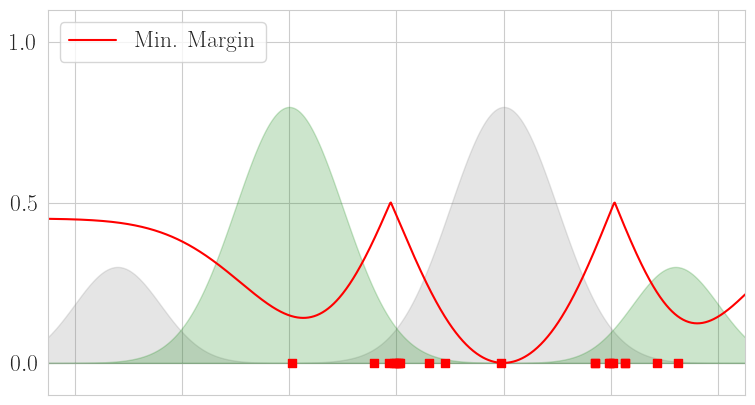

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]] [ 0  2  3  5 10 11 12 13 17 18 20  4  6  7  8  9 14 15 16 19]


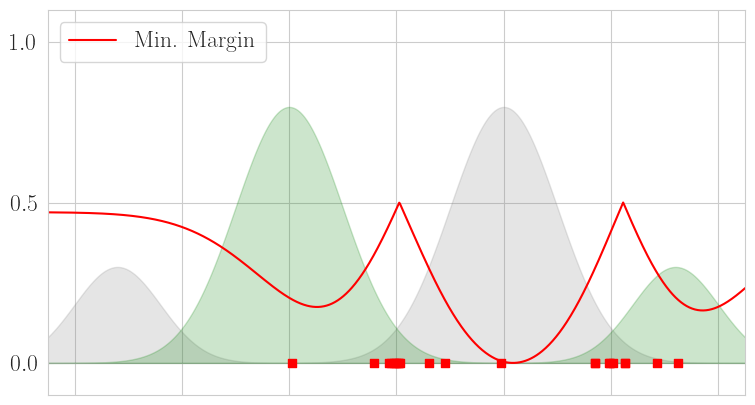

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]] [ 0  2  5 10 11 12 13 17 18 20 21  4  6  7  8  9 14 15 16 19]


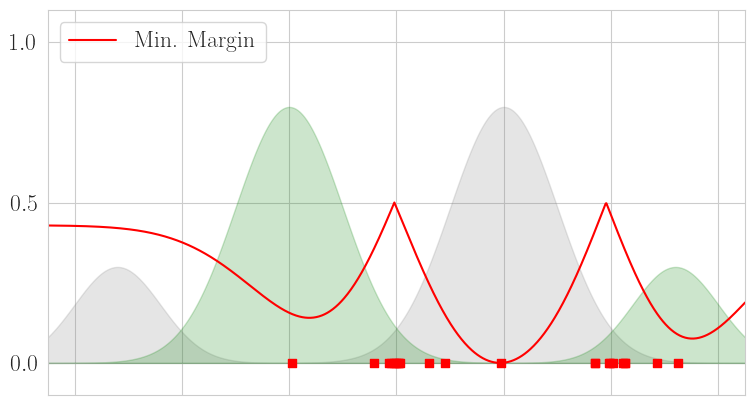

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]] [ 0  2  3  5 10 11 12 13 17 18 20 21 22  4  6  7  8  9 14 15 16 19]


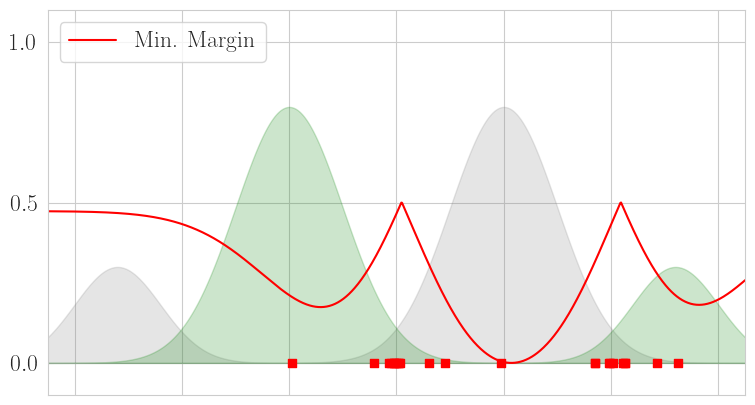

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23  4  6  7  8  9 14 15 16 19]


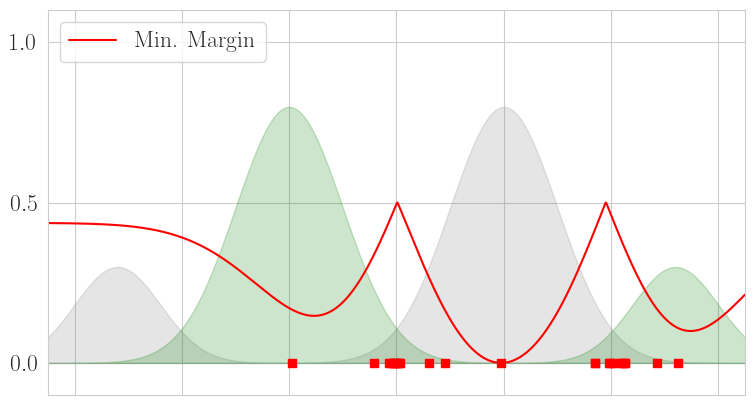

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23  4  6  7  8  9 14 15 16 19 24]


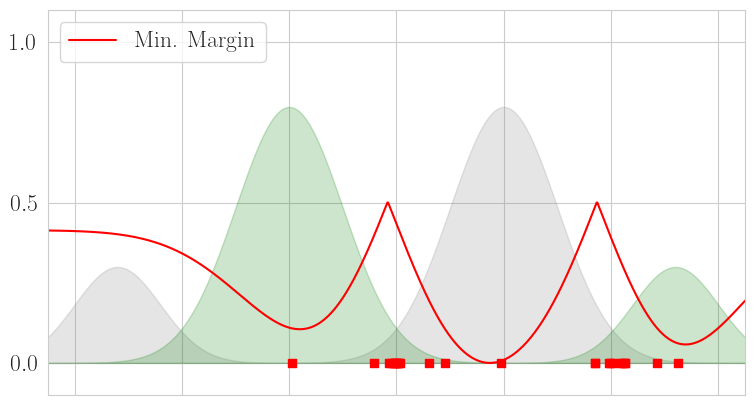

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25  4  6  7  8  9 14 15 16 19 24]


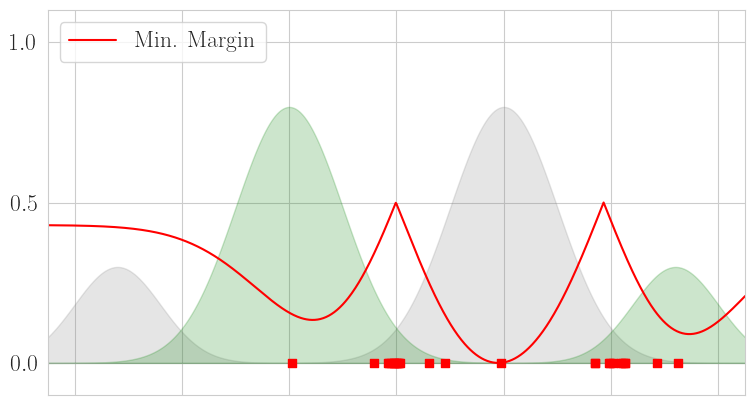

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]] [ 0  2  3  5 10 11 12 13 17 18 20 21 22 23 25  4  6  7  8  9 14 15 16 19
 24 26]


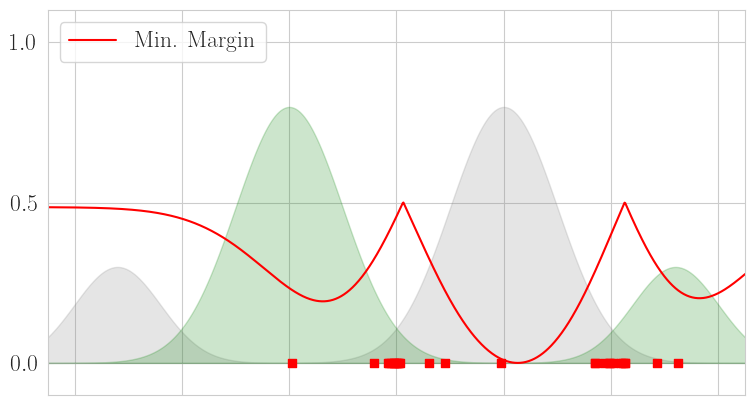

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25  4  6  7  8  9 14 15 16 19 24
 26 27]


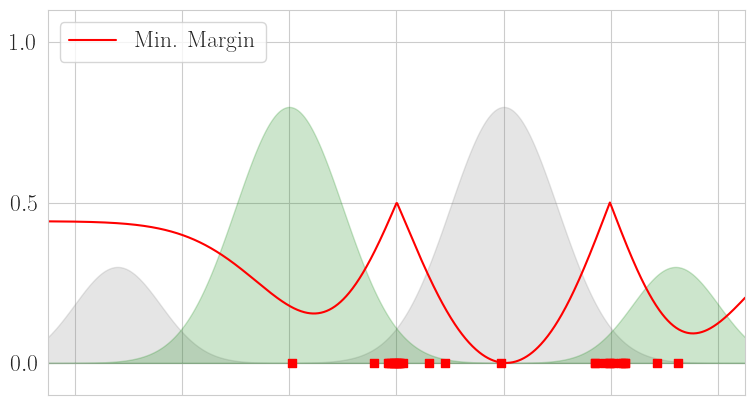

[[-0.975 ]
 [ 0.    ]
 [ 2.6195]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]] [ 0  2  3  5 10 11 12 13 17 18 20 21 22 23 25  4  6  7  8  9 14 15 16 19
 24 26 27 28]


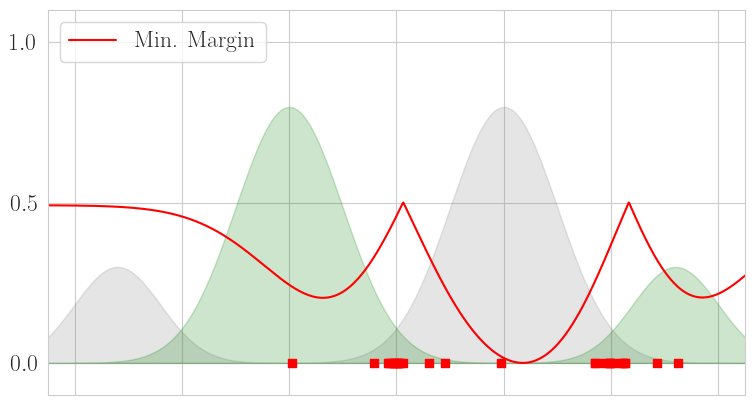

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29  4  6  7  8  9 14 15 16 19
 24 26 27 28]


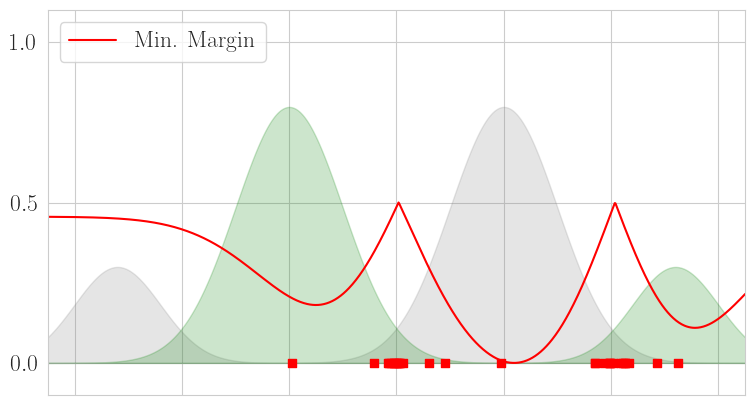

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29  4  7  8  9 14 15 16 19 24
 26 27 28 30]


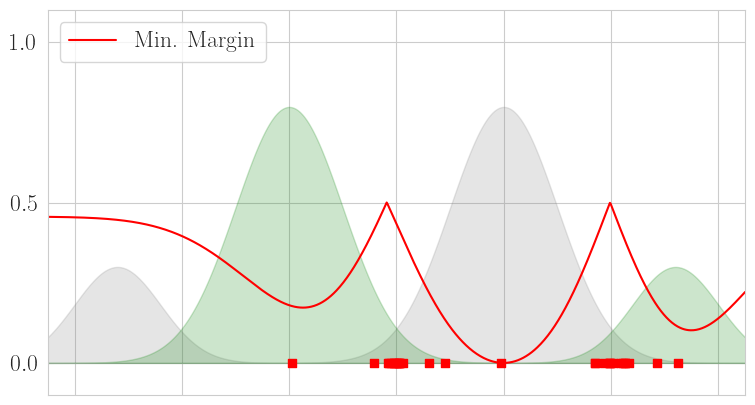

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31  4  6  7  8  9 14 15 16
 19 24 26 27 28 30]


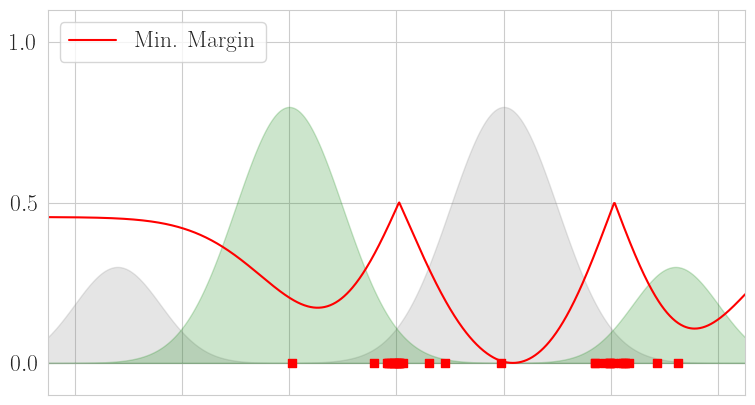

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31  4  7  8  9 14 15 16 19
 24 26 27 28 30 32]


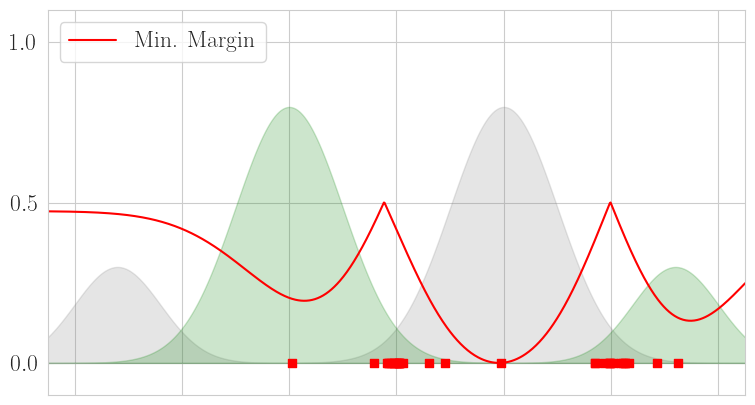

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31  4  6  7  8  9 14 15 16
 19 24 26 27 28 30 32 33]


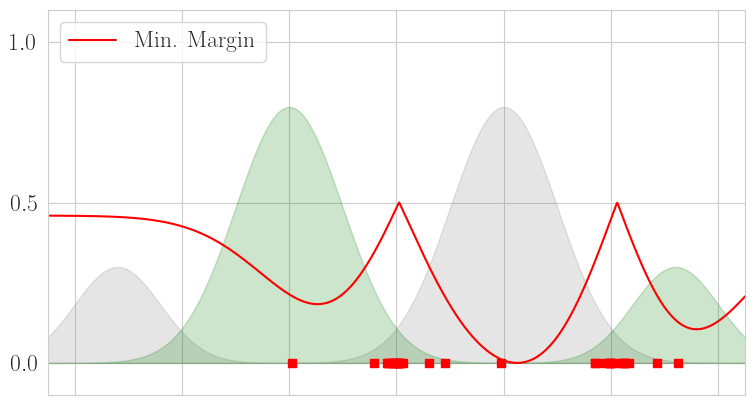

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31  4  7  8  9 14 15 16 19
 24 26 27 28 30 32 33 34]


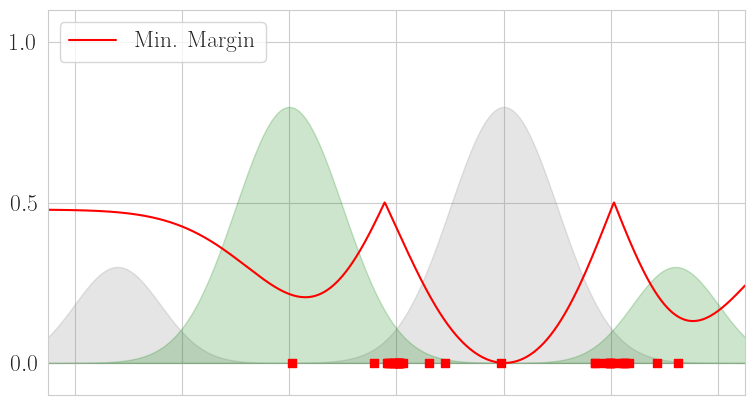

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35  4  7  8  9 14 15 16
 19 24 26 27 28 30 32 33 34]


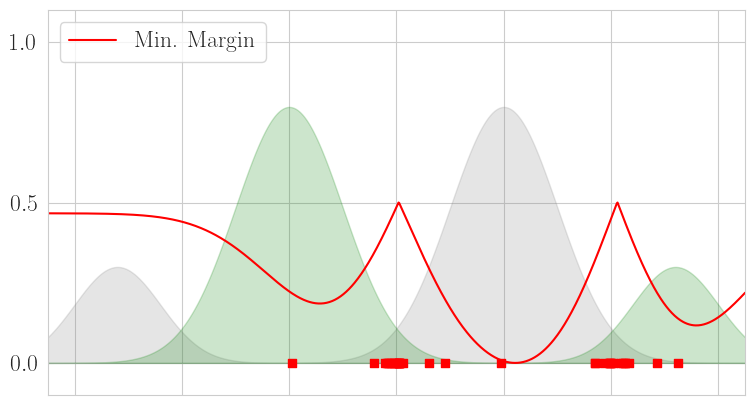

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35  4  7  8  9 14 15 16
 19 24 26 27 28 30 32 33 34 36]


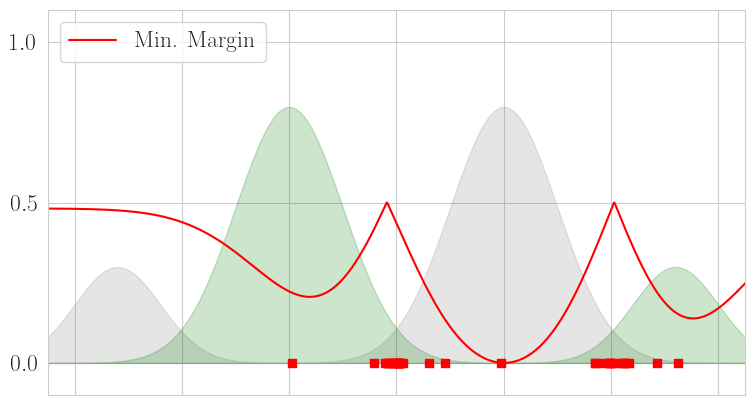

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37  4  7  8  9 14 15
 16 19 24 26 27 28 30 32 33 34 36]


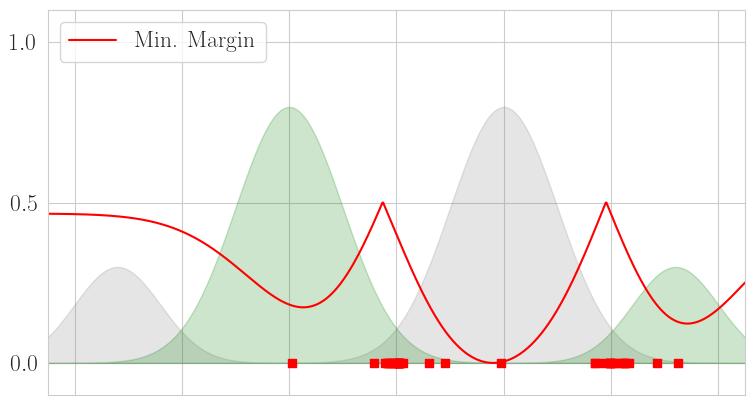

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37  4  7  8  9 14 15
 16 19 24 26 27 28 30 32 33 34 36 38]


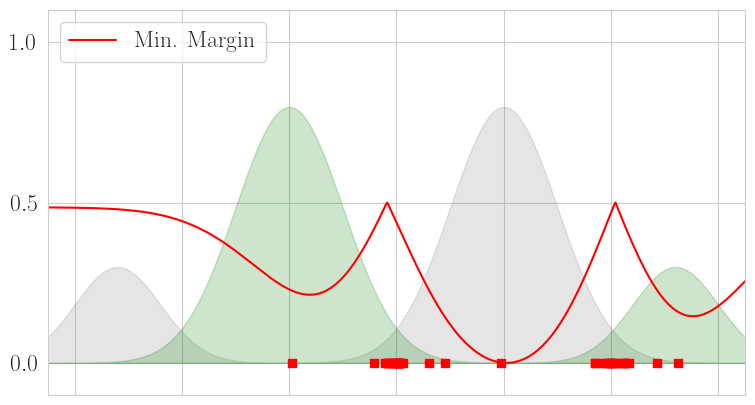

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39  4  7  8  9 14
 15 16 19 24 26 27 28 30 32 33 34 36 38]


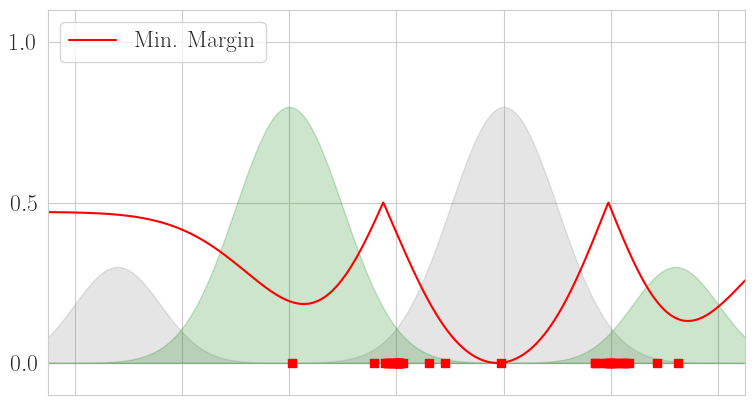

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40  4  7  8  9
 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


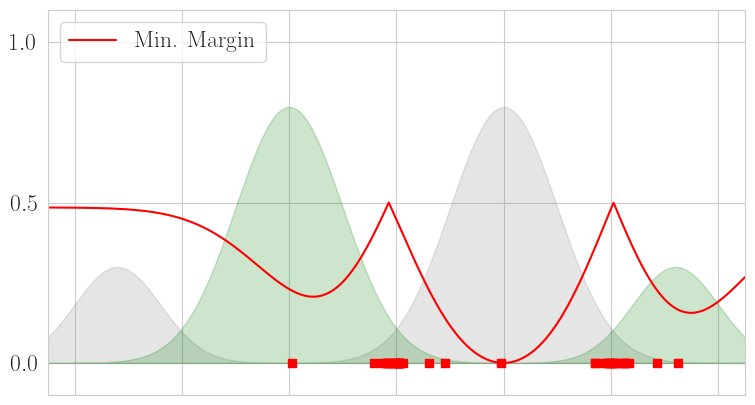

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41  4  7  8  9
 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


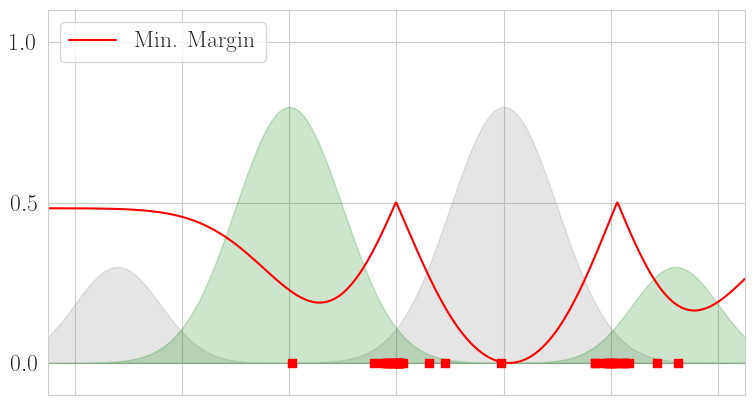

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42  4  7
  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


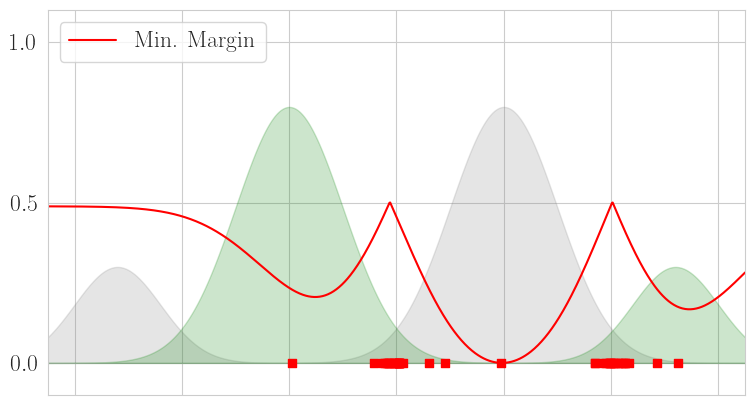

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43  4  7
  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


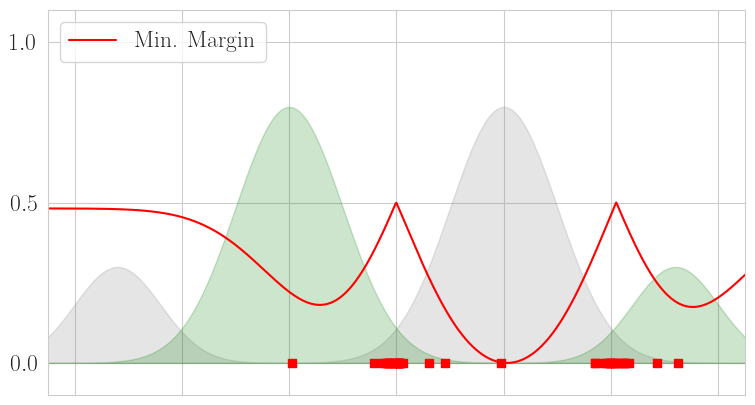

[[-0.975 ]
 [ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 0  2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44
  4  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


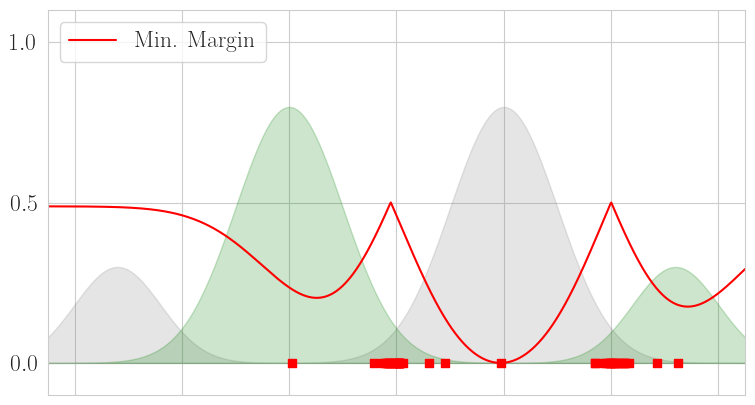

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45
  4  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


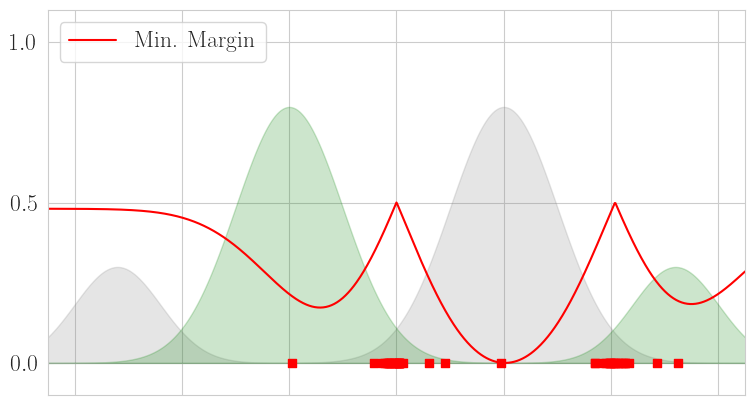

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 0.    ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45
 46  4  6  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


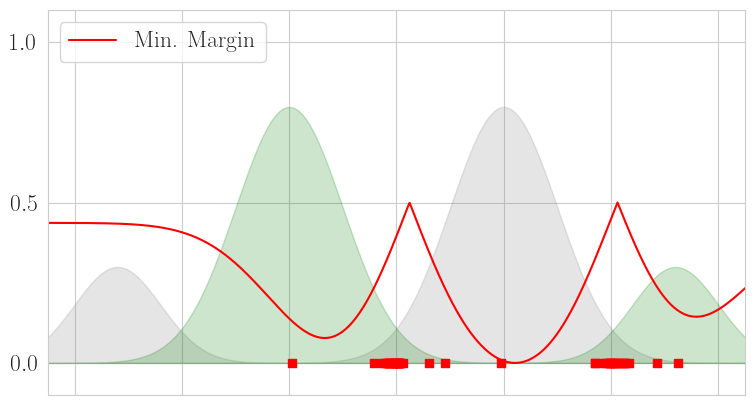

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 0.    ]
 [ 2.0605]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45
 46 47  4  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


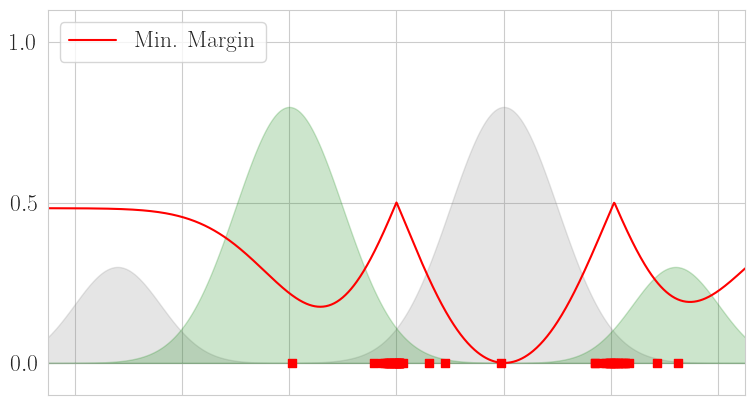

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 0.    ]
 [ 2.0605]
 [ 0.    ]
 [ 1.8525]
 [ 0.4485]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45
 46 47 48  4  6  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38]


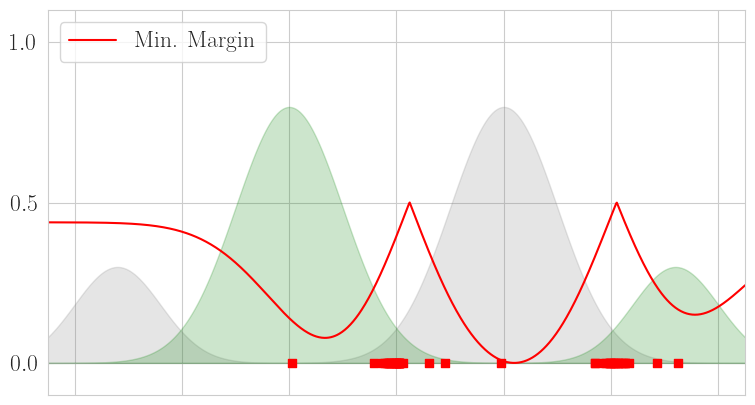

[[ 0.    ]
 [ 2.431 ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 0.    ]
 [ 2.0605]
 [ 0.    ]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]
 [ 0.1235]] [ 2  5 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45
 46 47 48  4  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38 49]


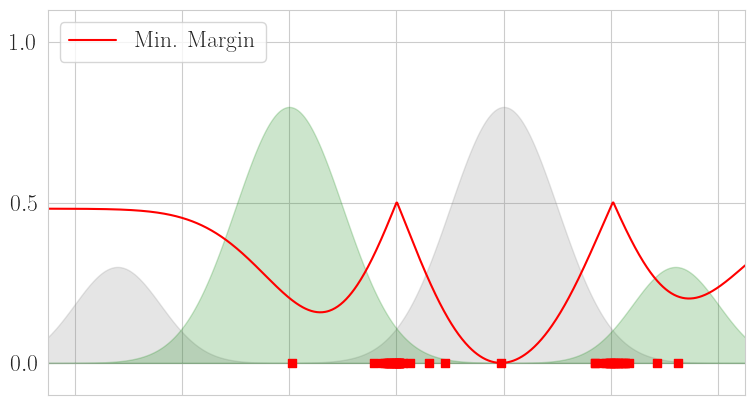

[[ 0.    ]
 [-0.208 ]
 [-0.0195]
 [ 2.132 ]
 [ 2.0215]
 [ 2.132 ]
 [-0.0715]
 [-0.052 ]
 [ 2.1125]
 [-0.0195]
 [ 2.093 ]
 [-0.078 ]
 [ 2.1645]
 [-0.091 ]
 [-0.1105]
 [ 2.028 ]
 [ 2.041 ]
 [-0.1235]
 [-0.0715]
 [ 2.0605]
 [-0.0585]
 [ 2.0475]
 [-0.052 ]
 [ 0.    ]
 [ 2.0605]
 [ 0.    ]
 [ 2.0215]
 [ 1.8525]
 [ 1.9825]
 [ 0.3055]
 [ 0.013 ]
 [ 1.846 ]
 [ 0.0325]
 [ 1.989 ]
 [ 0.026 ]
 [ 0.0065]
 [ 1.9305]
 [ 0.065 ]
 [ 1.989 ]
 [ 0.0195]
 [ 0.026 ]
 [ 1.9955]
 [ 0.026 ]
 [ 0.0195]
 [ 1.9565]
 [ 0.1235]] [ 2 10 11 12 13 17 18 20 21 22 23 25 29 31 35 37 39 40 41 42 43 44 45 46
 47 48 50  4  7  8  9 14 15 16 19 24 26 27 28 30 32 33 34 36 38 49]


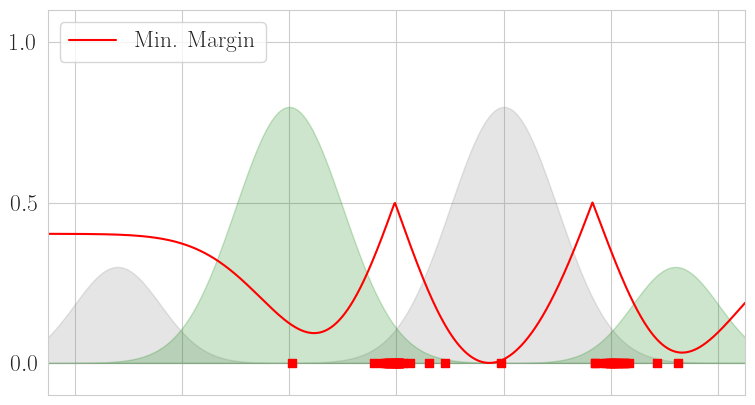

In [176]:
# min margin sampling with svm
clf = SVC(gamma='auto', kernel='rbf', class_weight='balanced')

labeled_ind = np.array([350, 650])
xlab, ylab = dom[labeled_ind][:,np.newaxis], y_lab[labeled_ind]
clf.fit(xlab, ylab)

out = clf.decision_function(dom[:,np.newaxis])


for it in range(50):
    vals = 1. - np.absolute(out)
    vals_ = 0.5*(vals - vals.min())/(vals.max() - vals.min())
    print(clf.support_vectors_, clf.support_)
    fig, ax = plt.subplots(figsize=(9,5))
    ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
    ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
    ax.scatter(xlab, np.zeros_like(ylab), marker='s', c='r')
    ax.plot(dom, vals_, label=r'Min. Margin', color='r')
#     ax.plot(dom, 0.5*(1. + out), label=r'Classifier Function', color='g')
    ax.set_ylim(-0.1,1.1)
    ax.set_xlim(-3.25,3.25)
    ax.legend(loc='upper left', fontsize=17)
    
    ax.set_xticklabels([])
    ax.set_yticks([0, 0.5, 1.0])
    ax.yaxis.set_tick_params(labelsize=17)
    ax.set_ylabel('')
    plt.savefig(os.path.join(savedir, f"unc_demo_new/mm_iter_{it}.png"), bbox_inches='tight', dpi=200)
    plt.show()
    
    k = np.argmin(np.absolute(out))
    labeled_ind = np.append(labeled_ind, k)

    xlab = np.vstack((xlab, np.array([dom[k]])[:,np.newaxis])) 
    #     ylab = np.append(ylab, 1*(np.random.rand() < c1[k]/(c1[k] + c2[k]))) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup
    ylab = np.append(ylab, 1*(c1[k] > c2[k])) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setupprint(ylab)
    clf.fit(xlab, ylab)
    out = clf.decision_function(dom[:,np.newaxis])
    
    

xlab_svm, ylab_svm = xlab.copy(), ylab.copy()

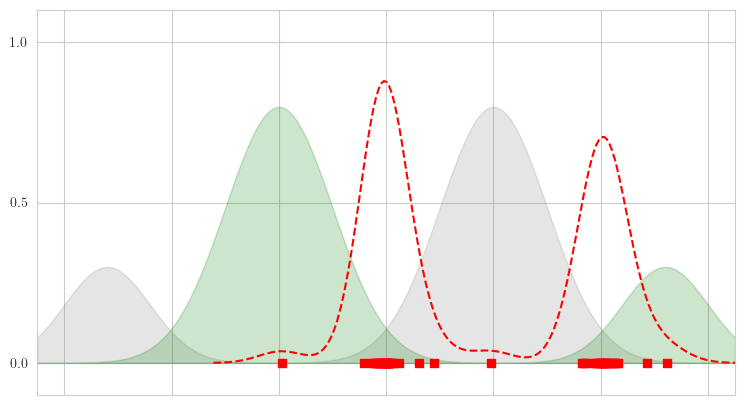

In [177]:
fig, ax = plt.subplots(figsize=(9,5))
sns.kdeplot(xlab_svm.flatten(), linestyle='--', bw_method=0.2, color='r')
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
ax.scatter(xlab_svm, np.zeros_like(ylab_svm), marker='s', c='r')
ax.set_ylim(-0.1,1.1)
ax.set_xlim(-3.25,3.25)
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticks([0, 0.5, 1.0], fontsize=30)
plt.show()

In [178]:
from sklearn.metrics.pairwise import rbf_kernel

In [179]:
labeled_ind = np.array([350, 650])
xlab, ylab = dom[labeled_ind][:,np.newaxis], y_lab[labeled_ind]

In [180]:
A = 0.1*np.ones((dom.shape[0], 2))
for x, y in zip(xlab, ylab):
    A[:,int(y)] += rbf_kernel(dom[:,np.newaxis], x[:,np.newaxis], gamma=2.).flatten()

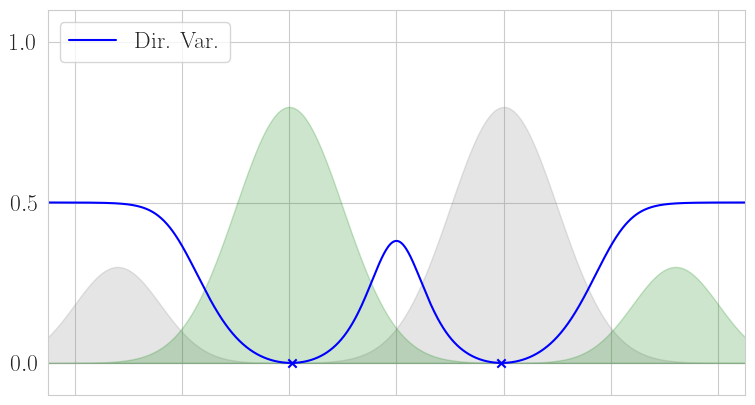

[0 1 1]


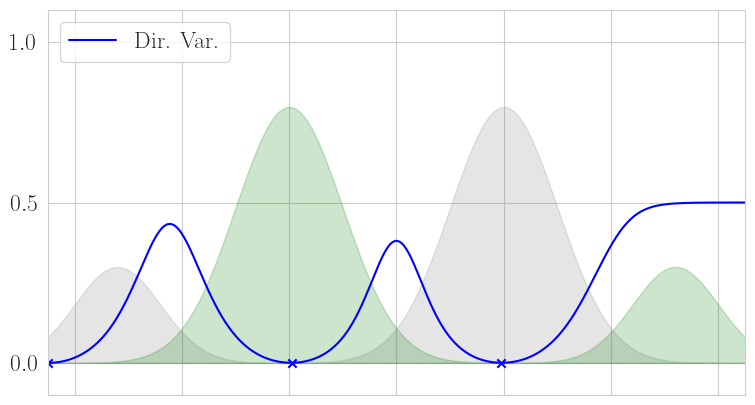

[0 1 1 0]


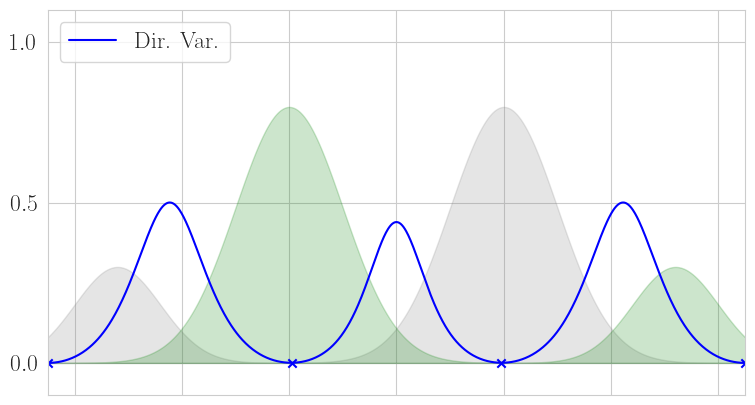

[0 1 1 0 0]


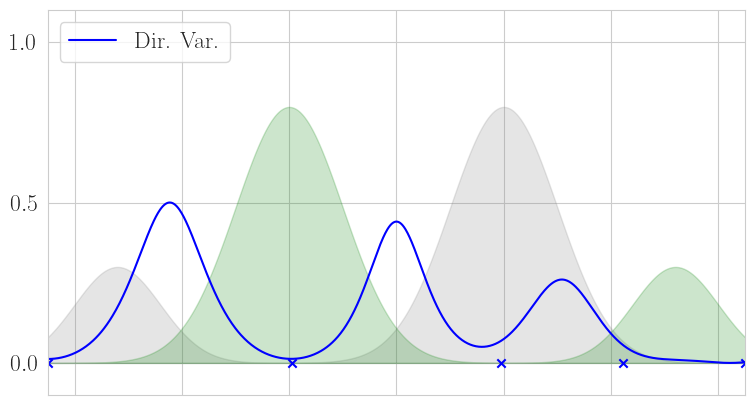

[0 1 1 0 0 1]


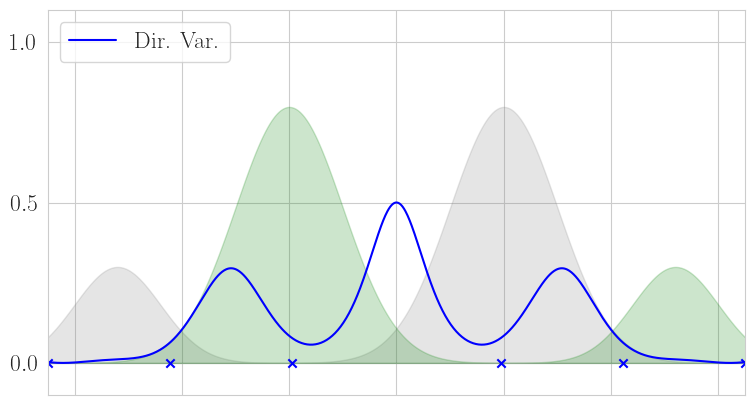

[0 1 1 0 0 1 0]


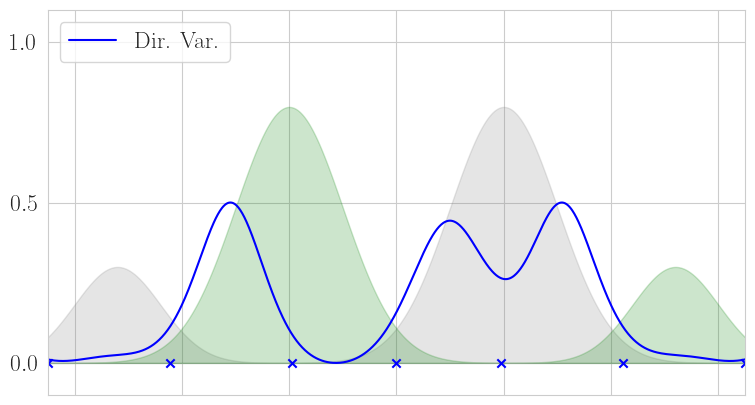

[0 1 1 0 0 1 0 0]


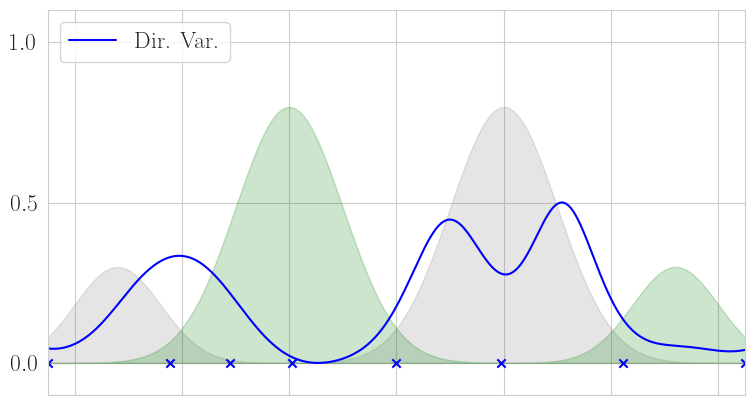

[0 1 1 0 0 1 0 0 1]


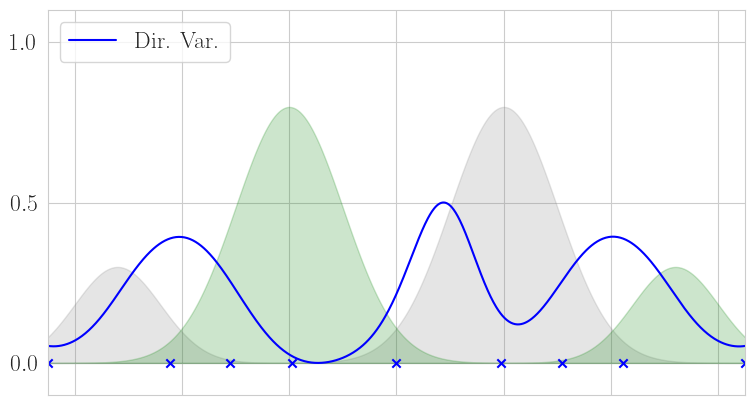

[0 1 1 0 0 1 0 0 1 1]


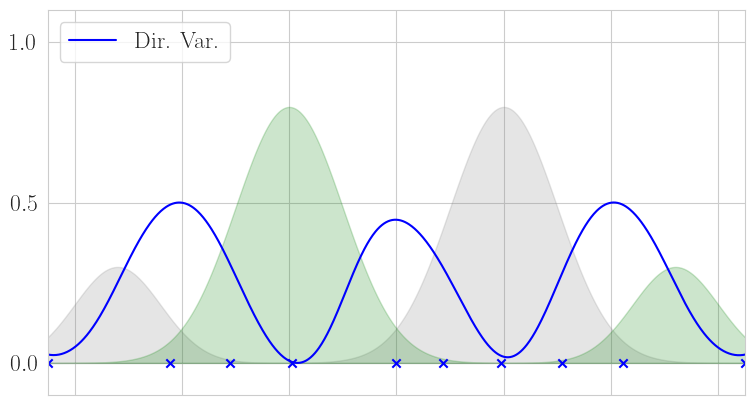

[0 1 1 0 0 1 0 0 1 1 0]


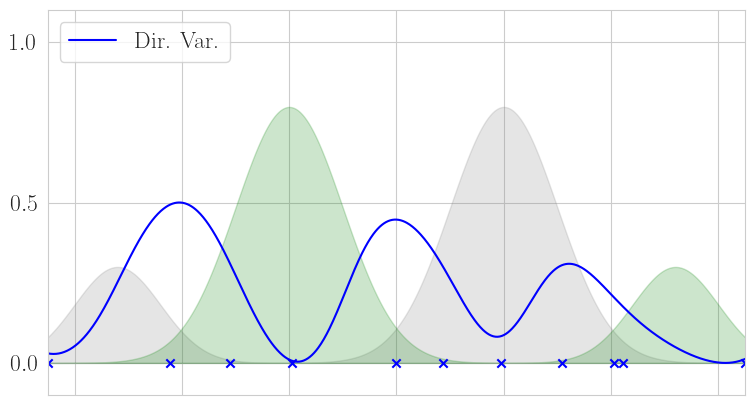

[0 1 1 0 0 1 0 0 1 1 0 1]


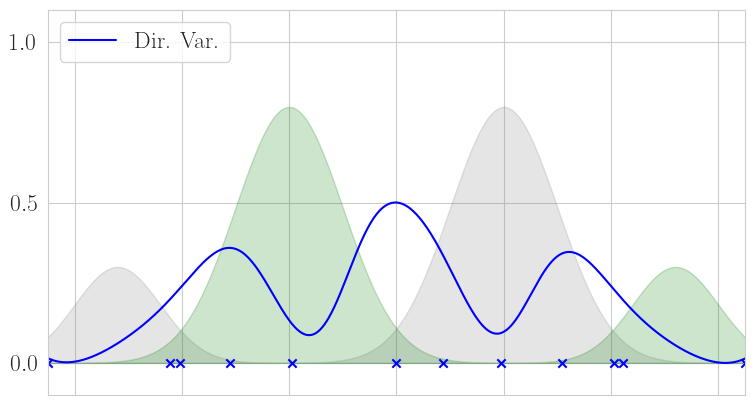

[0 1 1 0 0 1 0 0 1 1 0 1 0]


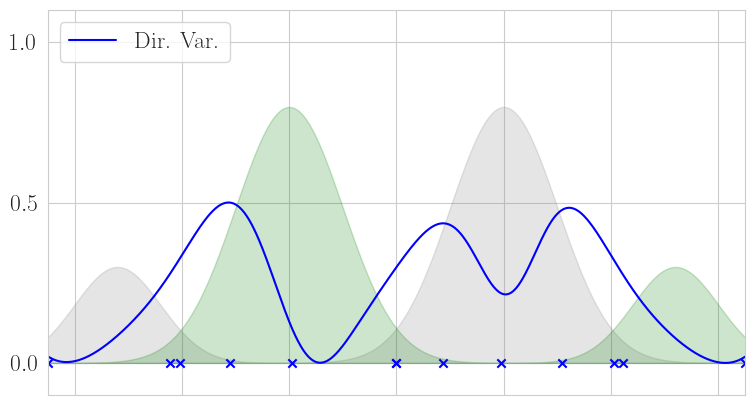

[0 1 1 0 0 1 0 0 1 1 0 1 0 0]


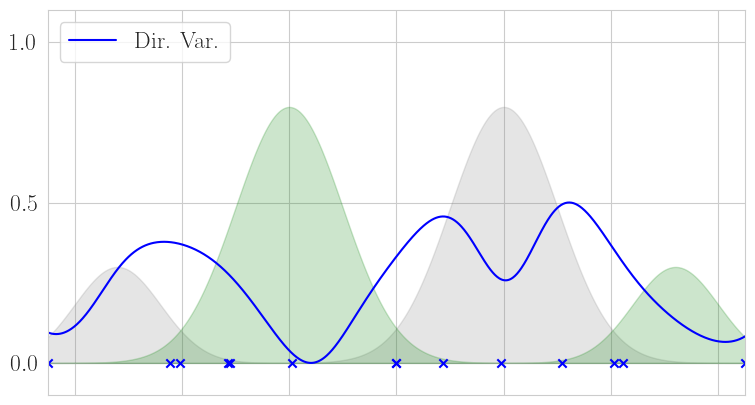

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1]


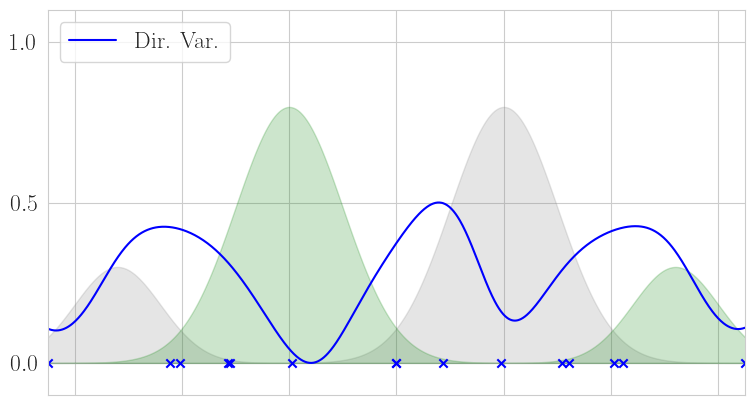

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1]


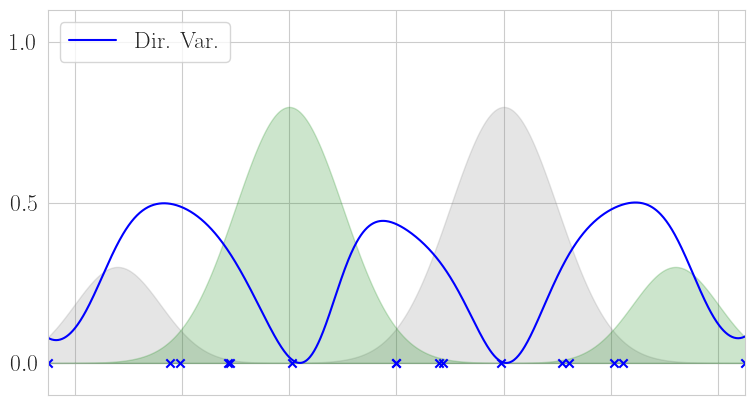

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0]


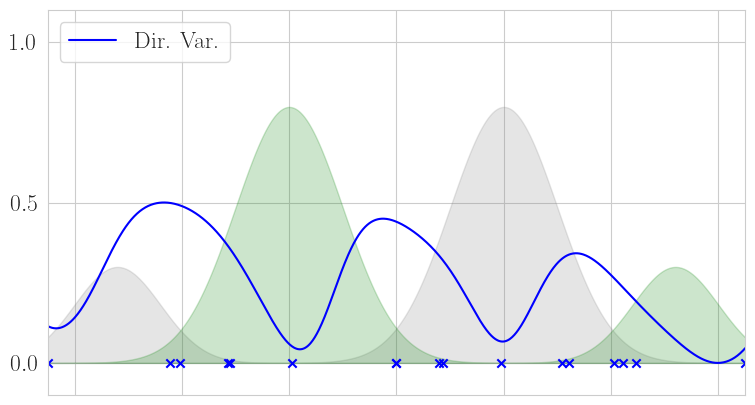

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1]


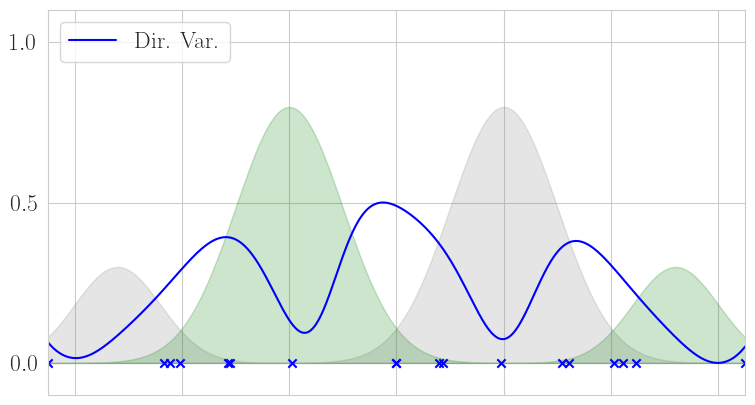

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0]


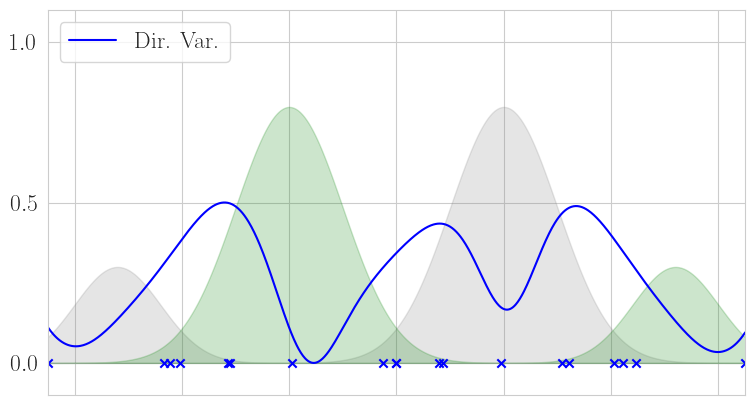

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0]


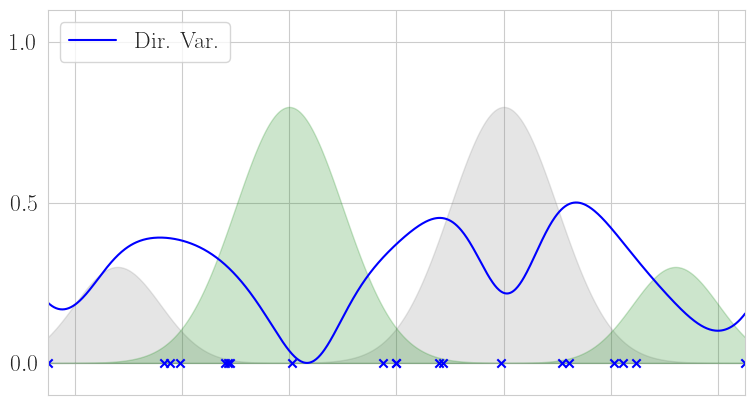

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1]


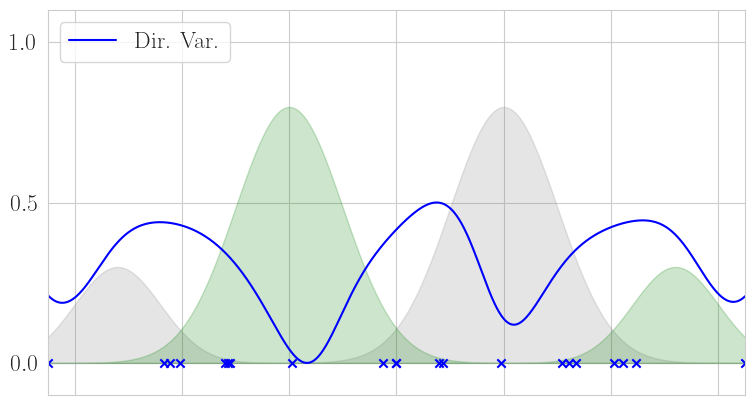

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1]


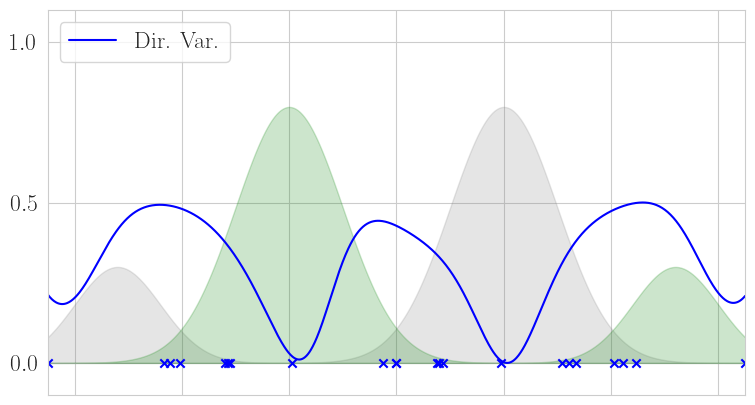

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0]


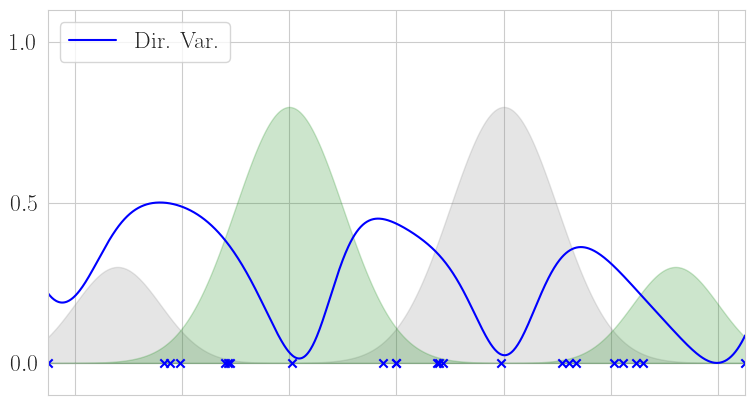

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1]


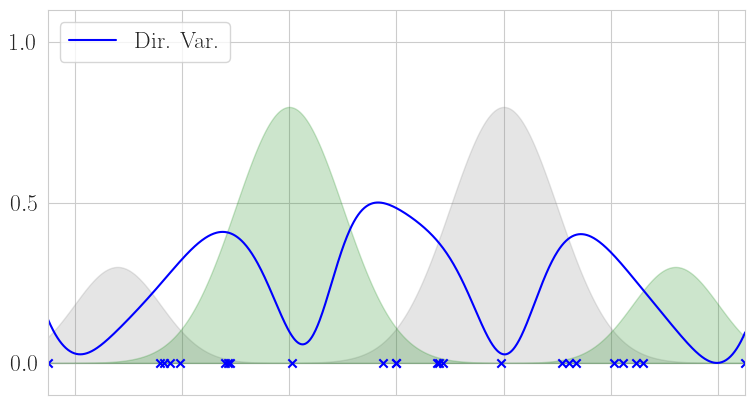

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0]


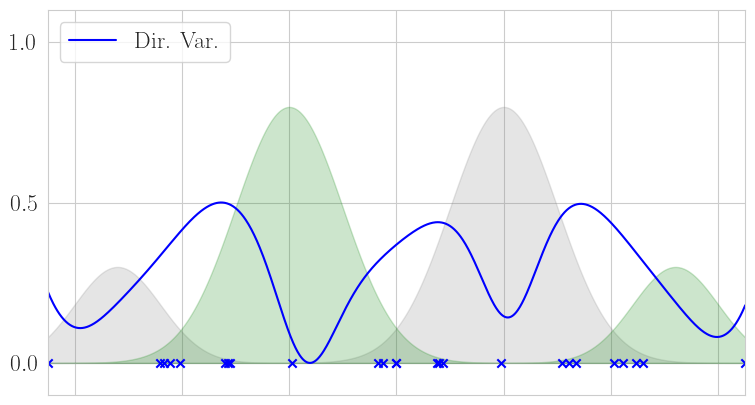

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0]


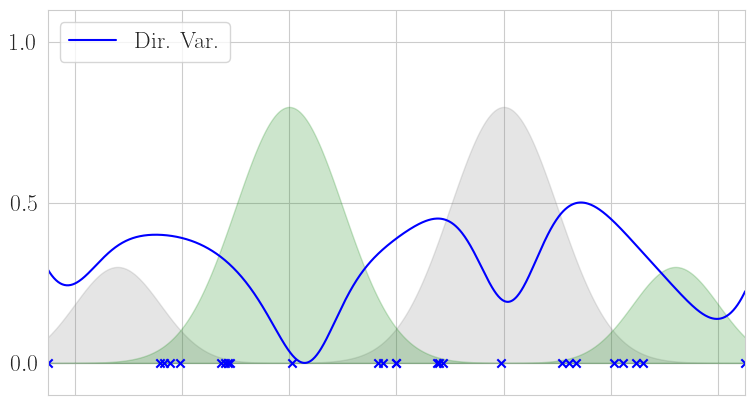

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1]


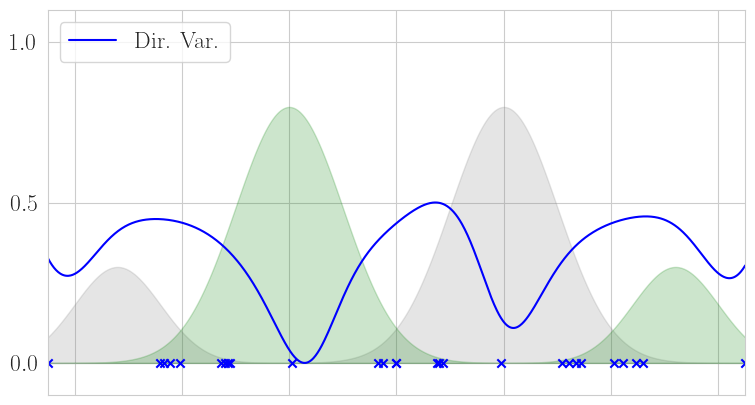

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1]


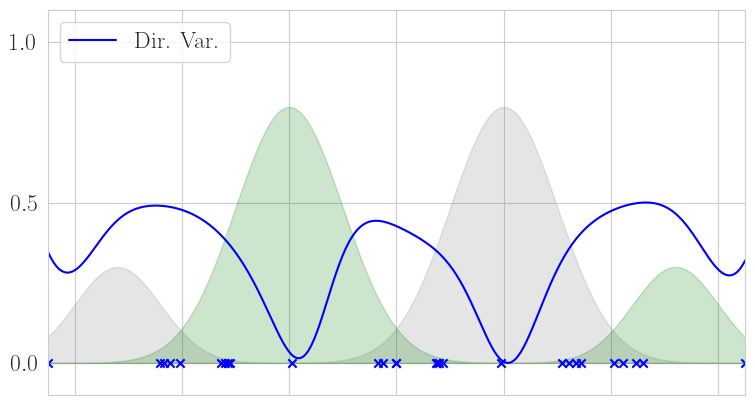

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0]


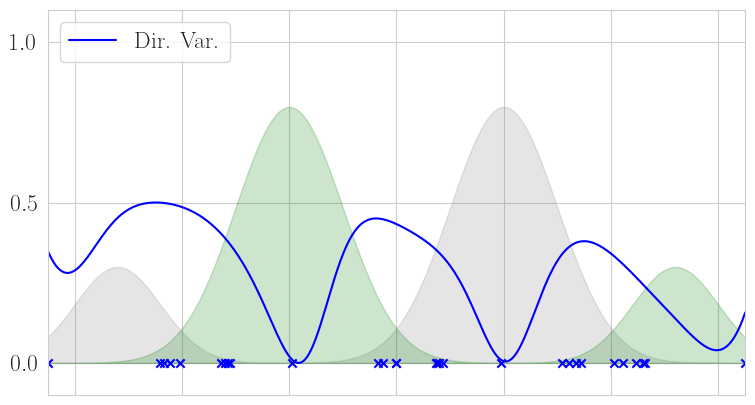

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1]


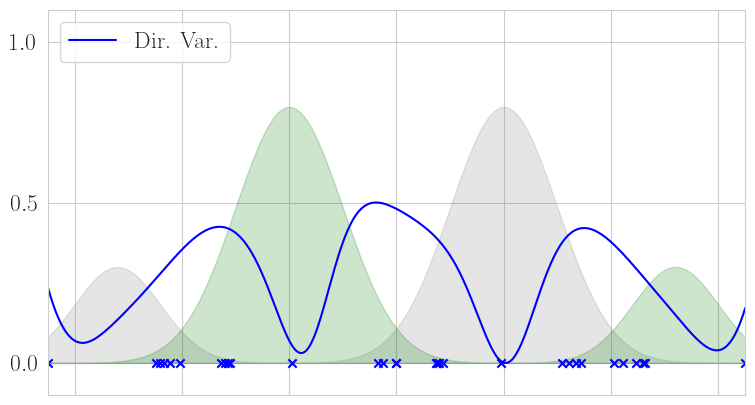

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0]


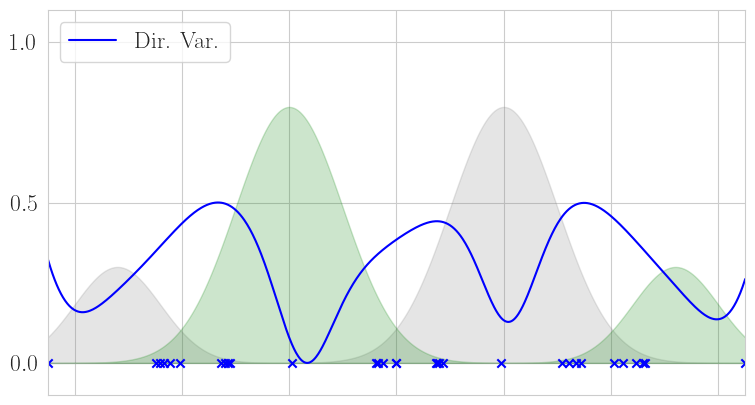

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0]


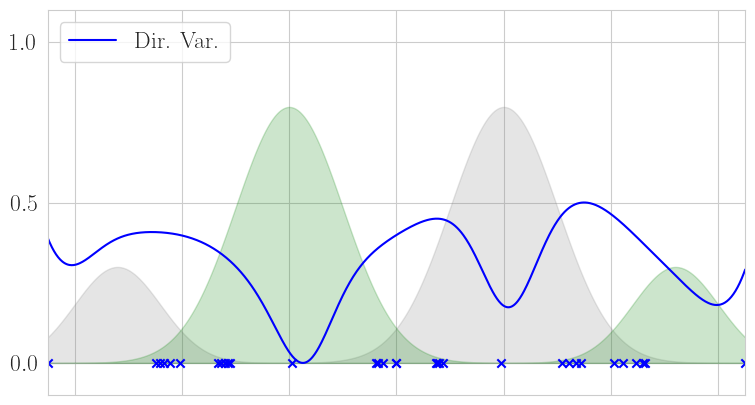

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1]


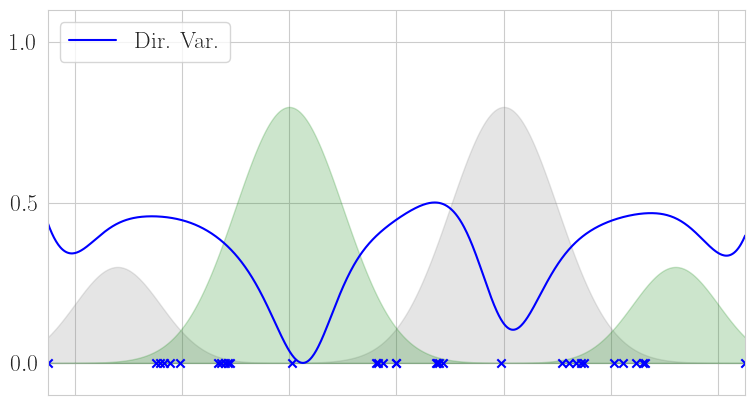

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1]


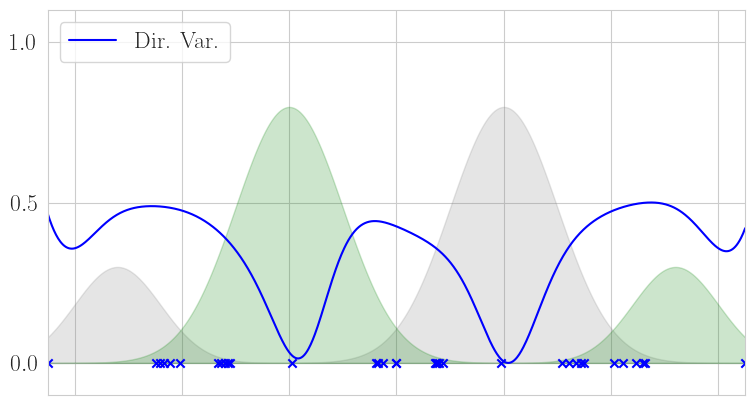

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0]


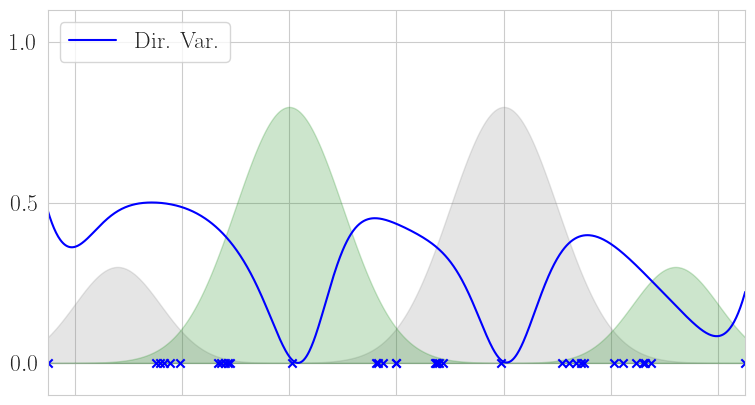

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1]


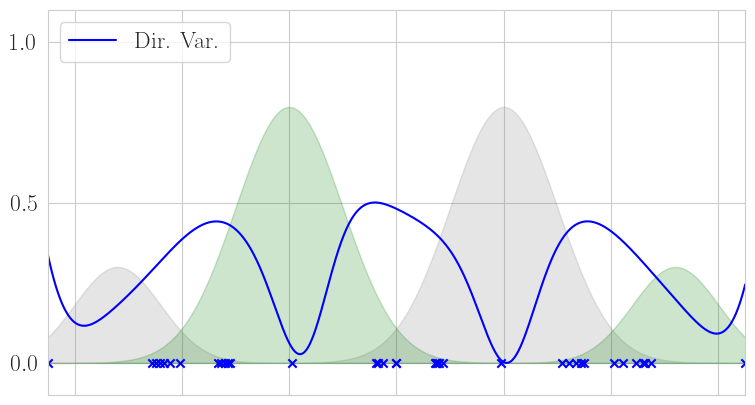

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0]


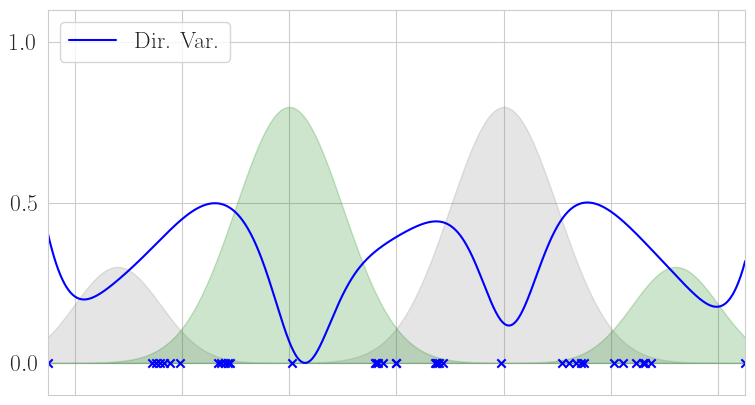

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1]


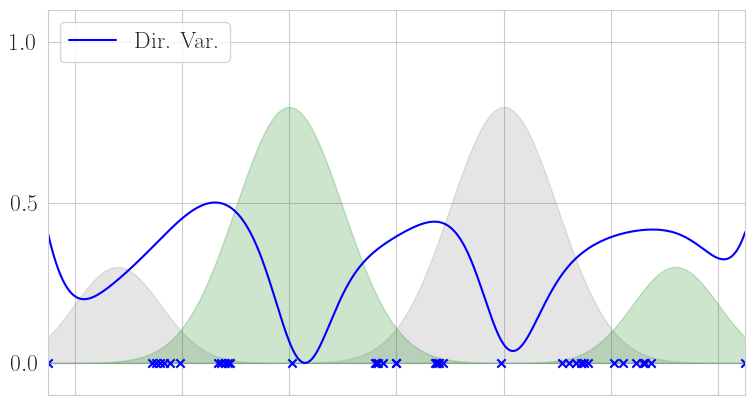

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0]


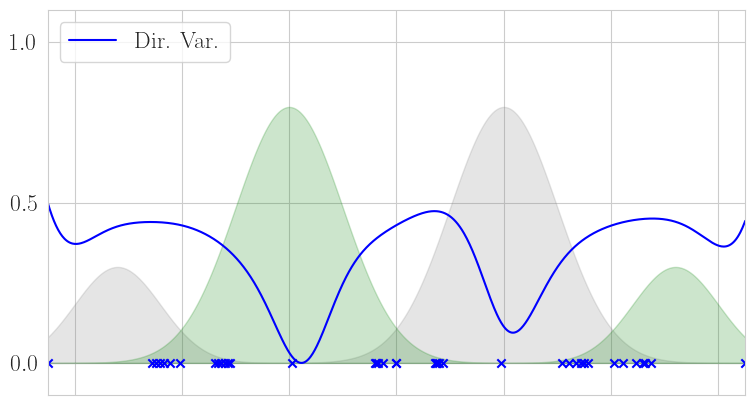

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1]


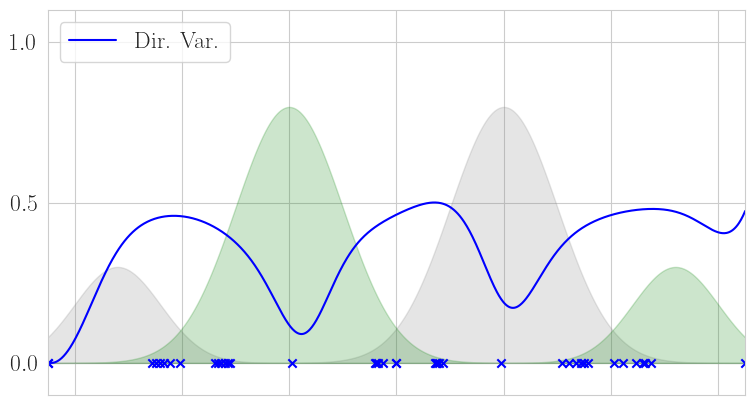

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1]


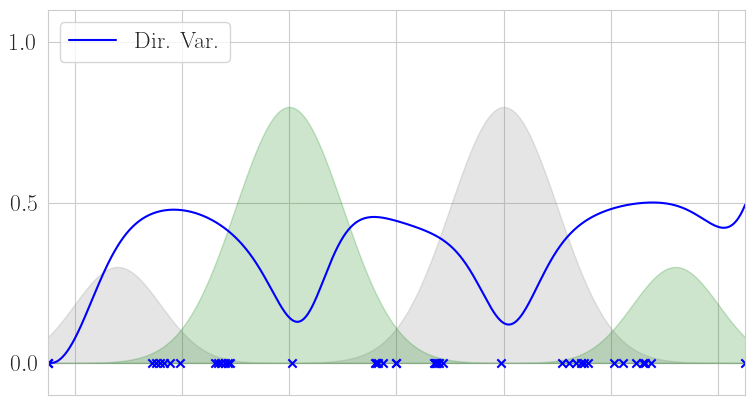

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0]


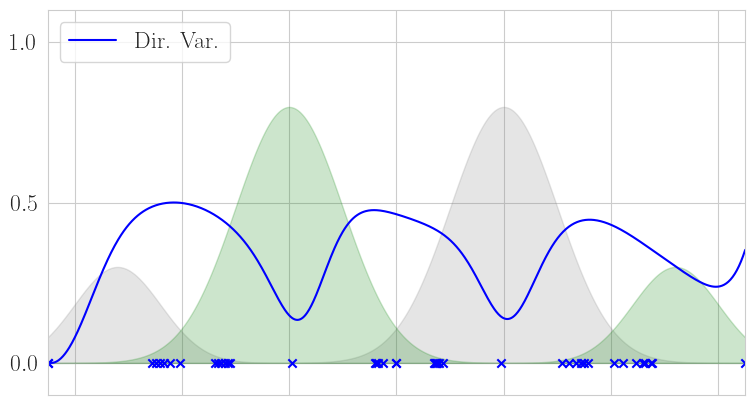

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1]


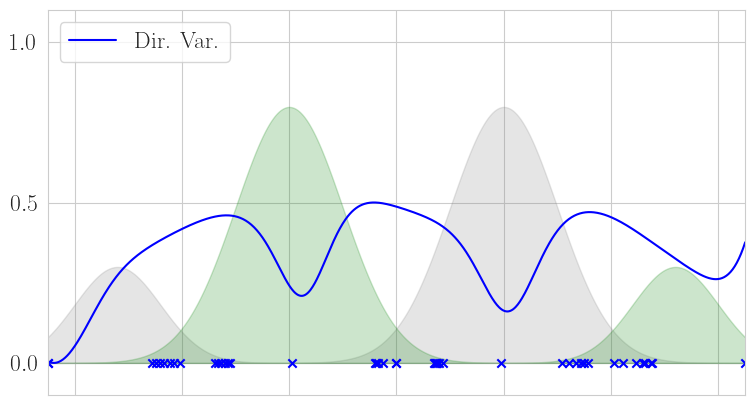

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0]


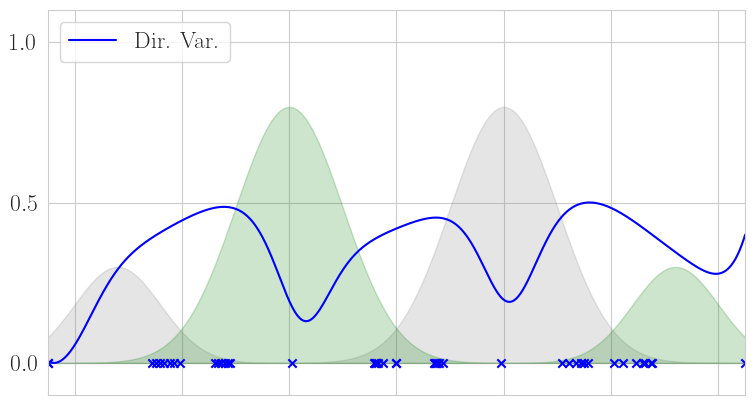

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1]


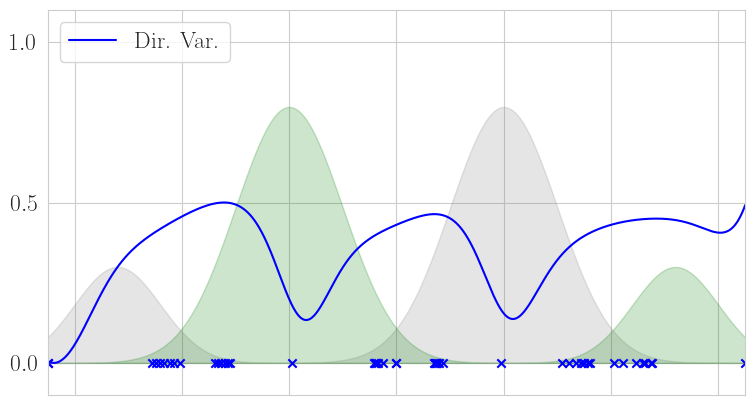

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0]


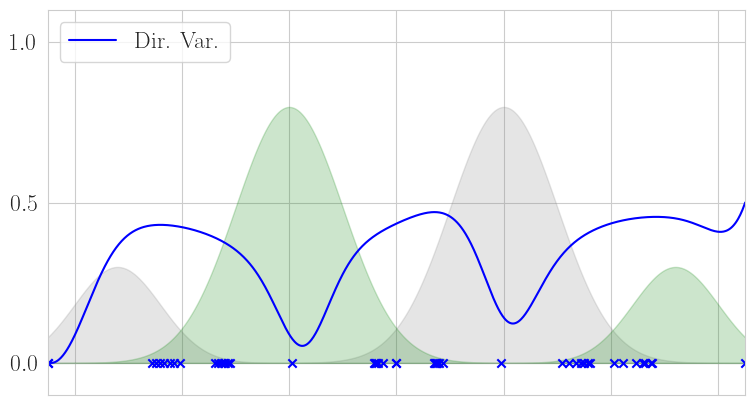

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0]


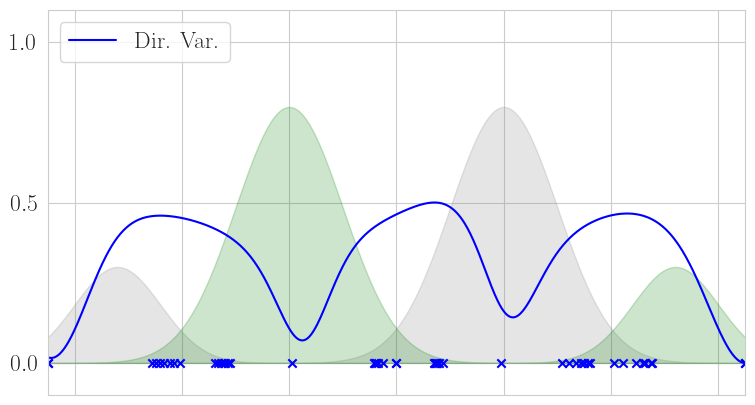

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0 1]


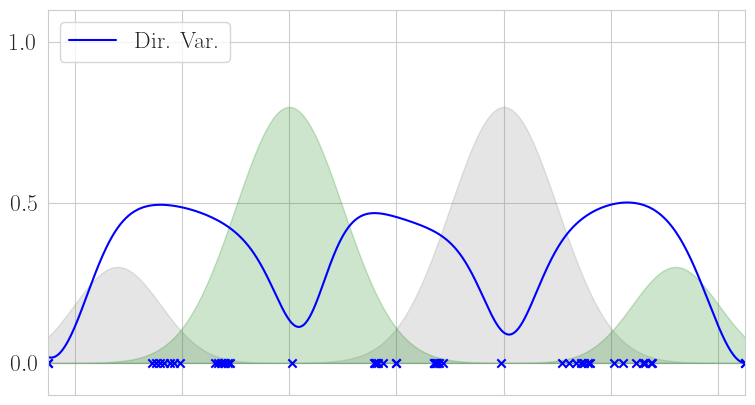

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0 1 0]


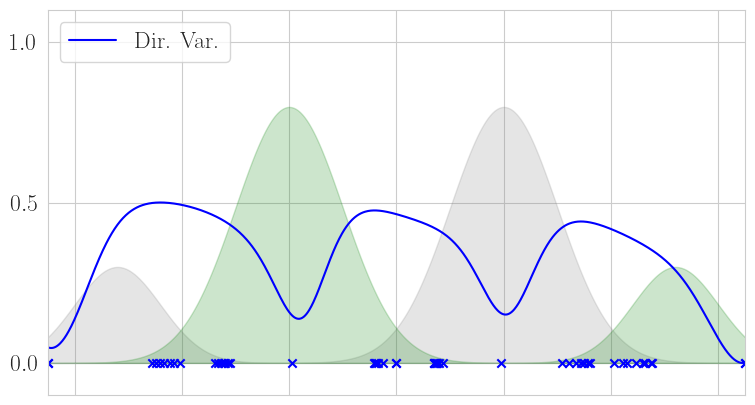

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0 1 0 1]


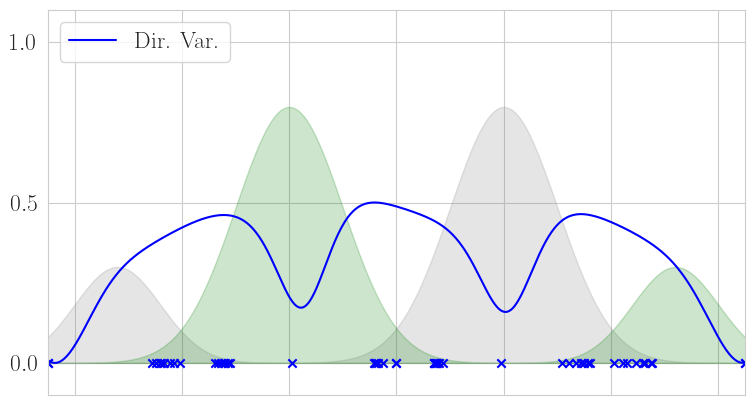

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0 1 0 1 0]


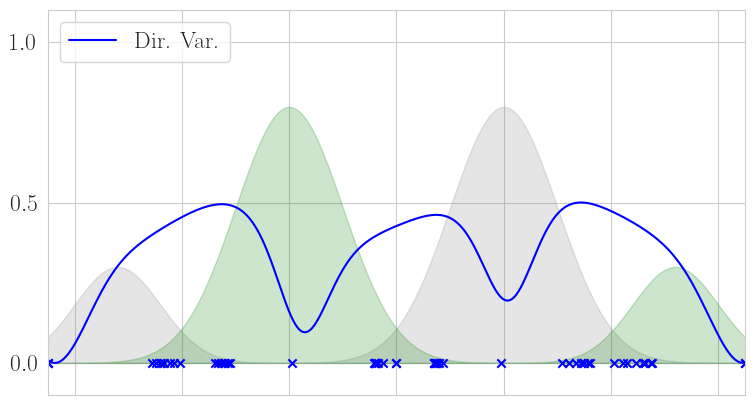

[0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0
 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1]


In [181]:
a0 = A.sum(axis=1)
bv_vals = (A * A).sum(axis=1)
bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
out = A[:,0]/(a0)

for it in range(50):
    bv_vals_ = 0.5*(bv_vals - bv_vals.min())/(bv_vals.max() - bv_vals.min())
    
    fig, ax = plt.subplots(figsize=(9,5))
    ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
    ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
    ax.scatter(xlab, np.zeros_like(ylab), marker='x', c='b')
    ax.plot(dom, bv_vals_, label=r'Dir. Var.', color='b')
    ax.set_ylim(-0.1,1.1)
    ax.set_xlim(-3.25,3.25)
    ax.legend(loc='upper left', fontsize=17)
    ax.set_ylabel('')
    ax.set_xticklabels([])
    ax.set_yticks([0, 0.5, 1.0])
    ax.yaxis.set_tick_params(labelsize=17)
    plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_iter_{it}.png"), bbox_inches='tight', dpi=200)
    plt.show()
    
    k = np.argmax(bv_vals)
    labeled_ind = np.append(labeled_ind, k)
    xlab = np.vstack((xlab, np.array([dom[k]])[:,np.newaxis])) 
#     ylab = np.append(ylab, 1*(np.random.rand() < c1[k]/(c1[k] + c2[k]))) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup
    ylab = np.append(ylab, 1*(c1[k] > c2[k])) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup

    print(ylab)
    
    A[:,int(ylab[-1])] += rbf_kernel(dom[:,np.newaxis], xlab[-1][:,np.newaxis], gamma=2.).flatten()
    
    a0 = A.sum(axis=1)
    bv_vals = (A * A).sum(axis=1)
    bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))

xlab_dir, ylab_dir = xlab.copy(), ylab.copy()

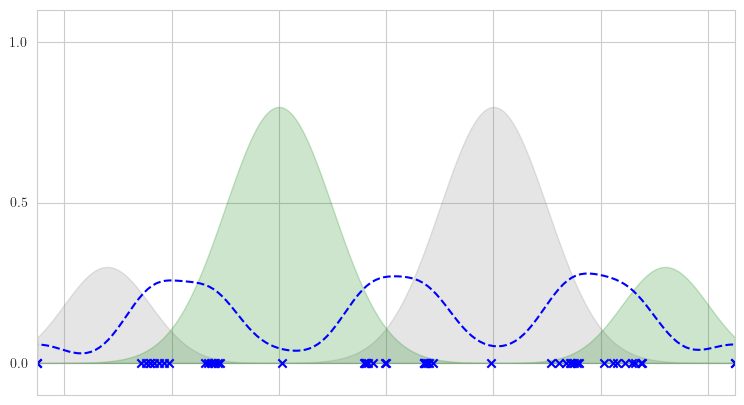

In [182]:
fig, ax = plt.subplots(figsize=(9,5))
sns.kdeplot(xlab_dir.flatten(), linestyle='--', bw_method=0.15, color='b', label='Dir. Var.')
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
ax.scatter(xlab_dir, np.zeros_like(ylab_dir), marker='x', c='b')
ax.set_ylim(-0.1,1.1)
ax.set_xlim(-3.25,3.25)
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticks([0, 0.5, 1.0], fontsize=17)
plt.show()

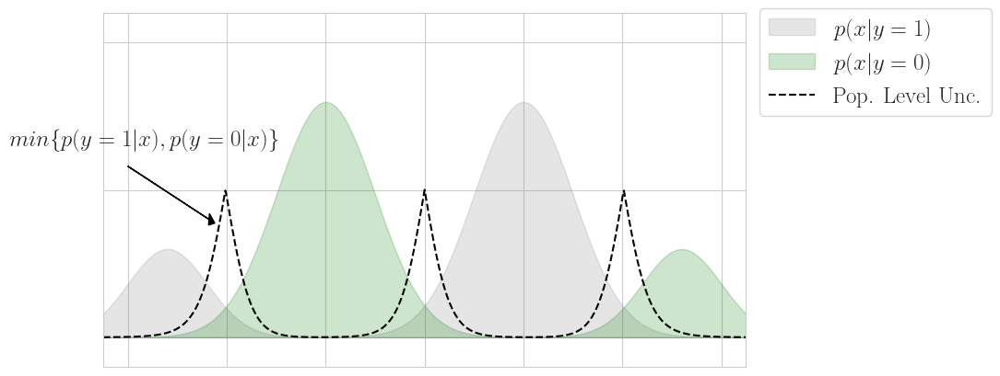

In [183]:
fig, ax = plt.subplots(figsize=(9,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray', label=r'$p(x | y = 1)$')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green', label=r'$p(x | y = 0)$')
ax.plot(dom, f, 'k--', label=r'Pop. Level Unc.')
ax.set_ylim(-0.1,1.1)
ax.set_xlim(-3.25,3.25)
ax.legend(fontsize=18, bbox_to_anchor=(1.4,1.045))
ax.set_ylabel('')
ax.set_yticks([0.0, 0.5, 1.0])
ax.text(x=-4.2, y=0.65, s=r'$min\{p(y=1|x), p(y=0|x)\}$', fontsize=18)
ax.arrow(-3, 0.58, 0.82, -0.18, color= 'k', head_width=0.04)
ax.set_xticklabels([])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/pdf_pop.png"), dpi=200, bbox_inches='tight')
plt.show()

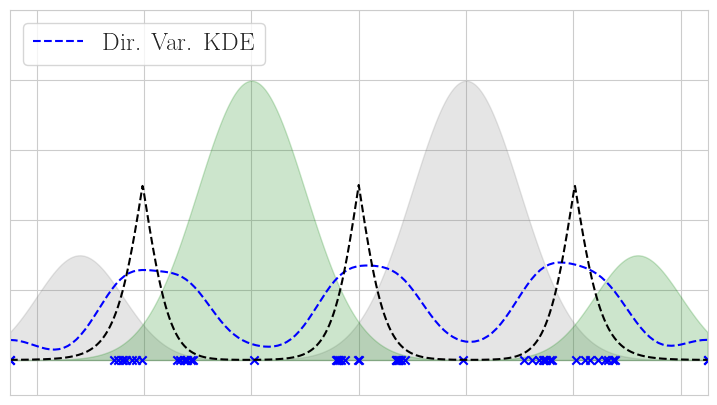

In [184]:
fig, ax = plt.subplots(figsize=(9,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
p = sns.kdeplot(xlab_dir.flatten(), bw_method=0.15, linestyle='--', label=r'Dir. Var. KDE', color='b')
ax.scatter(xlab_dir, np.zeros_like(ylab_dir), marker='x', color=ax.lines[-1].get_color())
# p = sns.kdeplot(xlab_svm.flatten(),bw_method=0.2, label=r'Min. Margin', color='r')
# ax.scatter(xlab_svm, np.zeros_like(ylab_svm), marker='s', color=p.lines[-1].get_color())
ax.plot(dom, f, 'k--') #, label=r'Pop. Level Unc.')
# ax.plot(dom, g, 'g--')
ax.set_xlim(-3.25,3.25)
ax.set_ylim(-0.1,1.0)
ax.legend(fontsize=18, loc='upper left')
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_kde.png"), dpi=200, bbox_inches='tight')
plt.show()

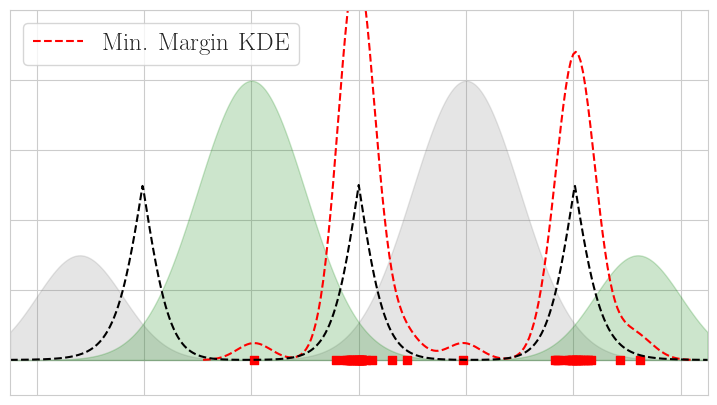

In [185]:
fig, ax = plt.subplots(figsize=(9,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
# p = sns.kdeplot(xlab_dir.flatten(), bw_method=0.15, label=r'Dir. Var.', color='b')
# ax.scatter(xlab_dir, np.zeros_like(ylab_dir), marker='x', color=p.lines[-1].get_color())
p = sns.kdeplot(xlab_svm.flatten(),bw_method=0.15, linestyle='--', label=r'Min. Margin KDE', color='r')
ax.scatter(xlab_svm, np.zeros_like(ylab_svm), marker='s', color=p.lines[-1].get_color())
ax.plot(dom, f, 'k--') #, label=r'Pop. Level Unc.')
ax.set_xlim(-3.25,3.25)
ax.set_ylim(-0.1,1.0)
ax.legend(fontsize=18, loc='upper left')
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/mm_kde.png"), dpi=200, bbox_inches='tight')
plt.show()

## Scaling $\lambda(t)$ Experiment

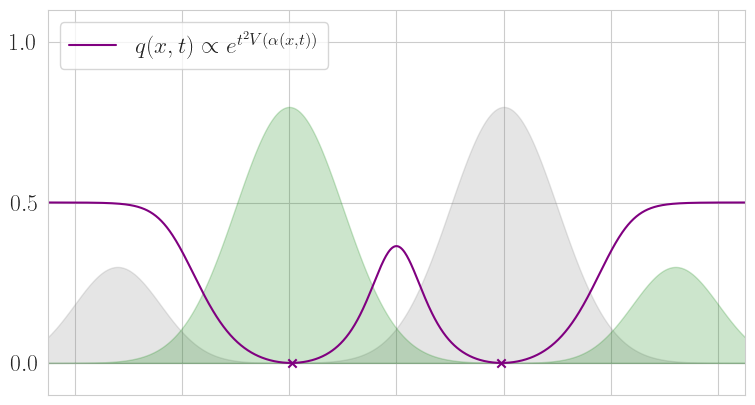

[0 1 1]


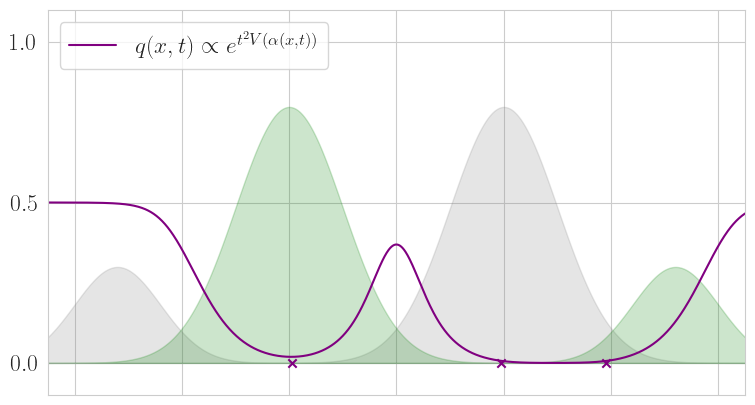

[0 1 1 1]


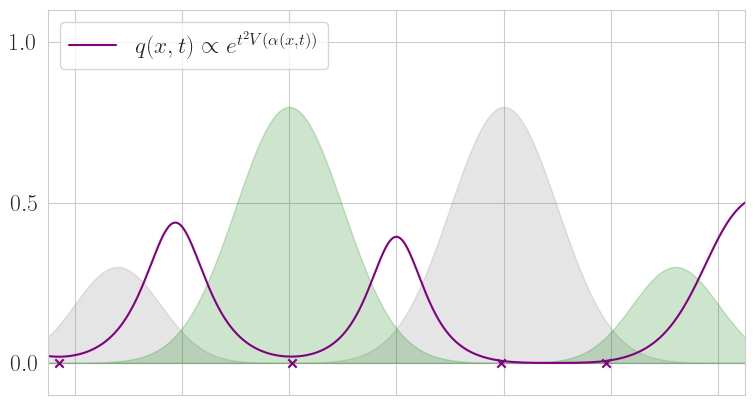

[0 1 1 1 1]


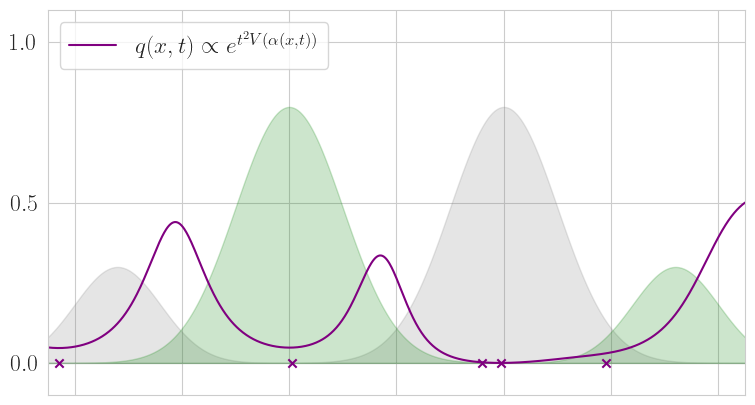

[0 1 1 1 1 1]


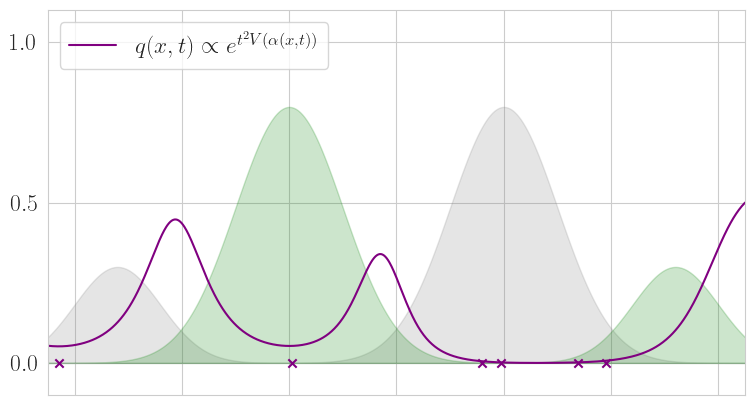

[0 1 1 1 1 1 0]


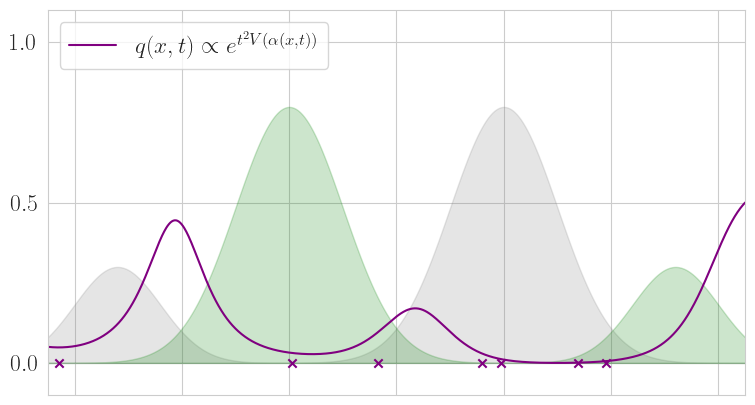

[0 1 1 1 1 1 0 0]


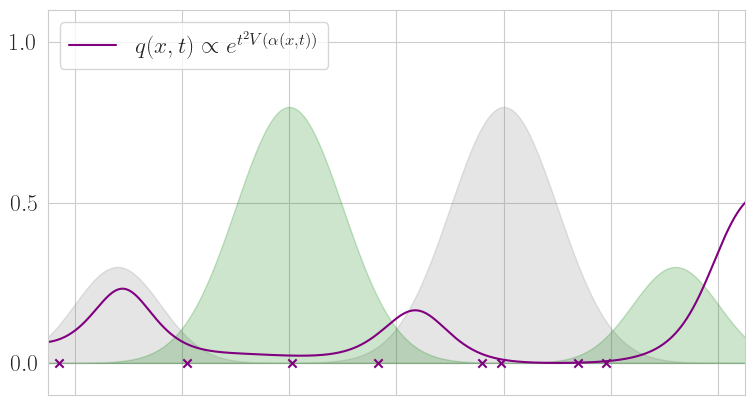

[0 1 1 1 1 1 0 0 1]


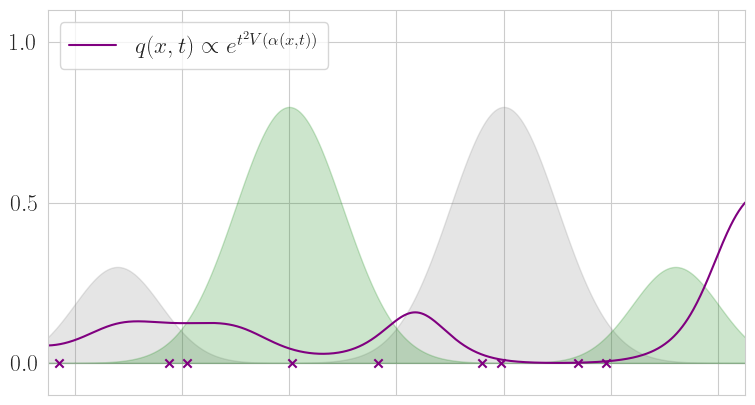

[0 1 1 1 1 1 0 0 1 1]


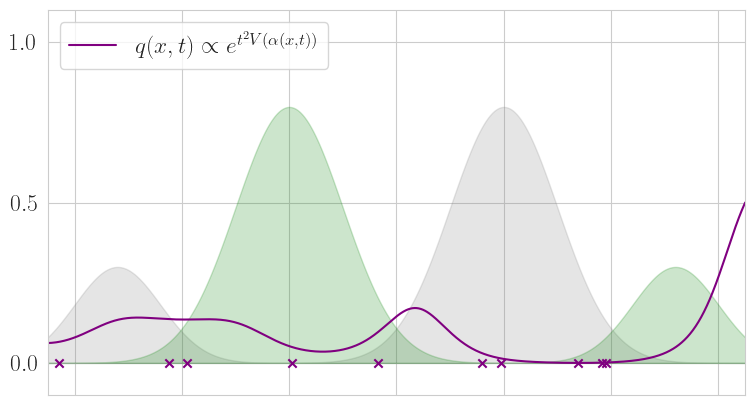

[0 1 1 1 1 1 0 0 1 1 1]


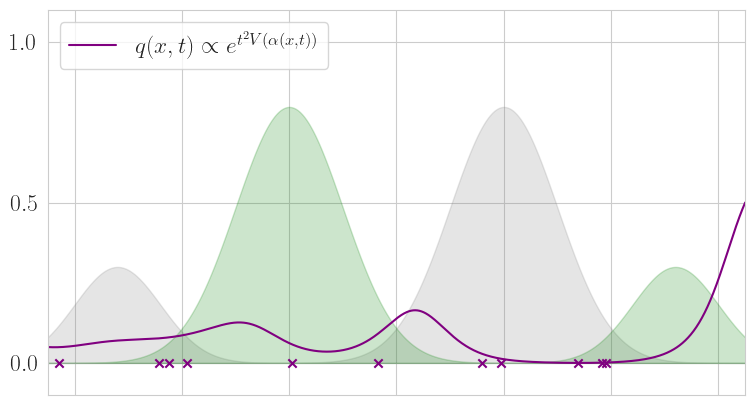

[0 1 1 1 1 1 0 0 1 1 1 1]


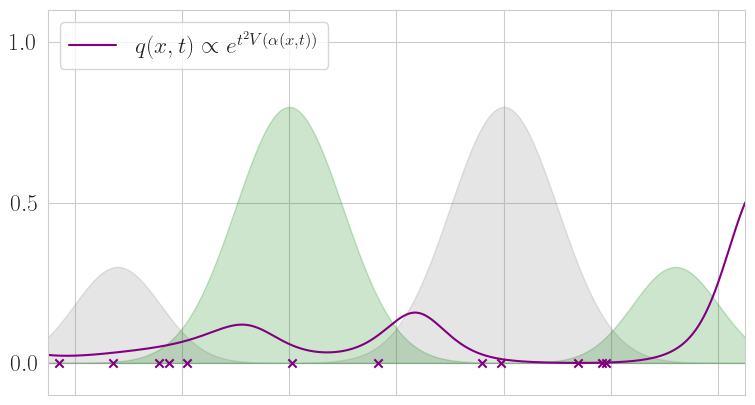

[0 1 1 1 1 1 0 0 1 1 1 1 1]


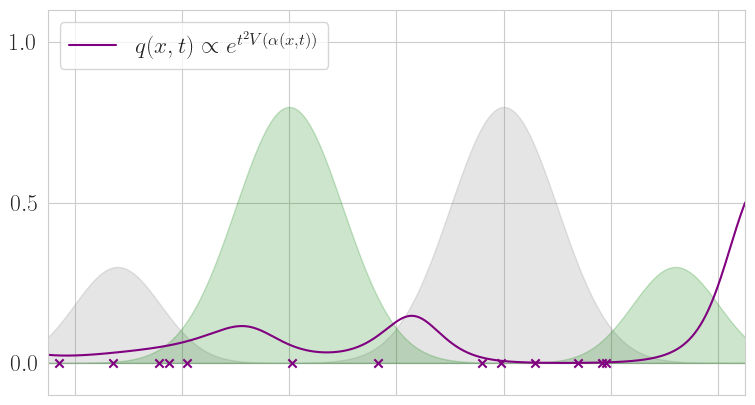

[0 1 1 1 1 1 0 0 1 1 1 1 1 0]


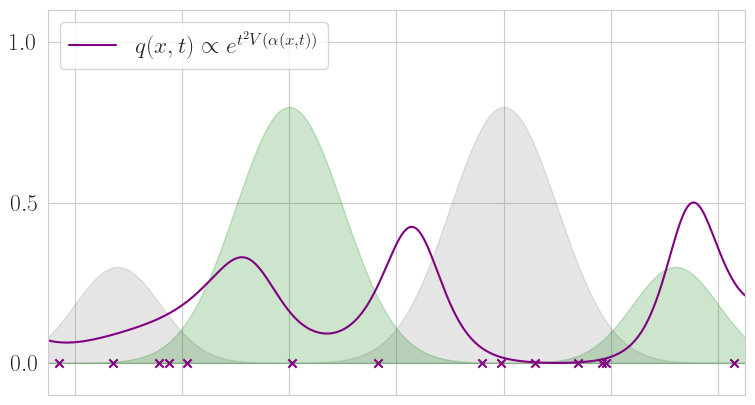

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1]


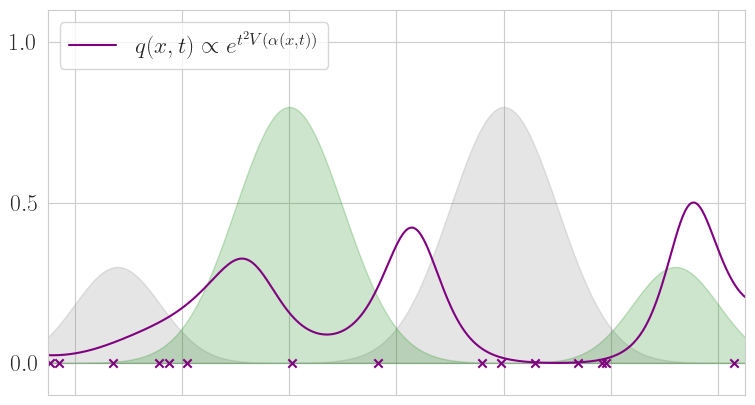

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1]


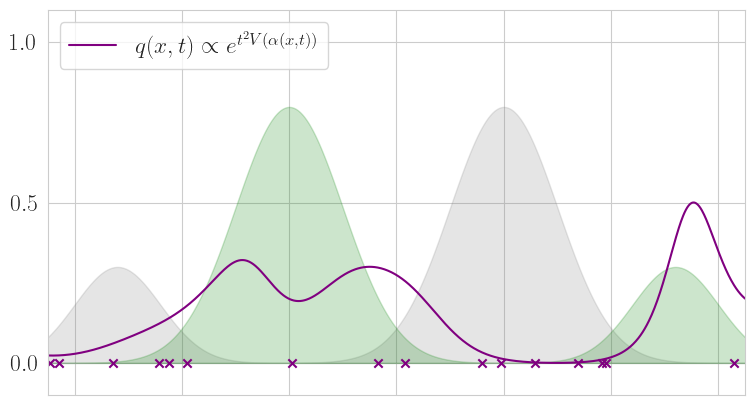

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0]


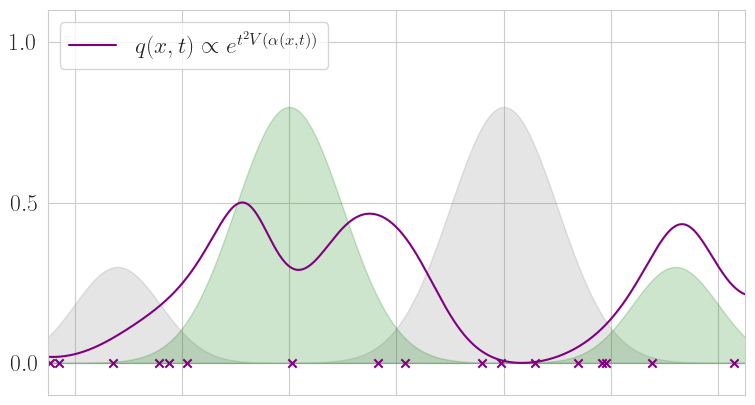

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1]


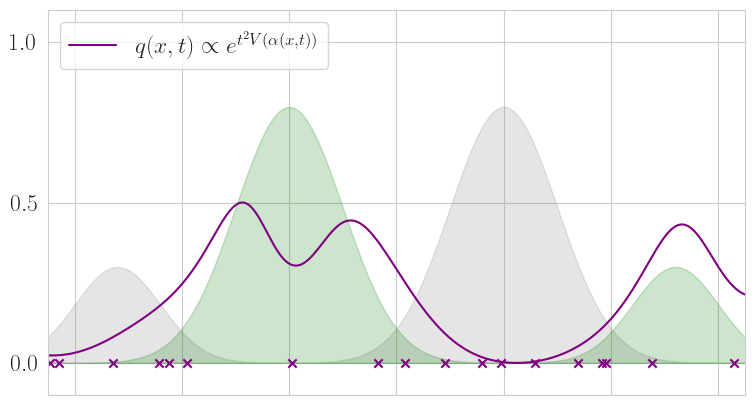

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1]


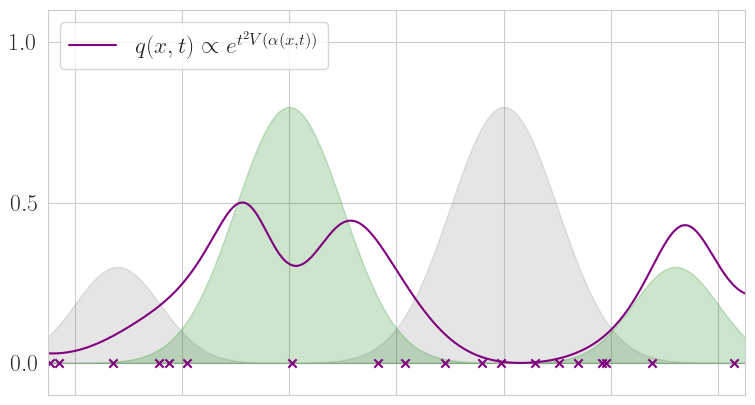

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0]


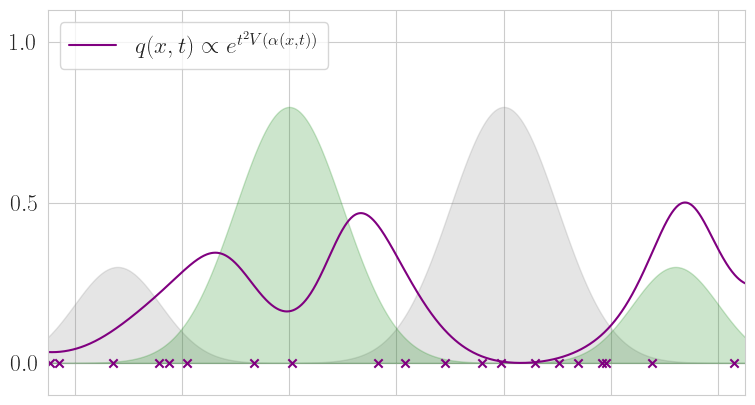

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0]


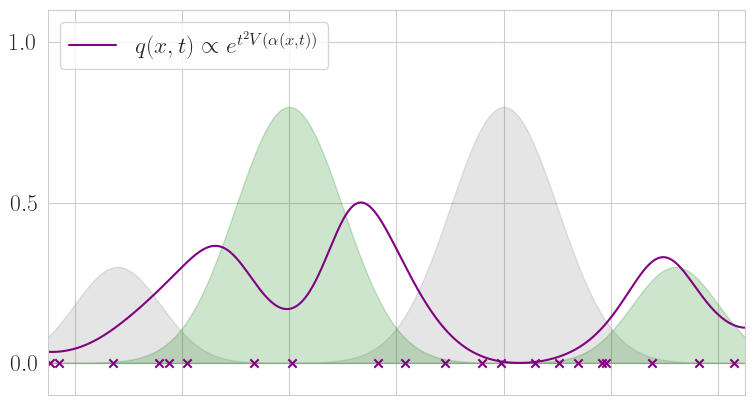

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1]


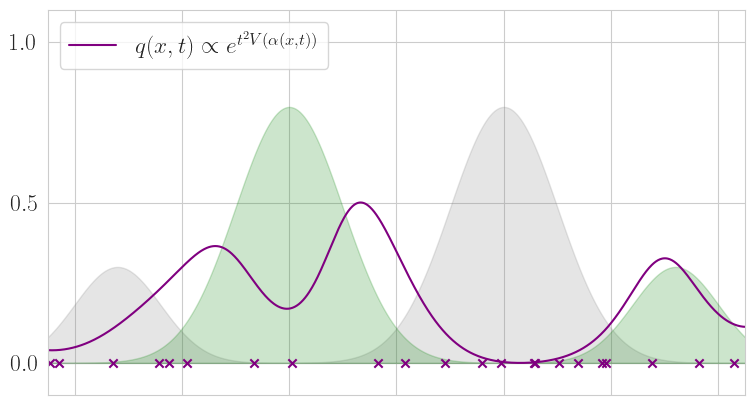

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0]


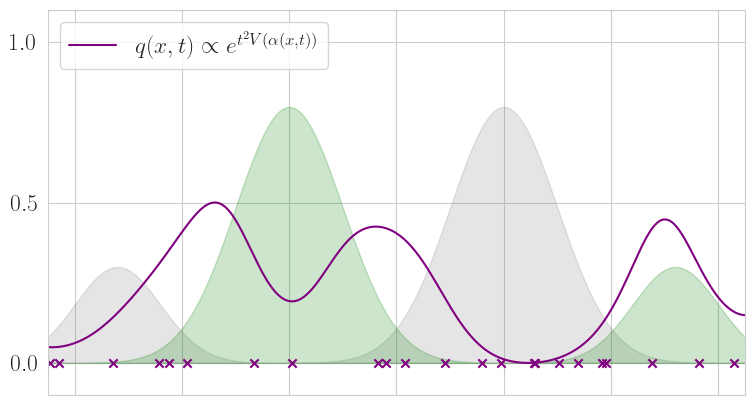

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1]


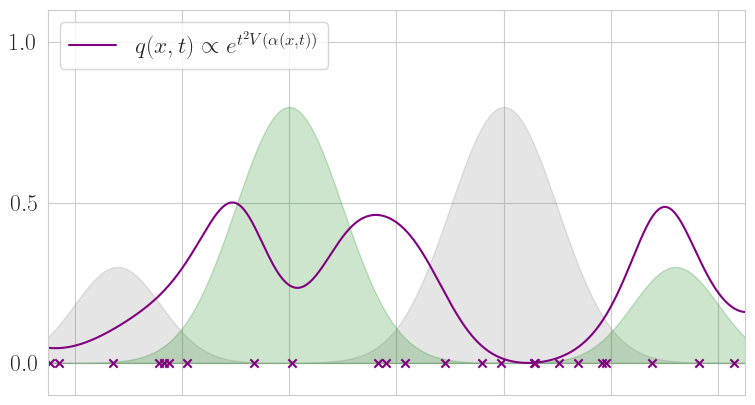

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0]


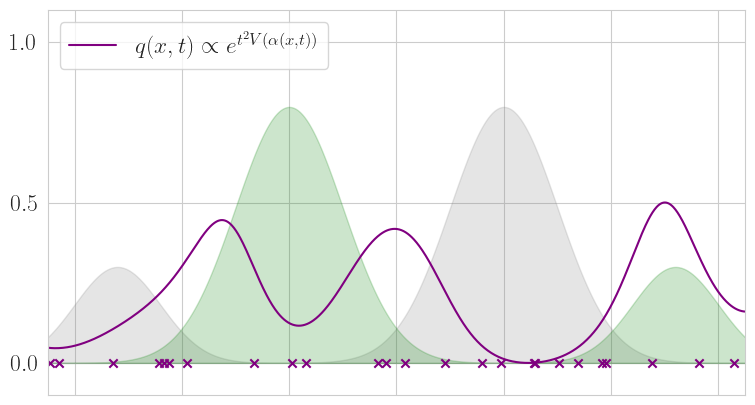

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1]


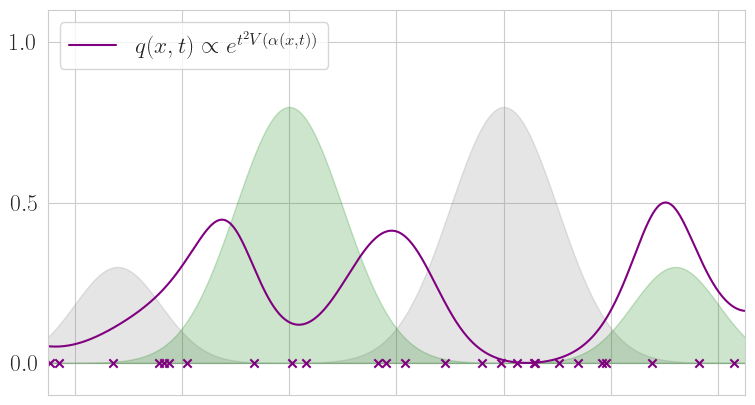

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0]


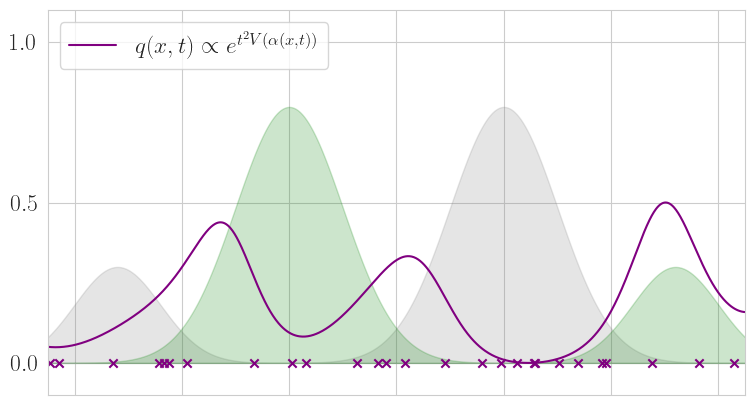

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0]


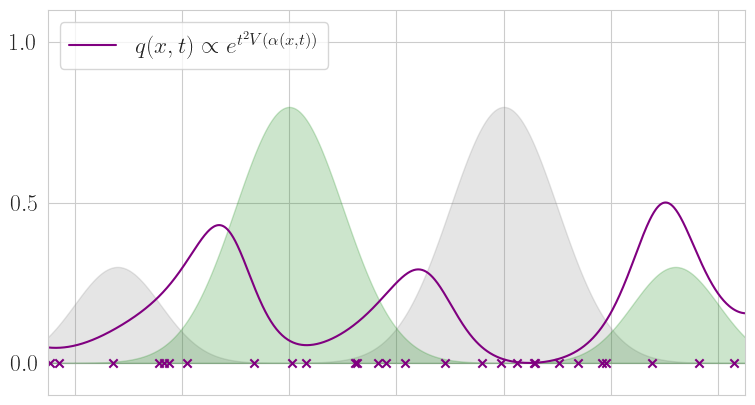

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1]


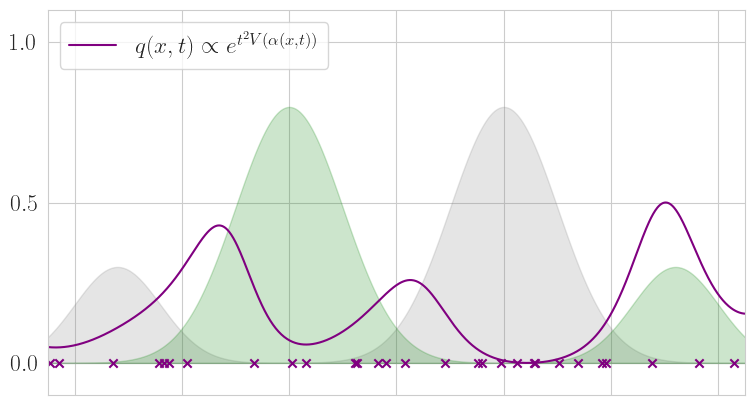

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1]


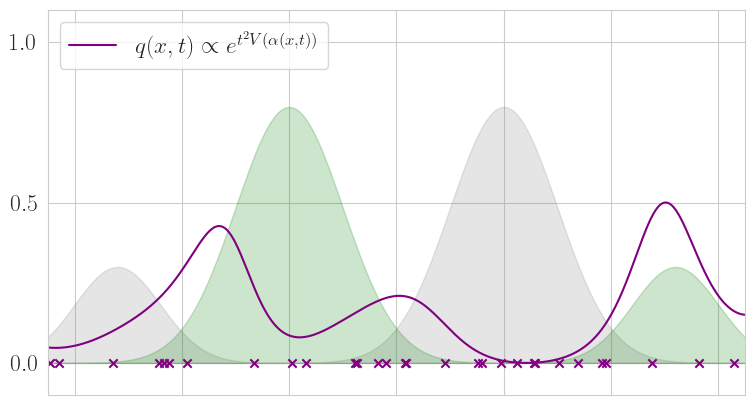

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1]


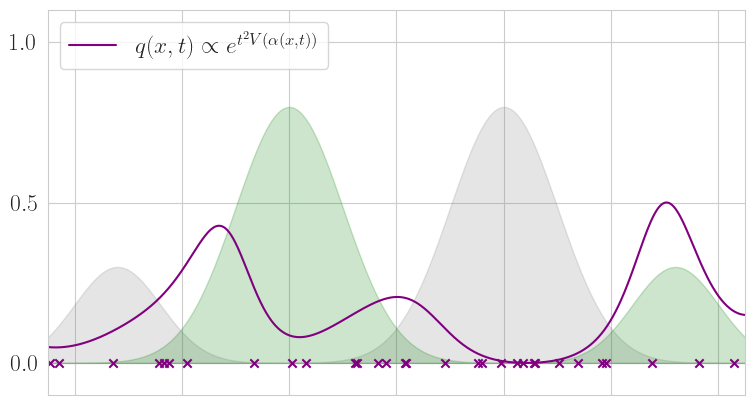

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1]


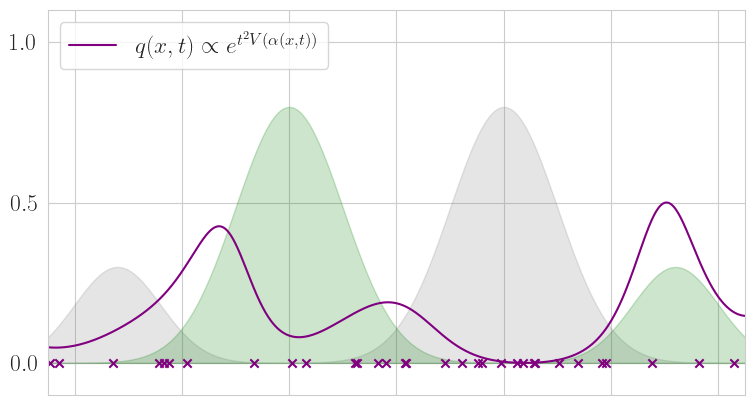

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0]


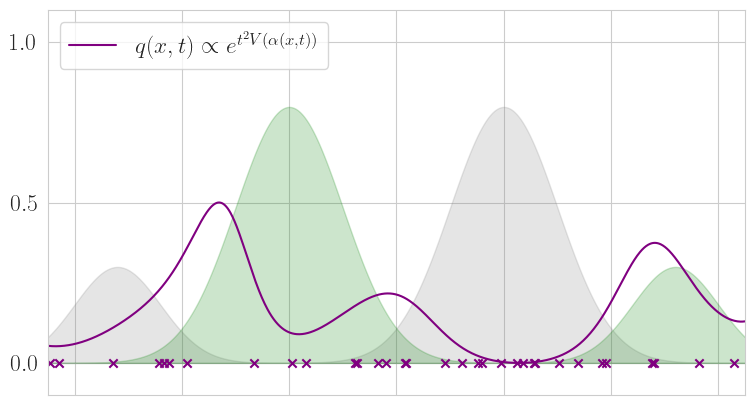

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0]


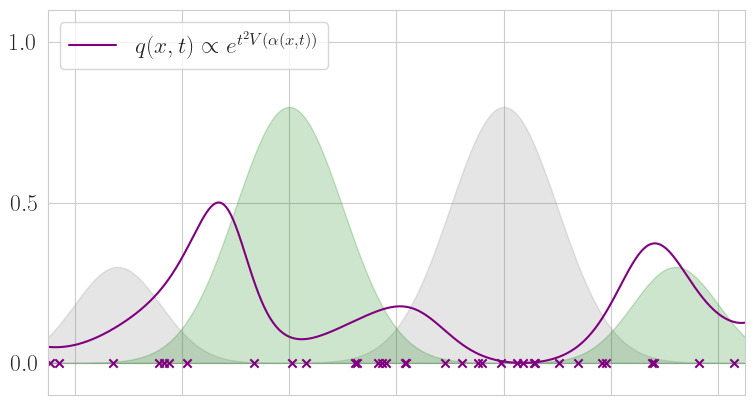

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0]


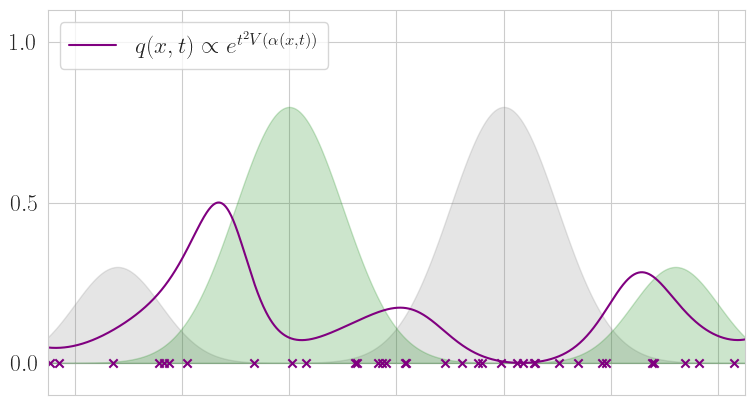

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0]


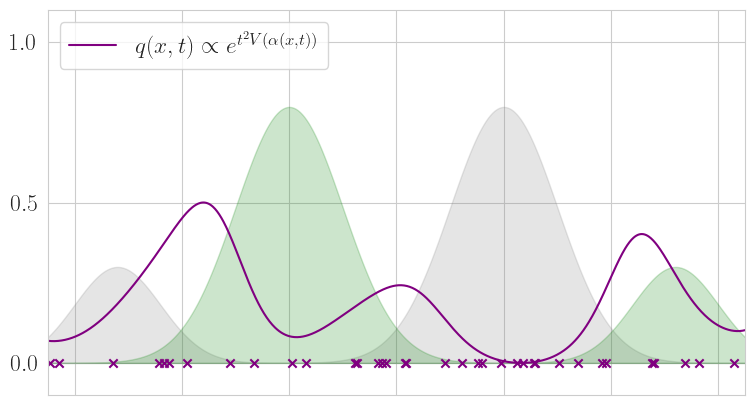

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1]


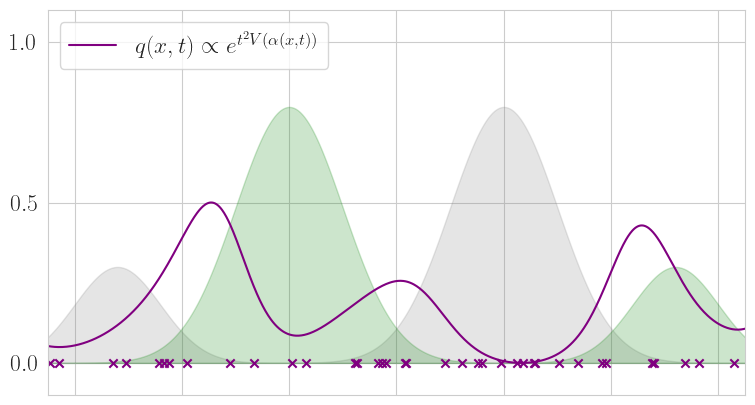

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0]


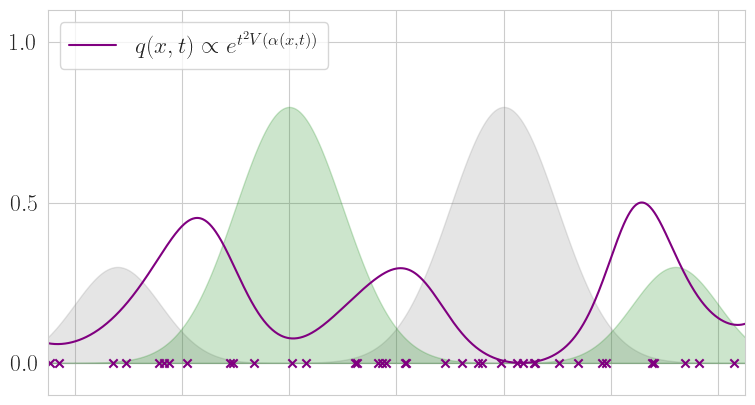

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1]


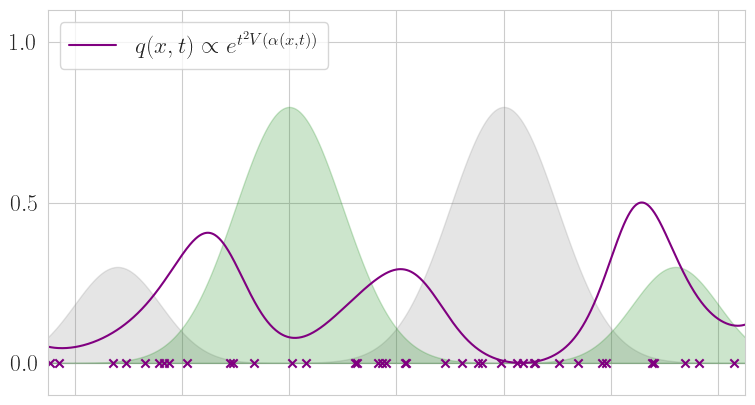

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0]


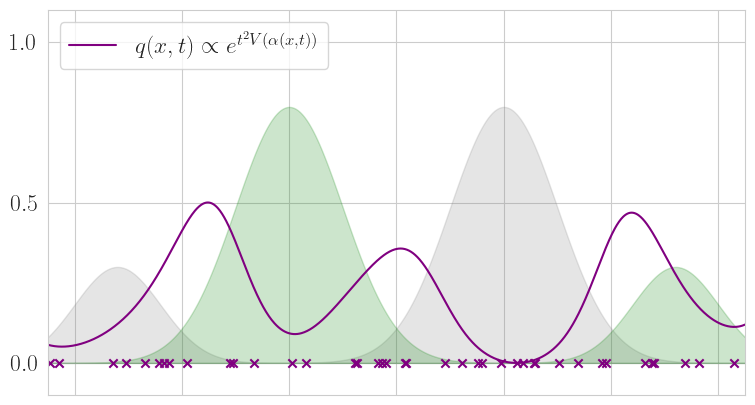

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1]


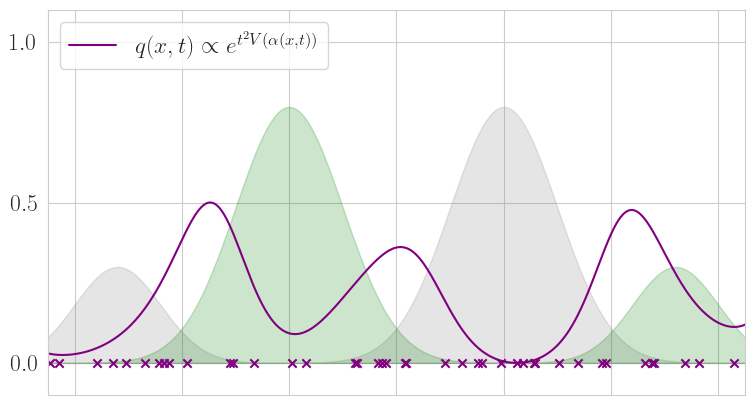

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1]


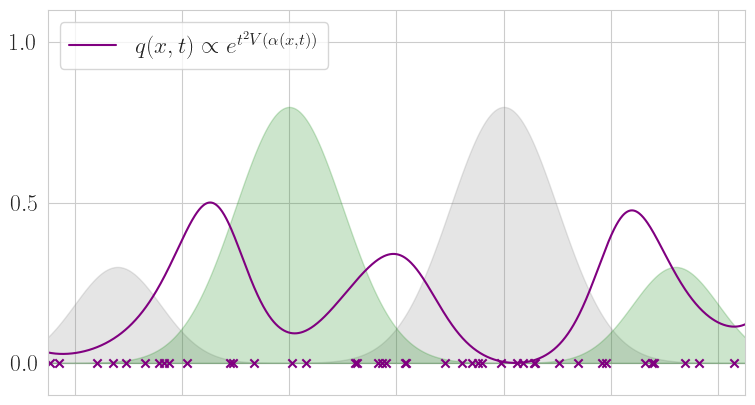

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1]


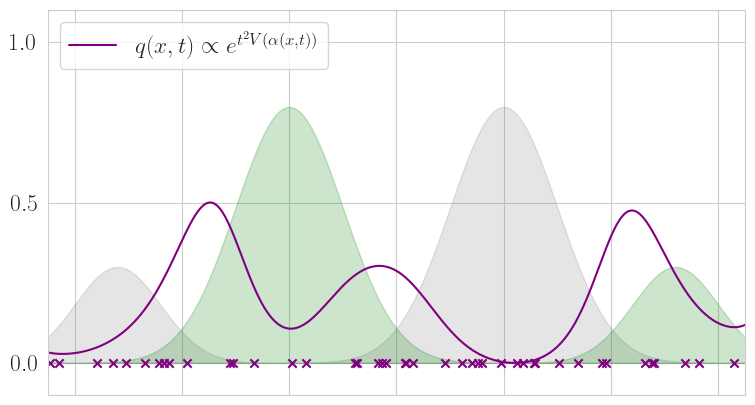

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0]


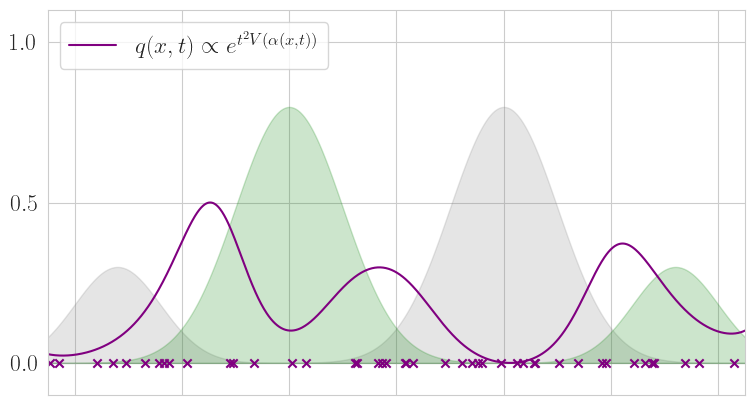

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0]


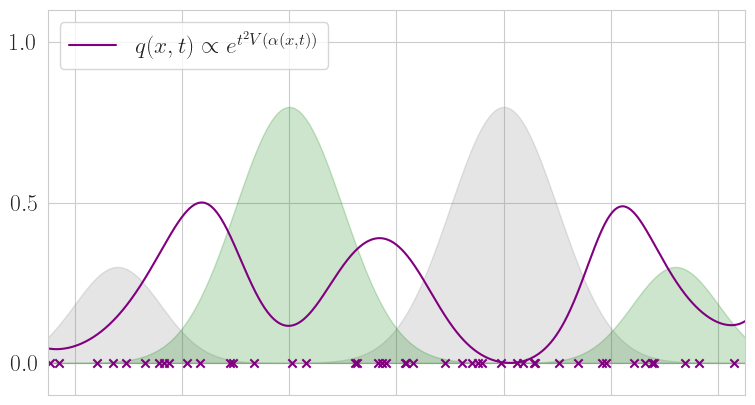

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0]


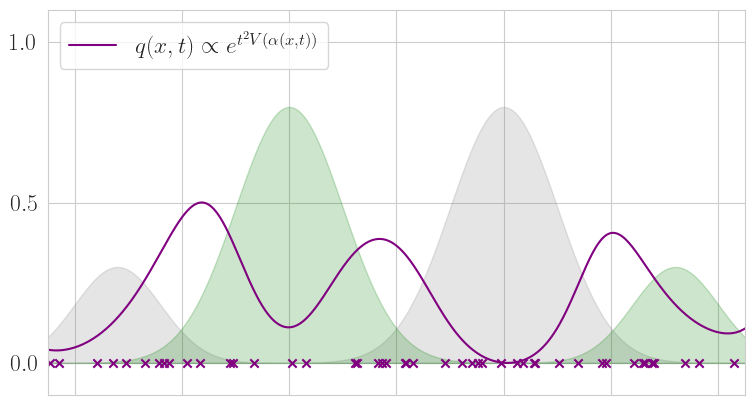

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0]


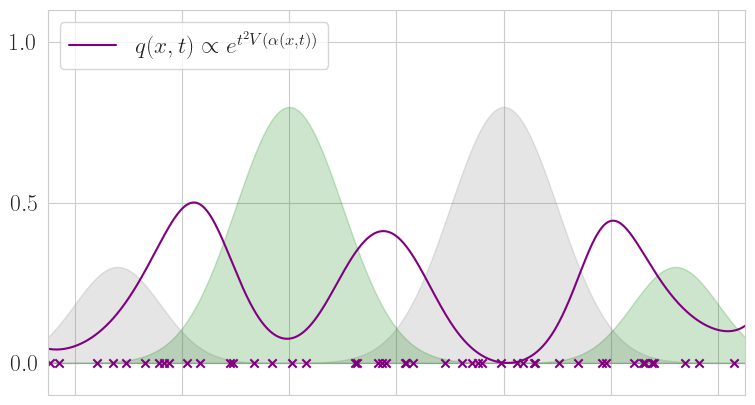

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1]


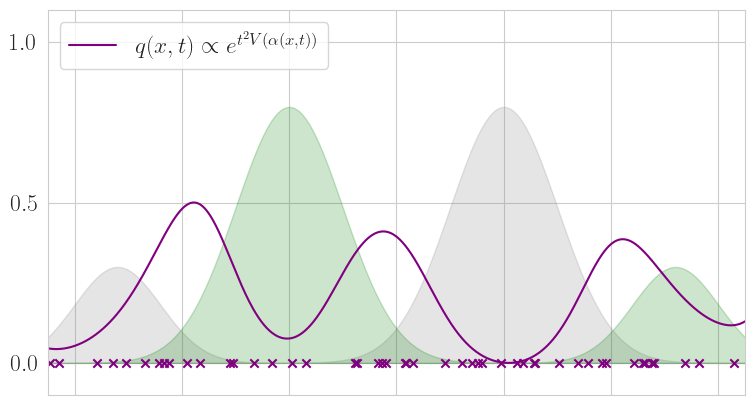

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0]


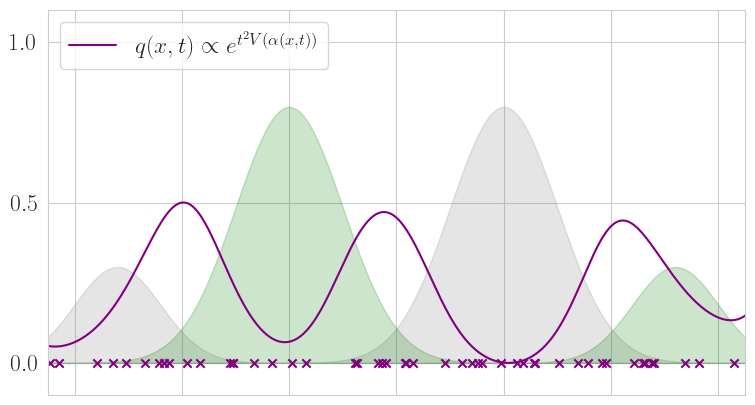

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0]


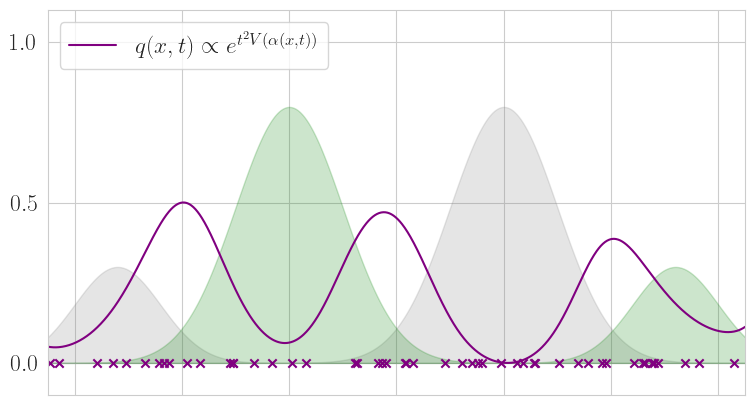

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0]


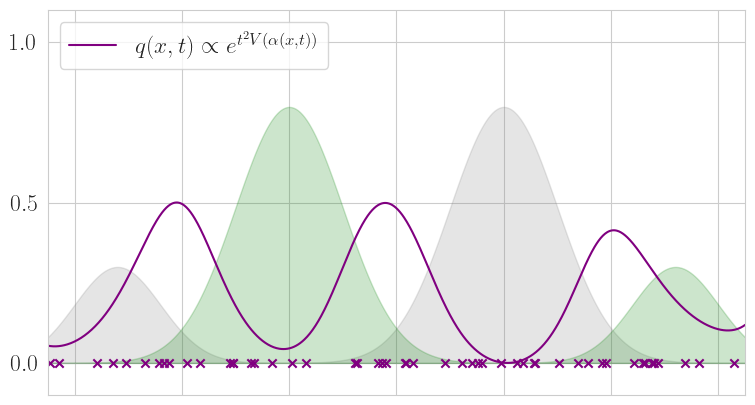

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1]


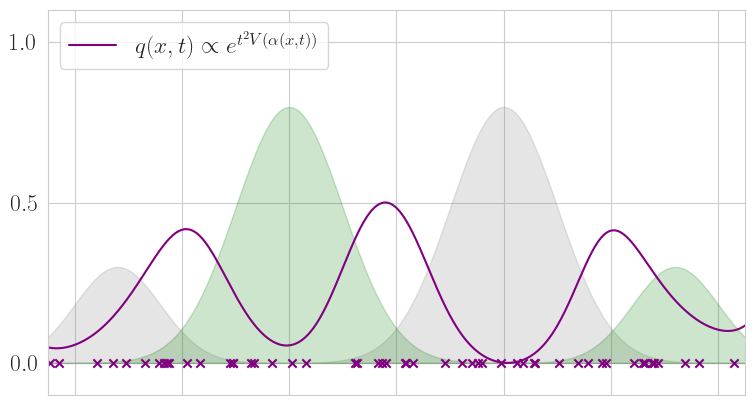

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0]


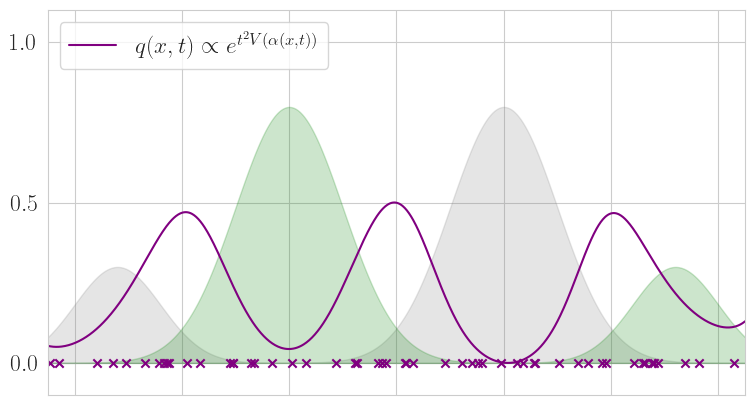

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1]


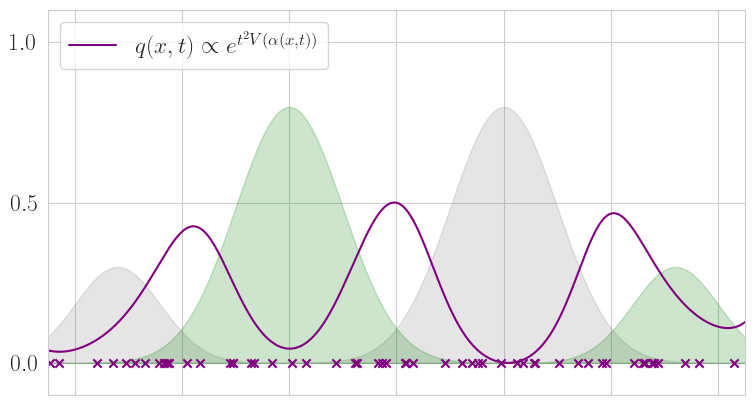

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0]


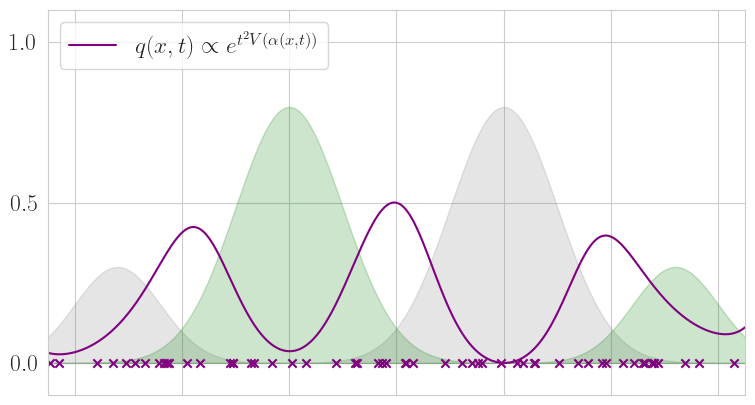

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1]


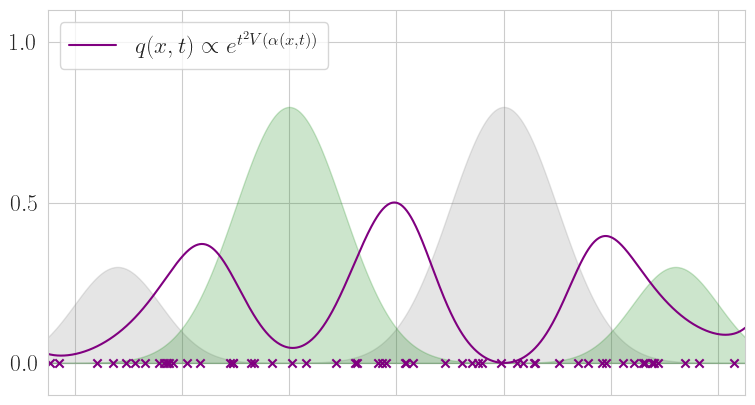

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0]


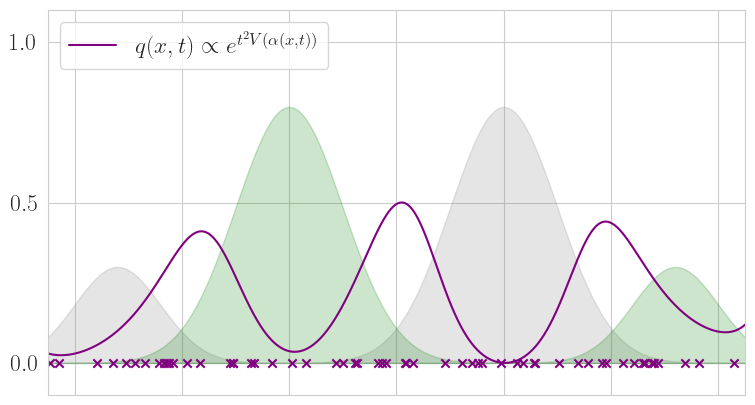

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0]


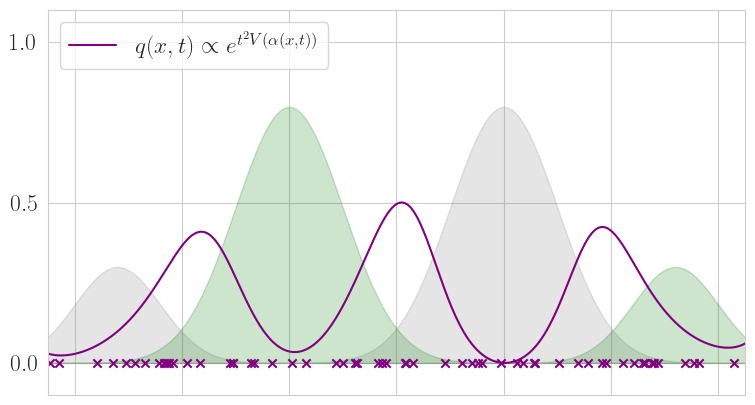

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0]


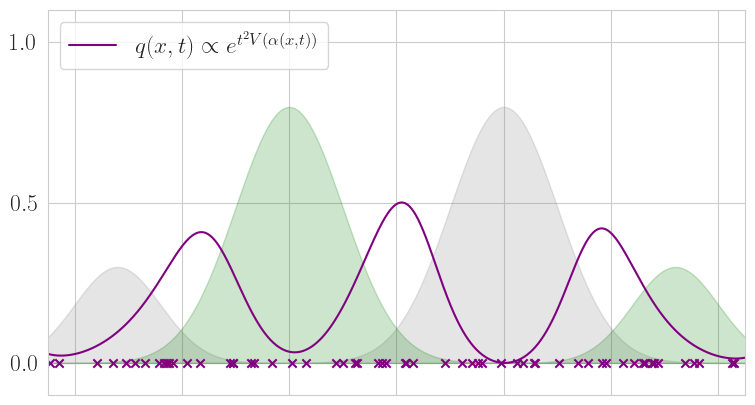

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0]


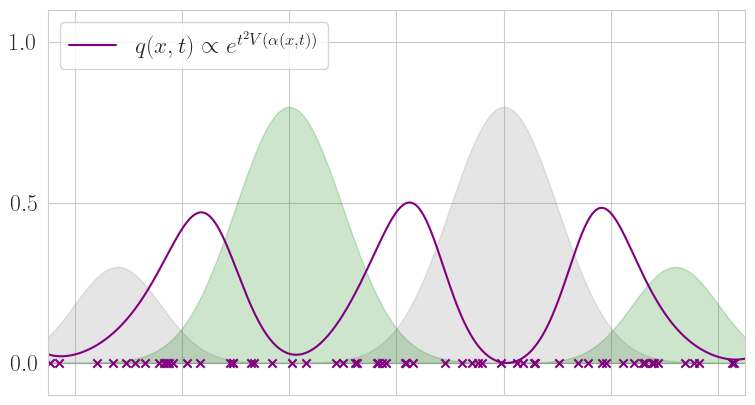

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1]


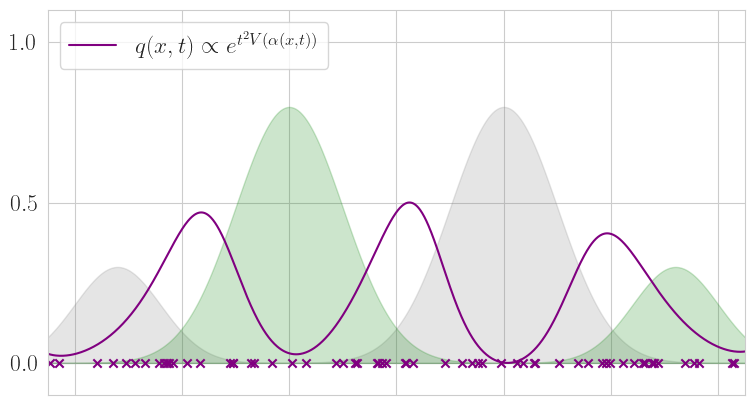

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0]


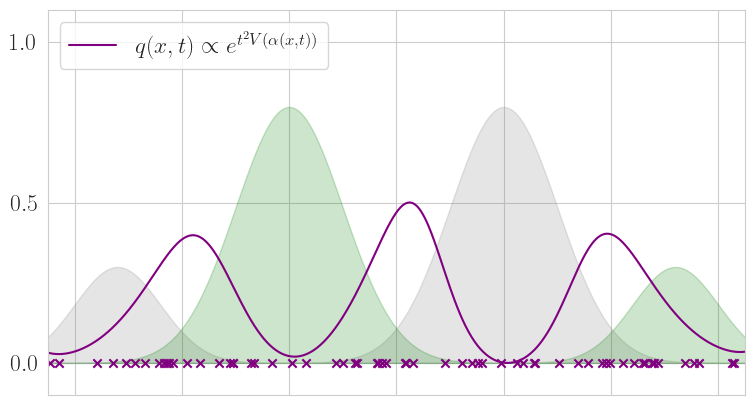

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1]


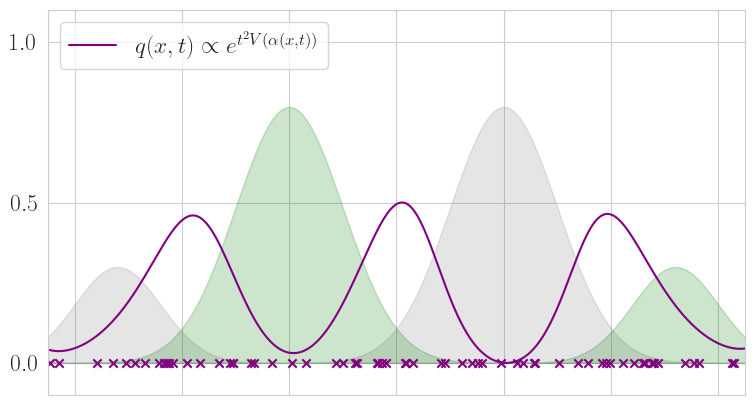

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0]


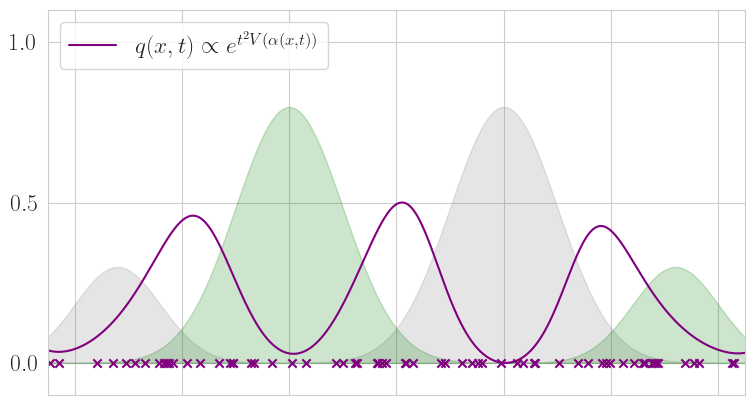

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1]


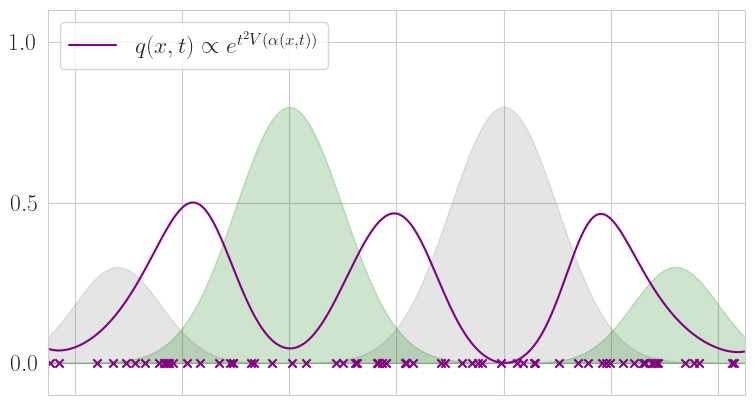

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1]


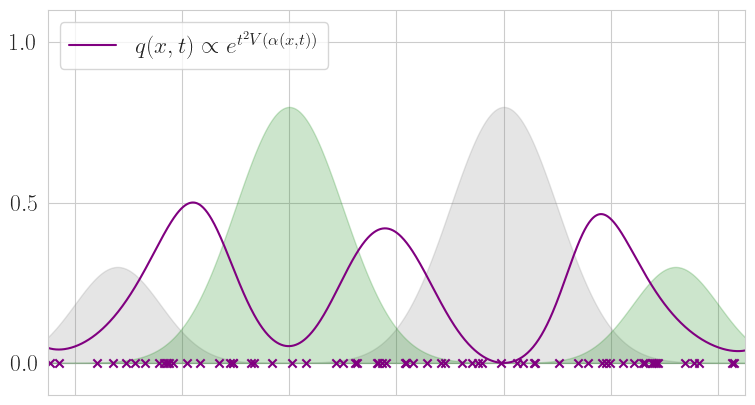

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1]


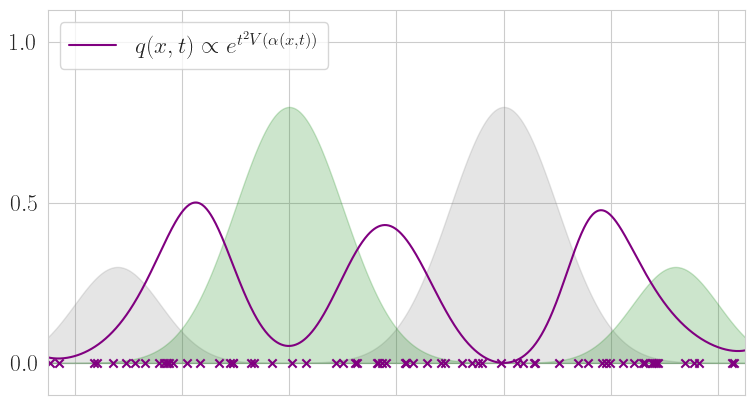

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0]


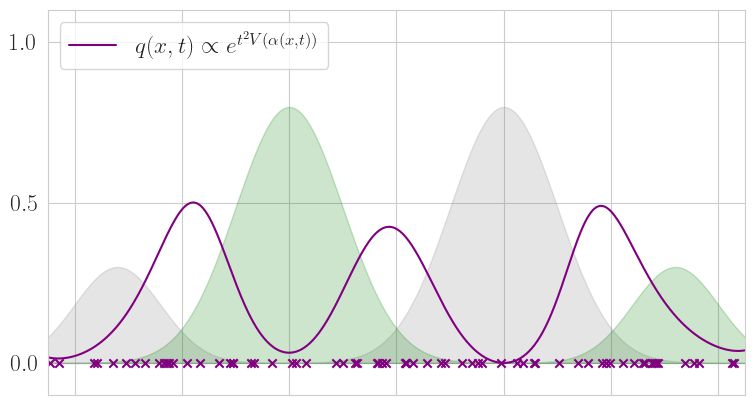

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1]


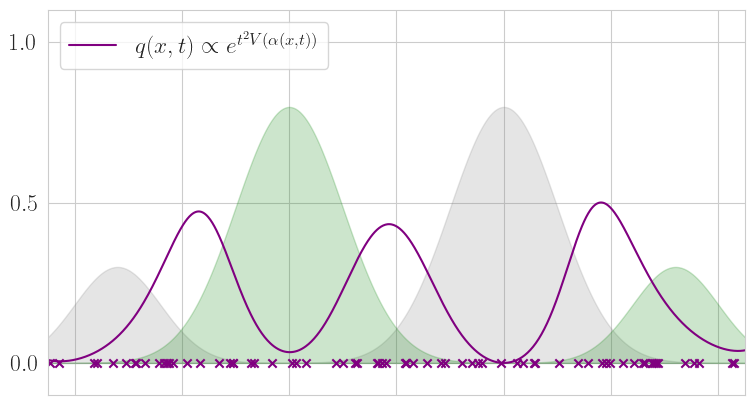

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0]


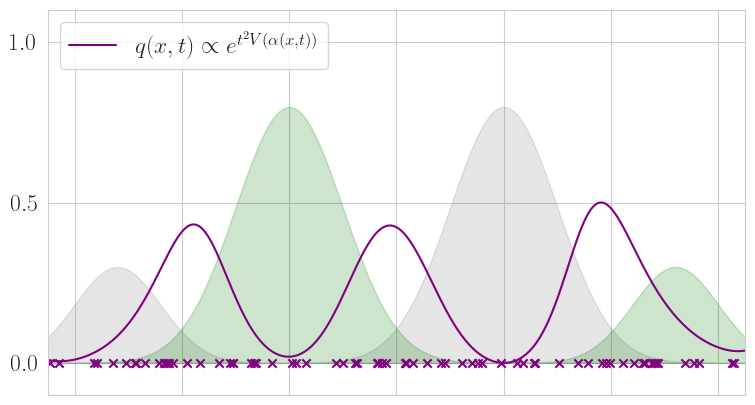

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0]


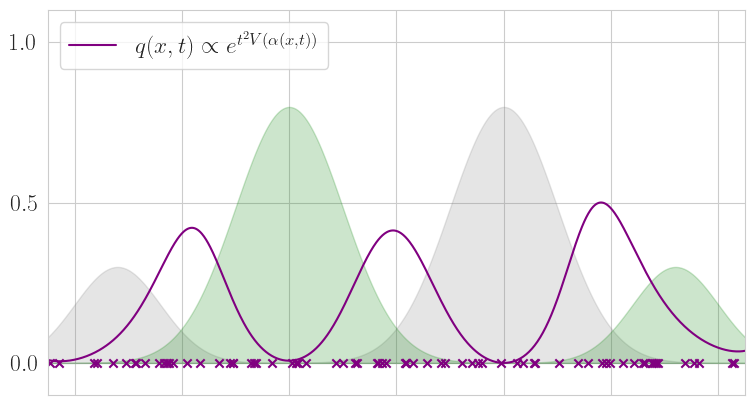

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1]


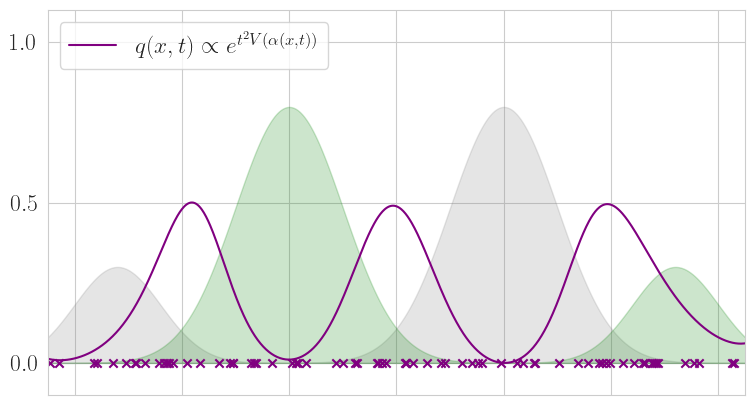

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1]


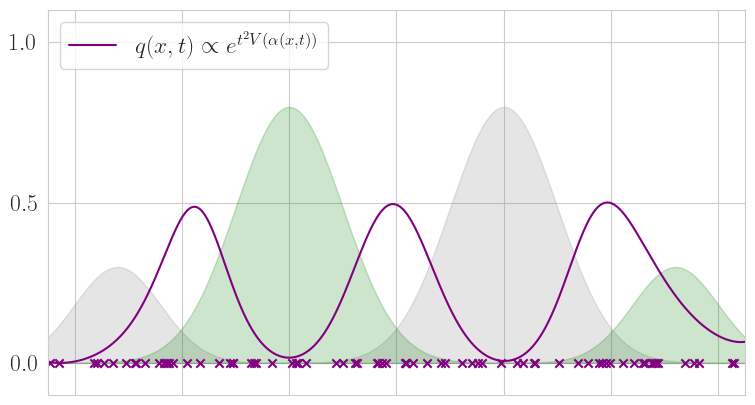

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0]


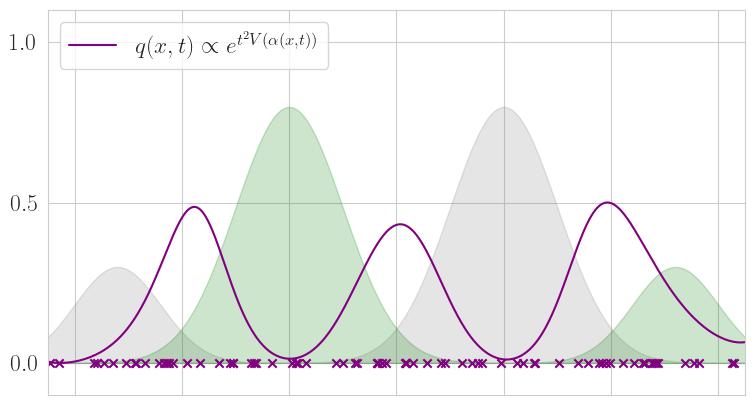

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0]


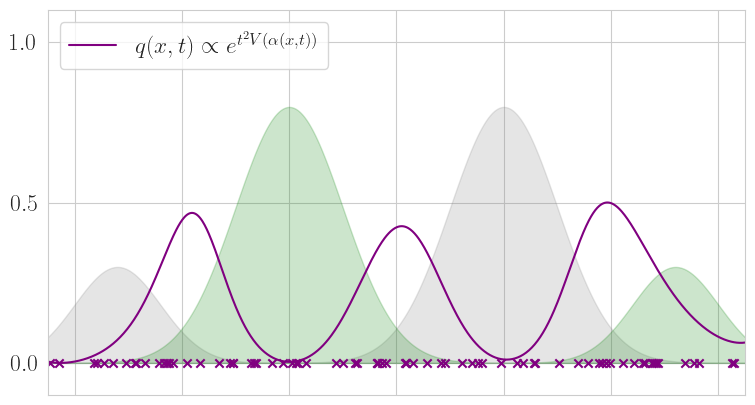

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1]


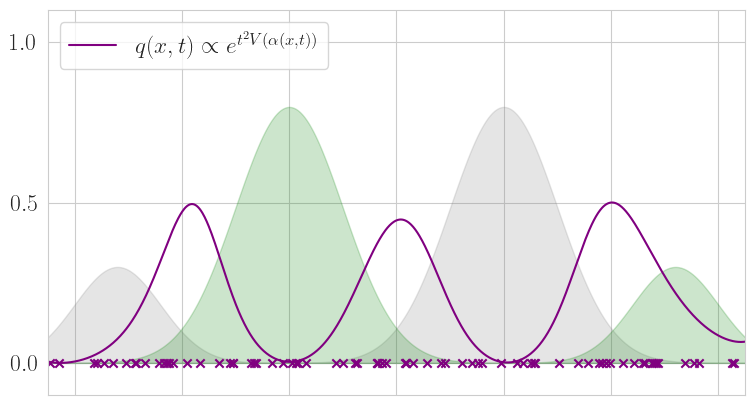

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0]


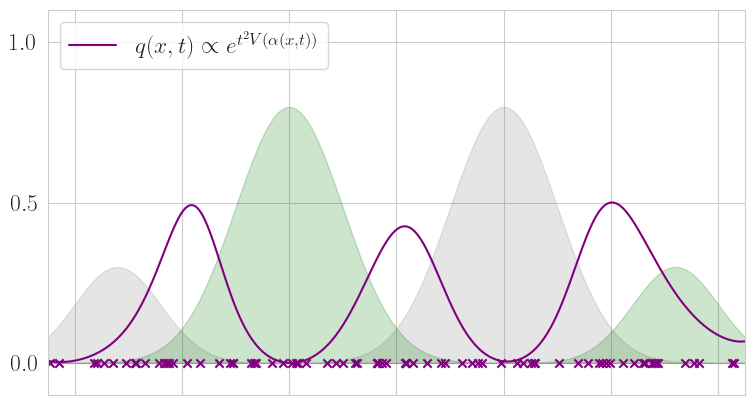

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1]


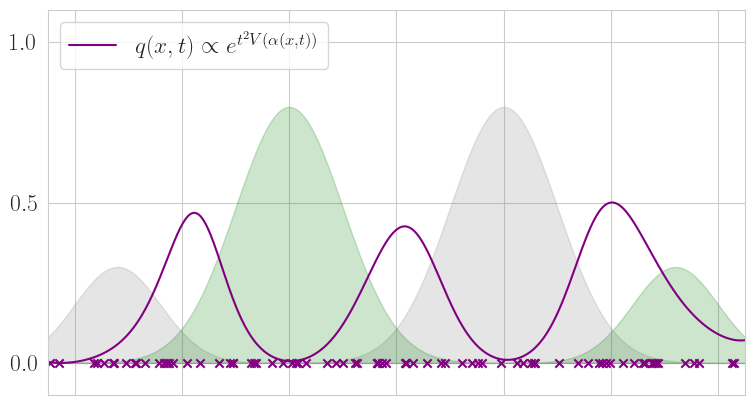

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0]


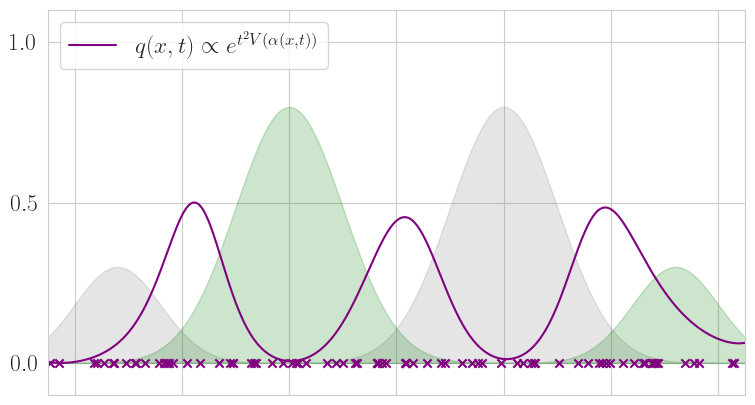

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1]


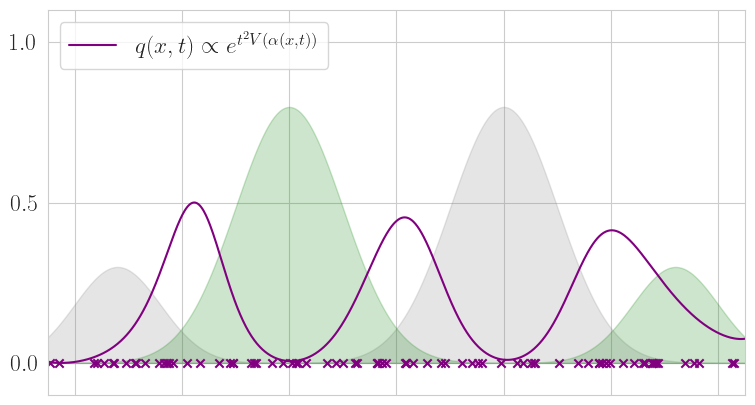

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0]


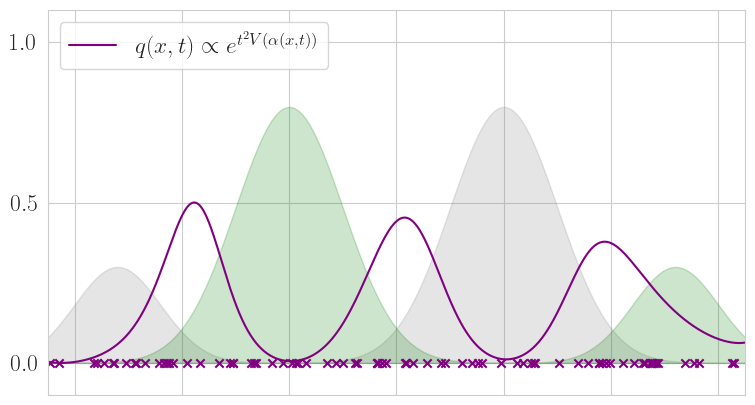

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0]


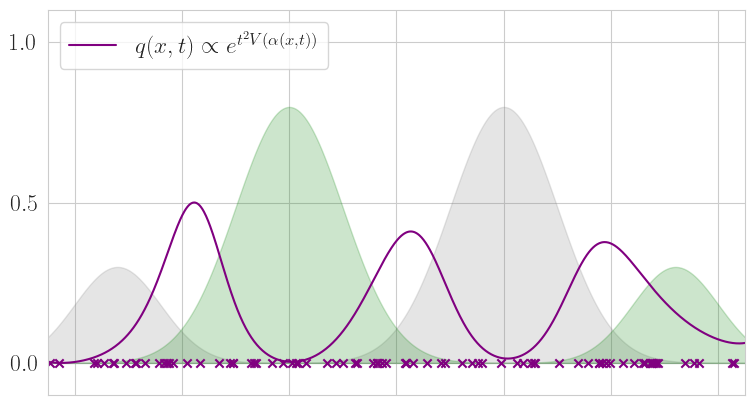

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1]


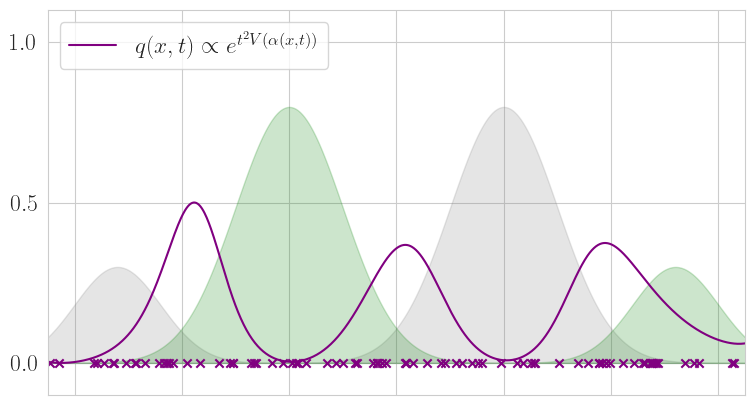

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1]


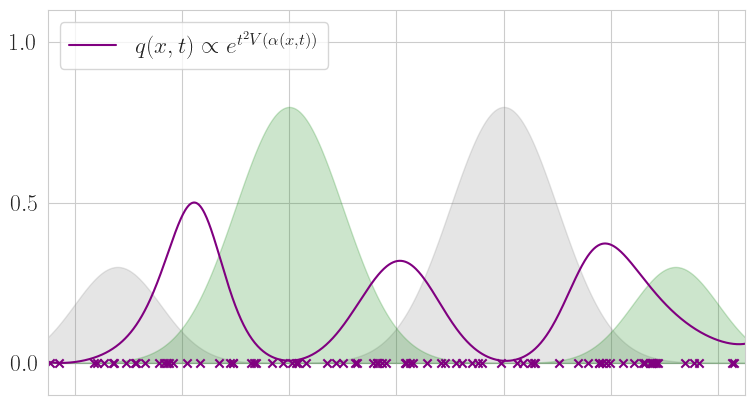

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1]


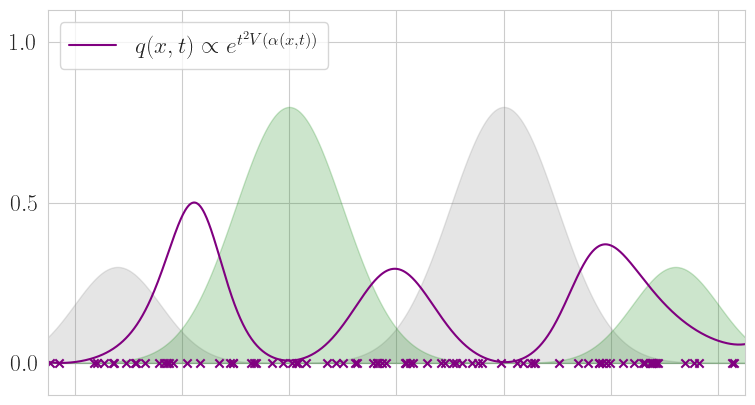

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0]


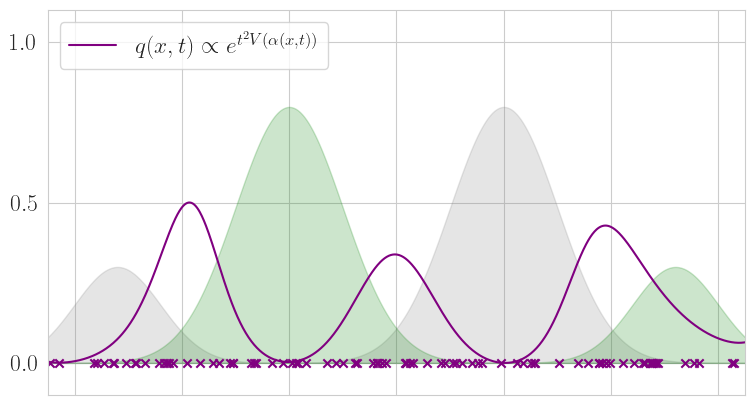

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0]


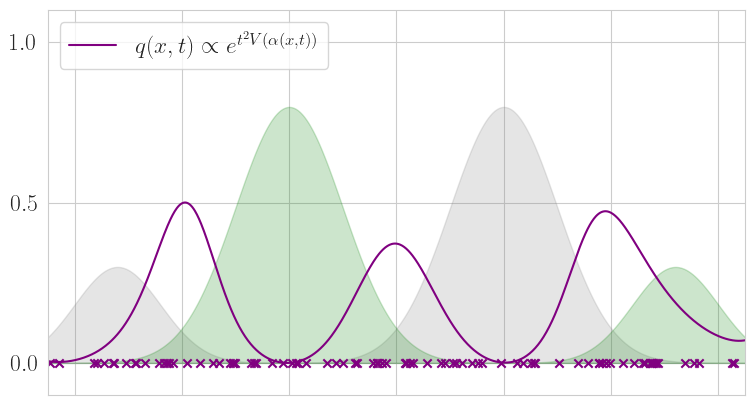

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1]


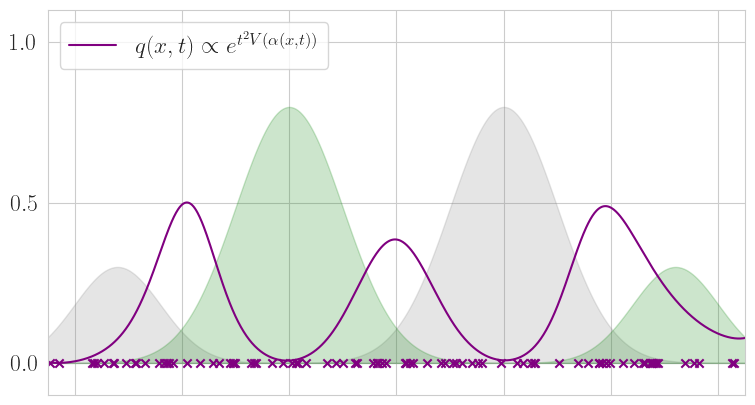

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0]


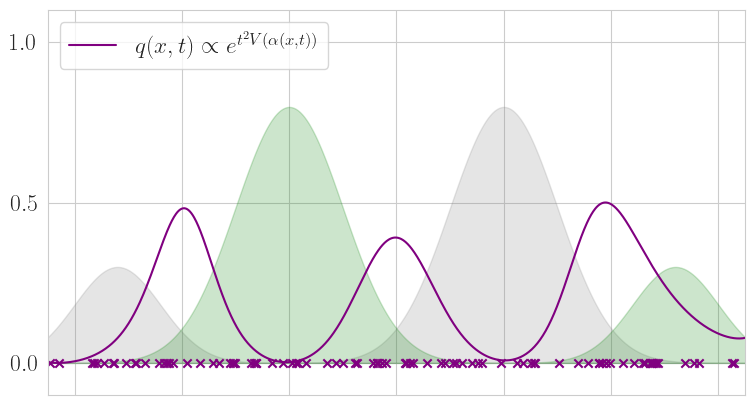

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0]


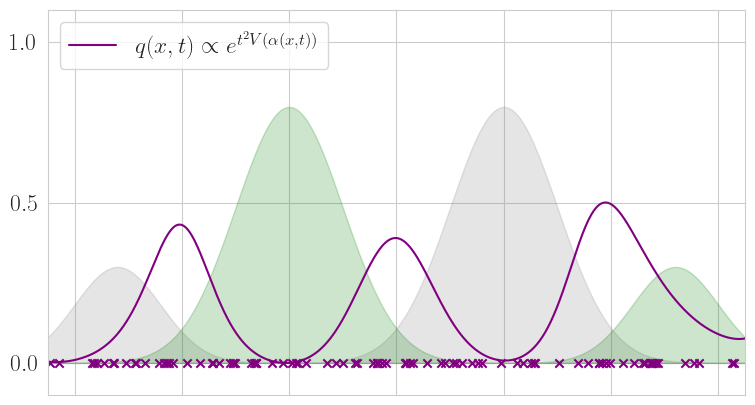

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1]


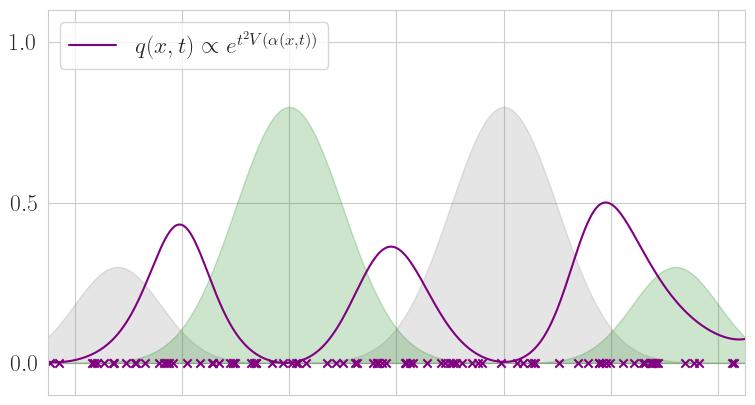

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1]


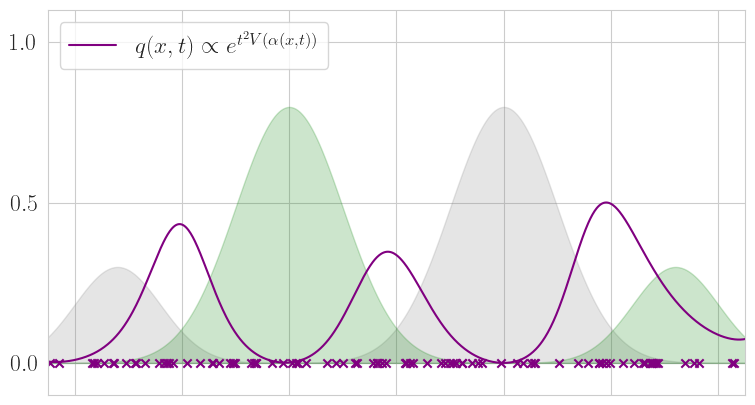

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1]


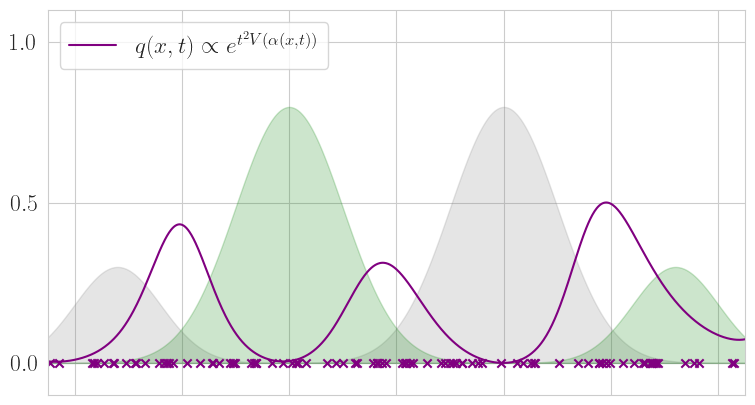

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0]


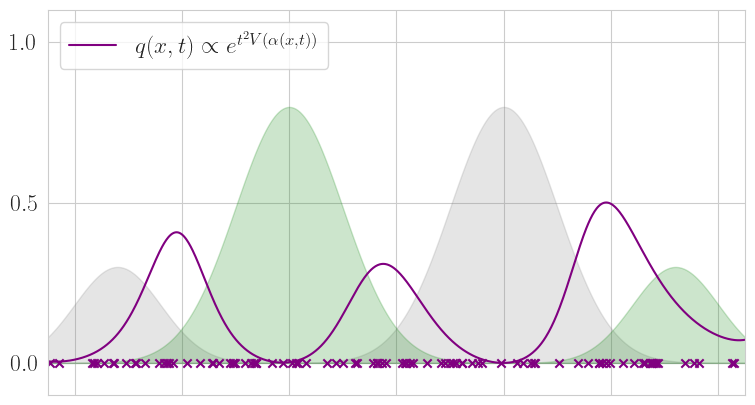

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1]


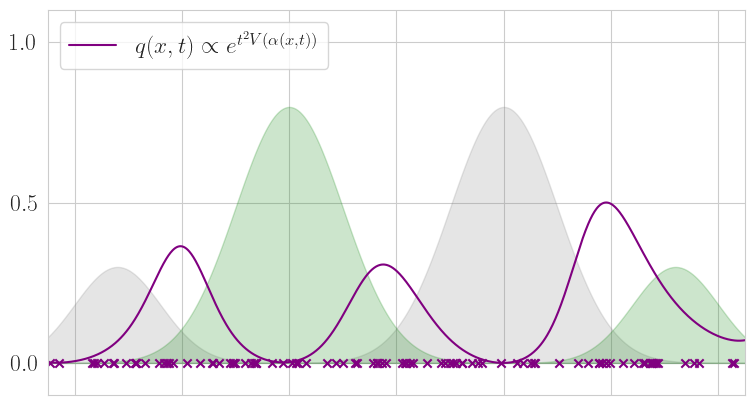

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0]


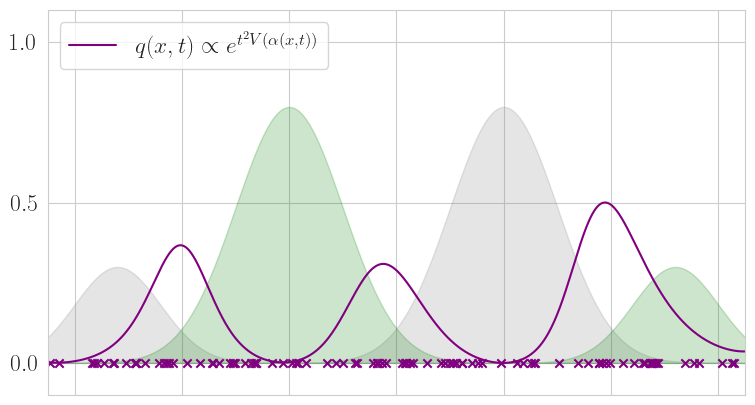

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0]


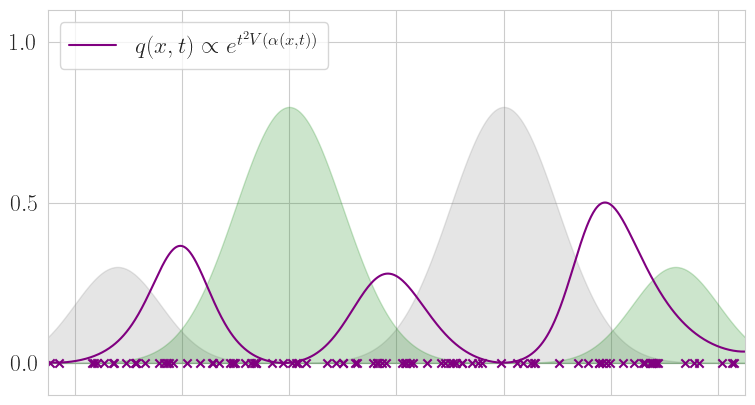

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1]


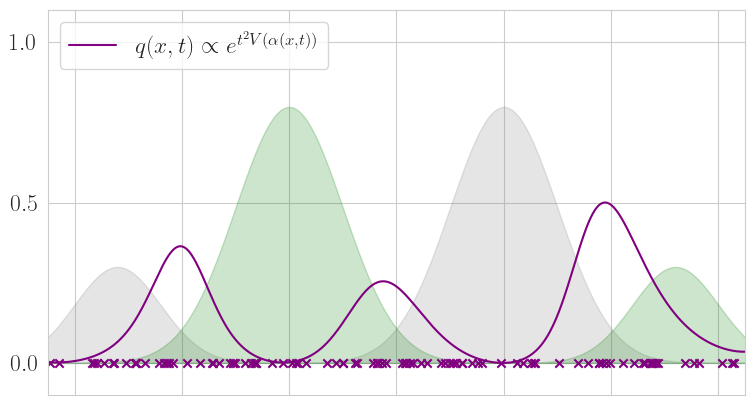

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0]


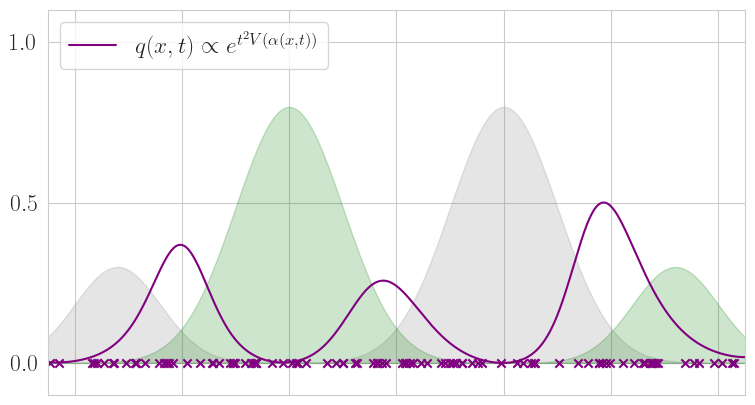

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0]


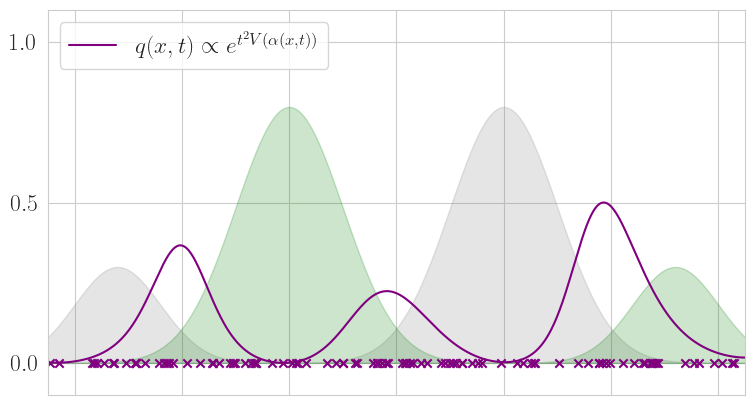

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0]


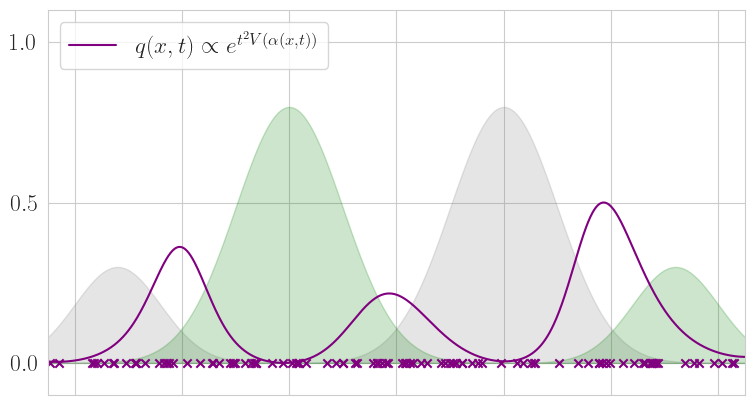

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1]


In [233]:
lam = lambda t: (1. + t/10.)**2.

labeled_ind = np.array([350, 650])
xlab, ylab = dom[labeled_ind][:,np.newaxis], y_lab[labeled_ind]

A = 0.1*np.ones((dom.shape[0], 2))
for x, y in zip(xlab, ylab):
    A[:,int(y)] += rbf_kernel(dom[:,np.newaxis], x[:,np.newaxis], gamma=2.).flatten()

a0 = A.sum(axis=1)
bv_vals = (A * A).sum(axis=1)
bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
out = A[:,0]/(a0)
bv_vals = np.exp(lam(0.)*bv_vals)
bv_vals /= bv_vals.sum()
np.random.seed(10)

for it in range(100):
    bv_vals_ = 0.5*(bv_vals - bv_vals.min())/(bv_vals.max() - bv_vals.min())
    
    fig, ax = plt.subplots(figsize=(9,5))
    ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
    ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
    ax.scatter(xlab, np.zeros_like(ylab), marker='x', c='purple')
    ax.plot(dom, bv_vals_, label=r'$q(x,t) \propto e^{t^2 V(\alpha(x,t))}$', color='purple')
    ax.set_ylim(-0.1,1.1)
    ax.set_xlim(-3.25,3.25)
    ax.legend(loc='upper left', fontsize=17)
    ax.set_ylabel('')
    ax.set_xticklabels([])
    ax.set_yticks([0, 0.5, 1.0], fontsize=20)
    ax.yaxis.set_tick_params(labelsize=17)
    plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_prop_lamt2_iter_{it}.png"), bbox_inches='tight', dpi=200)
    plt.show()
    
    k = np.random.choice(np.arange(bv_vals.size), p=bv_vals)
    labeled_ind = np.append(labeled_ind, k)
    xlab = np.vstack((xlab, np.array([dom[k]])[:,np.newaxis])) 
#     ylab = np.append(ylab, 1*(np.random.rand() < c1[k]/(c1[k] + c2[k]))) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup
    ylab = np.append(ylab, 1*(c1[k] > c2[k])) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup

    print(ylab)
    
    A[:,int(ylab[-1])] += rbf_kernel(dom[:,np.newaxis], xlab[-1][:,np.newaxis], gamma=2.).flatten()
    
    a0 = A.sum(axis=1)
    bv_vals = (A * A).sum(axis=1)
    bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
    bv_vals = np.exp(lam(it)*bv_vals)
    bv_vals /= bv_vals.sum()

xlab_dir_lam, ylab_dir_lam = xlab.copy(), ylab.copy()

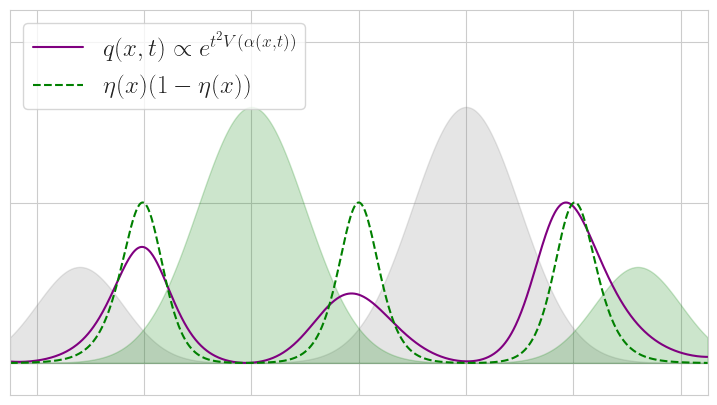

In [226]:
fig, ax = plt.subplots(figsize=(9,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
# p = sns.kdeplot(xlab_dir_lam.flatten(), bw_method=0.15, linestyle='--', label=r'Dir. Var. (Prop. Sampling) KDE', color='purple')
p = ax.plot(dom, bv_vals_, label=r'$q(x,t) \propto e^{t^2 V(\alpha(x,t))}$', color='purple')
# ax.scatter(xlab_dir_lam, np.zeros_like(ylab_dir_lam), marker='x', color=ax.lines[-1].get_color())
# ax.plot(dom, f, 'k--') #, label=r'Pop. Level Unc.')
ax.plot(dom, 0.5*(g - g.min())/(g.max() - g.min()), 'g--', label=r'$\eta(x)(1 - \eta(x))$')
ax.set_xlim(-3.25,3.25)
ax.set_ylim(-0.1,1.1)
ax.legend(fontsize=18, loc='upper left')
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticks([0.0, 0.5, 1.0])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_prop_lamt2_kde.png"), dpi=200, bbox_inches='tight')
plt.show()

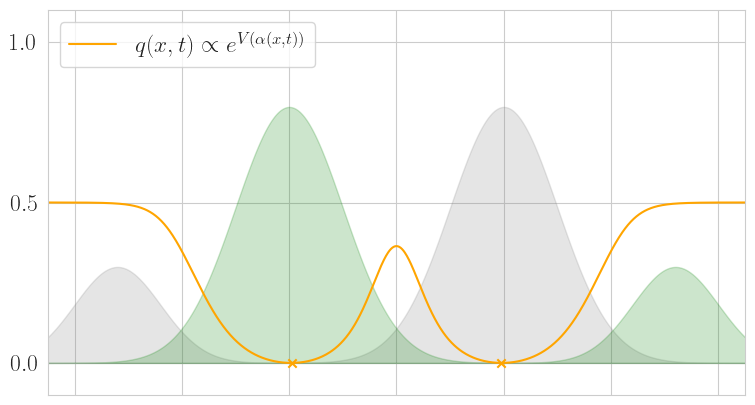

[0 1 1]


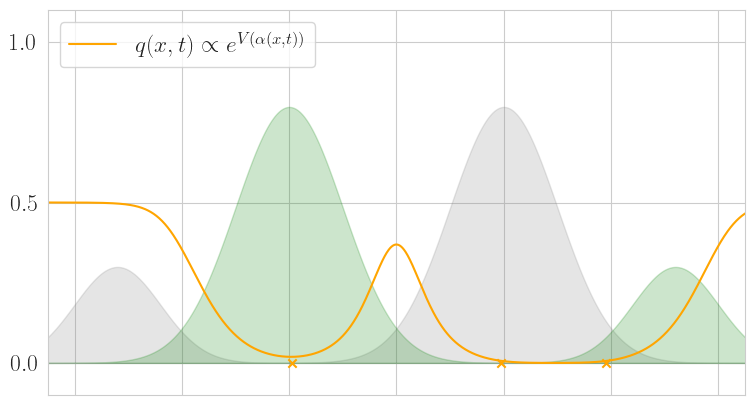

[0 1 1 1]


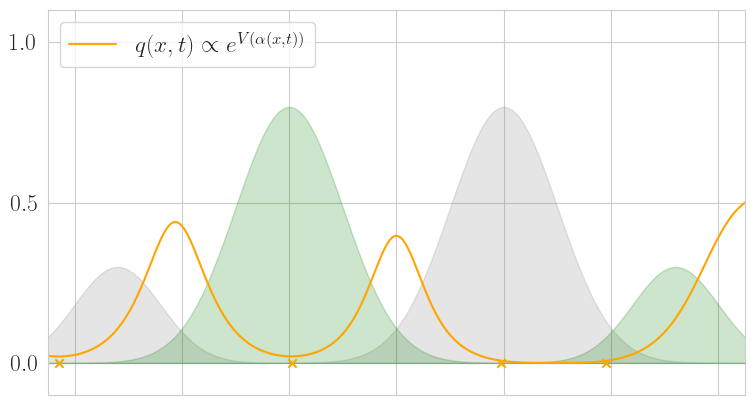

[0 1 1 1 1]


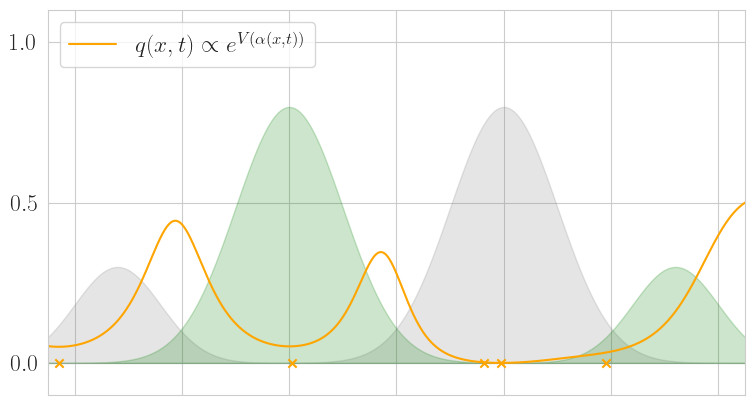

[0 1 1 1 1 1]


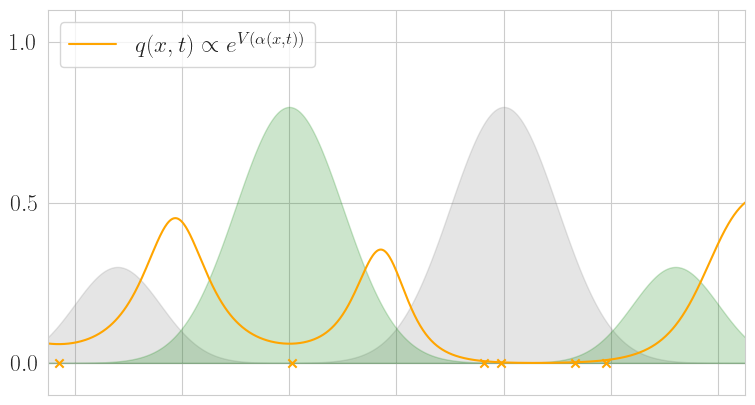

[0 1 1 1 1 1 0]


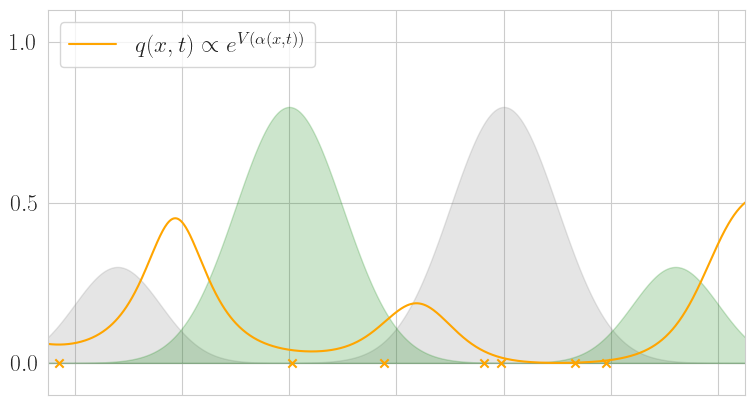

[0 1 1 1 1 1 0 0]


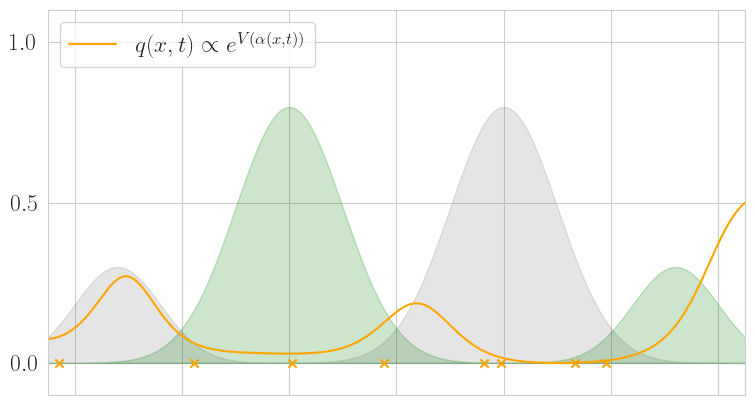

[0 1 1 1 1 1 0 0 1]


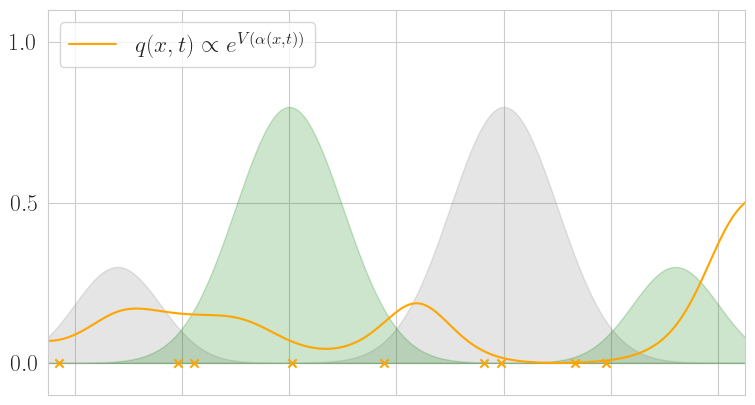

[0 1 1 1 1 1 0 0 1 1]


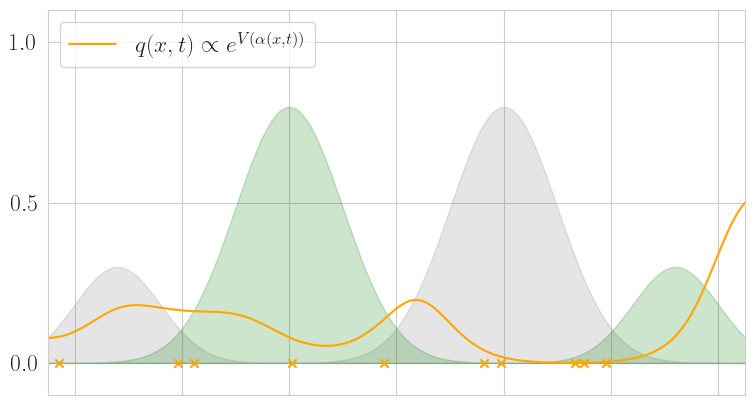

[0 1 1 1 1 1 0 0 1 1 1]


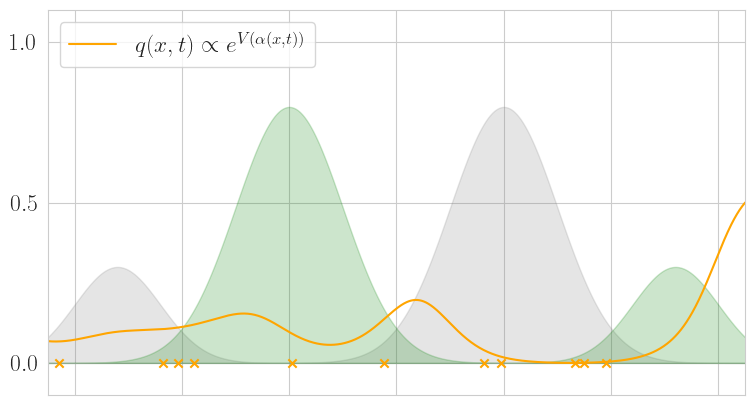

[0 1 1 1 1 1 0 0 1 1 1 1]


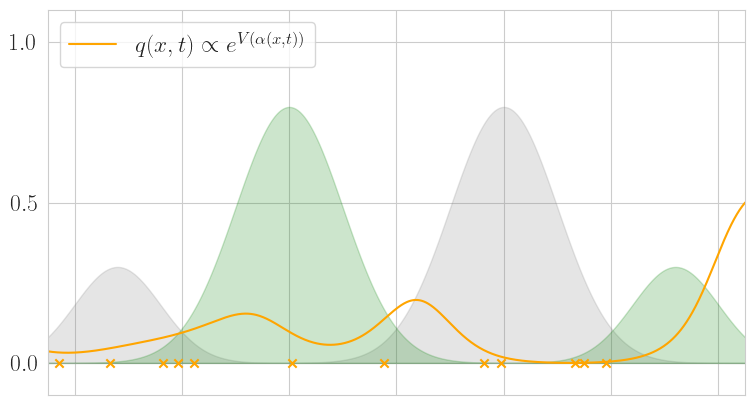

[0 1 1 1 1 1 0 0 1 1 1 1 1]


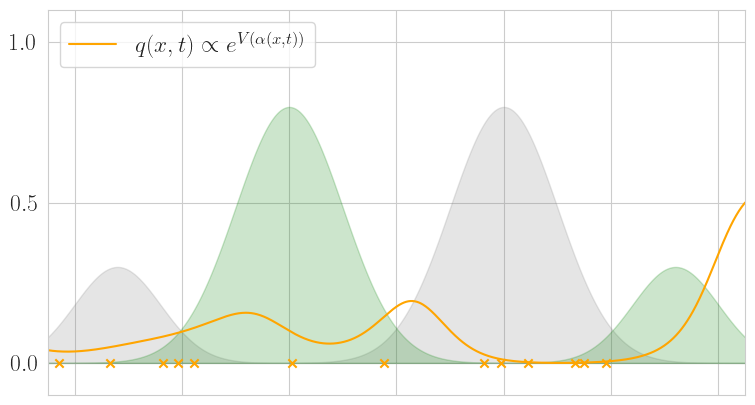

[0 1 1 1 1 1 0 0 1 1 1 1 1 0]


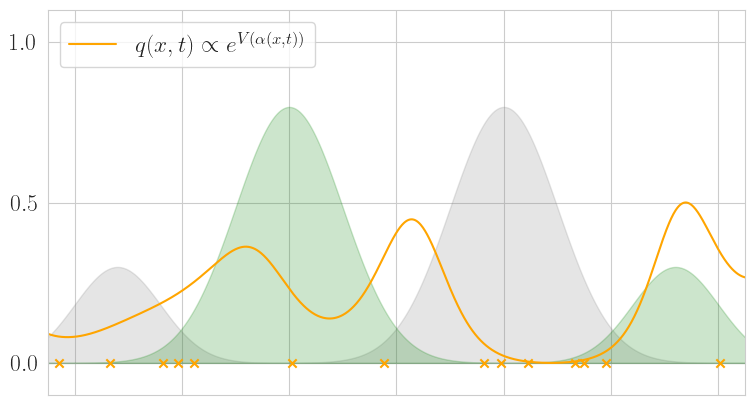

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1]


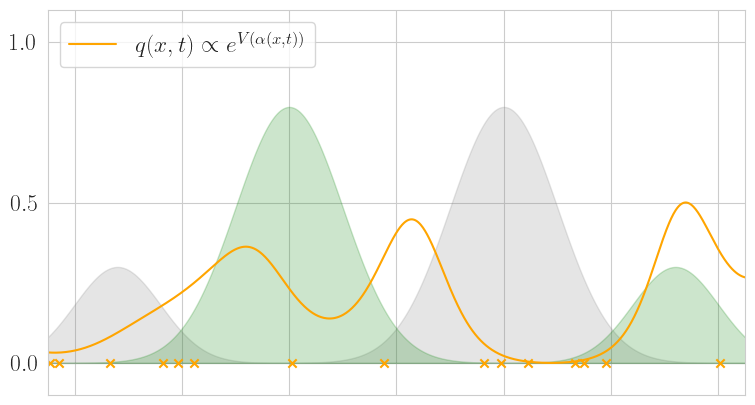

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1]


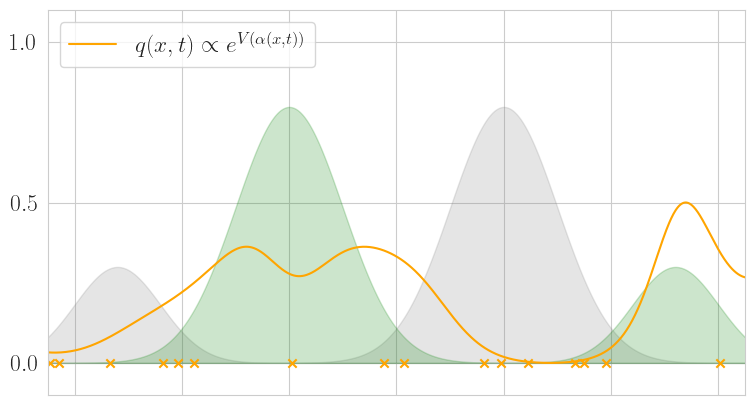

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0]


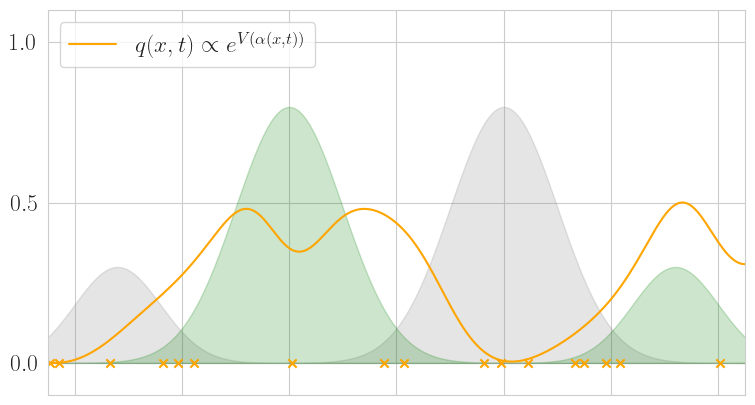

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1]


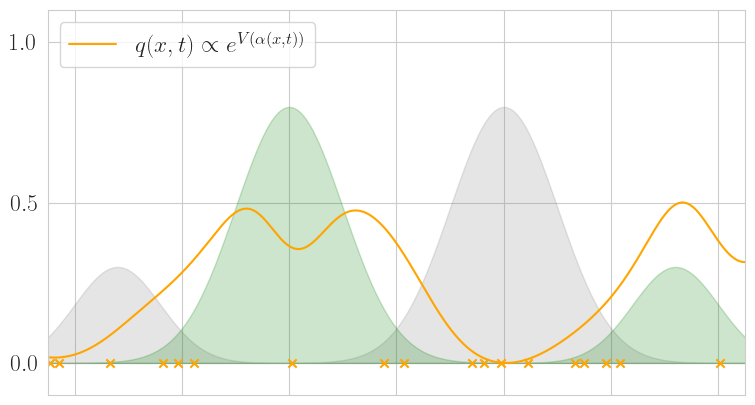

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1]


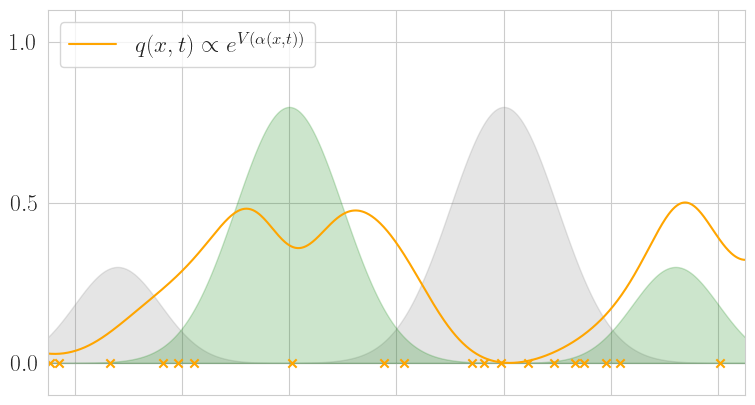

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0]


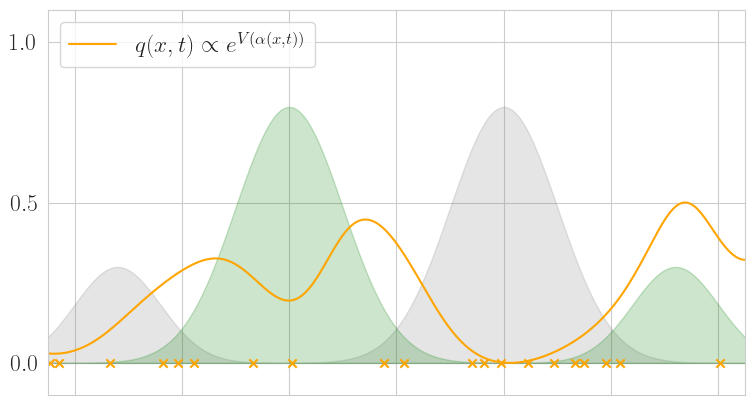

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0]


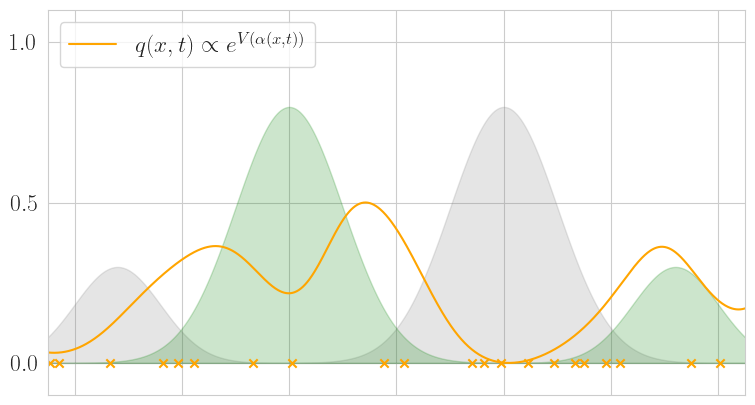

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1]


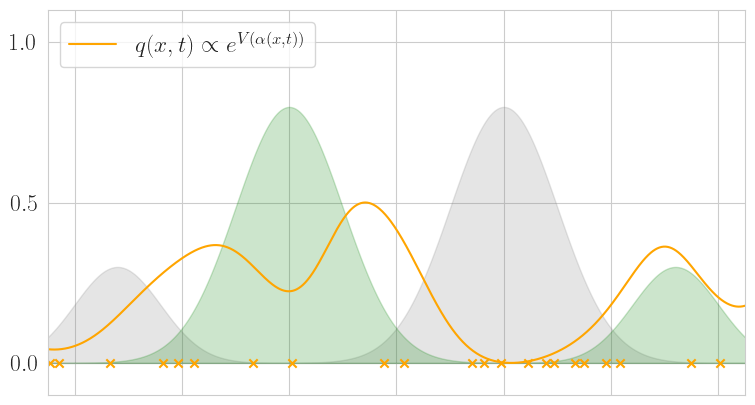

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1]


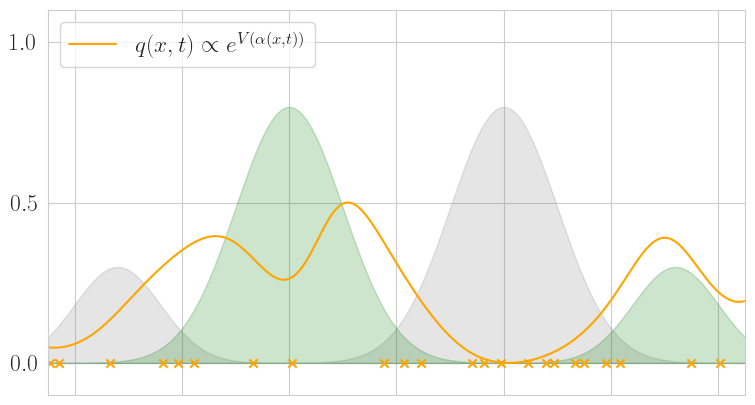

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1]


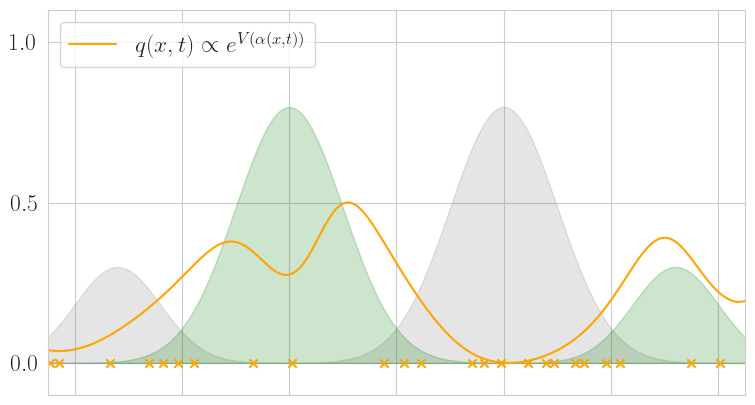

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0]


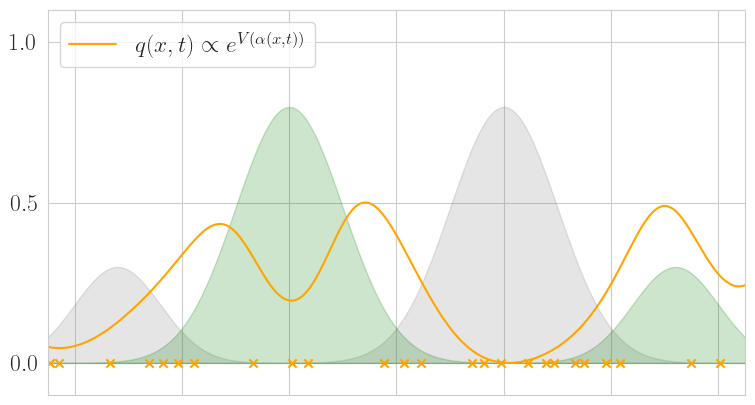

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1]


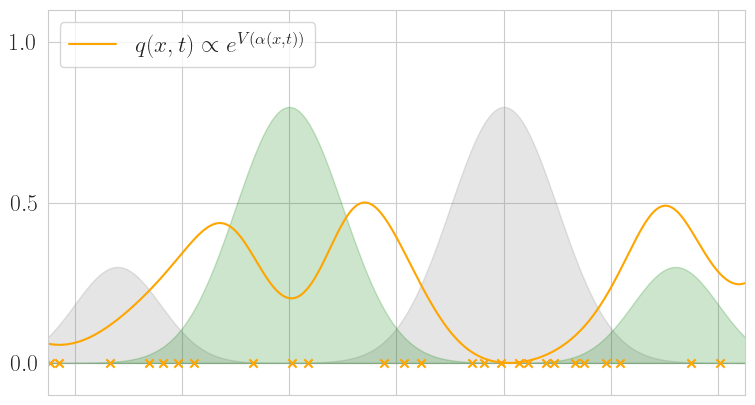

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0]


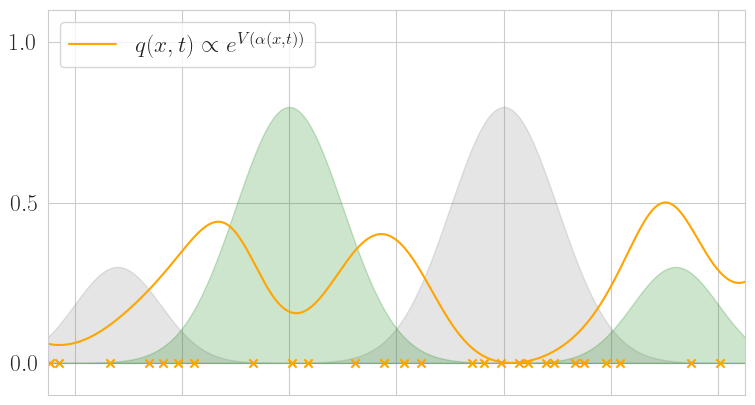

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0]


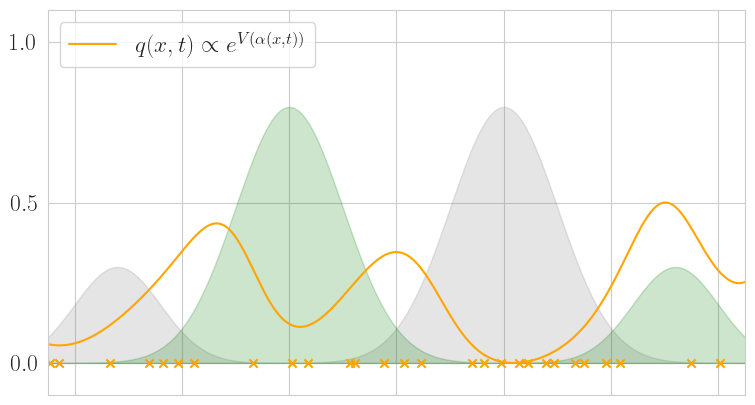

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1]


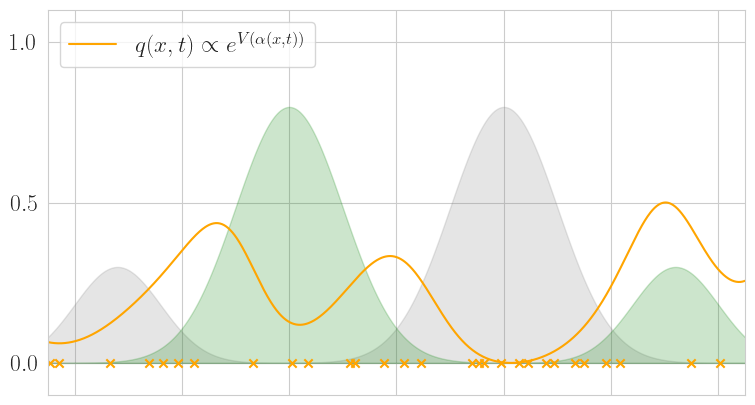

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1]


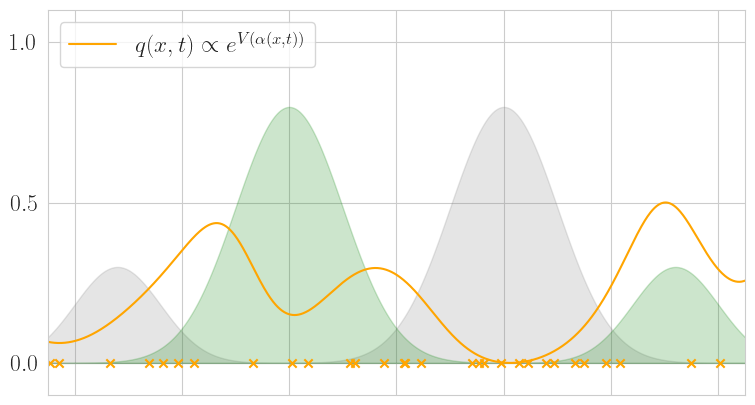

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1]


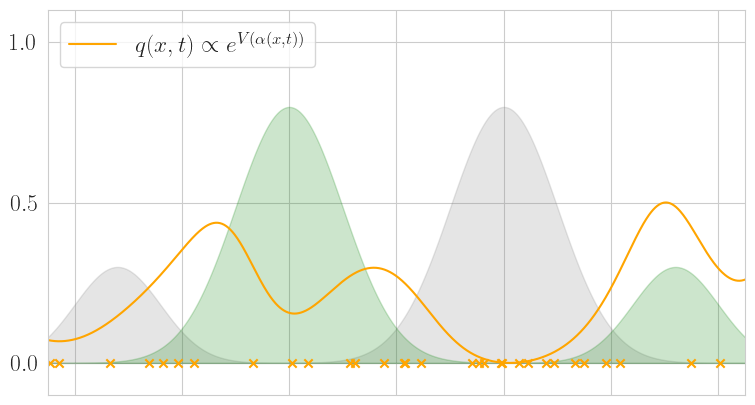

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1]


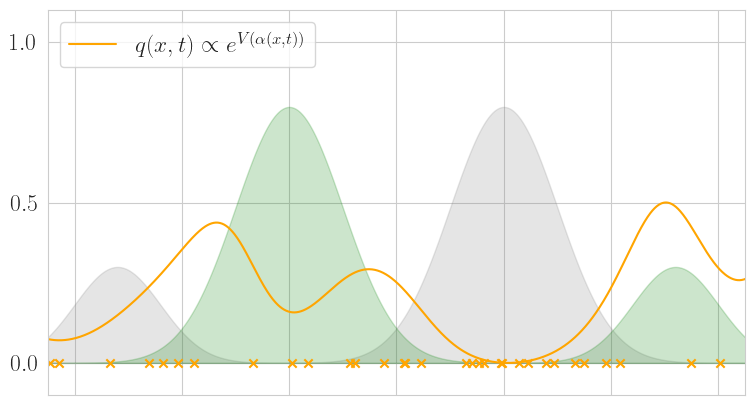

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0]


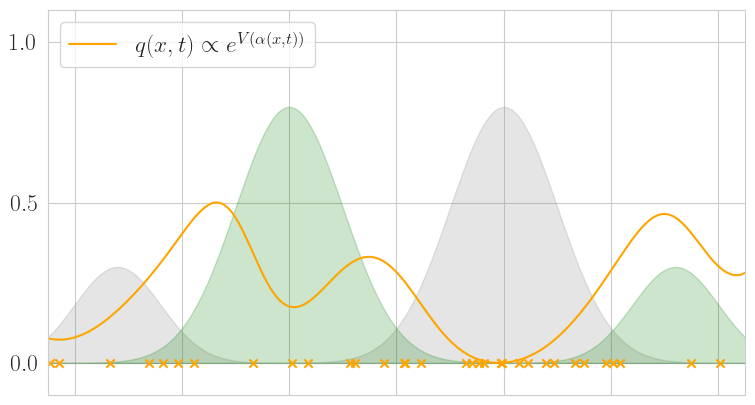

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1]


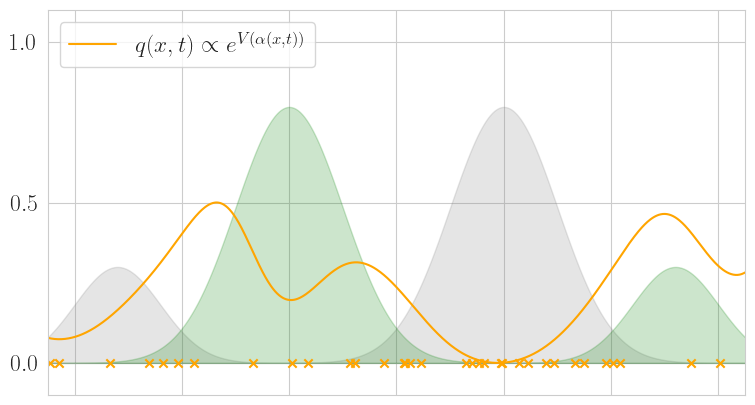

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0]


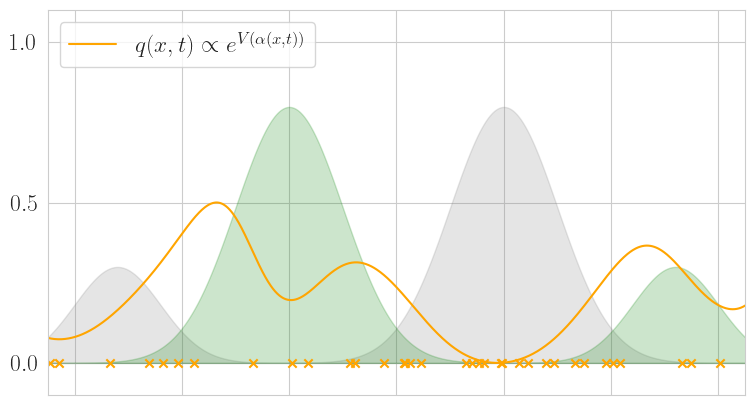

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0]


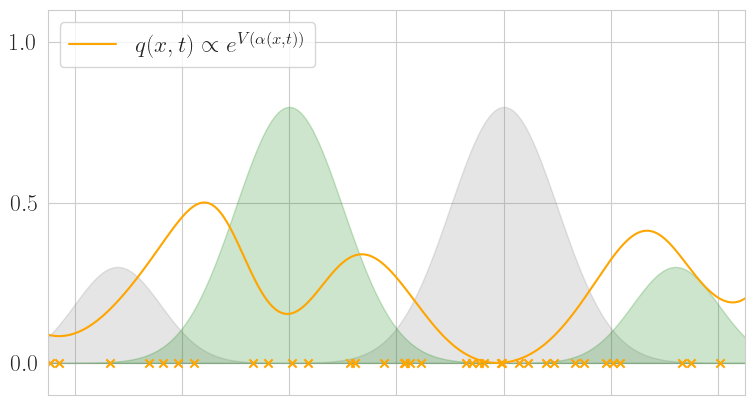

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1]


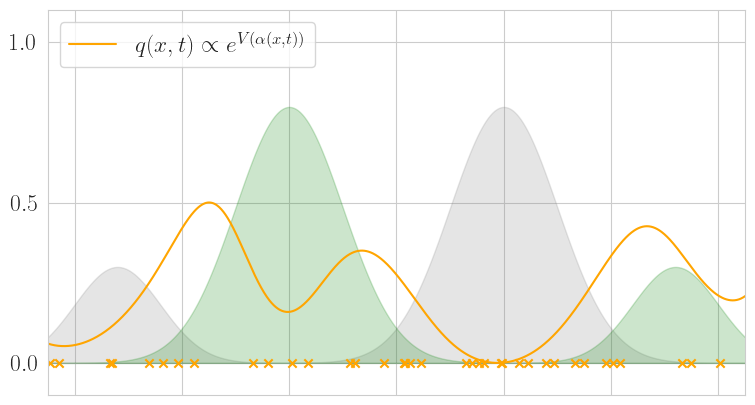

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0]


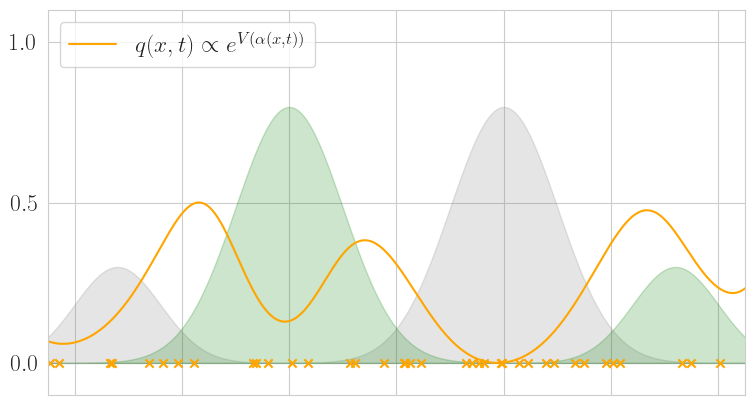

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1]


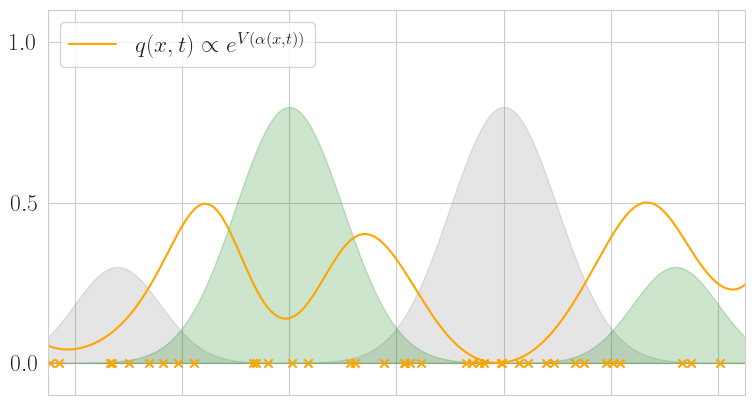

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0]


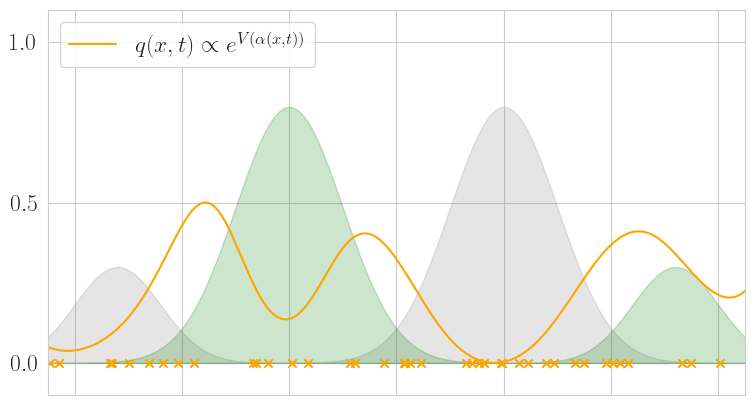

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1]


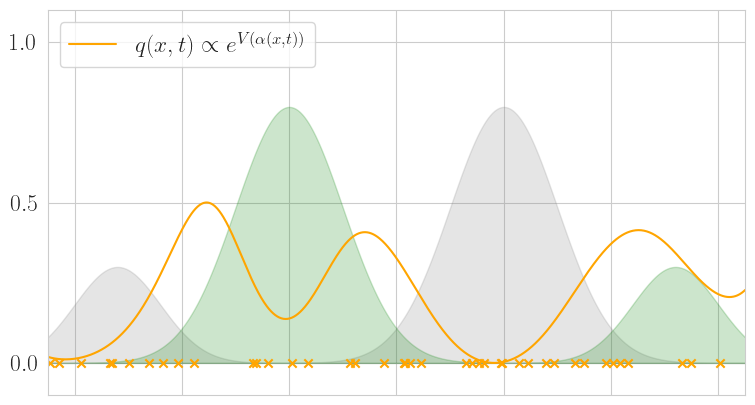

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1]


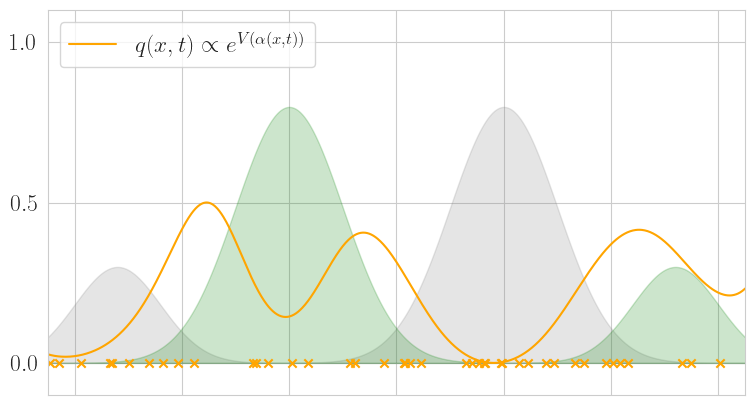

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1]


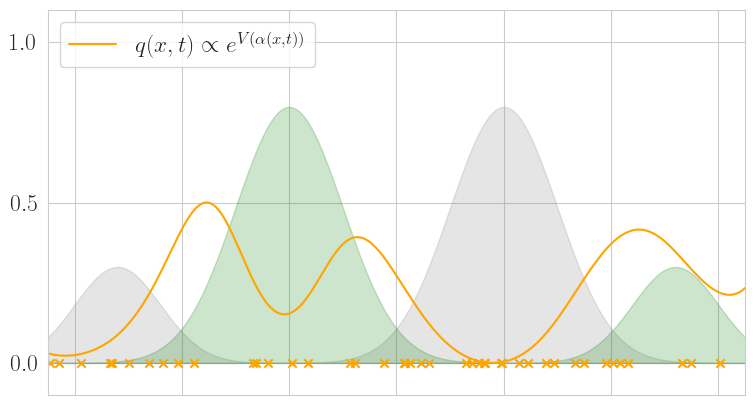

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0]


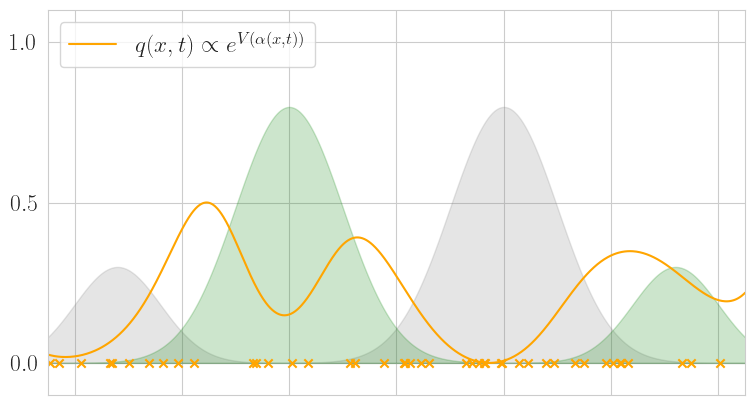

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0]


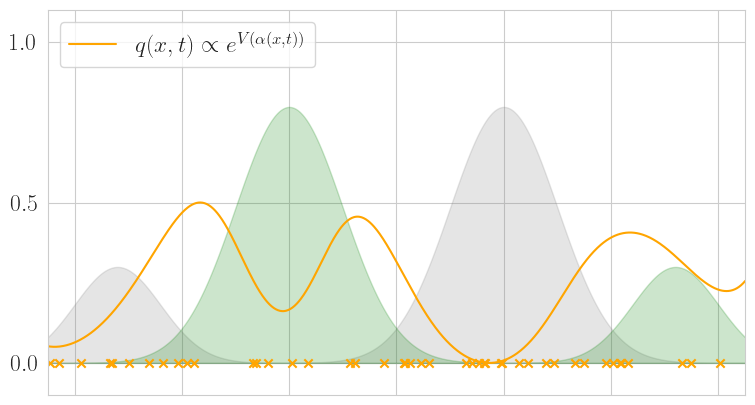

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0]


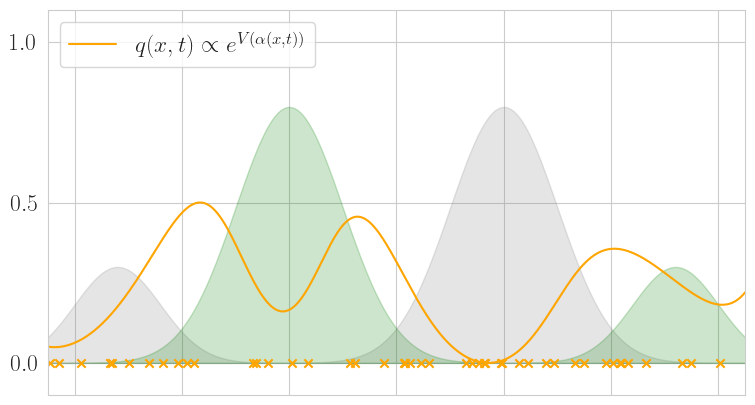

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0]


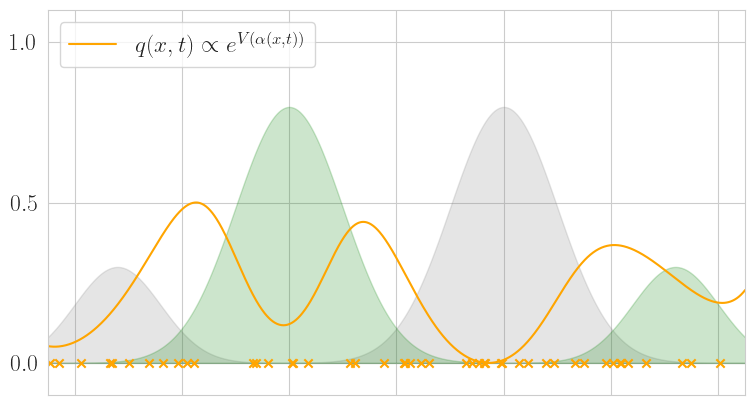

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1]


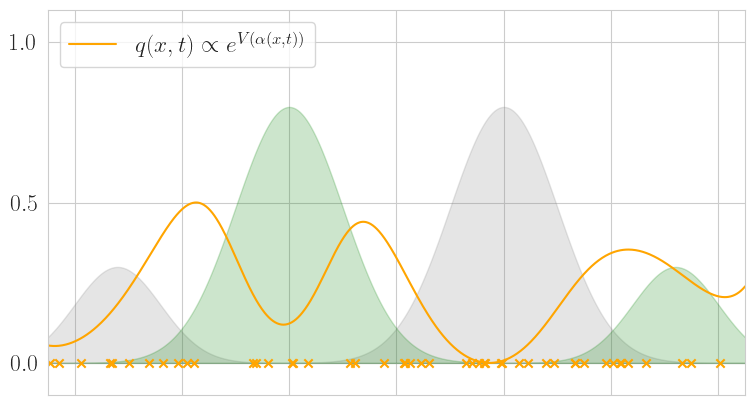

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0]


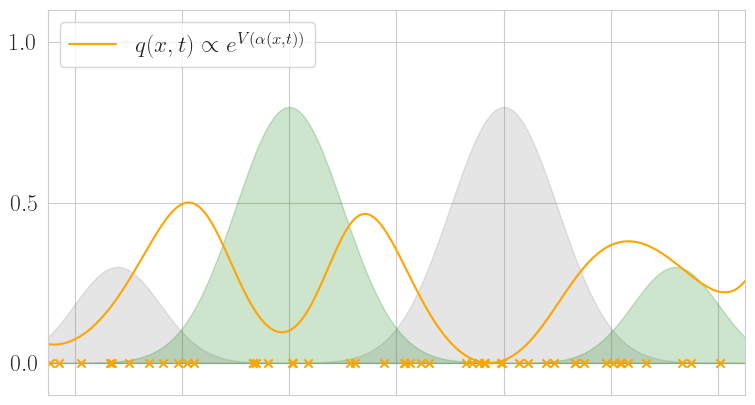

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0]


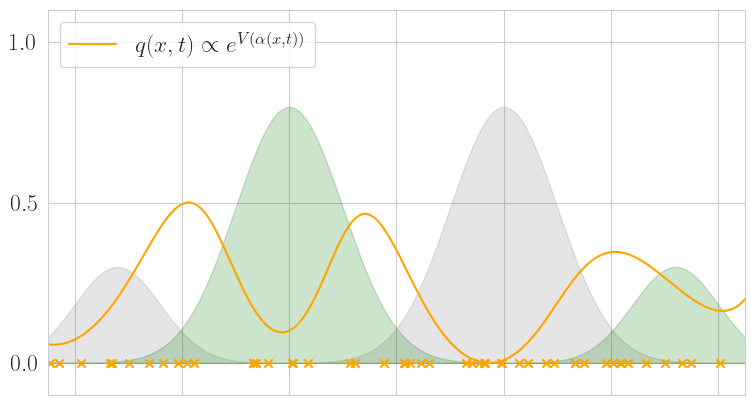

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0]


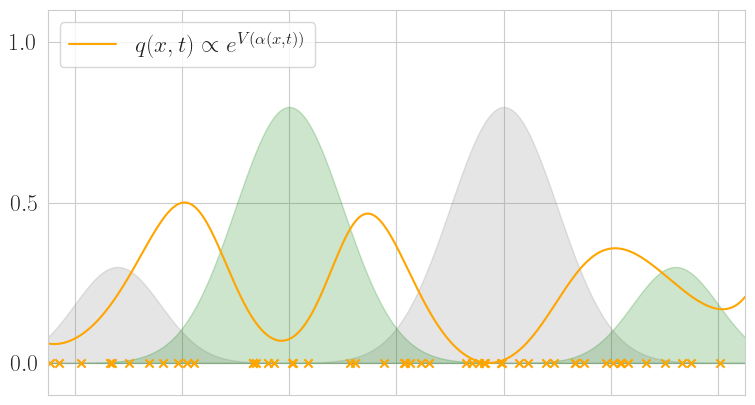

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1]


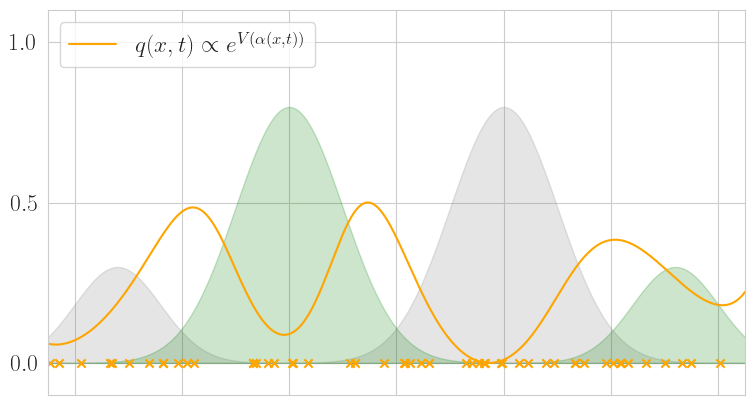

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0]


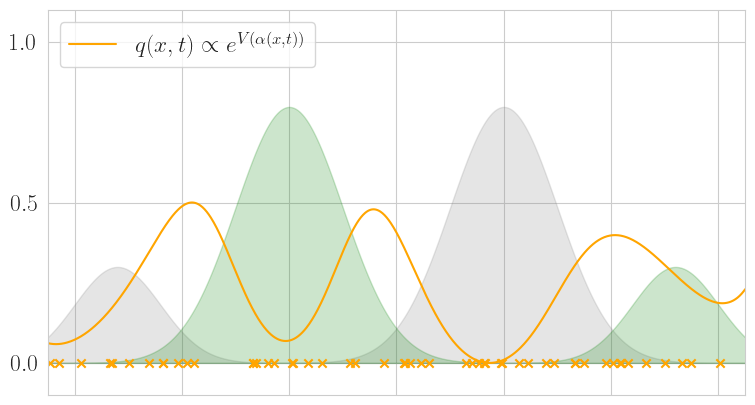

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1]


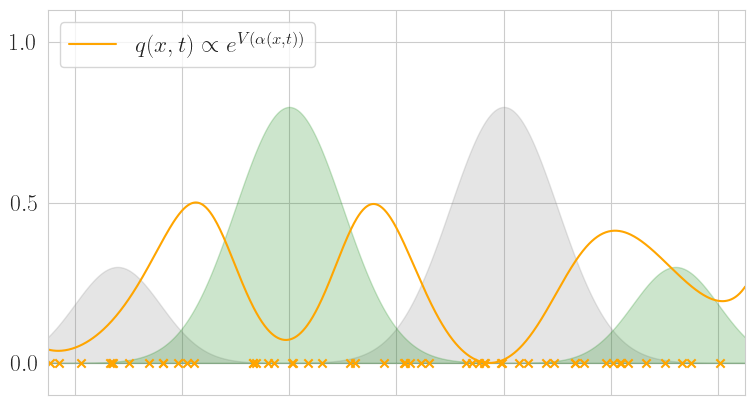

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0]


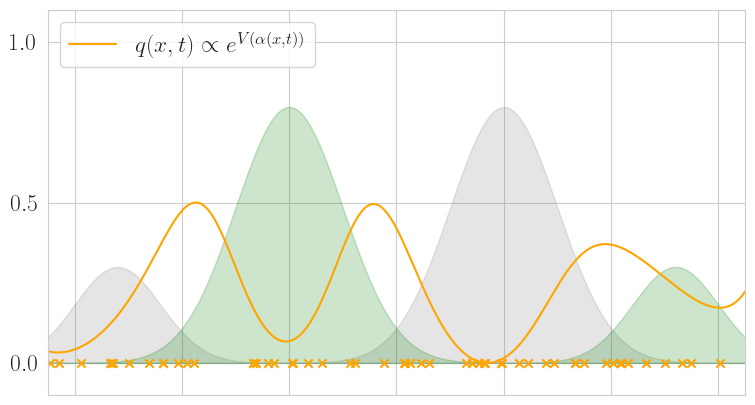

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1]


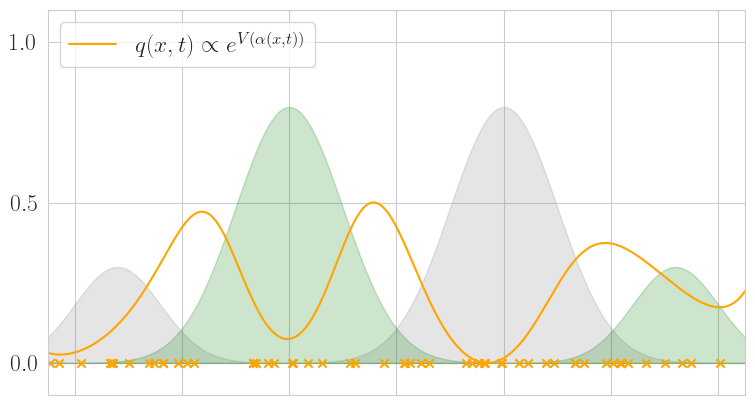

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0]


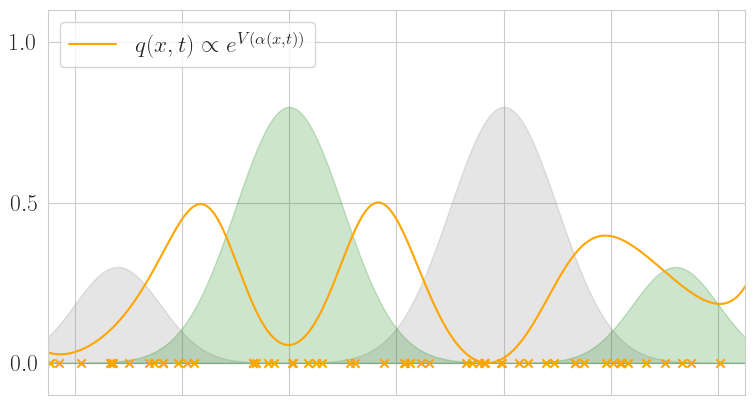

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0]


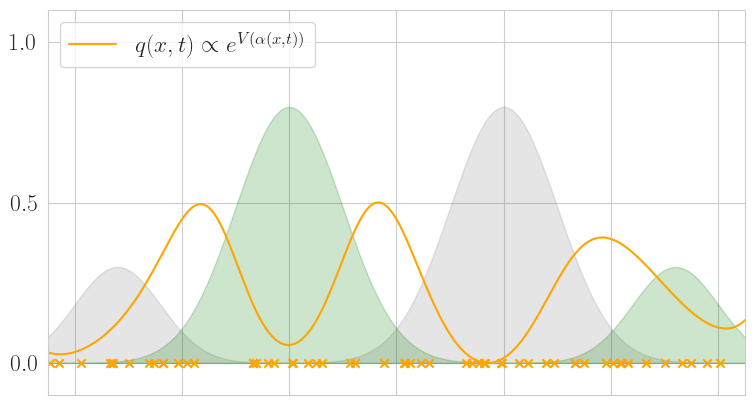

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0]


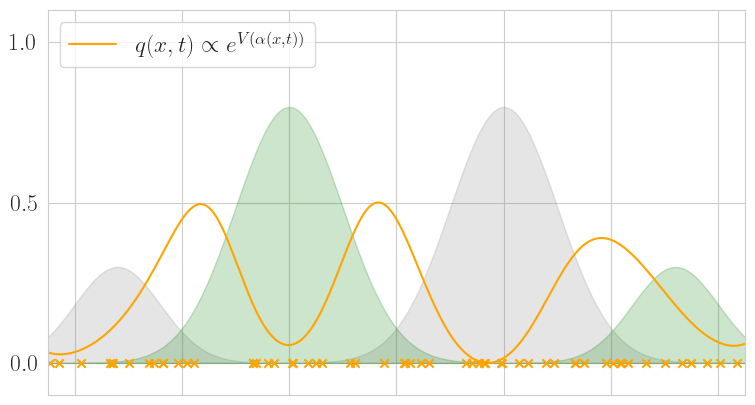

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0]


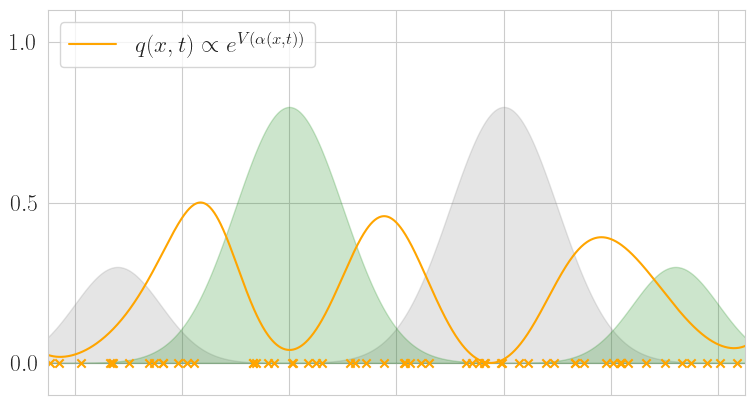

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0]


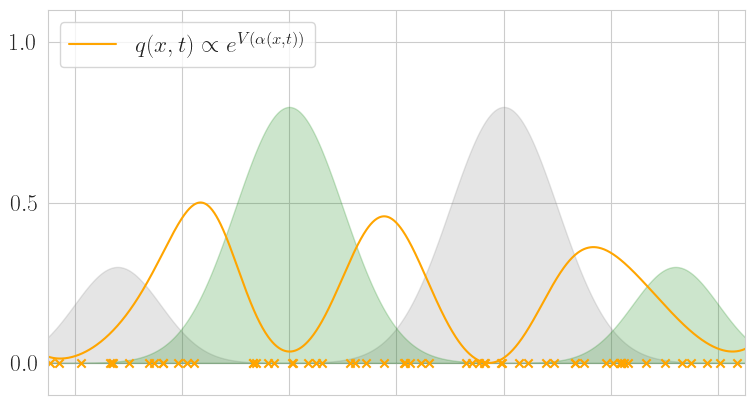

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0]


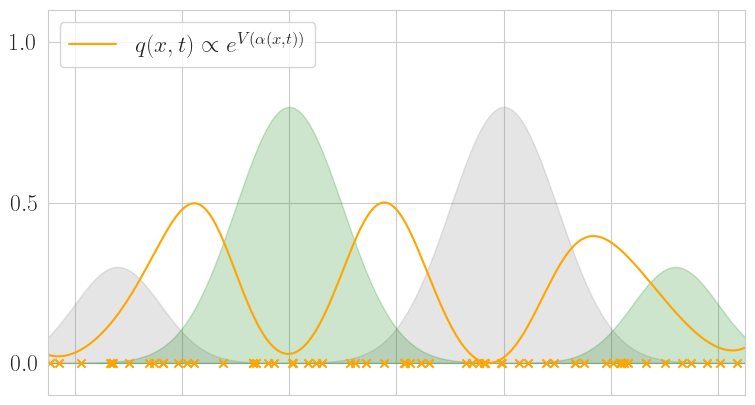

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1]


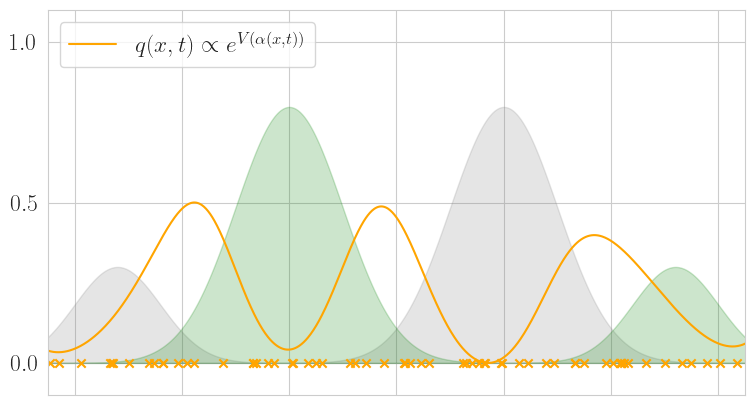

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0]


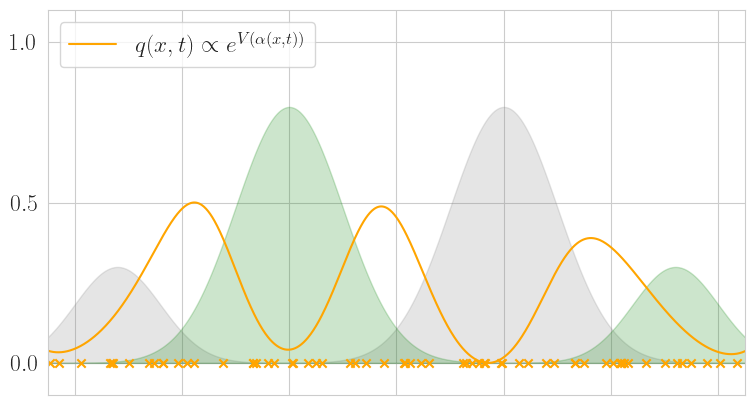

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1]


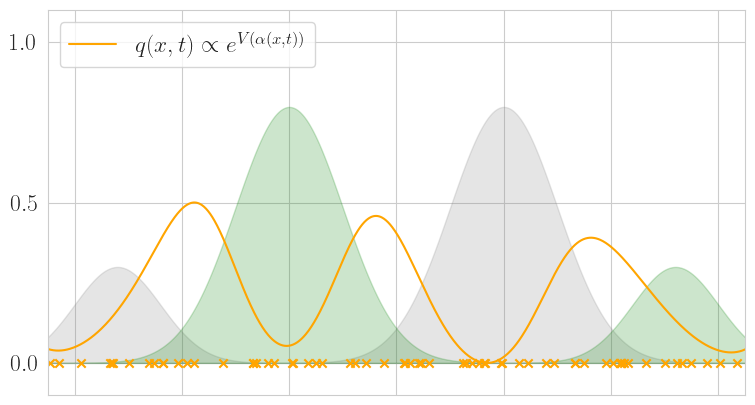

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1]


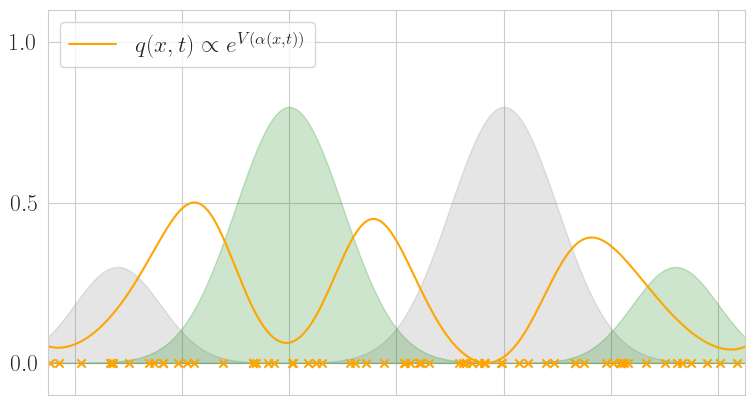

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1]


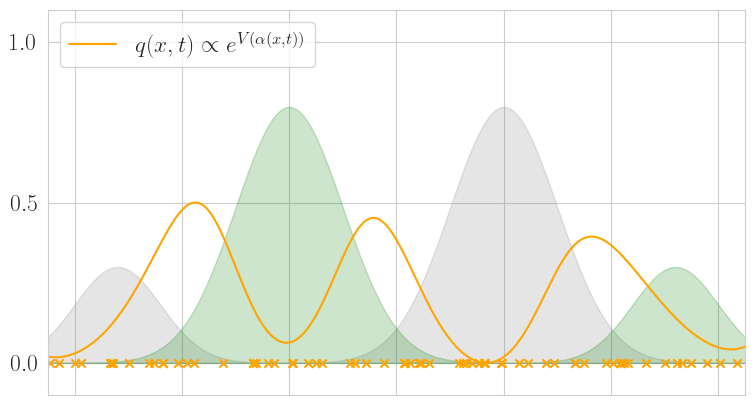

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0]


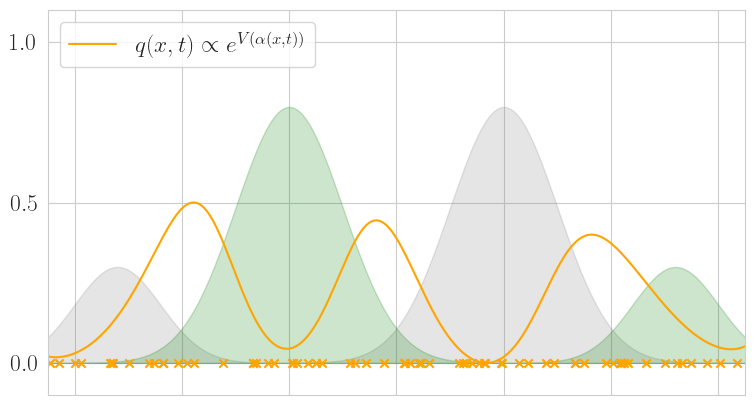

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1]


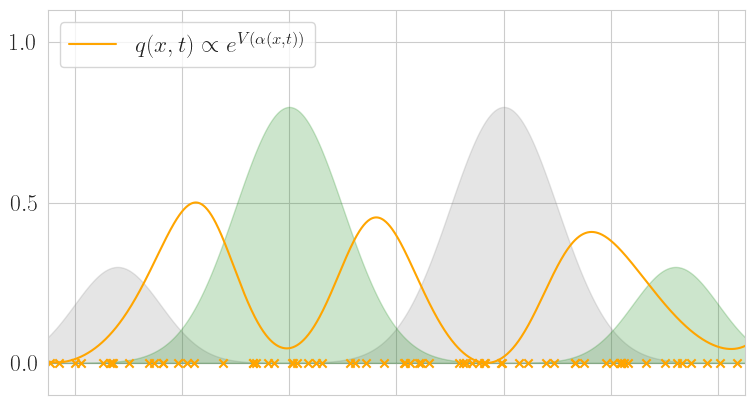

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0]


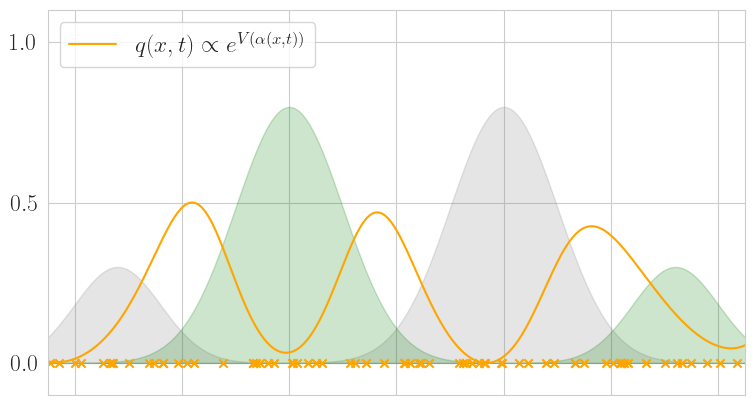

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0]


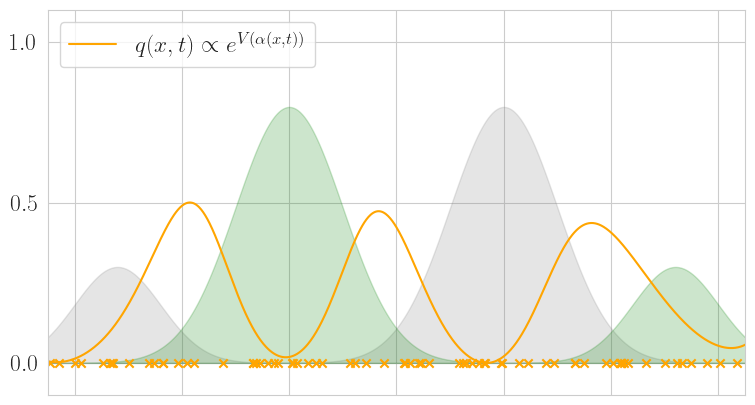

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1]


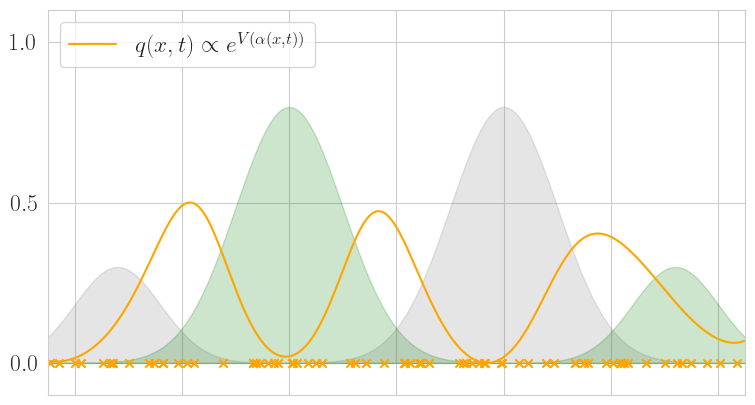

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1]


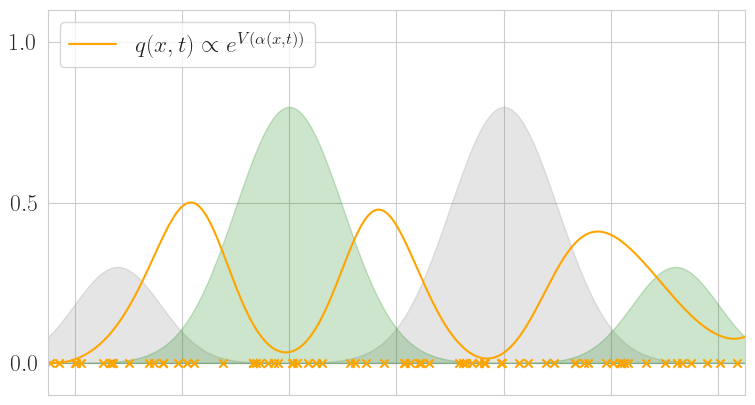

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0]


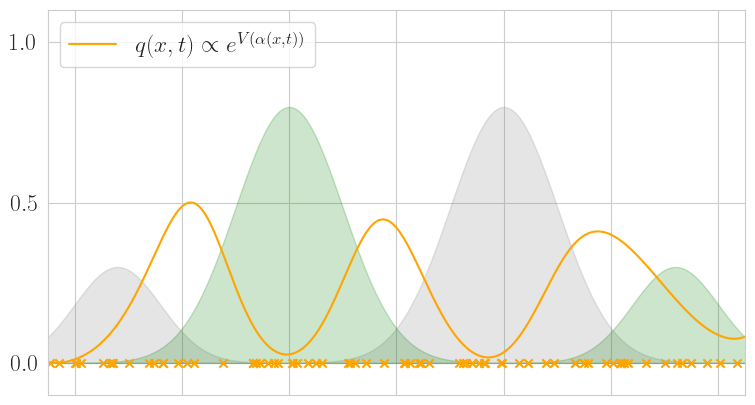

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0]


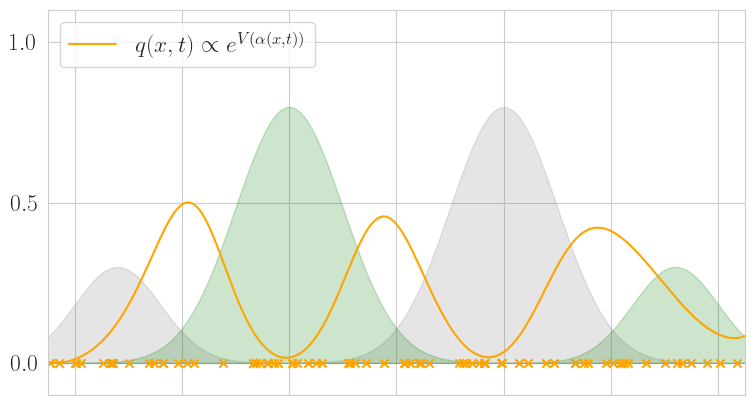

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1]


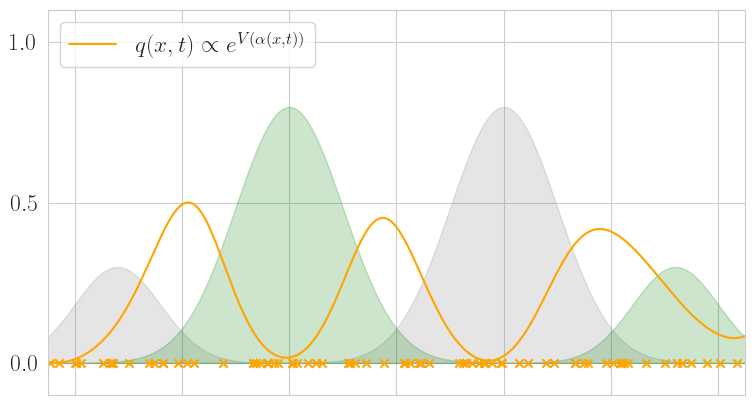

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0]


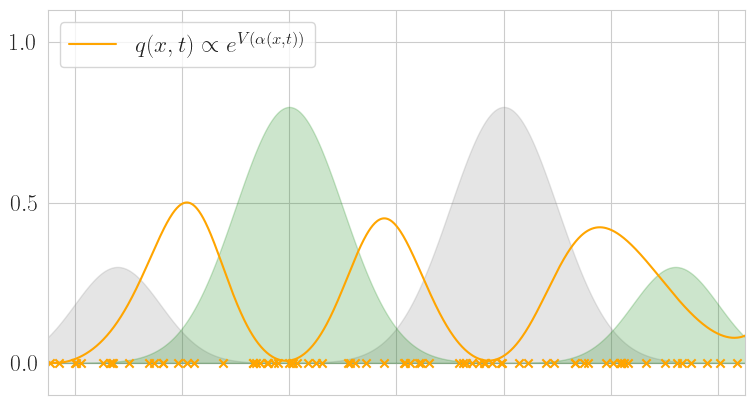

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1]


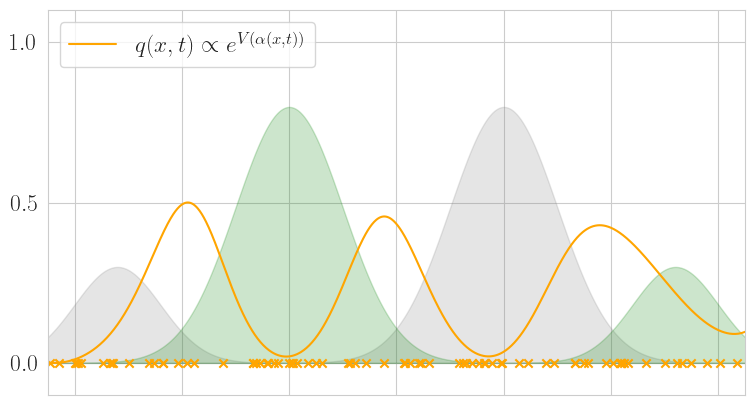

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0]


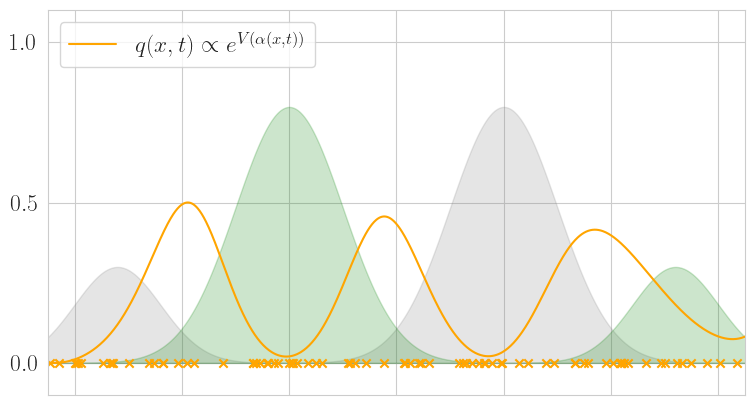

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1]


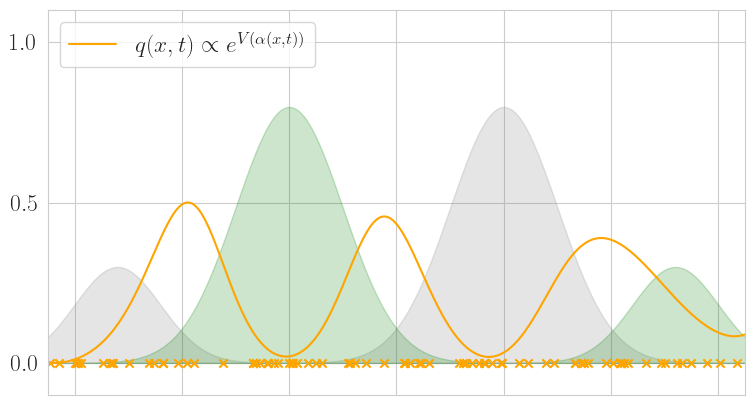

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0]


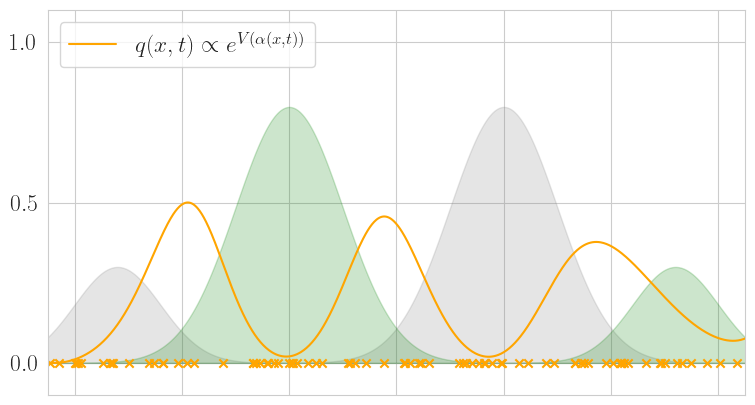

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0]


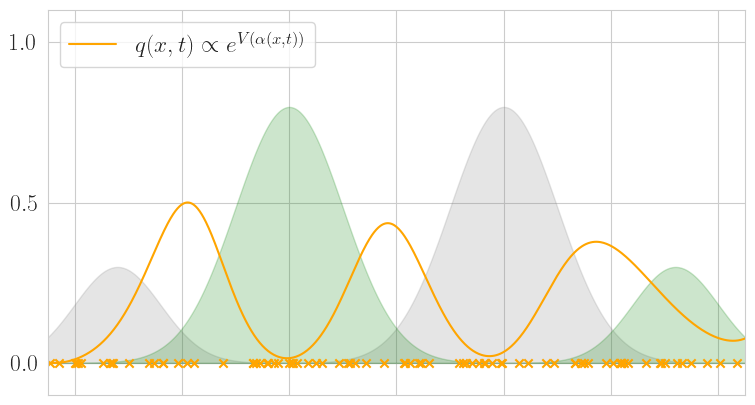

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1]


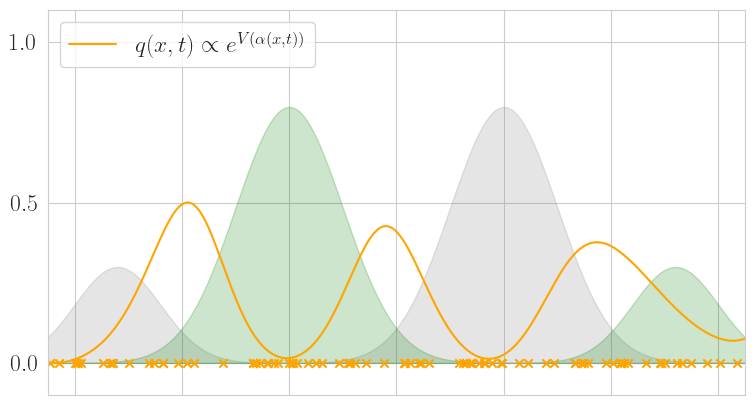

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1]


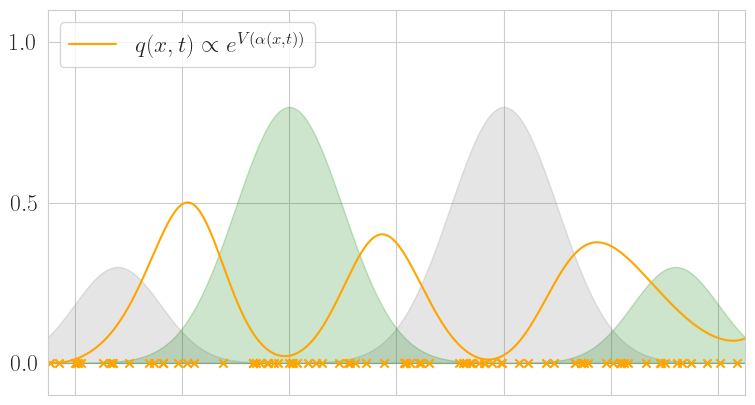

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1]


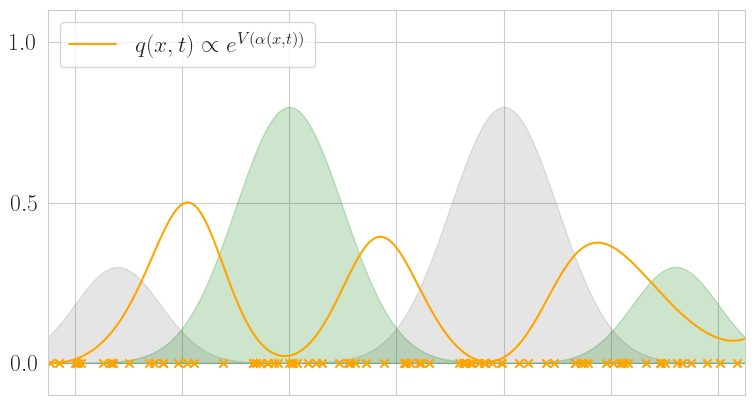

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0]


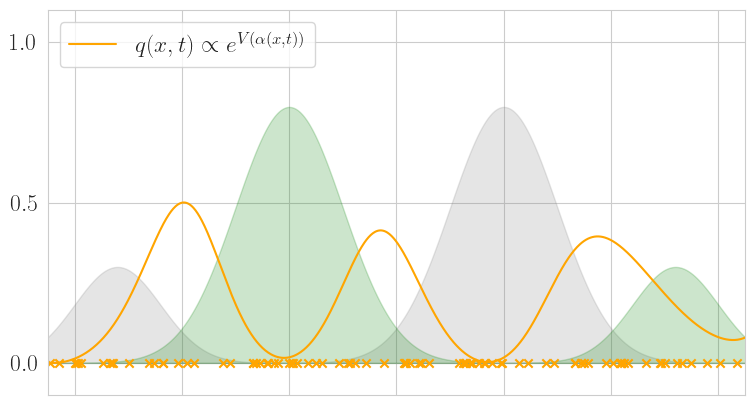

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0]


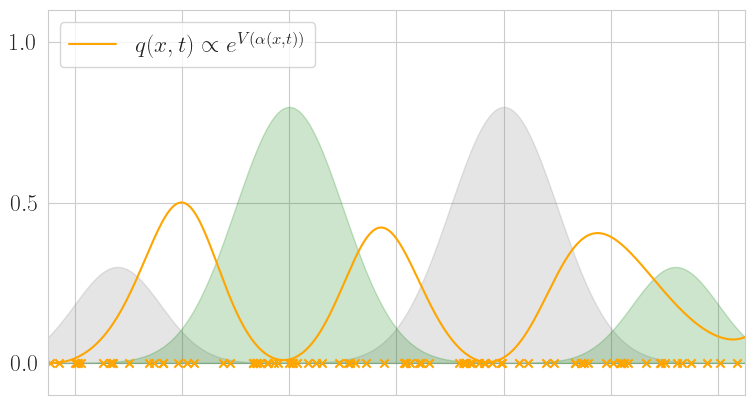

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1]


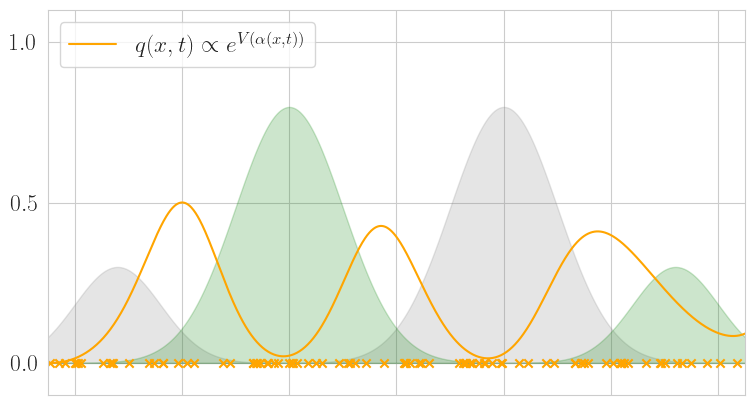

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0]


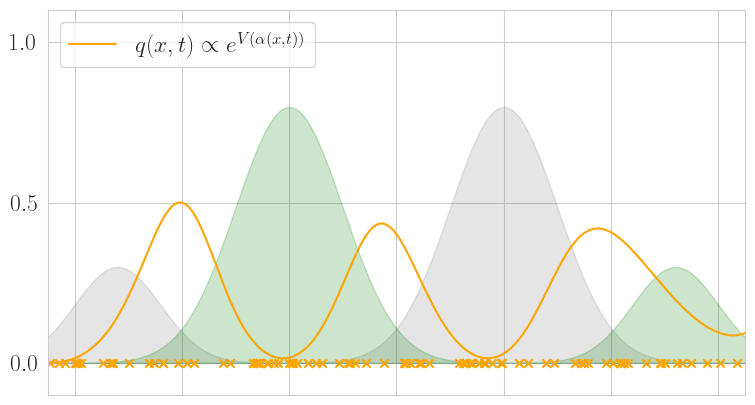

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0]


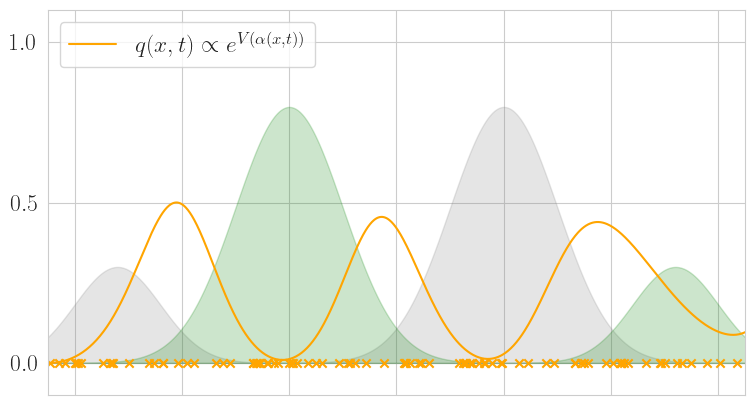

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1]


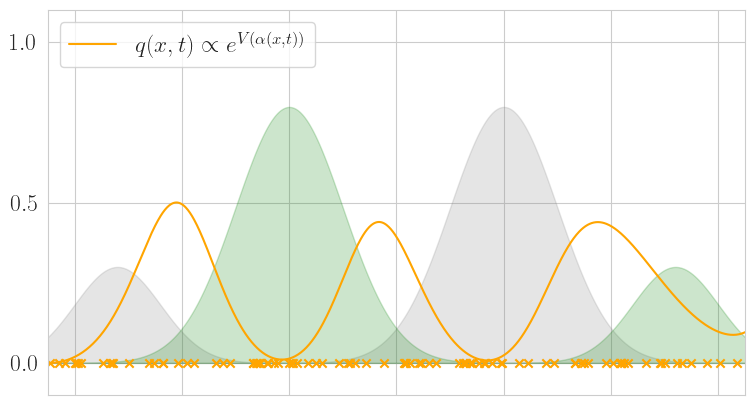

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1]


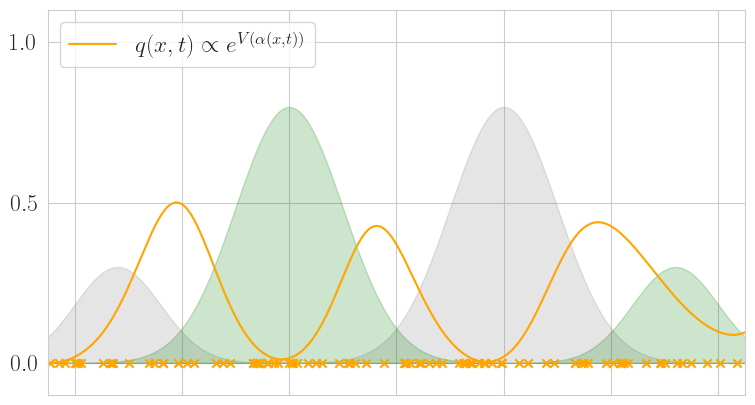

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0]


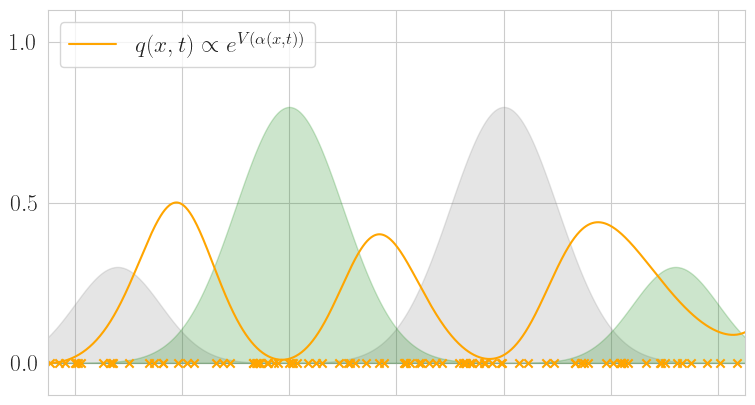

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0]


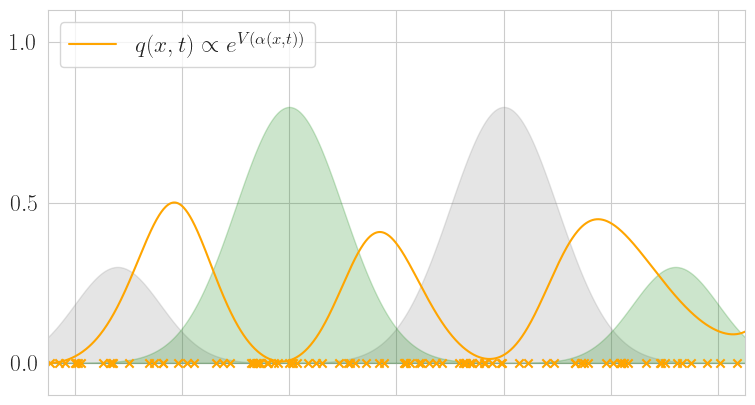

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1]


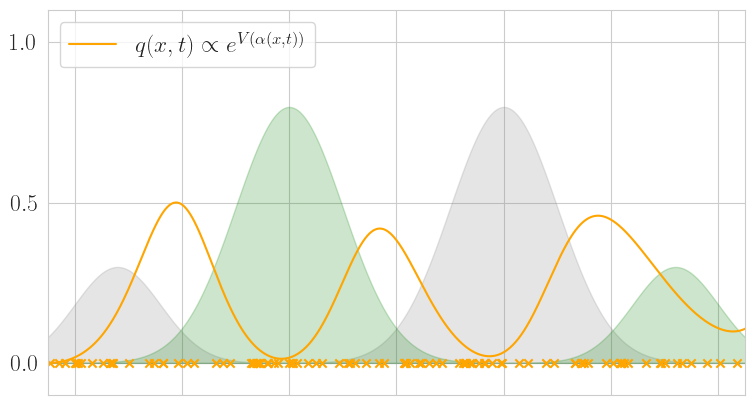

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0]


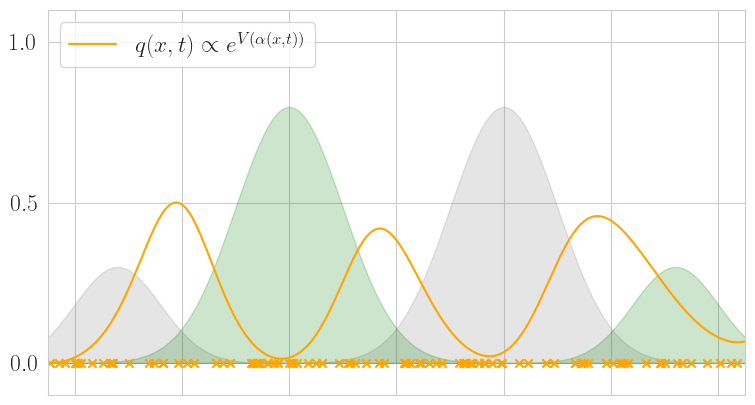

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0]


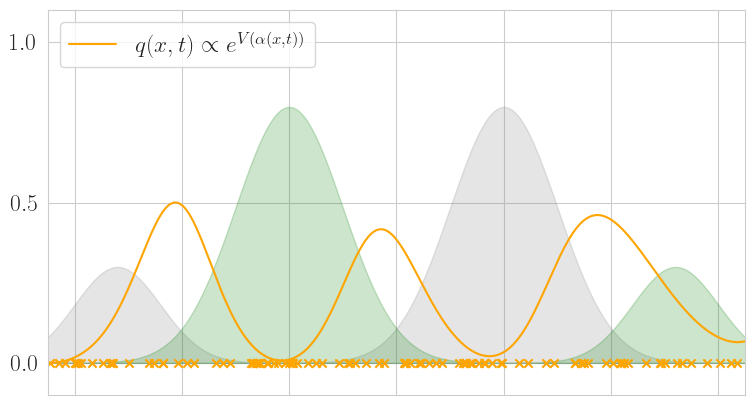

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0]


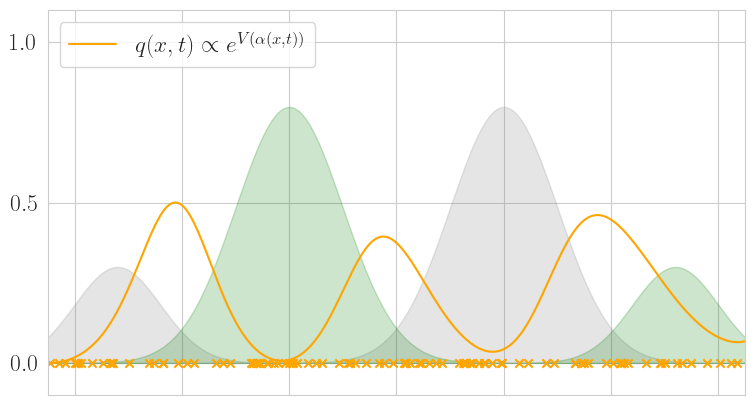

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0]


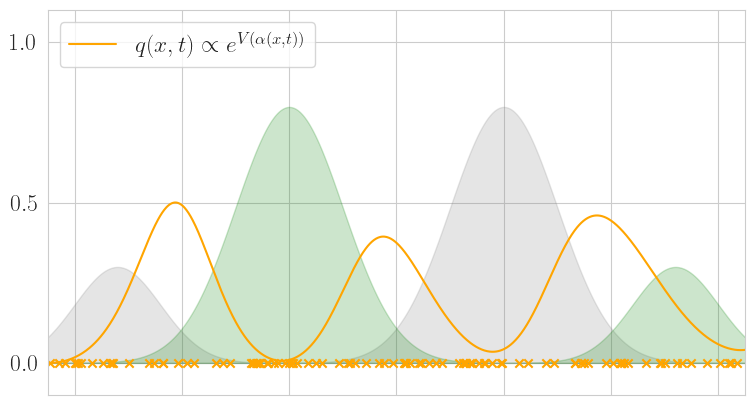

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0]


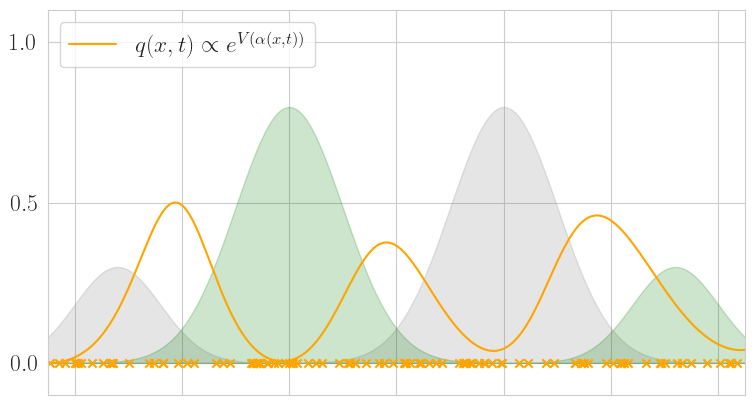

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0]


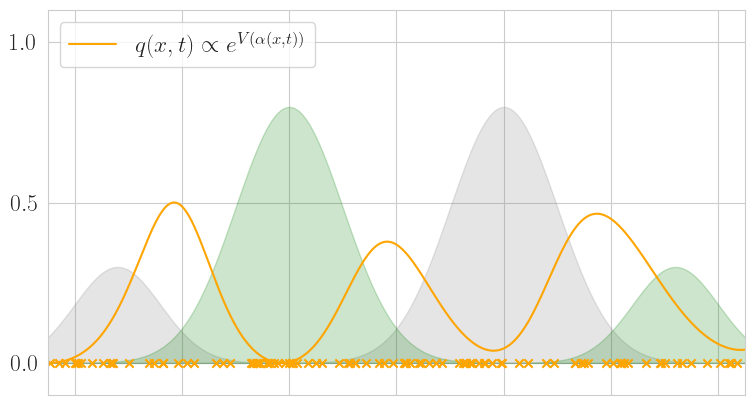

[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0 1
 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0
 0 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 1]


In [235]:
lam = lambda t: 1.

labeled_ind = np.array([350, 650])
xlab, ylab = dom[labeled_ind][:,np.newaxis], y_lab[labeled_ind]

A = 0.1*np.ones((dom.shape[0], 2))
for x, y in zip(xlab, ylab):
    A[:,int(y)] += rbf_kernel(dom[:,np.newaxis], x[:,np.newaxis], gamma=2.).flatten()

a0 = A.sum(axis=1)
bv_vals = (A * A).sum(axis=1)
bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
out = A[:,0]/(a0)
bv_vals = np.exp(lam(0.)*bv_vals)
bv_vals /= bv_vals.sum()
np.random.seed(10)

for it in range(100):
    bv_vals_ = 0.5*(bv_vals - bv_vals.min())/(bv_vals.max() - bv_vals.min())
    
    fig, ax = plt.subplots(figsize=(9,5))
    ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
    ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
    ax.scatter(xlab, np.zeros_like(ylab), marker='x', c='orange')
    ax.plot(dom, bv_vals_, label=r'$q(x,t) \propto e^{V(\alpha(x,t))}$', color='orange')
    ax.set_ylim(-0.1,1.1)
    ax.set_xlim(-3.25,3.25)
    ax.legend(loc='upper left', fontsize=17)
    ax.set_ylabel('')
    ax.set_xticklabels([])
    ax.set_yticks([0, 0.5, 1.0])
    ax.yaxis.set_tick_params(labelsize=17)
    plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_prop_lamt_iter_{it}.png"), bbox_inches='tight', dpi=200)
    plt.show()
    
    k = np.random.choice(np.arange(bv_vals.size), p=bv_vals)
    labeled_ind = np.append(labeled_ind, k)
    xlab = np.vstack((xlab, np.array([dom[k]])[:,np.newaxis])) 
#     ylab = np.append(ylab, 1*(np.random.rand() < c1[k]/(c1[k] + c2[k]))) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup
    ylab = np.append(ylab, 1*(c1[k] > c2[k])) #  p(y = 1 | x) since p(y=1) = p(y=0) by symmetry of setup

    print(ylab)
    
    A[:,int(ylab[-1])] += rbf_kernel(dom[:,np.newaxis], xlab[-1][:,np.newaxis], gamma=2.).flatten()
    
    a0 = A.sum(axis=1)
    bv_vals = (A * A).sum(axis=1)
    bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
    bv_vals = np.exp(lam(it)*bv_vals)
    bv_vals /= bv_vals.sum()

xlab_dir_lam, ylab_dir_lam = xlab.copy(), ylab.copy()

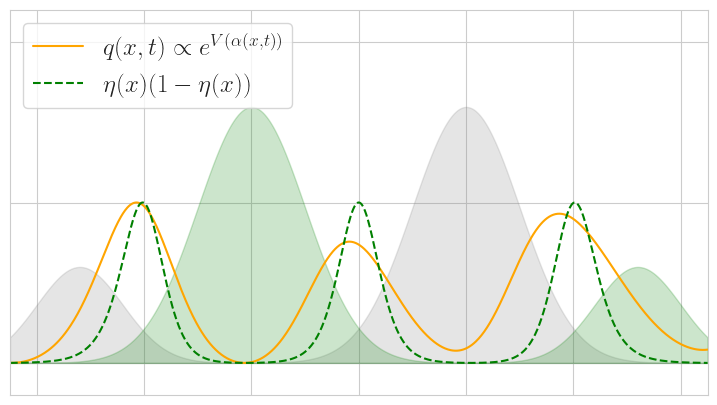

In [236]:
fig, ax = plt.subplots(figsize=(9,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green')
# p = sns.kdeplot(xlab_dir_lam.flatten(), bw_method=0.15, linestyle='--', label=r'Dir. Var. (Prop. Sampling) KDE', color='purple')
p = ax.plot(dom, bv_vals_, label=r'$q(x,t) \propto e^{V(\alpha(x,t))}$', color='orange')
# ax.scatter(xlab_dir_lam, np.zeros_like(ylab_dir_lam), marker='x', color=ax.lines[-1].get_color())
# ax.plot(dom, f, 'k--') #, label=r'Pop. Level Unc.')
ax.plot(dom, 0.5*(g - g.min())/(g.max() - g.min()), 'g--', label=r'$\eta(x)(1 - \eta(x))$')
ax.set_xlim(-3.25,3.25)
ax.set_ylim(-0.1,1.1)
ax.legend(fontsize=18, loc='upper left')
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticks([0., 0.5, 1.0])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/dir_var_prop_lam_kde.png"), dpi=200, bbox_inches='tight')
plt.show()

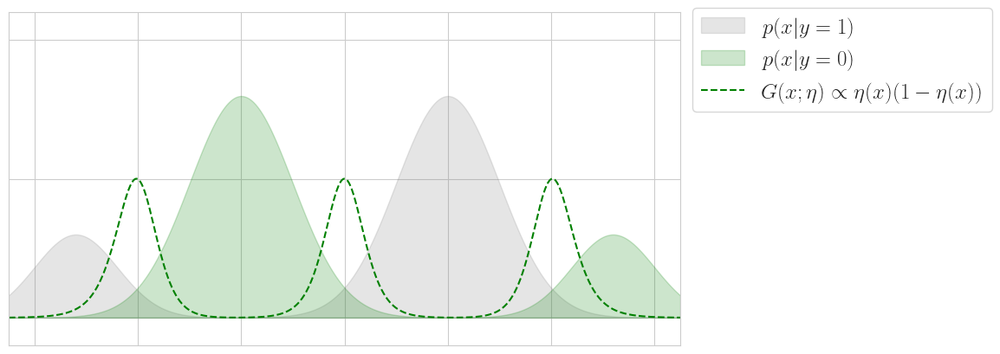

In [231]:
fig, ax = plt.subplots(figsize=(10,5))
ax.fill_between(dom, 1.3*c1, alpha=0.2, color='gray', label=r'$p(x | y = 1)$')
ax.fill_between(dom, 1.3*c2, alpha=0.2, color='green', label=r'$p(x | y = 0)$')
ax.plot(dom, 0.5*(g - g.min())/(g.max() - g.min()), 'g--', label=r'$G(x;\eta) \propto \eta(x) (1 - \eta(x))$')
ax.set_ylim(-0.1,1.1)
ax.set_xlim(-3.25,3.25)
ax.legend(fontsize=18, bbox_to_anchor=(1.48,1.045))
ax.set_ylabel('')
ax.set_yticks([0.0, 0.5, 1.0])
# ax.text(x=-3, y=0.55, s=r'$\eta(x) (1 - \eta(x))$', fontsize=18)
# ax.arrow(-2.2, 0.68, 0.0, -0.1, color= 'k', head_width=0.0, head_length=0.05)
ax.set_xticklabels([])
ax.set_yticklabels([])
plt.savefig(os.path.join(savedir, f"unc_demo_new/pdf_pop_lam.png"), dpi=200, bbox_inches='tight')
plt.show()

## Ground Truth labels for HSI 

In [178]:
pavia = np.load("data/paviasub_hsi.npz", allow_pickle=True)
print(list(pavia.keys()))
pavia_labels = np.load("data/paviasub_labels.npz", allow_pickle=True)['labels']


['data']


In [179]:
print(pavia['data'].shape)

(2264, 102)


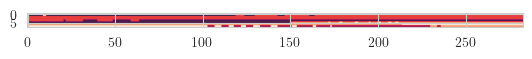

In [204]:
plt.imshow(pavia_labels.reshape(8, 283))
plt.show()

In [181]:
2264/2

1132.0

In [182]:
1132/2

566.0

In [183]:
566/2

283.0

In [206]:
for i in range(2,18):
    print(i, 2264/i)

2 1132.0
3 754.6666666666666
4 566.0
5 452.8
6 377.3333333333333
7 323.42857142857144
8 283.0
9 251.55555555555554
10 226.4
11 205.8181818181818
12 188.66666666666666
13 174.15384615384616
14 161.71428571428572
15 150.93333333333334
16 141.5
17 133.1764705882353


In [192]:
import math

In [237]:
print("hi")

hi


In [283]:
from tqdm import tqdm
from scipy.stats import wasserstein_distance

In [471]:
def get_beta_var(A):
    a0 = A.sum(axis=1)
    bv_vals = (A * A).sum(axis=1)
    bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
    return bv_vals

def run_lam_test(dom, y_lab, labeled_ind, c1, c2, iters=20000, lam=lambda t: 1., gamma=lambda t: 2.*(1. + t**0.1), 
                 prob_labeling=True, run_name='lam_1_gamma_0.1', plot=False, plot_every=0):
    xlab, ylab = dom[labeled_ind][:,np.newaxis], y_lab[labeled_ind]
    A = 0.1*np.ones((dom.shape[0], 2))
    for x, y in zip(xlab, ylab):
        A[:,int(y)] += rbf_kernel(dom[:,np.newaxis], x[:,np.newaxis], gamma=2.).flatten()

    bv_vals = get_beta_var(A)
    probs = np.exp(lam(0.)*bv_vals)
    probs /= probs.sum()
    np.random.seed(10)
    
    diffs = []
    best_diff = np.inf
    for it in tqdm(range(iters)):
        k = np.random.choice(np.arange(probs.size), p=probs)
        labeled_ind = np.append(labeled_ind, k)
        xlab = np.vstack((xlab, np.array([dom[k]])[:,np.newaxis])) 
        if prob_labeling:
            ylab = np.append(ylab, 1*(np.random.rand() < (c1[k]/ (c1[k] + c2[k])))) 
        else:
            ylab = np.append(ylab, 1*(c1[k] > c2[k]))
            
        A[:,int(ylab[-1])] += rbf_kernel(dom[:,np.newaxis], xlab[-1][:,np.newaxis], gamma=gamma(it)).flatten()

        probs_old = probs.copy()
        bv_vals = get_beta_var(A)
        probs = np.exp(lam(it)*bv_vals)
        probs /= probs.sum()

        diffs.append(wasserstein_distance(probs_old, probs))
        if diffs[-1] < best_diff:
            best_probs = probs.copy()
            best_diff = diffs[-1]
        
        if plot_every != 0:
            if it % plot_every == 0:
                ymin, ymax = (g/g.sum()).min()-0.0005, (g/g.sum()).max()+0.001
                fig, ax = plt.subplots(figsize=(10,5))
                ax.fill_between(dom, 1.1*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') #, label=r'$p(x | y = 1)$')
                ax.fill_between(dom, 1.1*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple') #, label=r'$p(x | y = 0)$')
                ax.plot(dom, probs, linewidth=2.0)
                ax.plot(dom, g/g.sum(), 'k--', linewidth=2.0, alpha=0.6)
                ax.set_xlim(-3.25,3.25)
                ax.set_ylim(ymin, ymax+0.002)
                ax.set_ylabel('')
                ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
                ax.set_xticklabels([])
                ax.set_yticklabels([])
                ax.set_title(fr'$q(x,t), t = {it}$, {run_name}', fontsize=20)
                plt.show()

    
    
    if plot:
        plt.loglog(np.arange(len(diffs)), diffs)
        plt.title(f"Convergence of distribution, {run_name}")
        plt.xlabel("Iteration")
        plt.ylabel(r"$W_2(p_t, p_{t-1})$")
        plt.show()

        ymin, ymax = (g/g.sum()).min()-0.0005, (g/g.sum()).max()+0.001
        fig, ax = plt.subplots(figsize=(10,5))
        ax.fill_between(dom, 1.1*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') #, label=r'$p(x | y = 1)$')
        ax.fill_between(dom, 1.1*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple') #, label=r'$p(x | y = 0)$')
        ax.plot(dom, best_probs, label='converged', linewidth=2.0)
        ax.plot(dom, probs, label='last', linewidth=2.0)
        ax.plot(dom, g/g.sum(), 'k--', linewidth=2.0, alpha=0.6)
        ax.set_xlim(-3.25,3.25)
        ax.set_ylim(ymin, ymax+0.002)
        ax.set_ylabel('')
        ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.legend(fontsize=20, loc='upper right')
        ax.set_title(fr'$q(x,t)$, {run_name}', fontsize=20)
        plt.show()
    
    return probs, np.array(diffs)

In [472]:
results = {}

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1530.48it/s]


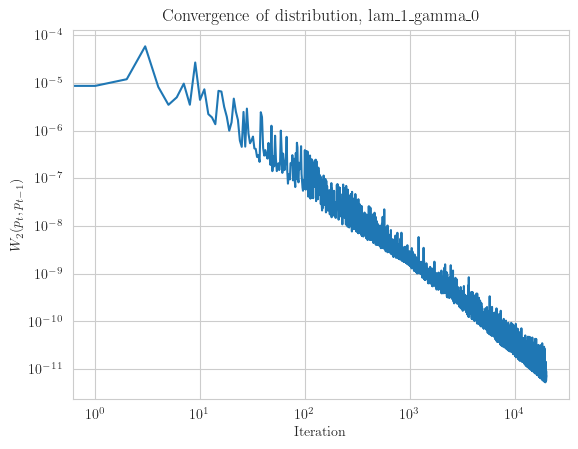

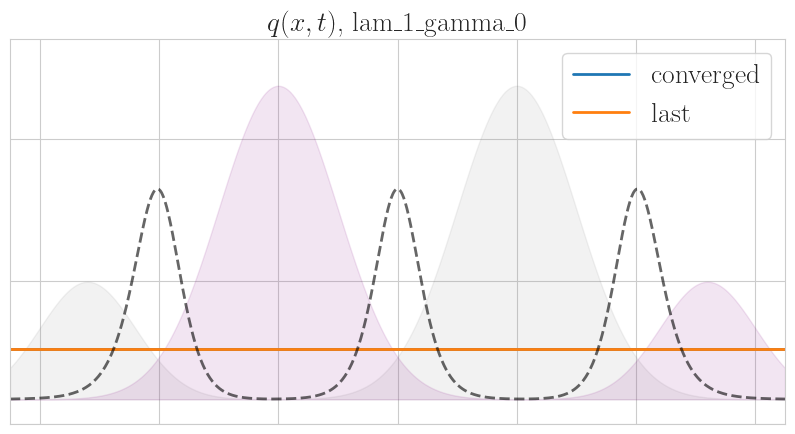

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:12<00:00, 1540.83it/s]


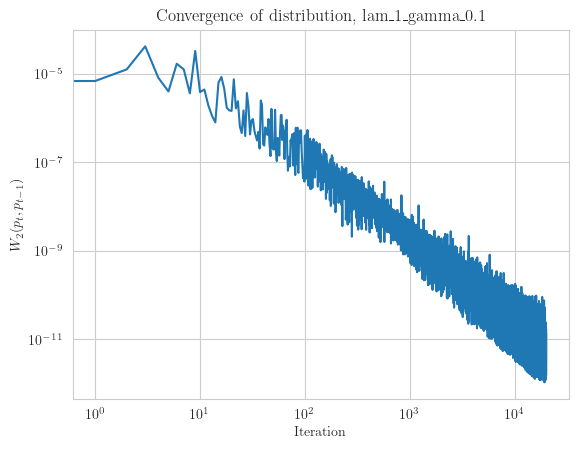

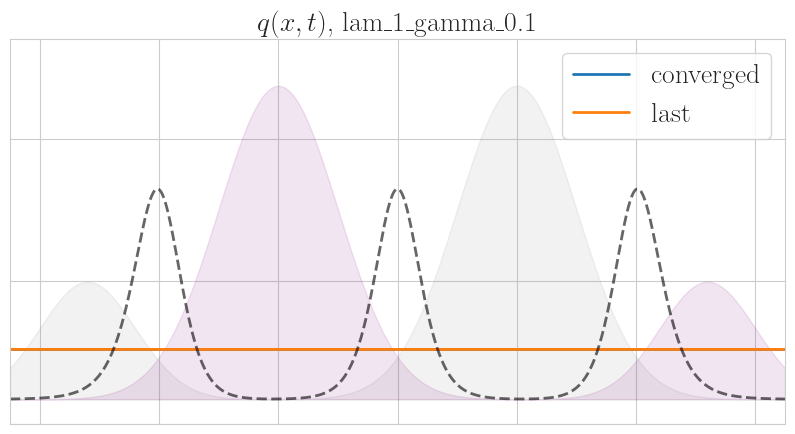

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1514.50it/s]


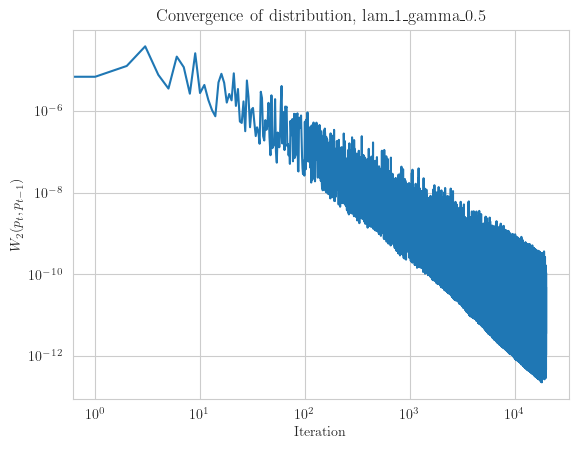

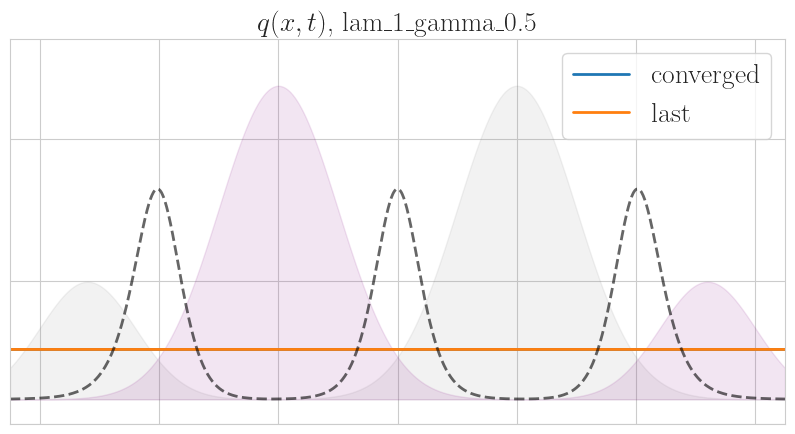

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:14<00:00, 1426.79it/s]


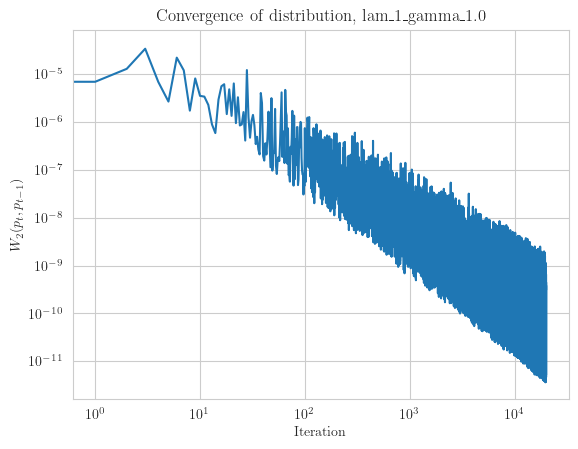

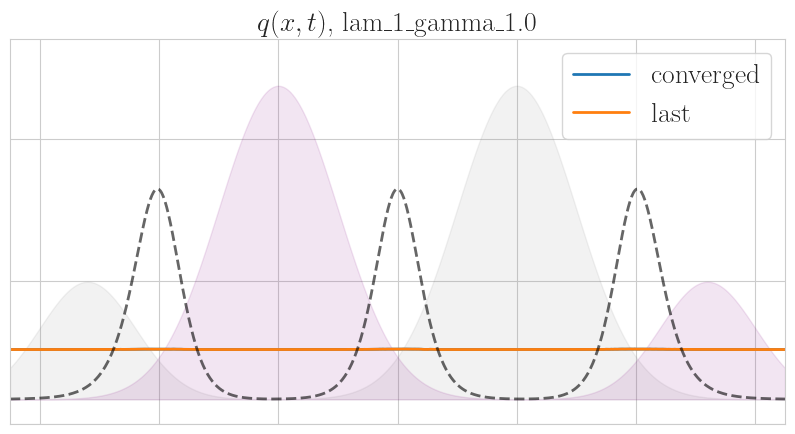

In [473]:
lam = lambda t: 1.
for power in [0.0, 0.1, 0.5, 1.0]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_1_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_1_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1537.49it/s]


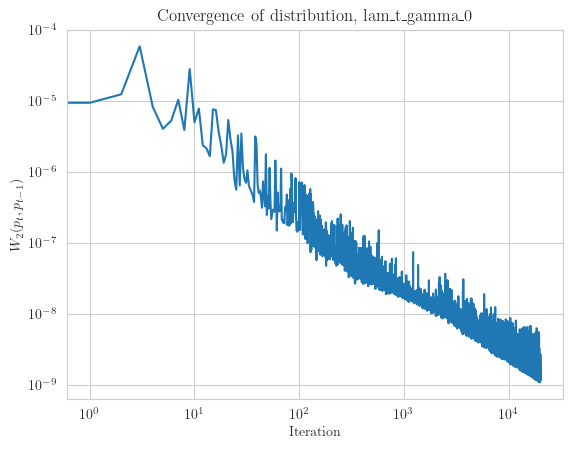

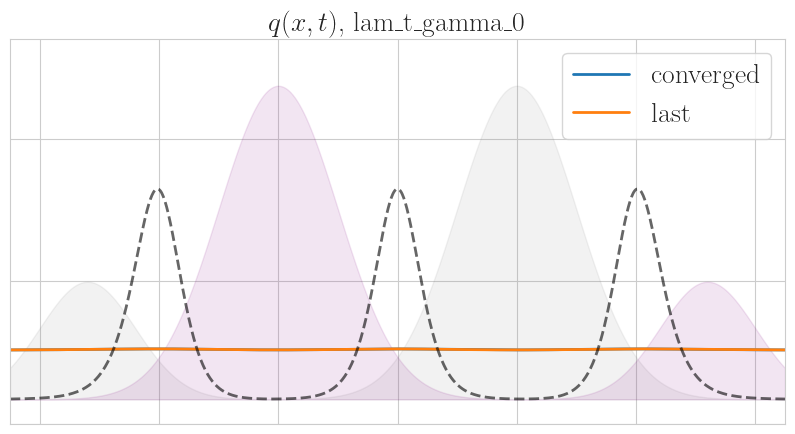

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:12<00:00, 1542.77it/s]


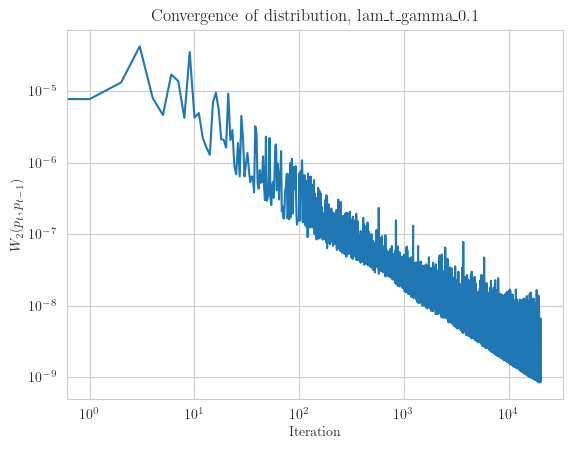

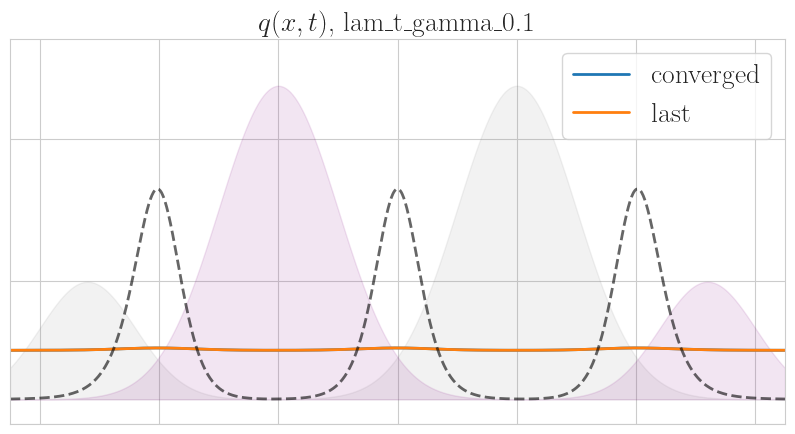

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1493.27it/s]


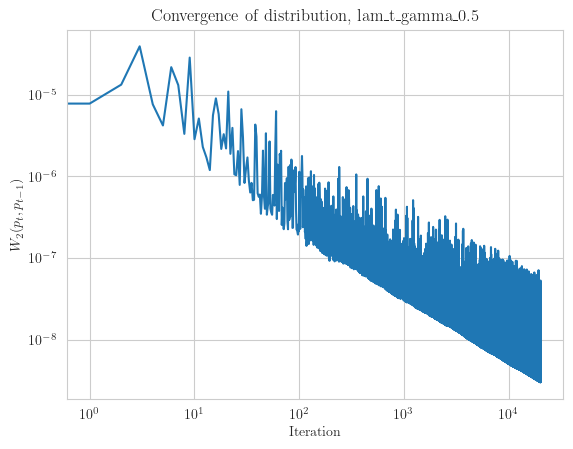

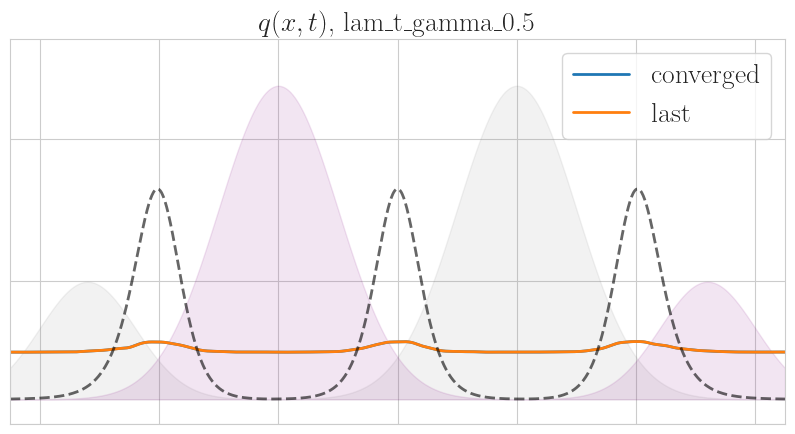

In [478]:
lam = lambda t: (1. + t/100.)
for power in [0.0, 0.1, 0.5]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_t_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_t_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1534.96it/s]


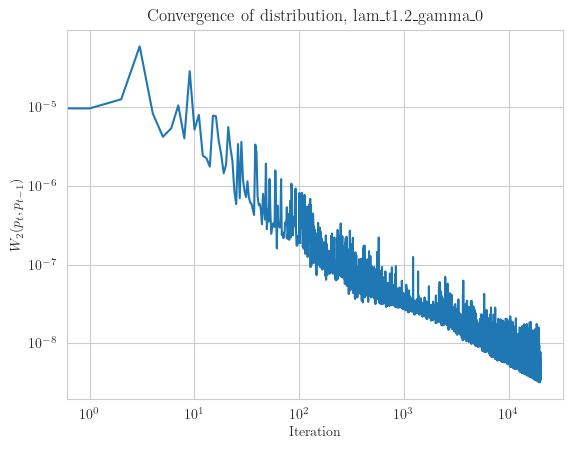

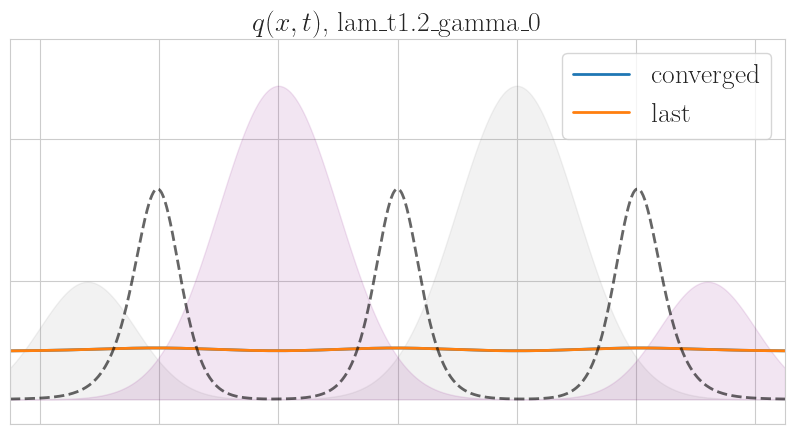

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:12<00:00, 1539.57it/s]


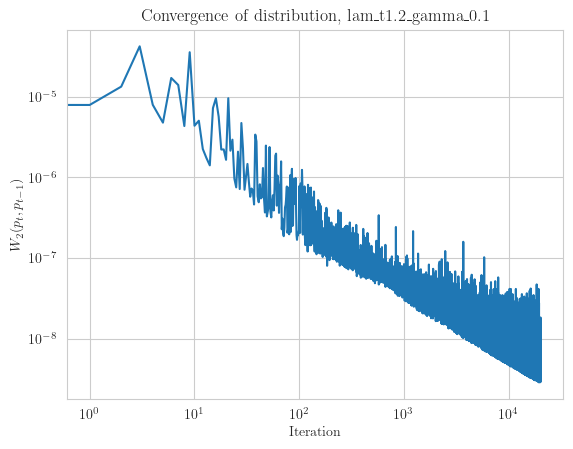

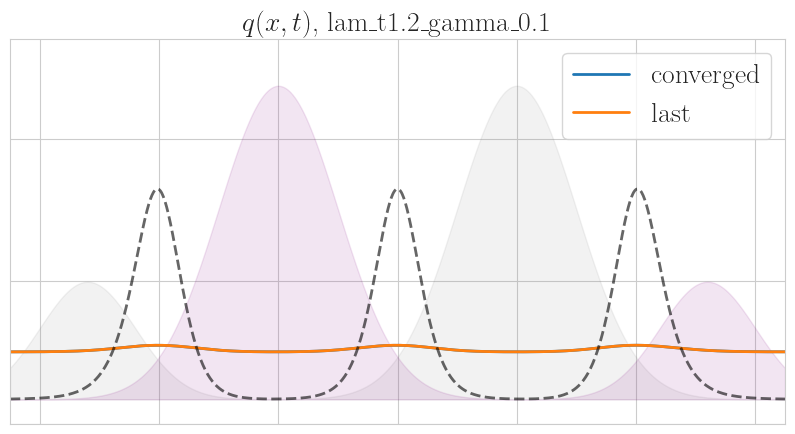

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1495.58it/s]


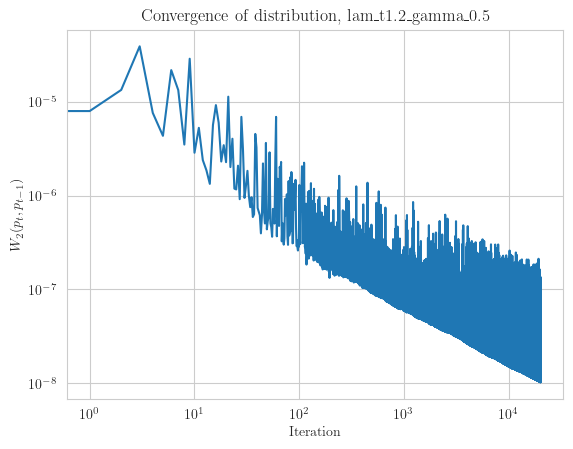

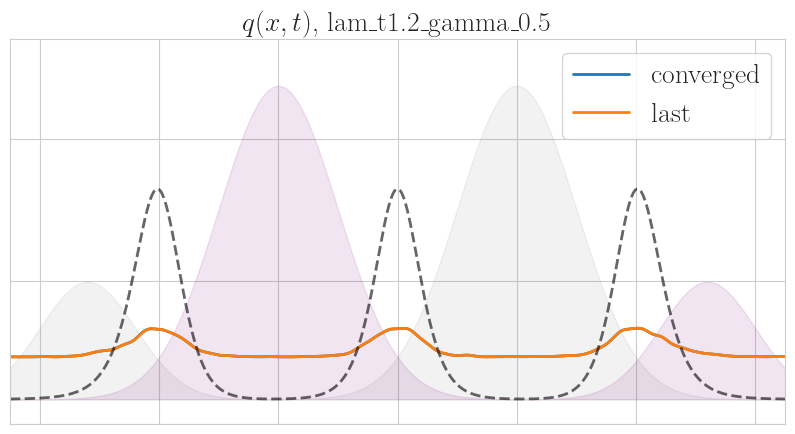

In [477]:
lam = lambda t: (1. + t/100.)**1.2
for power in [0.0, 0.1, 0.5]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_t1.2_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_t1.2_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1510.65it/s]


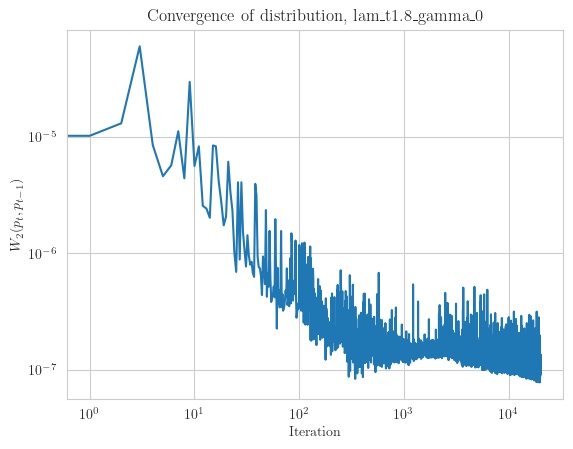

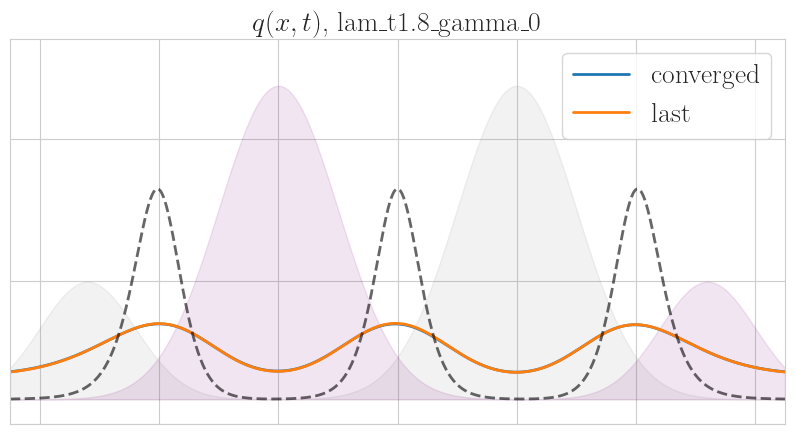

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:12<00:00, 1543.65it/s]


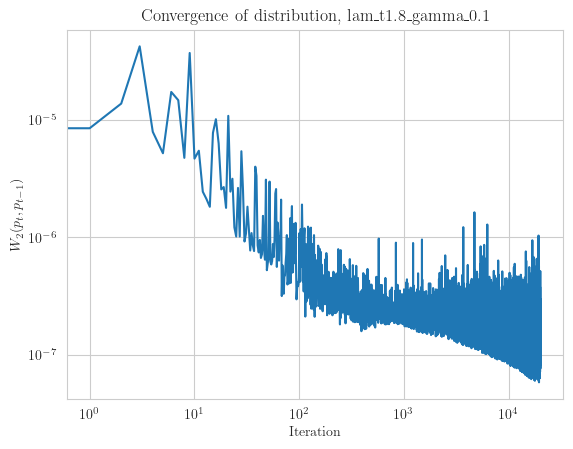

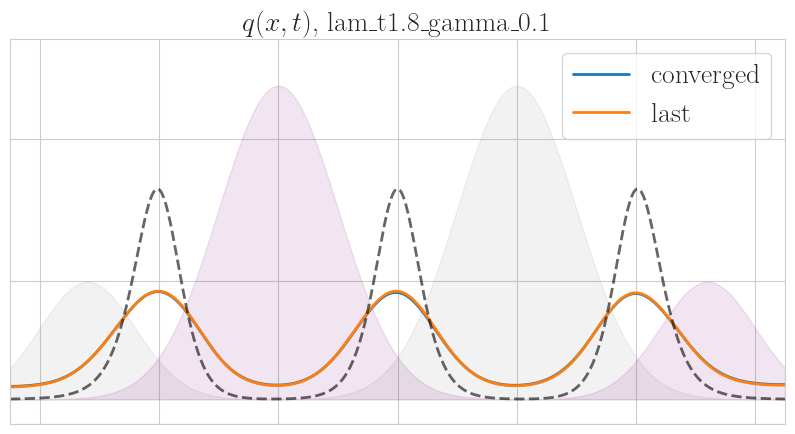

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1473.99it/s]


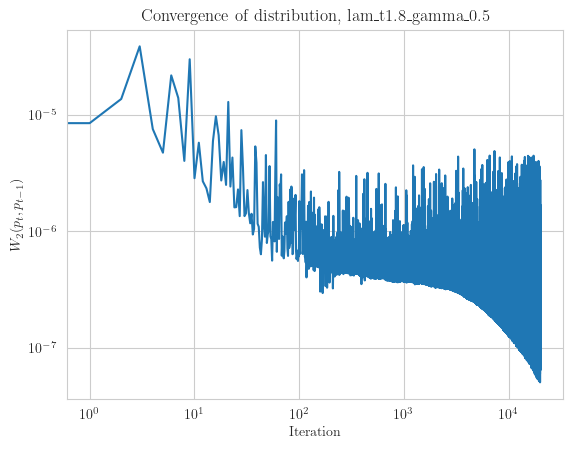

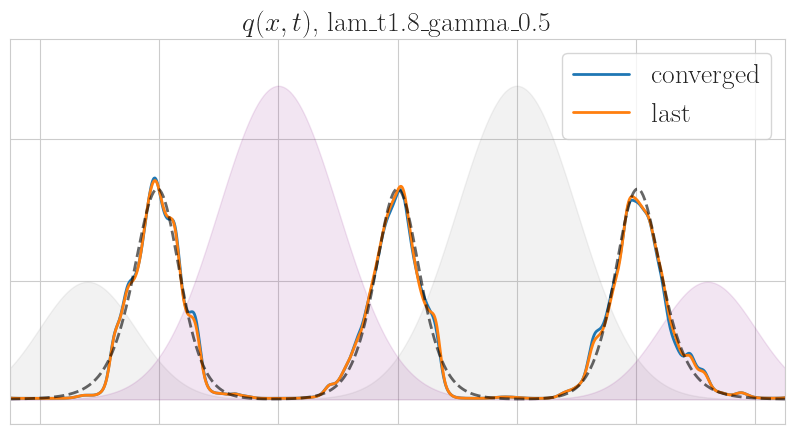

In [476]:
lam = lambda t: (1. + t/100.)**1.8
for power in [0.0, 0.1, 0.5]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_t1.8_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_t1.8_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1525.55it/s]


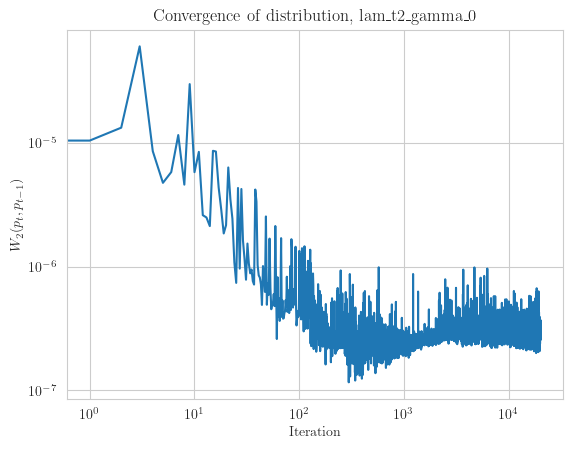

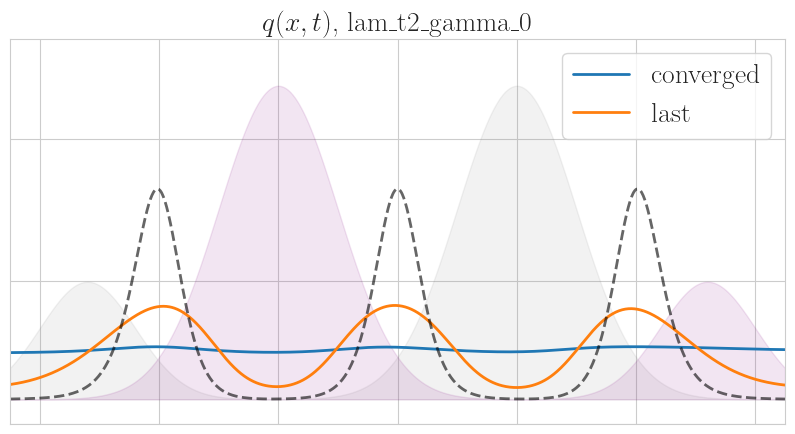

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:12<00:00, 1545.78it/s]


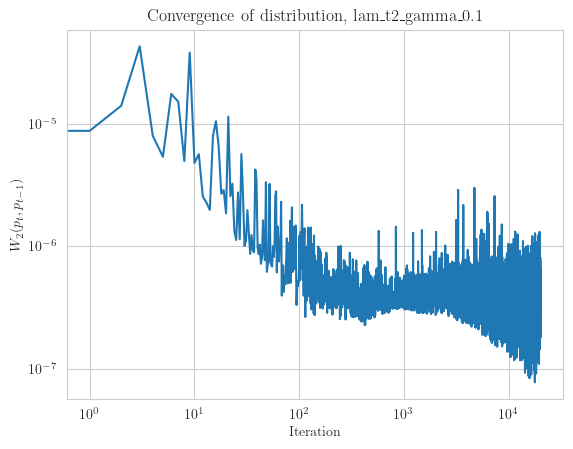

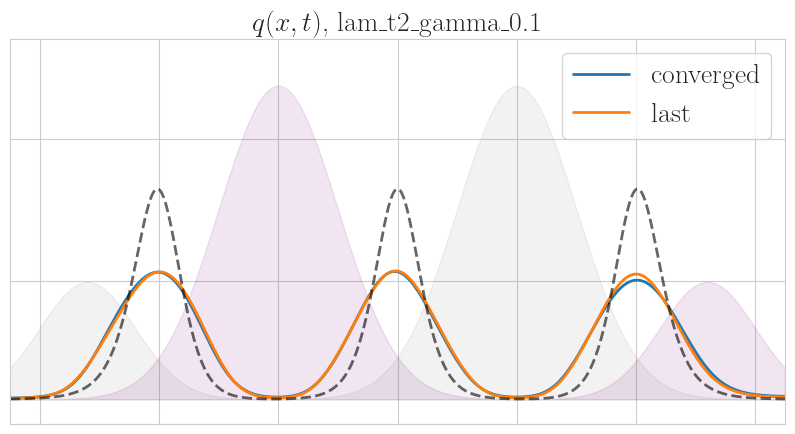

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1482.16it/s]


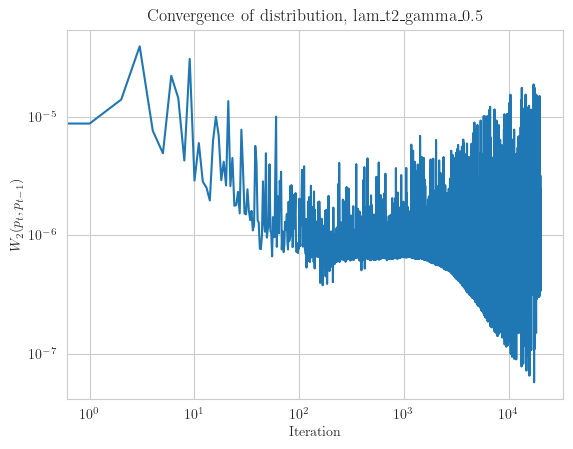

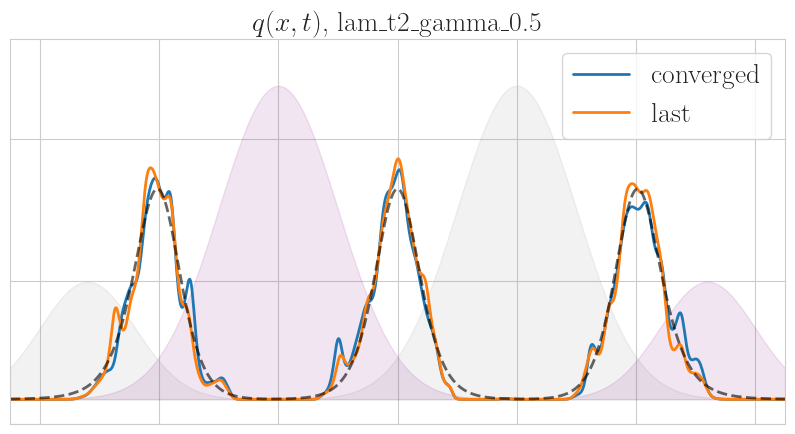

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:14<00:00, 1424.76it/s]


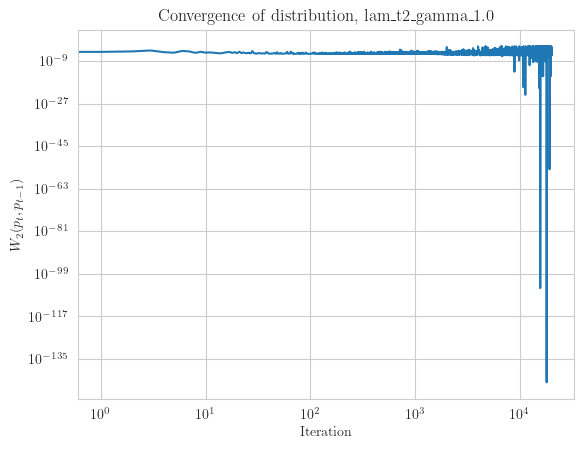

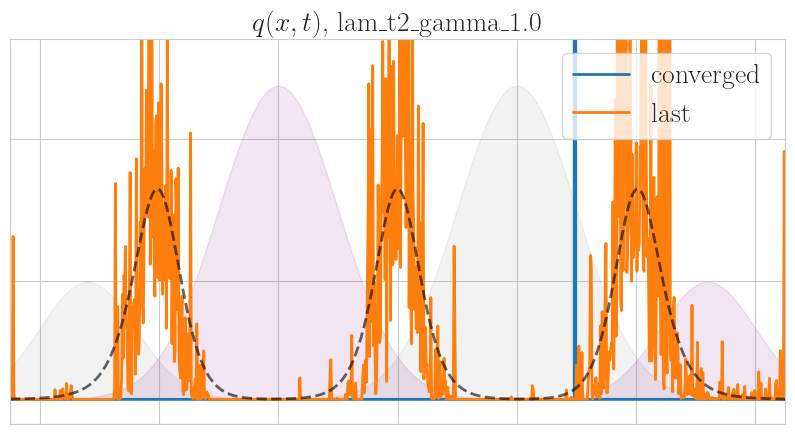

In [474]:
lam = lambda t: (1. + t/100.)**2
for power in [0.0, 0.1, 0.5, 1.0]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_t2_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_t2_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1520.07it/s]


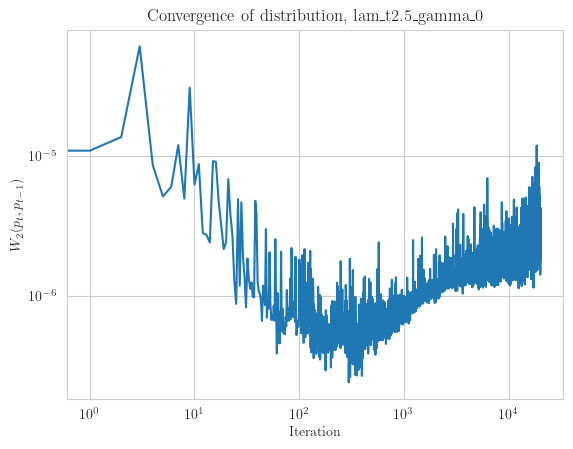

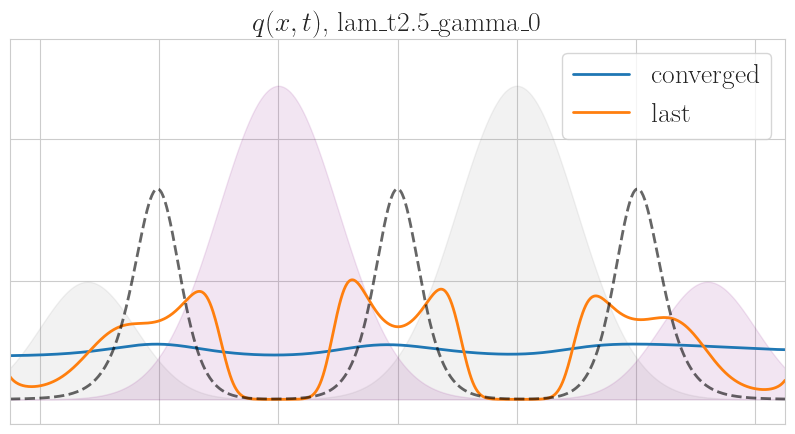

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1530.18it/s]


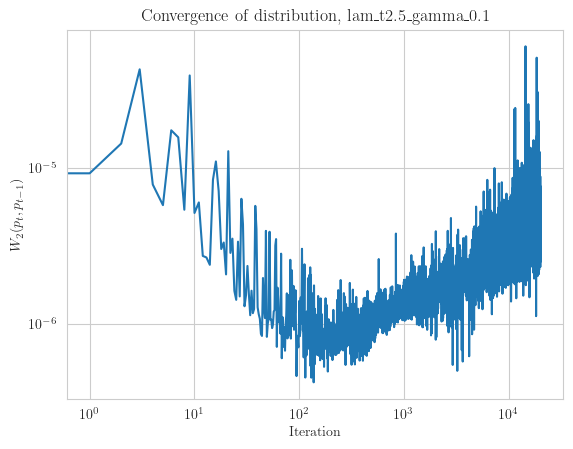

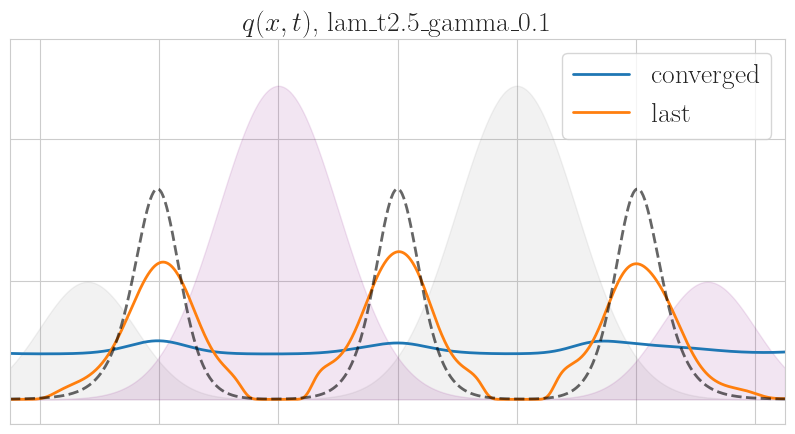

100%|█████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:13<00:00, 1431.68it/s]


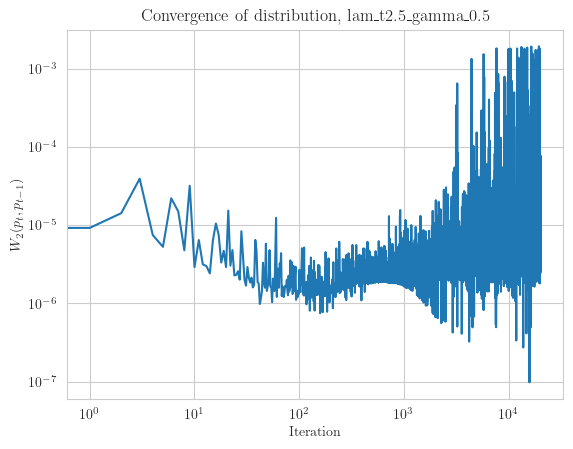

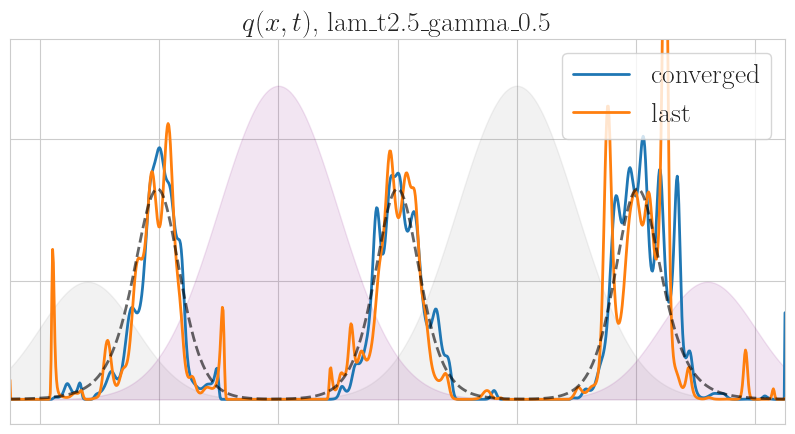

In [475]:
lam = lambda t: (1. + t/100.)**2.5
for power in [0.0, 0.1, 0.5]:
    if power == 0.0:
        gamma = lambda t: 2.0
        run_name = 'lam_t2.5_gamma_0'
    else:
        gamma = lambda t: 2.0*(1 + t**power)
        run_name = f'lam_t2.5_gamma_{power}'
    
    p, d = run_lam_test(dom, y_lab, np.array([350, 650]), c1, c2, lam=lam, gamma=gamma, plot=True, run_name=run_name)
    results[run_name] = {'p':p, 'd':d}



In [307]:
print(len(list(results.keys())))

12


In [479]:
def convert_key_to_plot_str(k):
    lam_str, gamma_power = k.split("_")[1], k.split("_")[-1]
    if lam_str == "1":
        lam_str = r'$\lambda(t) \sim 1$'
    elif lam_str == "t":
        lam_str = r'$\lambda(t) \sim t$'
    elif lam_str == "t1.2":
        lam_str = r'$\lambda(t) \sim t^{1.2}$'
    elif lam_str == "t1.8":
        lam_str = r'$\lambda(t) \sim t^{1.8}$'
    elif lam_str == "t2":
        lam_str = r'$\lambda(t) \sim t^2$'
    elif lam_str == "t2.5":
        lam_str = r'$\lambda(t) \sim t^{2.5}$'
    elif lam_str == "t3":
        lam_str = r'$\lambda(t) \sim t^3$'
    else:
        print(f"Don't recognize {lam_str}")
        
    if gamma_power == "0":
        gamma_str = r'$\gamma(t) \sim 1$'
    elif gamma_power == "0.1":
        gamma_str = r'$\gamma(t) \sim t^{0.1}$'
    elif gamma_power == "0.5":
        gamma_str = r'$\gamma(t) \sim t^{0.5}$'
    elif gamma_power == "1":
        gamma_str = r'$\gamma(t) \sim t$'
    else:
        print(f"Don't recognize {gamma_str}")
        
    return lam_str, gamma_str

convert_key_to_plot_str(list(results.keys())[5])

('$\\lambda(t) \\sim t^2$', '$\\gamma(t) \\sim t^{0.1}$')

In [480]:
print(results.keys())

dict_keys(['lam_1_gamma_0', 'lam_1_gamma_0.1', 'lam_1_gamma_0.5', 'lam_1_gamma_1.0', 'lam_t2_gamma_0', 'lam_t2_gamma_0.1', 'lam_t2_gamma_0.5', 'lam_t2_gamma_1.0', 'lam_t2.5_gamma_0', 'lam_t2.5_gamma_0.1', 'lam_t2.5_gamma_0.5', 'lam_t1.8_gamma_0', 'lam_t1.8_gamma_0.1', 'lam_t1.8_gamma_0.5', 'lam_t1.2_gamma_0', 'lam_t1.2_gamma_0.1', 'lam_t1.2_gamma_0.5', 'lam_t_gamma_0', 'lam_t_gamma_0.1', 'lam_t_gamma_0.5'])


In [481]:
def plot_legend_str_format(k):
    lam_str, gamma_str = convert_key_to_plot_str(k)
    return gamma_str

def plot_comp2G(keys_to_plot, results, g, save=False):
    if len(keys_to_plot) == 0:
        plot_title_str = ''
    else:
        plot_title_str = convert_key_to_plot_str(keys_to_plot[0])[0]
    ymin, ymax = (g/g.sum()).min()-0.0005, (g/g.sum()).max()+0.001
    fig, ax = plt.subplots(figsize=(10,5))
    if len(keys_to_plot) == 0:
        ax.fill_between(dom, 1.1*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray', label=r'$p(x | y = 1)$')
        ax.fill_between(dom, 1.1*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple', label=r'$p(x | y = 0)$')
    else:
        ax.fill_between(dom, 1.1*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') #, label=r'$p(x | y = 1)$')
        ax.fill_between(dom, 1.1*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple') #, label=r'$p(x | y = 0)$')
    for k in keys_to_plot:
        p = results[k]['p']
        ax.plot(dom, p, label=plot_legend_str_format(k), linewidth=2.0)
    if len(keys_to_plot) == 0:
        ax.plot(dom, g/g.sum(), 'k--', label=r'$G(x;\eta) \propto \eta(x) (1 - \eta(x))$', linewidth=2.0, alpha=0.8)
    else:
        ax.plot(dom, g/g.sum(), 'k--', linewidth=2.0, alpha=0.6)
    ax.set_xlim(-3.25,3.25)
    ax.set_ylim(ymin, ymax+0.002)
    if len(keys_to_plot) == 0:
        ax.legend(fontsize=18, bbox_to_anchor=(1.48,1.045))
    else:
        ax.legend(fontsize=18, loc='upper left') #bbox_to_anchor=(1,1.01))
    ax.set_ylabel('')
    ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    if save:
        print(plot_title_str)
        if plot_title_str == '':
            plt.savefig(os.path.join(savedir, f"unc_demo_new/lam_test_setup.png"), dpi=200, bbox_inches='tight')
        else:
            plt.savefig(os.path.join(savedir, f"unc_demo_new/lam_test_{'_'.join(keys_to_plot[0].split('_')[:2])}.png"), dpi=200, bbox_inches='tight')
    else:
        ax.set_title(plot_title_str, fontsize=20)
    plt.show()

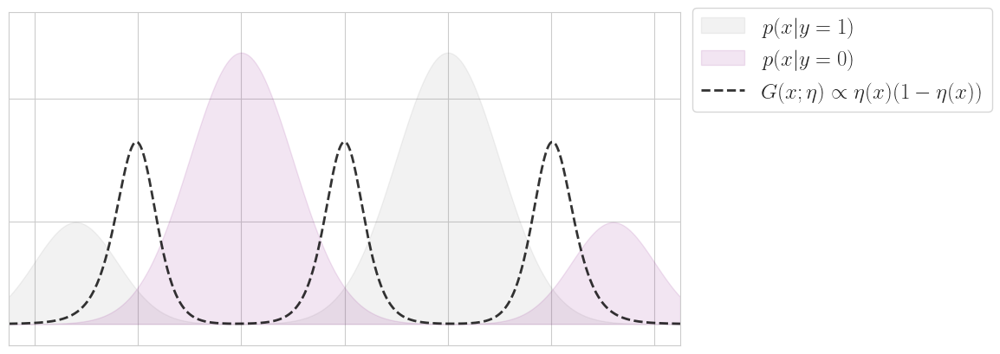

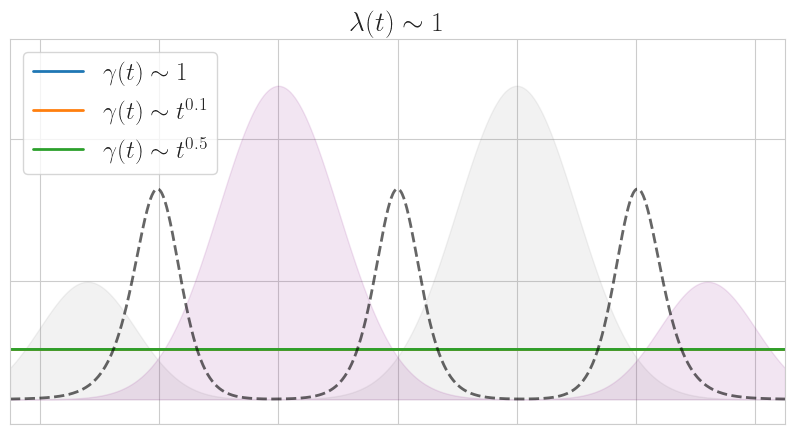

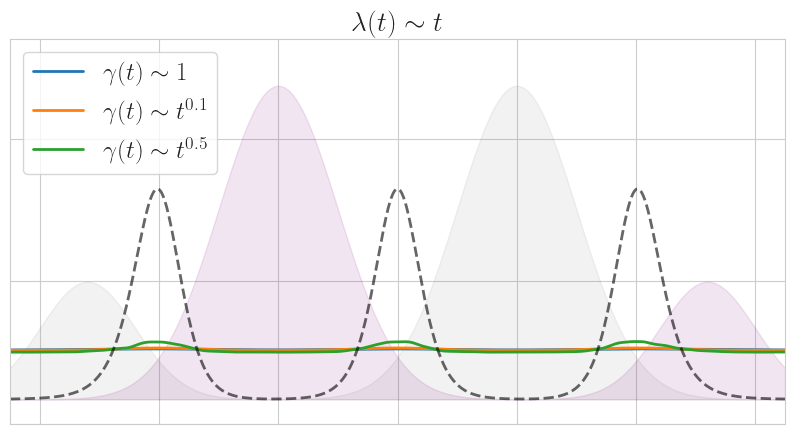

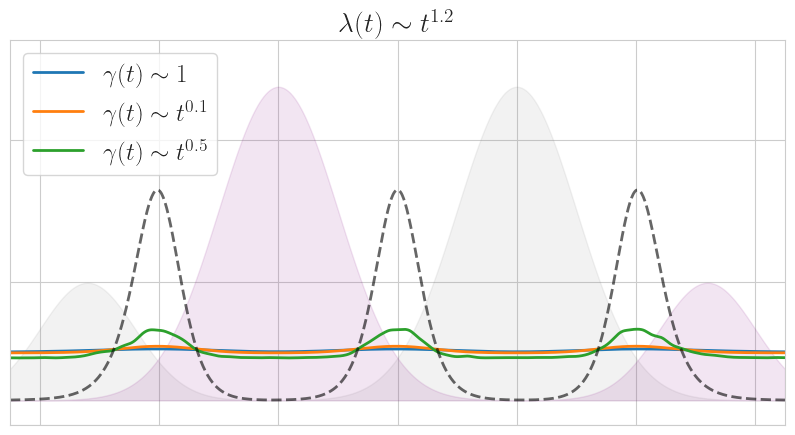

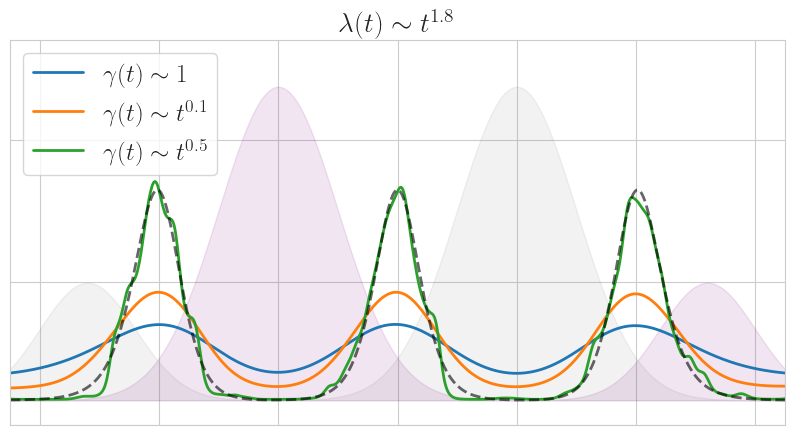

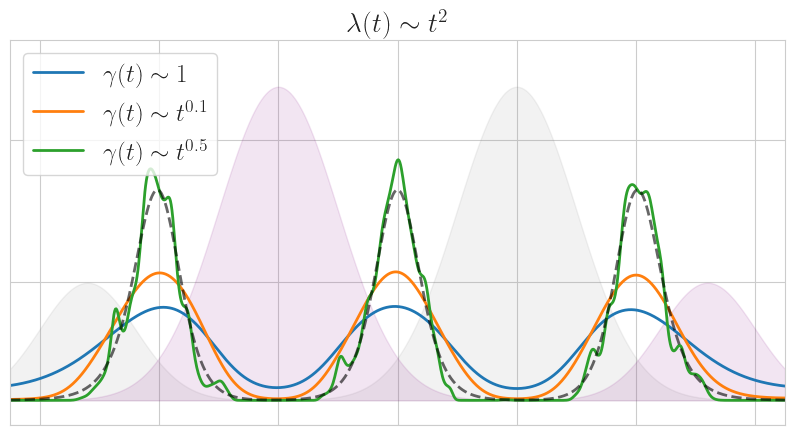

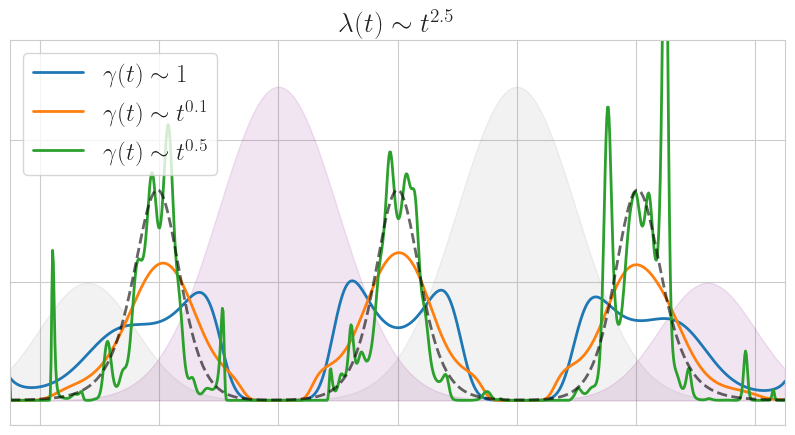

In [482]:
plot_comp2G([], results, g)
plot_comp2G(['lam_1_gamma_0', 'lam_1_gamma_0.1', 'lam_1_gamma_0.5'], results, g)
plot_comp2G(['lam_t_gamma_0', 'lam_t_gamma_0.1', 'lam_t_gamma_0.5'], results, g)
plot_comp2G(['lam_t1.2_gamma_0', 'lam_t1.2_gamma_0.1', 'lam_t1.2_gamma_0.5'], results, g)
plot_comp2G(['lam_t1.8_gamma_0', 'lam_t1.8_gamma_0.1', 'lam_t1.8_gamma_0.5'], results, g)
plot_comp2G(['lam_t2_gamma_0', 'lam_t2_gamma_0.1', 'lam_t2_gamma_0.5'], results, g)
plot_comp2G(['lam_t2.5_gamma_0', 'lam_t2.5_gamma_0.1', 'lam_t2.5_gamma_0.5'], results, g)

In [487]:
import pickle

with open("fig/exploit_cts_demo.pkl", "wb") as f:
    pickle.dump(results, f)

In [488]:
print(list(results.keys()))

['lam_1_gamma_0', 'lam_1_gamma_0.1', 'lam_1_gamma_0.5', 'lam_1_gamma_1.0', 'lam_t2_gamma_0', 'lam_t2_gamma_0.1', 'lam_t2_gamma_0.5', 'lam_t2_gamma_1.0', 'lam_t2.5_gamma_0', 'lam_t2.5_gamma_0.1', 'lam_t2.5_gamma_0.5', 'lam_t1.8_gamma_0', 'lam_t1.8_gamma_0.1', 'lam_t1.8_gamma_0.5', 'lam_t1.2_gamma_0', 'lam_t1.2_gamma_0.1', 'lam_t1.2_gamma_0.5', 'lam_t_gamma_0', 'lam_t_gamma_0.1', 'lam_t_gamma_0.5']


## Continuous Version (Not Discrete Sampling)


In [2]:
from scipy.stats import norm
from scipy.integrate import quad, solve_ivp
from scipy.stats import wasserstein_distance

def get_beta_var(A):
    a0 = A.sum(axis=1)
    bv_vals = (A * A).sum(axis=1)
    bv_vals = ((1. - bv_vals/(a0**2.))/(1. + a0))
    return bv_vals

def q(t, A, lam=lambda t: 1.):
    A_ = np.hstack((A[:n//2][:,np.newaxis], A[n//2:][:,np.newaxis]))
    vals = lam(t) * get_beta_var(A_)
    vals = np.exp(vals - vals.max())
    vals /= vals.sum()
    return np.concatenate((vals, vals))

In [3]:
from tqdm import tqdm

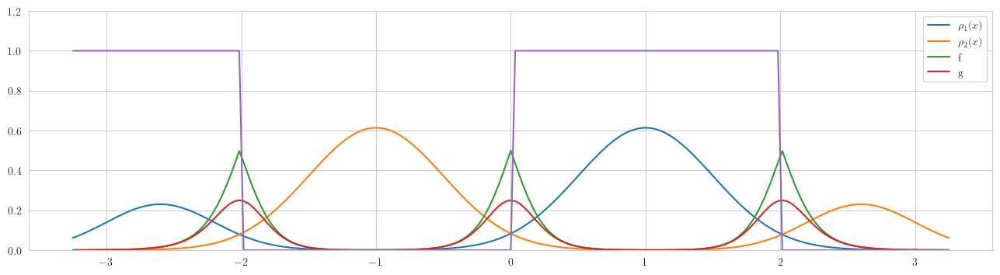

In [4]:
dist = 2.0
sig = 0.1
eps = 0.0
dom = np.linspace(-3.25, 3.25, 201)

p1 = norm(loc=-1.3*dist, scale=0.3+sig)
p2 = norm(loc=-.5*dist, scale=0.4+sig)
p3 = norm(loc=.5*dist, scale=0.4+sig)
p4 = norm(loc=1.3*dist, scale=0.3+sig)

rho1 = lambda x: 0.3*p1.pdf(x) + p3.pdf(x) + eps
rho2 = lambda x: 0.3*p4.pdf(x) + p2.pdf(x) + eps
rho1Z = quad(rho1, -6, 6)[0]
rho2Z = quad(rho2, -6, 6)[0]
rho1 = lambda x: (0.3*p1.pdf(x) + p3.pdf(x) + eps) / rho1Z
rho2 = lambda x: (0.3*p4.pdf(x) + p2.pdf(x) + eps) / rho2Z

rho = lambda x: 0.5*(rho1(x) + rho2(x))

eta = lambda x: 0.5*rho1(x)/rho(x)

y_lab = 1*(rho1(dom) > rho2(dom))



f = np.minimum(eta(dom),1. - eta(dom)) # min{ eta(x), 1 - eta(x)} == Bayes risk
g = eta(dom)*(1. - eta(dom))        # eta(x)(1 - eta(x))

fig, ax = plt.subplots(figsize=(16,4))
plt.plot(dom, rho1(dom), label=r'$\rho_1(x)$')
plt.plot(dom, rho2(dom), label=r'$\rho_2(x)$')
plt.plot(dom, f, label='f')
plt.plot(dom, g, label='g')
plt.plot(dom, y_lab)
# plt.plot(dom, p3, label='p3')
# plt.plot(dom, p4, label='p4')
plt.legend()
plt.ylim(0, 1.2)
plt.show()

In [5]:
Eta_vec = np.array([eta(x) for x in dom])
Eta = np.concatenate((Eta_vec, 1. - Eta_vec))

In [6]:
n = Eta.shape[0]
G = Eta[:n//2]*Eta[n//2:]
G /= G.sum()

G_unnorm = 2*Eta[:n//2]*Eta[n//2:]

c1 = rho1(dom)
c2 = rho2(dom)

In [18]:
prior = 0.1*np.ones_like(Eta)
teval = [0, 1e10]

def dalpha(t, A, lam=lambda t: 1.):
    return Eta * q(t, A, lam=lam)

results = {}

P = [0, 0.5, 0.75, 0.9, 0.95, 1.0, 1.05]

for p in tqdm(P):
    lam_ = lambda t: t**p
    sol_p = solve_ivp(dalpha, [0,1e10], prior, t_eval=teval, args=(lam_,))
    results[p] = (sol_p.t, sol_p.y)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 16.88it/s]


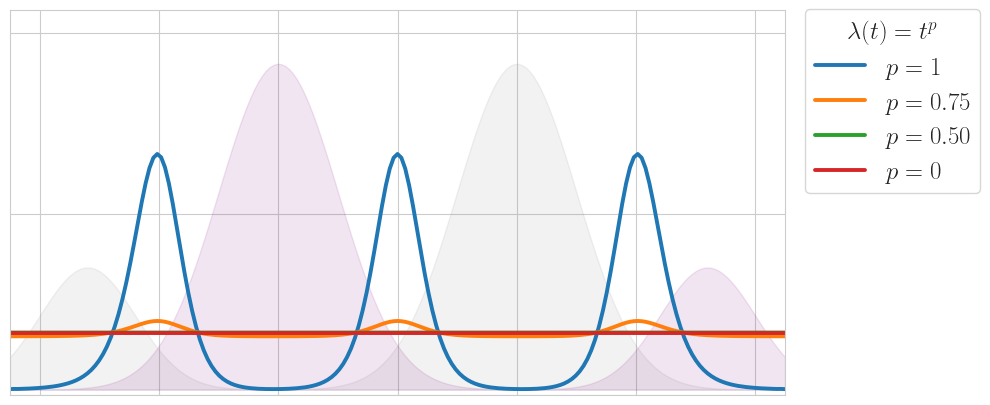

In [28]:
fig, ax = plt.subplots(figsize=(10,5))
ymin, ymax = G.min()-0.0005, G.max()+1e-2
ax.fill_between(dom, 0.9*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') 
ax.fill_between(dom, 0.9*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple')
# ax.plot(dom, G, 'k--', linewidth=4.0, alpha=0.5)


for p in [0.0, 0.5, 0.75, 1.0][::-1]:
    t, A = results[p][0], results[p][1]
    if p == 0:
        label_str = r'$p = 0$' #r"$\lambda(t) = 1$"
    elif p == 1.0:
        label_str = r'$p = 1$'
    else:
        pstr = fr"$p = {p:.2f}$"
        label_str = pstr #r'$\lambda(t) = t^{' + pstr +  r'}$'
    qt = q(t[-1], A[:,-1], lam=lambda t: t**p)[:n//2]
    ax.plot(dom, qt, label=label_str, linewidth=2.8, alpha=1.0)
    
ax.set_xlim(-3.25,3.25)
ax.set_ylim(ymin, ymax+0.002)
ax.set_ylabel('')
ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
ax.set_xticklabels([])
ax.set_yticklabels([])
leg = ax.legend(title=r'$\lambda(t) = t^p$', loc='upper left', fontsize=18, bbox_to_anchor=(1.01,1.035))
plt.setp(leg.get_title(),fontsize=18)
plt.savefig(os.path.join(savedir, f"unc_demo_new/lam_cts_diffp.png"), dpi=200, bbox_inches='tight')
plt.show()

In [10]:
%matplotlib inline

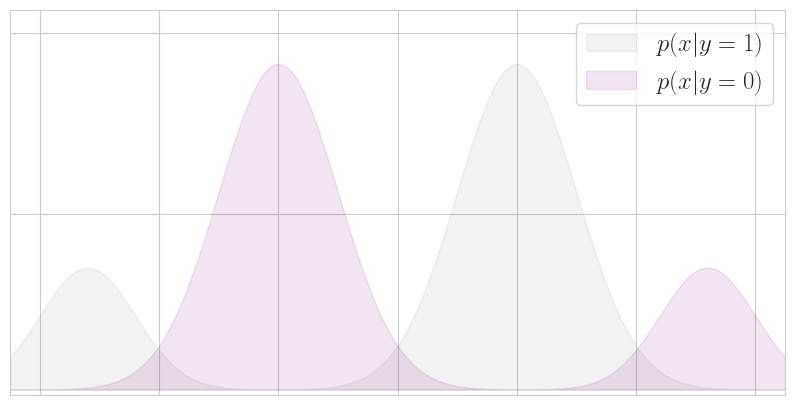

In [29]:
fig, ax = plt.subplots(figsize=(10,5))
ymin, ymax = G.min()-0.0005, G.max()+1e-2
ax.fill_between(dom, 0.9*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray', label=r'$p(x | y = 1)$') 
ax.fill_between(dom, 0.9*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple', label=r'$p(x | y = 0)$')
# ax.plot(dom, G, 'k--', linewidth=4.0, alpha=0.6, label=r'$G(x;\eta) \propto \eta(x)(1 - \eta(x))$')
    
ax.set_xlim(-3.25,3.25)
ax.set_ylim(ymin, ymax+0.002)
ax.set_ylabel('')
ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.legend(fontsize=18)
plt.savefig(os.path.join(savedir, f"unc_demo_new/lam_cts_setup.png"), dpi=200, bbox_inches='tight')
plt.show()

### Try scalings of $\lambda(t) = \lambda_0 t$

In [22]:
Lam0 = np.logspace(-3, 1, 5)

for lam0 in tqdm(Lam0):
    lam_ = lambda t: lam0*t
    sol_lam0 = solve_ivp(dalpha, [0,1e10], prior, t_eval=teval, args=(lam_,))
    results[-lam0] = (sol_lam0.t, sol_lam0.y)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:01<00:00,  4.66it/s]


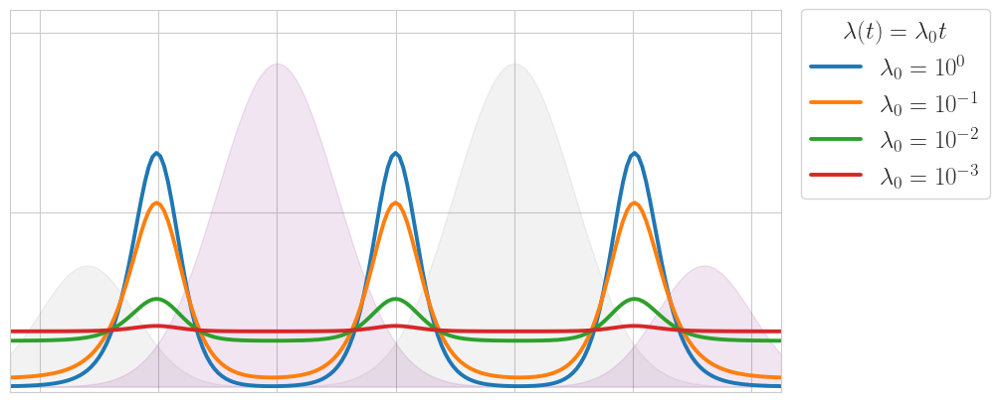

In [27]:
fig, ax = plt.subplots(figsize=(10,5))
ymin, ymax = G.min()-0.0005, G.max()+1e-2
ax.fill_between(dom, 0.9*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') 
ax.fill_between(dom, 0.9*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='purple')
# ax.plot(dom, G, 'k--', linewidth=4.0, alpha=0.5)


for lam0 in Lam0[:-1][::-1]:
    t, A = results[-lam0][0], results[-lam0][1]
    p = int(np.log10(lam0))
    label_str = r'$\lambda_0 = 10^{' + f'{p}' + r'}$'
    qt = q(t[-1], A[:,-1], lam=lambda t: lam0*t)[:n//2]
    ax.plot(dom, qt, label=label_str, linewidth=2.8, alpha=1.0)
    
ax.set_xlim(-3.25,3.25)
ax.set_ylim(ymin, ymax+0.002)
ax.set_ylabel('')
ax.set_yticks([ymin, ymin+0.5*(ymax-ymin), ymax])
ax.set_xticklabels([])
ax.set_yticklabels([])
leg = ax.legend(title=r'$\lambda(t) = \lambda_0 t$', loc='upper left', fontsize=18, bbox_to_anchor=(1.01,1.035))
plt.setp(leg.get_title(),fontsize=18)
plt.savefig(os.path.join(savedir, f"unc_demo_new/lam_cts_difflam0.png"), dpi=200, bbox_inches='tight')
plt.show()

## Check the condition

$$
    \bar q(x) \propto e^{\lambda_0 G(x;\eta) / \bar q(x)}
$$

In [24]:
for k, tup in results.items():
    t, A = tup[0], tup[1]
    if k >= 0:
        qt = q(t[-1], A[:,-1], lam=lambda t: t**k)[:n//2]
    else:
        qt = q(t[-1], A[:,-1], lam=lambda t: (-k)*t)[:n//2]
    newtup = (t, A, qt)
    results[k] = newtup

0.0048614379761623165 0.005337935587351782
True


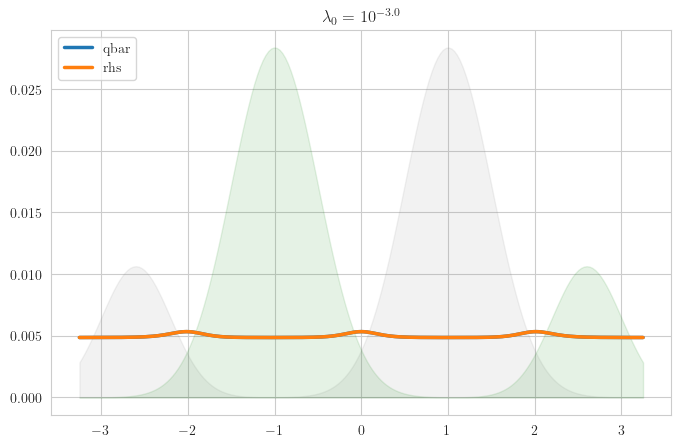

0.004039045520852108 0.007710089769694874
True


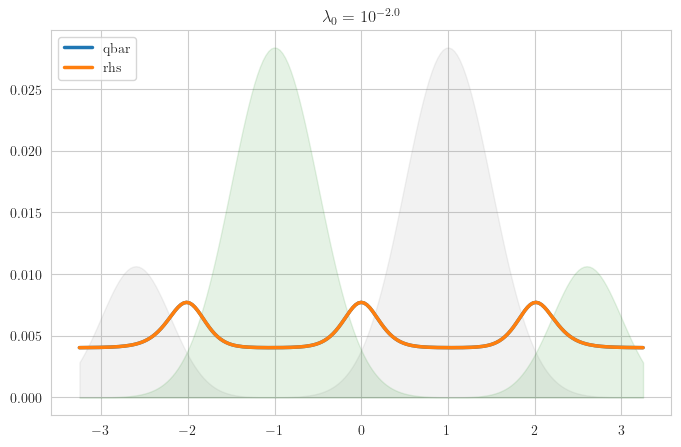

0.0008059418388312192 0.016146481007497465
True


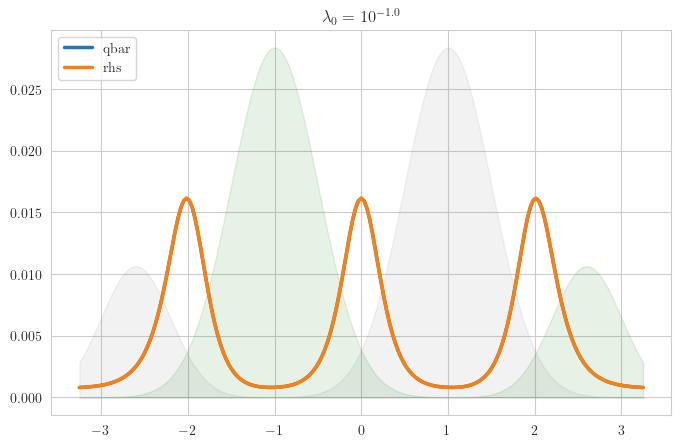

4.3878382679670296e-05 0.020518008899619553
False


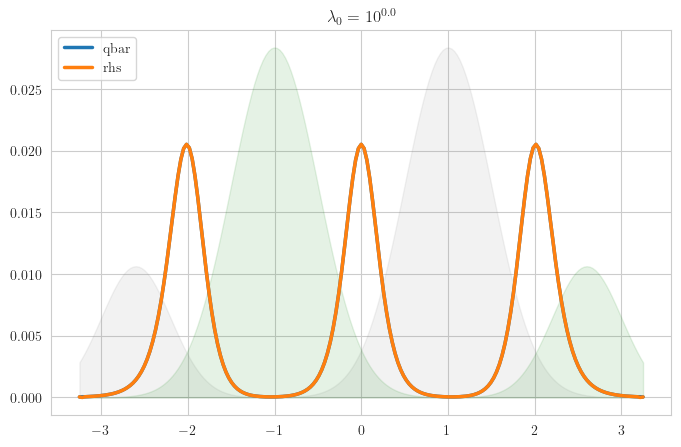

3.4511314219937764e-05 0.021001648022624147
False


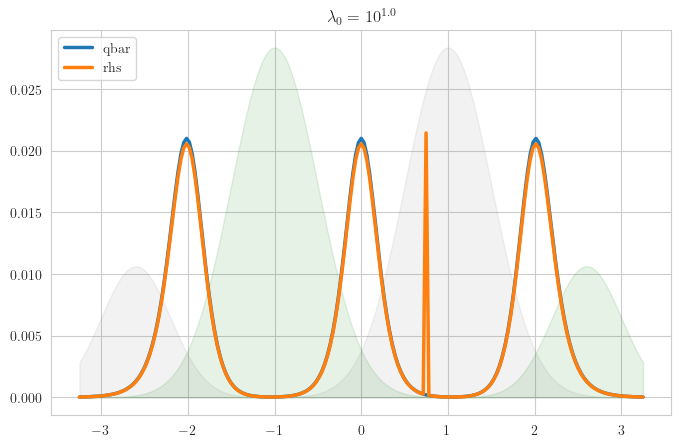

0.0 0.022883927054873406
False


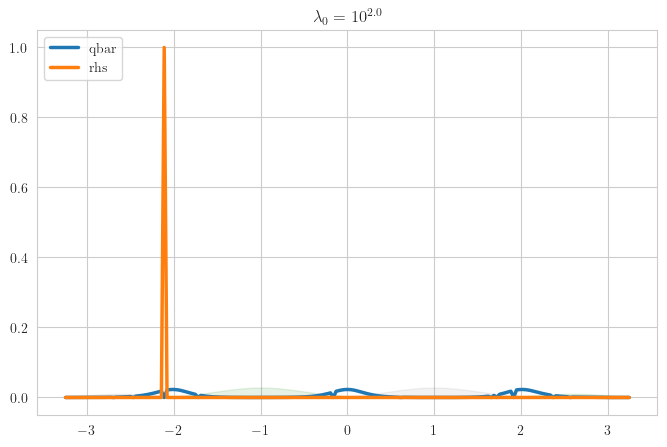

In [16]:
for k, item in results.items():
    qt = item[-1]
    if k < 0:
        lam0 = -k
        print(qt.min(), qt.max())
        rhs = lam0 * G_unnorm / (qt + 1e-8)
        rhs -= rhs.max()
        rhs = np.exp(rhs)
        rhs /= rhs.sum()
        
        print(np.allclose(rhs, qt))
        fig, ax = plt.subplots(figsize=(8,5))
        ymin, ymax = G.min()-0.0005, G.max()+1e-2
        ax.fill_between(dom, 0.9*(ymax - ymin)*c1/c1.max(), alpha=0.1, color='gray') 
        ax.fill_between(dom, 0.9*(ymax - ymin)*c2/c2.max(), alpha=0.1, color='green')
#         ax.plot(dom, G, 'k--', linewidth=4.0, alpha=0.5)
        
        ax.plot(dom, qt, linewidth=2.5, label='qbar')
        ax.plot(dom, rhs, linewidth=2.5, label='rhs')
        
        ax.set_title(r'$\lambda_0 = 10^{' + fr'{np.log10(lam0)}' +  r'}$')
        ax.legend(loc = 'upper left')
        plt.show()